<a href="https://colab.research.google.com/github/SahilBharodiya/BestProjects/blob/main/Final_Data.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install paddle-bfloat
!pip install paddleocr
!pip install paddlepaddle-gpu

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 383.1/383.1 kB 9.5 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 445.9/445.9 kB 10.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.6/5.6 MB 74.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.3/6.3 MB 103.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.1/67.1 MB 12.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.9/60.9 MB 19.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 298.5/298.5 kB 33.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.9/8.9 MB 90.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 29.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [ ]:
import cv2
from paddleocr import PaddleOCR
ocr = PaddleOCR(lang='en')
import os
import re
import matplotlib.pyplot as plt
import random
import pandas as pd
import requests
import numpy as np

In [ ]:
!pip freeze > requirements.txt

In [ ]:
cd "/content/drive/MyDrive/Kryptonas internship"

## Header Extraction Function

In [ ]:
def extract_header(img_path):
    data_ = {}
    image = cv2.imread(img_path)
    x1, y1, x2, y2 = (image.shape[1] // 2, image.shape[0] // 6, image.shape[1], 0)
    h = image[y2:y1, x1:x2]
    header = ocr.ocr(h)
    header_txt = ""
    for i in range(len(header) - 1):
        if abs(header[i][0][0][1] - header[i+1][0][0][1]) < 15:
            header_txt += header[i][1][0] + " "
        else:
            header_txt += header[i][1][0] + "\n"
    header_txt += header[-1][1][0]

    # Patient Name
    patient_name = ""
    try:
        x = re.search('(?:patient name|m/s)', header_txt, re.IGNORECASE).span()
        for i in header_txt[x[1]:]:
            if i == '\n':
                break
            patient_name += i
        patient_name = patient_name.replace(":-", "")
        patient_name = patient_name.replace("-", "")
        patient_name = patient_name.replace(":", "")
        patient_name = patient_name.strip()
    except:
        pass

    # Patient Mobile NUmber
    x1, y1, x2, y2 = (0, image.shape[0] // 8, image.shape[1], 0)
    h = image[y2:y1, x1:x2]
    text = ocr.ocr(h)
    text = [i[1][0] for i in text]
    text = ' '.join(text)
    text = text.split(".")
    text = ' '.join(text)
    text = text.split(",")
    text = ' '.join(text)
    text = text.split(" ")
    numbers = []
    for i in text:
        if 10 <= len(i) <= 12:
            for j in i:
                if not j.isdigit():
                    break
            else:
                numbers.append(int(i))

    # Patient Address
    address = ""
    try:
        x = re.search('(?:address|add)', header_txt, re.IGNORECASE).span()
        for i in header_txt[x[1]:]:
            if i == '\n':
                break
            address += i

        address = address.replace(":-", "")
        address = address.replace("-", "")
        address = address.replace(":", "")
        address = address.strip()
    except:
        pass

    # Date
    date = ""
    try:
        x = re.search('date', header_txt, re.IGNORECASE).span()

        for i in header_txt[x[1]:]:
            if i == '\n':
                break
            date += i
        for i in date:
            if i == '.' or i == ',' or i == ':':
                date = date.replace(i, '')
        date = date.strip()
    except:
        pass

    # Invoice Number
    invoice_number = ""
    try:
        x = re.search('(?:invoice no.|inv.no.|inv. no.|g.rcpt. no.|g. rcpt. no.|estimate no.|s.return no.|p.return no.)', header_txt, re.IGNORECASE).span()

        for i in header_txt[x[1]:]:
            if i == '\n':
                break
            invoice_number += i
        invoice_number = invoice_number.replace(":", "")
        invoice_number = invoice_number.replace(":-", "")
        invoice_number = invoice_number.split(" ")
        for i in invoice_number:
            if i.lower() == 'date':
                invoice_number = invoice_number[:invoice_number.index(i)]
                break
        invoice_number = ' '.join(invoice_number).strip()
        invoice_number = invoice_number.split(" ")[0].strip()
        for i in range(len(invoice_number)):
            if invoice_number[i].lower() == 'd' and invoice_number[i+1].lower() == 'a' and invoice_number[i+2].lower() == 't' and invoice_number[i+3].lower() == 'e':
                invoice_number = invoice_number[:i]
                break
    except:
        pass

    data_['Patient Name'] = patient_name
    data_['Patient Mobile Number'] = numbers
    data_['Patient Address'] = address
    data_['Date'] = date
    data_['Invoice Number'] = invoice_number
    return data_


## Table Extraction Function

In [ ]:
def extract_table(image_path):
    try:
        image = cv2.imread(image_path)
        retailer_id = image_path.split('-')[0].split('/')[1]
        if retailer_id == '214' or retailer_id == '207':
            x1, x2 = 0, image.shape[1]
            y1, y2 = requests.get(f"https://idpadmin.raseet.com/panel/api/configs/{retailer_id}").json()['y1'] * 2, requests.get(f"https://idpadmin.raseet.com/panel/api/configs/{retailer_id}").json()['y2'] * 2

        else:
            x1, x2 = 0, image.shape[1]
            y1, y2 = requests.get(f"https://idpadmin.raseet.com/panel/api/configs/{retailer_id}").json()['y1'], requests.get(f"https://idpadmin.raseet.com/panel/api/configs/{retailer_id}").json()['y2']

        gen_y = y2
        t = image[y1:y2, x1:x2]

        final = t

        def detect_vertical_lines(image):
            image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
            image = cv2.GaussianBlur(image, (5, 5), 0)
            edges = cv2.Canny(image, 50, 150, apertureSize=3)
            lines = cv2.HoughLines(edges, 1, np.pi / 180, 800)
            l = []
            for i in lines:
                rho, theta = i[0]
                if theta < 0.5:
                    l.append(rho)
            return l

        lines = detect_vertical_lines(t)

        lines = list(set(lines))
        lines = sorted(lines)
        line = []

        for i in range(len(lines)):
            if i == 0:
                line.append(lines[i])
            else:
                if lines[i] - lines[i-1] > 70:
                    line.append(lines[i])

        lines = line

        num_of_columns = len(lines)
        columns = []
        list_x1 = []
        for i in range(num_of_columns - 1):
            rho1 = lines[i]
            theta1 = 0
            a1 = np.cos(theta1)
            b1 = np.sin(theta1)
            x01 = a1 * rho1
            y01 = b1 * rho1
            x11 = int(x01 + 1000 * (-b1))
            y11 = gen_y

            rho2 = lines[i+1]
            theta2 = 0
            a2 = np.cos(theta2)
            b2 = np.sin(theta2)
            x02 = a2 * rho2
            x21 = int(x02 + 1000 * (-b2))

            x1 = x11
            y1 = y11
            x2 = x21
            y2 = 0

            c = final[y2:y1, x1:x2]
            columns.append(c)
            list_x1.append((x1 + x2)/2)

        cs = []

        for i in range(len(columns)):
            text = ocr.ocr(columns[i])
            cs.append([(text[j][1][0], list_x1[i], text[j][0][0][1]) for j in range(len(text))])

        t = len(cs[-1])

        for i in range(len(cs)):
            if cs[i][0][0].lower() == 'qty.' or cs[i][0][0].lower() == 'qty':
                if len(cs[i]) > t:
                    temp = cs[i]
                    lst = [temp[0]]
                    j = 1
                    while j < len(temp)-1:
                        lst.append((temp[j][0] + " " + temp[j+1][0], temp[j][1], temp[j][2]))
                        j += 2
                    cs[i] = lst

        for i  in range(len(cs)):
            if len(cs[i]) > t:
                cs[i].pop(1)

        for i in range(len(cs)-1):
            for j in range(t):
                try:
                    if abs(cs[-1][j][2] - cs[i][j][2]) > 30:
                        cs[i].insert(j, ('BLANK', cs[i][0][1], cs[-1][j][2]))
                except:
                    cs[i].insert(j, ('BLANK', cs[i][0][1], cs[-1][j][2]))
        if cs[0][0][0].lower() == 'sn.' or cs[0][0][0].lower() == 'sn':
            temp = [(cs[0][0][0], cs[0][0][1], cs[0][0][2])]
            for i in range(1, t):
                temp.append((f'{i}.', cs[0][0][1], cs[-1][i][2]))
            cs[0] = temp

        cs = list(map(list, zip(*cs)))
        cs = [sorted(i, key=lambda x: x[1]) for i in cs]

        for i in range(len(cs)):
            count_blank = 0
            for j in range(len(cs[i])):
                if cs[i][j][0] == 'BLANK':
                    count_blank += 1
            if count_blank > len(c[i])//2:
                cs[i] = []

        cs = [i for i in cs if i != []]

        table_final = []

        for i in range(len(cs)):
            table_final.append([cs[i][j][0] for j in range(len(cs[i]))])

        header = table_final[0]
        table_final = table_final[1:]

        df = pd.DataFrame(table_final, columns=header)

    except:
        df = pd.DataFrame()

    return df

## Footer Extraction Function

In [ ]:
def extract_footer(image_path):
    retailer_id = image_path.split('-')[0].split('/')[1]
    image = cv2.imread(image_path)
    x1 = image.shape[1] - image.shape[1] // 3 - 100
    y1 = image.shape[0] // 2
    x2 = image.shape[1]
    y2 = requests.get(f"https://idpadmin.raseet.com/panel/api/configs/{retailer_id}").json()['y2']
    f = image[y2:y1, x1:x2]
    footer = ocr.ocr(f)
    footer_txt = ""
    for i in range(len(footer) - 1):
        if abs(footer[i][0][0][1] - footer[i+1][0][0][1]) < 15:
            footer_txt += footer[i][1][0] + " "
        else:
            footer_txt += footer[i][1][0] + "\n"
    footer_txt += footer[-1][1][0]

    footer = footer_txt

    footer = footer.split('\n')
    try:
        # remove empty strings
        footer = [i for i in footer if i != '']
        footer = [i for i in footer if i != ' ']

        # make key value pairs
        v = []
        k = []

        for i in footer:
            v.append(i.split(' ')[-1])
            k.append(' '.join(i.split(' ')[:-1]))

        for i in range(len(v)):
            try:
                v[i] = float(v[i])
            except:
                k[i] = ""
                v[i] = ""
        for i in range(len(k)):
            try:
                x = float(k[i][0])
                k[i] = ""
                v[i] = ""
            except:
                pass

        d = dict(zip(k, v))

        # remove empty strings
        footer = {k: v for k, v in d.items() if k != ''}

    except:
        footer = {}

    return footer

## First

In [ ]:
first = os.listdir('first')

Data_First = {}

for i in first:
    header = extract_header(f'first/{i}')
    table = extract_table(f'first/{i}')
    footer = extract_footer(f'first/{i}')
    Data_First[i] = {'header': header, 'table': table, 'footer': footer}

[2022/07/05 04:14:36] ppocr WARNING: Since the angle classifier is not initialized, the angle classifier will not be uesd during the forward process
[2022/07/05 04:14:39] ppocr DEBUG: dt_boxes num : 14, elapse : 2.635629177093506
[2022/07/05 04:14:39] ppocr DEBUG: rec_res num  : 14, elapse : 0.05032706260681152
[2022/07/05 04:14:39] ppocr WARNING: Since the angle classifier is not initialized, the angle classifier will not be uesd during the forward process
[2022/07/05 04:14:39] ppocr DEBUG: dt_boxes num : 13, elapse : 0.016521692276000977
[2022/07/05 04:14:39] ppocr DEBUG: rec_res num  : 13, elapse : 0.06909942626953125
[2022/07/05 04:14:41] ppocr WARNING: Since the angle classifier is not initialized, the angle classifier will not be uesd during the forward process
[2022/07/05 04:14:41] ppocr DEBUG: dt_boxes num : 4, elapse : 0.01583385467529297
[2022/07/05 04:14:41] ppocr DEBUG: rec_res num  : 4, elapse : 0.011366128921508789
[2022/07/05 04:14:41] ppocr WARNING: Since the angle clas

53-18-1651673302921.png


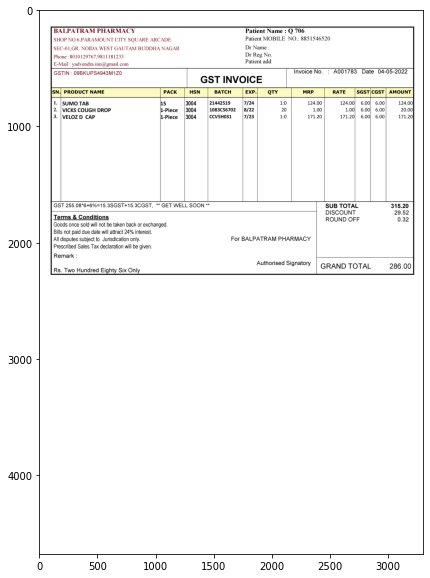


 {'Patient Name': 'Q 706', 'Patient Mobile Number': [8851546520, 8010129767, 9811181233], 'Patient Address': '', 'Date': '04-05-2022', 'Invoice Number': 'A001783'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,SUMO TAB,15,3004,21442519,7/24,1:0,124.00,124.00,6.00,6.00,124.00
1,2.,VICKS COUGH DROP,1-Piece,3004,1083C56702,8/22,20,1.00,1.00,6.00,6.00,20.00
2,3.,VELOZ D CAP,1-Piece,3004,CCV5H031,7/23,1:0,171.20,171.20,6.00,6.00,171.20



 {'SUB TOTAL': 315.2, 'DISCOUNT': 29.52, 'ROUND OFF': 0.32, 'GRAND tOtAL': 286.0} 


-----------------------------------------------------------------------------------------------------------------------

53-25-1643369577302.png


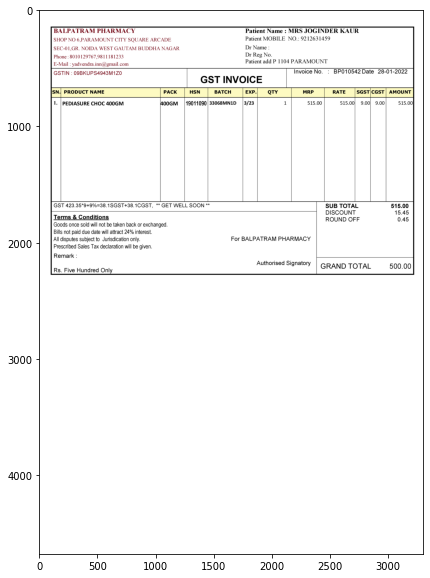


 {'Patient Name': 'MRS JOGINDER KAUR', 'Patient Mobile Number': [9212631459, 8010129767, 9811181233], 'Patient Address': 'P 1104 PARAMOUNT', 'Date': '28-01-2022', 'Invoice Number': 'BP010542'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,PEDIASURE CHOC 400GM,400GM,19011090,33068MN1D,3/23,1,515.00,515.00,9.00,9.00,515.00



 {'SUB TOTAL': 515.0, 'DISCOUNT': 15.45, 'ROUND OFF': 0.45, 'GRAND tOtAL': 500.0} 


-----------------------------------------------------------------------------------------------------------------------

54-2-1645855306112.png


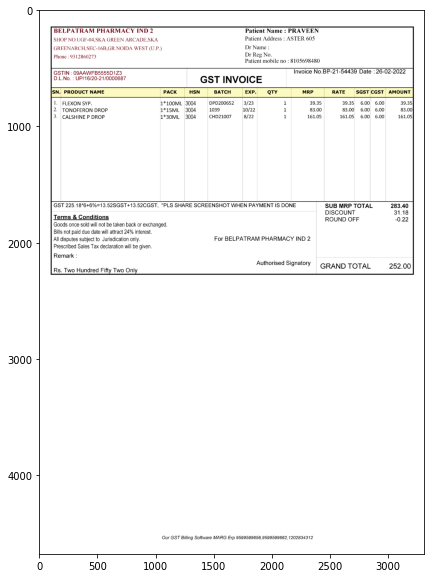


 {'Patient Name': 'PRAVEEN', 'Patient Mobile Number': [9312860273, 8105698480], 'Patient Address': 'ASTER 605', 'Date': '26-02-2022', 'Invoice Number': 'BP-21-54439'} 



,SN.,PRODUCt NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,FLEXON SYP.,1*100ML,3004,DPD200652,3/23,1,39.35,39.35,6.00,6.00,39.35
1,2.,TONOEERON DROP,1*15ML,3004,1039,10/22,1,83.00,83.00,6.00,6.00,83.00
2,3.,CALSHINE P DROP,1*30ML,3004,CHD21007,8/22,1,161.05,161.05,6.00,6.00,161.05



 {'ONE SUB MRP TOTAL': 283.4, 'DISCOUNT': 31.18, 'ROUND OFF': -0.22, 'iCY IND': 2.0, 'GRAND TOTAL': 252.0} 


-----------------------------------------------------------------------------------------------------------------------

54-42-1641399375587.png


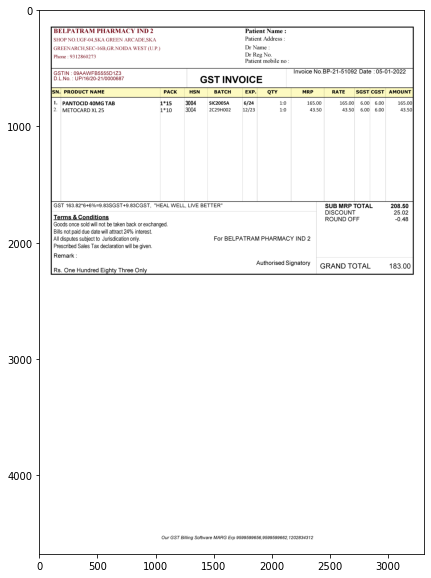


 {'Patient Name': '', 'Patient Mobile Number': [9312860273], 'Patient Address': '', 'Date': '05-01-2022', 'Invoice Number': 'BP-21-51092'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,PANTOCID 40MG TAB,1*15,3004,SIC2005A,6/24,1:0,165.00,165.00,6.00,6.00,165.00
1,2.,METOCARD XL 25,1*10,3004,2C29H002,12/23,1:0,43.50,43.50,6.00,6.00,43.50



 {'SUB MRP TOTAL': 208.5, 'DISCOUNT': 25.02, 'ROUND OFF': -0.48, 'ICY IND': 2.0, 'GRAND TOTAL': 183.0} 


-----------------------------------------------------------------------------------------------------------------------

54-22-1641139529717.png


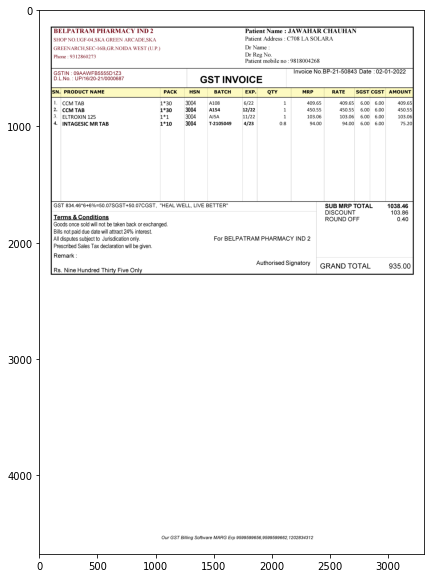


 {'Patient Name': 'JAWAHAR CHAUHAN', 'Patient Mobile Number': [9312860273, 9818004268], 'Patient Address': 'C708 LA SOLARA', 'Date': '02-01-2022', 'Invoice Number': 'BP-21-50843'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,CCM TAB,1*30,3004,A108,6/22,1,409.65,409.65,6.00,6.00,409.65
1,2.,CCM TAB,1*30,3004,A154,12/22,1,450.55,450.55,6.00,6.00,450.55
2,3.,ELTROXIN 125,1*1,3004,AJ5A,11/22,1,103.06,103.06,6.00,6.00,103.06
3,4.,INTAGESIC MRTAB,1*10,3004,T-2105049,4/23,0:8,94.00,94.00,6.00,6.00,75.20



 {'SUB MRP TOTAL': 1038.46, 'DISCOUNT': 103.86, 'ROUND OFF': 0.4, 'ICY IND': 2.0, 'GRAND TOTAL': 935.0} 


-----------------------------------------------------------------------------------------------------------------------

54-7-1644673366027.png


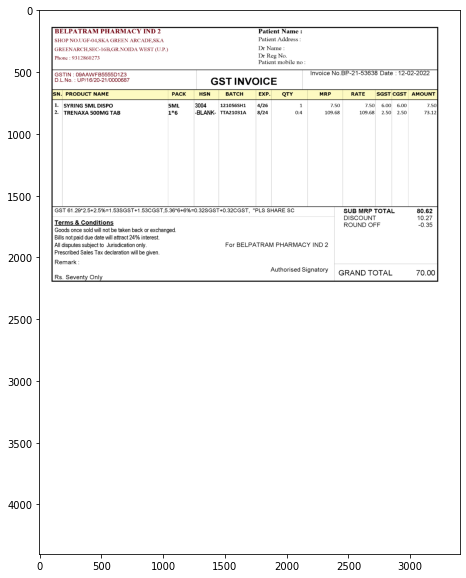


 {'Patient Name': '', 'Patient Mobile Number': [9312860273], 'Patient Address': '', 'Date': '12-02-2022', 'Invoice Number': 'BP-21-53638'} 



,SN.,PRODUCt NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGSt,CGST,AMOUNT
0,1.,SYRING 5YL DISPO,5ML,3004,121056SH1,4/26,1,7.50,7.50,6.00,6.00,7.50
1,2.,TRENAXA 5OOVG TAB,1*6,-BLANK-,TTA21031A,8/24,0:4,109.68,109.68,2.50,2.50,73.12



 {'SUB MRP TOTAL': 80.62, 'DISCOUNT': 10.27, 'ROUND OFF': -0.35, 'Y IND': 2.0, 'GRAND TOTAL': 70.0} 


-----------------------------------------------------------------------------------------------------------------------

57-7-1651242681643.png


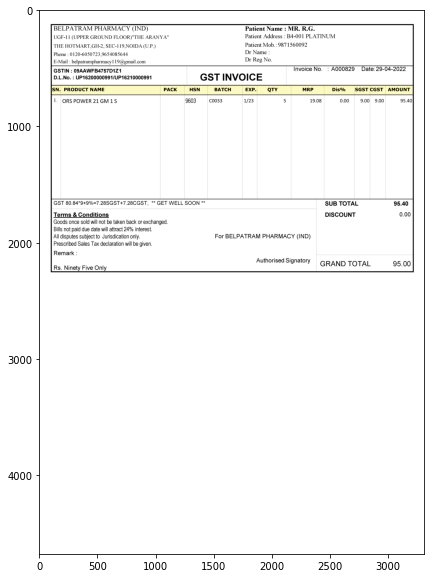


 {'Patient Name': 'MR. R.G', 'Patient Mobile Number': [9871560092, 9654085644], 'Patient Address': 'B4001 PLATINUM', 'Date': '29-04-2022', 'Invoice Number': 'A000829'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,Dis%,SGST,CGST,AMOUNT
0,1.,ORS POWER 21 GM 1 S,BLANK,9603,C0033,1/23,5,19.08,0.00,9.00,9.00,95.40



 {'SUB TOTAL': 95.4, 'DISCOUNT': 0.0, 'GRAND TOTAL': 95.0} 


-----------------------------------------------------------------------------------------------------------------------

57-5-1651076027465.png


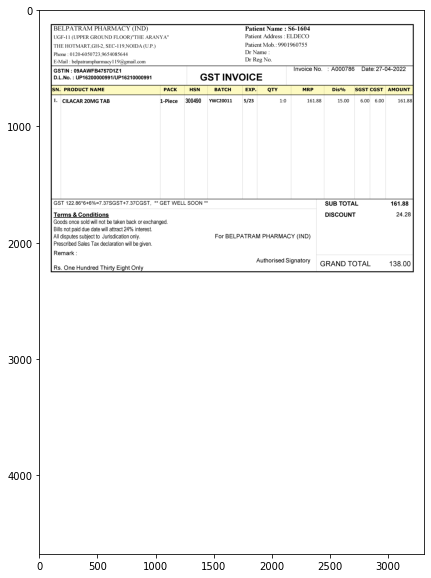


 {'Patient Name': 'S61604', 'Patient Mobile Number': [9901960755, 9654085644], 'Patient Address': 'ELDECO', 'Date': '27-04-2022', 'Invoice Number': 'A000786'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,Dis%,SGST,CGST,AMOUNT
0,1.,CILACAR 20MG TAB,1-Piece,300490,YWC20011,5/23,1:0,161.88,15.00,6.00,6.00,161.88



 {'SUB TOTAL': 161.88, 'DISCOUNT': 24.28, 'GRAND TOTAL': 138.0} 


-----------------------------------------------------------------------------------------------------------------------

57-6-1641907336368.png


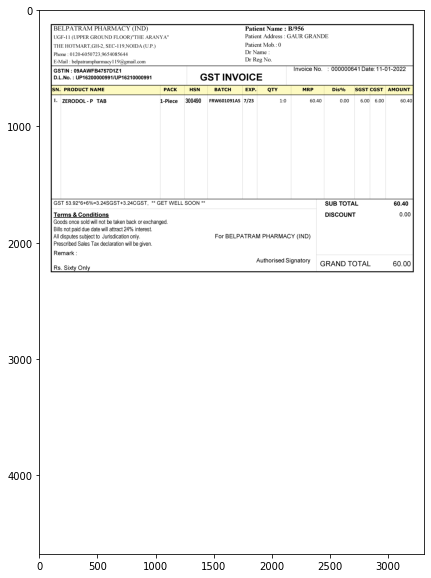


 {'Patient Name': 'B/956', 'Patient Mobile Number': [9654085644], 'Patient Address': 'GAUR GRANDE', 'Date': '11-01-2022', 'Invoice Number': '000000641'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,Dis%,SGST,CGST,AMOUNT
0,1.,ZERODOL - P TAB,1-Piece,300490,FRW601091AS,7/23,1:0,60.40,0.00,6.00,6.00,60.40



 {'SUB TOTAL': 60.4, 'DISCOUNT': 0.0, 'GRAND TOTAL': 60.0} 


-----------------------------------------------------------------------------------------------------------------------

58-3-1649308755437.png


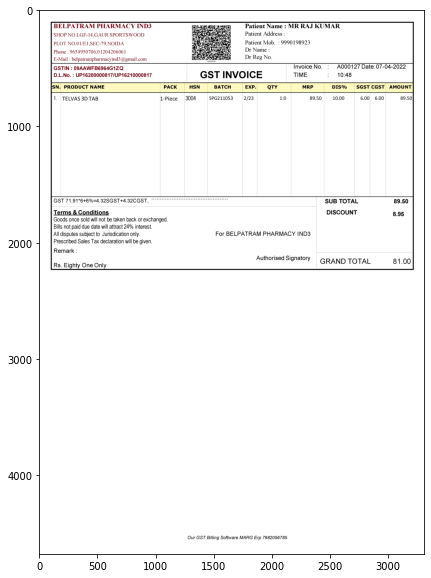


 {'Patient Name': 'MR RAJ KUMAR', 'Patient Mobile Number': [9990198923, 9654950706, 1204206061], 'Patient Address': '', 'Date': '07-04-2022', 'Invoice Number': 'A000127'} 



,SN.,PRODUCt NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DIS%,SGST,CGST,AMOUNT
0,1.,TELVAS 3D TAB,1-Piece,3004,SPG211053,2/23,1:0,89.50,10.00,6.00,6.00,89.50



 {'SUB TOTAL': 89.5, 'DISCOUNT': 8.95, 'GRAND TOTAL': 81.0} 


-----------------------------------------------------------------------------------------------------------------------

58-10-1643460185725.png


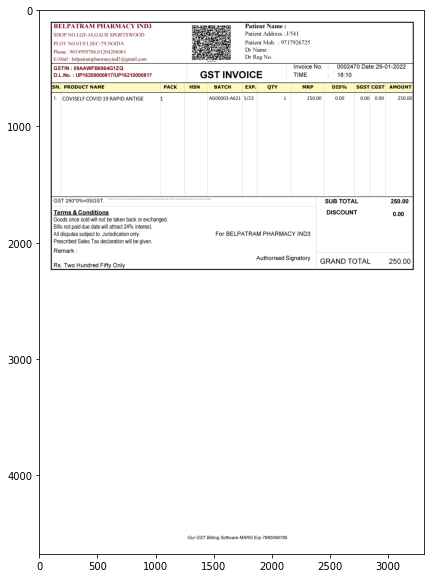


 {'Patient Name': '', 'Patient Mobile Number': [9717926725, 9654950706, 1204206061], 'Patient Address': 'J/541', 'Date': '29-01-2022', 'Invoice Number': '0002470'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DIS%,SGST,CGST,AMOUNT
0,1.,COVISELE COVID 19 RAPID ANTIGE,1,BLANK,AG00003-A621,5/23,1,250.00,0.00,0.00,0.00,250.00



 {'SUB TOTAL': 250.0, 'DISCOUNT': 0.0, 'GRAND TOTAL': 250.0} 


-----------------------------------------------------------------------------------------------------------------------

58-2-1646998344897.png


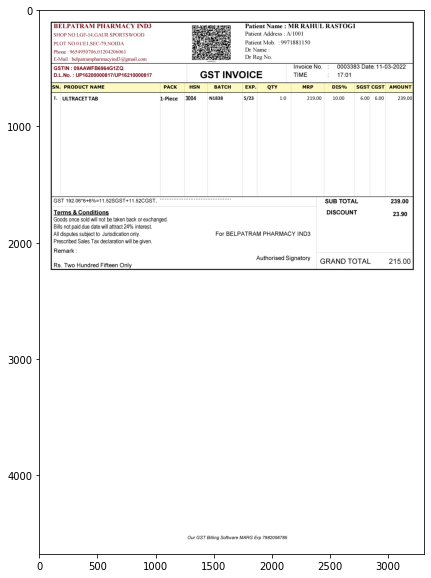


 {'Patient Name': 'MR RAHUL RASTOGI', 'Patient Mobile Number': [9971881150, 9654950706, 1204206061], 'Patient Address': 'A/1001', 'Date': '11-03-2022', 'Invoice Number': '0003383'} 



,SN.,PRODUCt NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DIS%,SGST,CGST,AMOUNT
0,1.,ULTRACET TAB,1-Piece,3004,N1838,5/23,1:0,219.00,10.00,6.00,6.00,239.00



 {'SUB TOTAL': 239.0, 'DISCOUNT': 23.9, 'GRAND TOTAL': 215.0} 


-----------------------------------------------------------------------------------------------------------------------

76-3-1645508070208.png


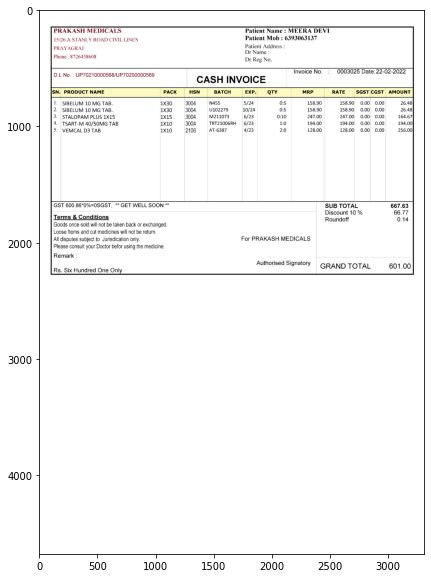


 {'Patient Name': 'MEERA DEVI', 'Patient Mobile Number': [6393063137, 8726458608], 'Patient Address': '', 'Date': '22-02-2022', 'Invoice Number': '0003025'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnt
0,1.,SIBELUM 1O MG TAB.,1X30,3004,N455,5/24,0:5,158.90,158.90,0.00,0.00,26.48
1,2.,SIBELUM 1O MG TAB.,1X30,3004,U102279,10/24,0:5,158.90,158.90,0.00,0.00,26.48
2,3.,STALOPAM PLUS 1X15,1X15,3004,M211073,6/23,0:10,247.00,247.00,0.00,0.00,164.67
3,4.,TSART-M 40/50MG TAB,1X10,3004,TRT21006RH,6/23,1:0,194.00,194.00,0.00,0.00,194.00
4,5.,VEMCAL D3 TAB,1X10,2106,AT-6387,4/23,2:0,128.00,128.00,0.00,0.00,256.00



 {'SUB tOtAL': 667.63, 'Discount 10 %': 66.77, 'Roundoff': 0.14, 'GRAND TOTAL': 601.0} 


-----------------------------------------------------------------------------------------------------------------------

76-1-1650606722677.png


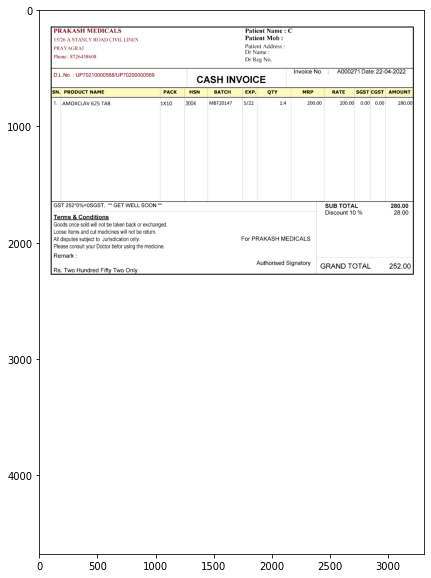


 {'Patient Name': 'C', 'Patient Mobile Number': [8726458608], 'Patient Address': '', 'Date': '22-04-2022', 'Invoice Number': 'A000271'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnt
0,1.,AMOXCLAV 625 TAB,1X10,3004,MBT20147,5/22,1:4,200.00,200.00,0.00,0.00,280.00



 {'SUB tOtAL': 280.0, 'Discount 10 %': 28.0, 'GRAND TOTAL': 252.0} 


-----------------------------------------------------------------------------------------------------------------------

76-1-1641567192682.png


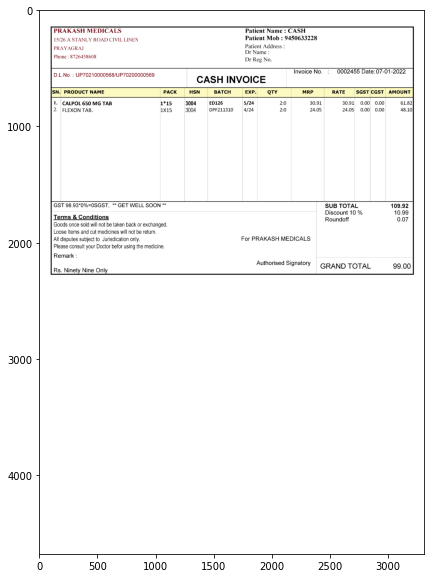


 {'Patient Name': 'CASH', 'Patient Mobile Number': [9450633228, 8726458608], 'Patient Address': '', 'Date': '07-01-2022', 'Invoice Number': '0002455'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnt
0,1.,CALPOL 650 MG TAB,1*15,3004,ED126,5/24,2:0,30.91,30.91,0.00,0.00,61.82
1,2.,FLEXON TAB.,1X15,3004,DPF211310,4/24,2:0,24.05,24.05,0.00,0.00,48.10



 {'SUB tOtAL': 109.92, 'Discount 10 %': 10.99, 'Roundoff': 0.07, 'GRAND TOTAL': 99.0} 


-----------------------------------------------------------------------------------------------------------------------

76-2-1644582890601.png


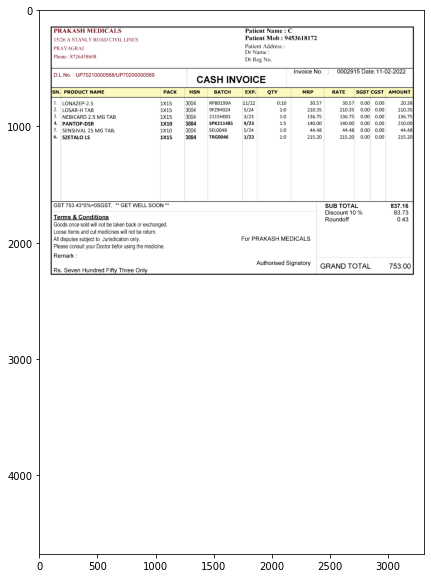


 {'Patient Name': 'C', 'Patient Mobile Number': [9453618172, 8726458608], 'Patient Address': '', 'Date': '11-02-2022', 'Invoice Number': '0002915'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnt
0,1.,LONAZEP-2.5,1X15,3004,RPB0199A,11/22,0:10,30.57,30.57,0.00,0.00,20.38
1,2.,LOSAR-H TAB,1X15,3004,9FZ9H024,5/24,1:0,210.35,210.35,0.00,0.00,210.35
2,3.,NEBICARD 2.5 MG TAB,1X15,3004,2115H001,3/23,1:0,136.75,136.75,0.00,0.00,136.75
3,4.,PANTOP-DSR,1X10,3004,SPK211485,9/23,1:5,140.00,140.00,0.00,0.00,210.00
4,5.,SENSUIVAL 25 MG TAB.,1X10,3004,SELO04B,5/24,1:0,44.48,44.48,0.00,0.00,44.48
5,6.,SZETALO LS,1X15,3004,TRG0046,1/23,1:0,215.20,215.20,0.00,0.00,215.20



 {'SUB tOtAL': 837.16, 'Discount 10 %': 83.73, 'Roundoff': 0.43, 'GRAND TOTAL': 753.0} 


-----------------------------------------------------------------------------------------------------------------------

83-7-1647760973694.png


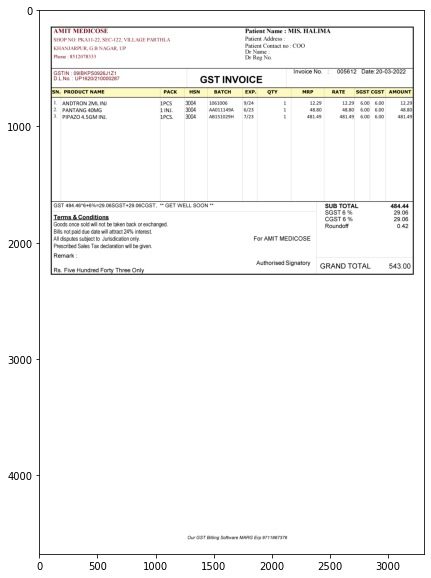


 {'Patient Name': 'MIS. HALIMA', 'Patient Mobile Number': [8512078333], 'Patient Address': '', 'Date': '20-03-2022', 'Invoice Number': '005612'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,ANDTRON 2MLINJ,1PCS,3004,1061006,9/24,1,12.29,12.29,6.00,6.00,12.29
1,2.,PANTANG 4OMG,1 INJ.,3004,AA011149A,6/23,1,48.80,48.80,6.00,6.00,48.80
2,3.,PIPAZO 4.5GM INJ.,1PCS.,3004,AB151029H,7/23,1,481.49,481.49,6.00,6.00,481.49



 {'SUB TOTAL': 484.44, 'SGST 6 %': 29.06, 'CGST 6 %': 29.06, 'Roundoff': 0.42, 'GRAND TOTAL': 543.0} 


-----------------------------------------------------------------------------------------------------------------------

83-277-1650659294597.png


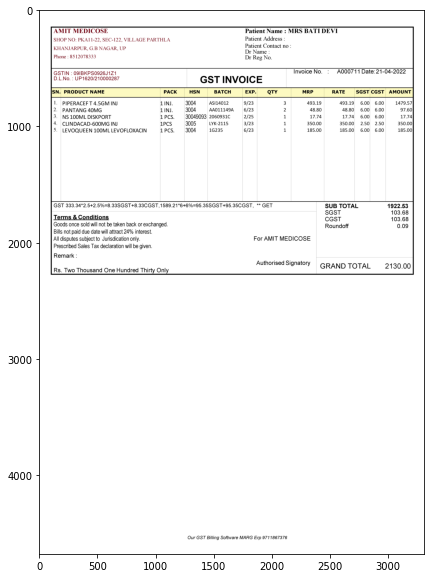


 {'Patient Name': 'MRS BATI DEVI', 'Patient Mobile Number': [8512078333], 'Patient Address': '', 'Date': '21-04-2022', 'Invoice Number': 'A000711'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,PIPERACEF T 4.5GMINJ,1 INJ.,3004,AS/14012,9/23,3,493.19,493.19,6.00,6.00,1479.57
1,2.,PANTANG 4OMG,1 INJ.,3004,AA011149A,6/23,2,48.80,48.80,6.00,6.00,97.60
2,3.,NS 1OOML DISKPORT,1 PCS.,30049093,2060931C,2/25,1,17.74,17.74,6.00,6.00,17.74
3,4.,CLINDACAD-6OOMG INJ,1PCS,3005,LYK-2115,3/23,1,350.00,350.00,2.50,2.50,350.00
4,5.,LEVOQUEEN 1OOMLLEVOFLOXACIN,1 PCS.,3004,1G235,6/23,1,185.00,185.00,6.00,6.00,185.00



 {'SUB TOTAL': 1922.53, 'SGST': 103.68, 'CGST': 103.68, 'Roundoff': 0.09, 'GRAND TOTAL': 2130.0} 


-----------------------------------------------------------------------------------------------------------------------

83-37-1645200559608.png


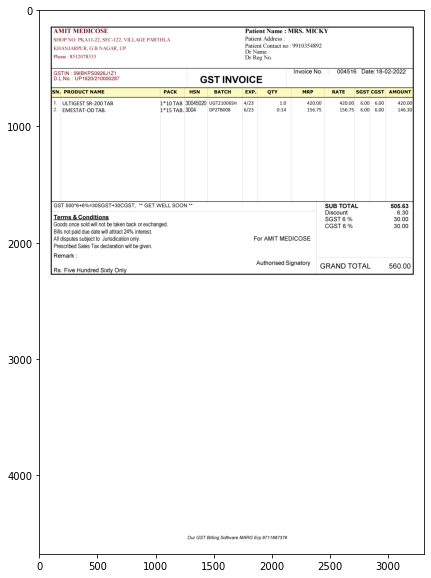


 {'Patient Name': 'MRS. MCKY', 'Patient Mobile Number': [9910354892, 8512078333], 'Patient Address': '', 'Date': '18-02-2022', 'Invoice Number': '004516'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,ULTIGEST SR-200 TAB,1*10 TAB,30045020,UGT21006SH,4/23,1:0,420.00,420.00,6.00,6.00,420.00
1,2.,EMESTAT-OD TAB,1*15 TAB,3004,DP2TB008,6/23,0:14,156.75,156.75,6.00,6.00,146.30



 {'SUB TOTAL': 505.63, 'Discount': 6.3, 'SGST 6 %': 30.0, 'CGST 6 %': 30.0, 'GRAND TOTAL': 560.0} 


-----------------------------------------------------------------------------------------------------------------------

83-129-1651039452874.png


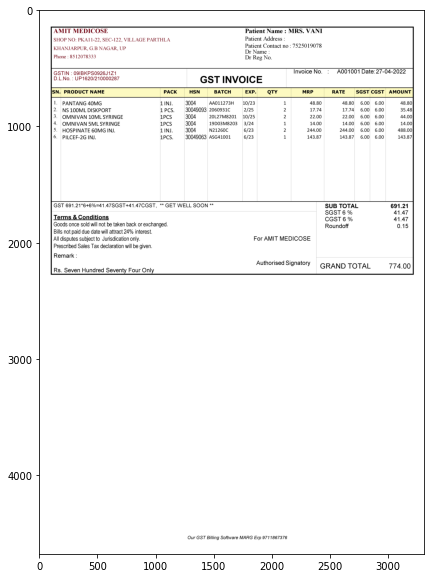


 {'Patient Name': 'MRS. VAN', 'Patient Mobile Number': [7525019078, 8512078333], 'Patient Address': '', 'Date': '27-04-2022', 'Invoice Number': 'A001001'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,PANTANG 4OMG,1 INJ.,3004,AA011273H,10/23,1,48.80,48.80,6.00,6.00,48.80
1,2.,NS 1OOML DISKPORT,1 PCS.,30049093,2060931C,2/25,BLANK,17.74,17.74,6.00,6.00,35.48
2,3.,OMNIVAN 1OML SYRINGE,1PCS,3004,20L27M8201,10/25,2,22.00,22.00,6.00,6.00,44.00
3,4.,OMNIVAN 5ML SYRINGE,1PCS,3004,19D03M8203,3/24,1,14.00,14.00,6.00,6.00,14.00
4,5.,HOSPINATE 6OMG INJ,1 INJ.,3004,N21260C,6/23,2,244.00,244.00,6.00,6.00,488.00
5,6.,PILCEF-2G INJ.,1PCS.,30049063,ASG41001,6/23,1,143.87,143.87,6.00,6.00,143.87



 {'SUB TOTAL': 691.21, 'SGST 6 %': 41.47, 'CGST 6 %': 41.47, 'Roundoff': 0.15, 'GRAND TOTAL': 774.0} 


-----------------------------------------------------------------------------------------------------------------------

83-52-1647850159728.png


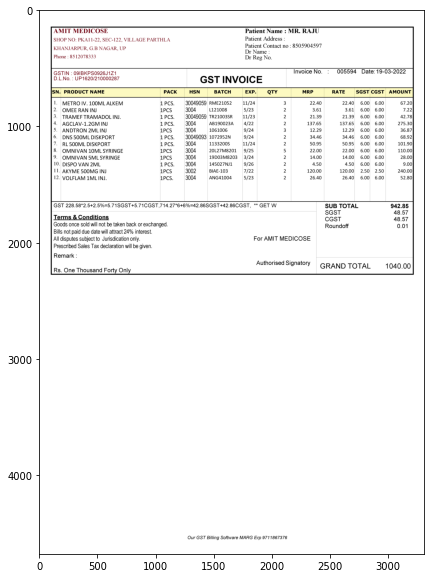


 {'Patient Name': 'MR. RAJU', 'Patient Mobile Number': [8505904597, 8512078333], 'Patient Address': '', 'Date': '19-03-2022', 'Invoice Number': '005594'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,METRO IV. 1OOMLALKEM,1 PCS.,30049059,RME21052,11/24,3,22.40,22.40,6.00,6.00,67.20
1,2.,OMEE RANINJ,1PCS,3004,L121008,5/23,2,3.61,3.61,6.00,6.00,7.22
2,3.,TRAMEE TRAMADOLINJ,1 PCS.,30049059,TR21003SR,11/23,2,21.39,21.39,6.00,6.00,42.78
3,4.,AGCLAV-1.2GM INJ,1 PCS.,3004,AB190023A,4/22,2,137.65,137.65,6.00,6.00,275.30
4,5.,ANDTRON 2MLINJ,1PCS,3004,1061006,9/24,3,12.29,12.29,6.00,6.00,36.87
5,6.,DNS 50OMLDISKPORT,1 PCS.,30049093,1072952N,9/24,2,34.46,34.46,6.00,6.00,68.92
6,7.,RL 50OML DISKPORT,1 PCS.,3004,1133200S,11/24,2,50.95,50.95,6.00,6.00,101.90
7,8.,OMNIVAN 1OMLSYRINGE,1PCS,3004,20L27M8201,9/25,5,22.00,22.00,6.00,6.00,110.00
8,9.,OMNIVAN 5ML SYRINGE,1PCS,3004,19D03M8203,3/24,2,14.00,14.00,6.00,6.00,28.00
9,10.,DISPO VAN 2ML,1 PCS.,3004,145027NJ1,9/26,2,4.50,4.50,6.00,6.00,9.00



 {'SUB TOTAL': 942.85, 'SGST': 48.57, 'CGST': 48.57, 'Roundoff': 0.01, 'GRAND TOTAL': 1040.0} 


-----------------------------------------------------------------------------------------------------------------------

86-49-1642687271813.png


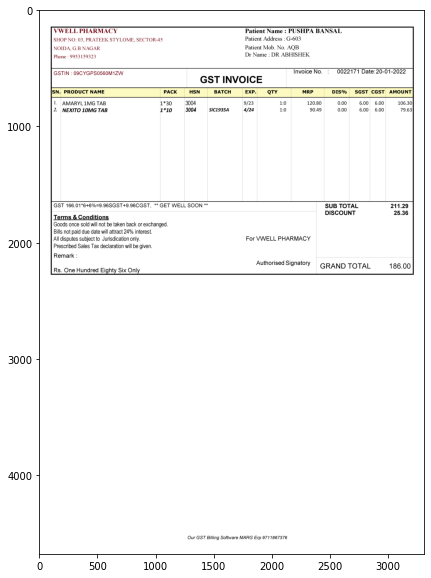


 {'Patient Name': 'PUSHPA BANSAL', 'Patient Mobile Number': [9953159323], 'Patient Address': 'G603', 'Date': '20-01-2022', 'Invoice Number': '0022171'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DIS%,SGST,CGST,AMOUNT
0,1.,AMARYL 1MG TAB,1*30,3004,BLANK,9/23,1:0,120.80,0.00,6.00,6.00,106.30
1,2.,NEXITO 10MG TAB,1*10,3004,SIC1935A,4/24,1:0,90.49,0.00,6.00,6.00,79.63



 {'SUB TOTAL': 211.29, 'DISCOUNT': 25.36, 'GRAND TOTAL': 186.0} 


-----------------------------------------------------------------------------------------------------------------------

86-40-1642339467561.png


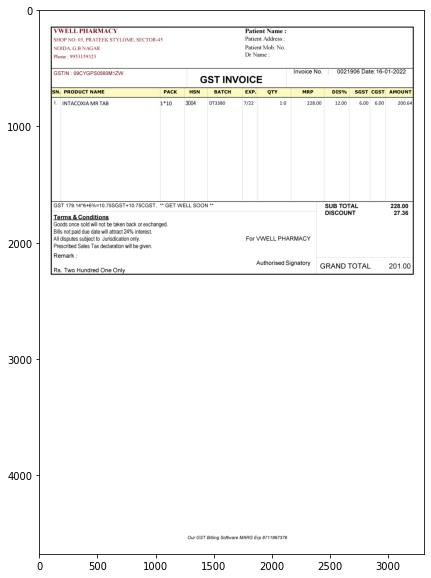


 {'Patient Name': '', 'Patient Mobile Number': [9953159323], 'Patient Address': '', 'Date': '16-01-2022', 'Invoice Number': '0021906'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DIS%,SGST,CGST,AMOUNT
0,1.,INTACOXIA MR TAB,1*10,3004,DT3380,7/22,1:0,228.00,12.00,6.00,6.00,200.64



 {'SUB TOTAL': 228.0, 'DISCOUNT': 27.36, 'GRAND TOTAL': 201.0} 


-----------------------------------------------------------------------------------------------------------------------

86-25-1641721268871.png


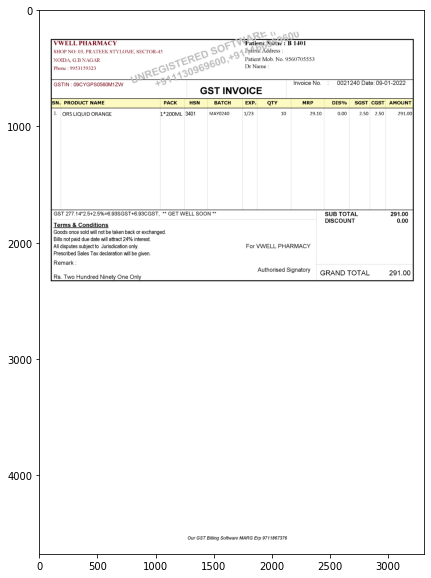


 {'Patient Name': '', 'Patient Mobile Number': [9560705553, 9953159323], 'Patient Address': '', 'Date': '09-01-2022', 'Invoice Number': '0021240'} 



,SN.,PRODUCT NAME,PACK,BLANK,BLANK,BLANK,BLANK,MRP,DIS%,SGSt,CGST,AMOUNT
0,1.,ORS LIQUID ORANGE,1*200ML,BLANK,BLANK,BLANK,BLANK,29.10,0.00,2.50,2.50,291.00



 {'SUB TOTAL': 291.0, 'DISCOUNT': 0.0, 'GRAND TOTAL': 291.0} 


-----------------------------------------------------------------------------------------------------------------------

86-31-1642512176325.png


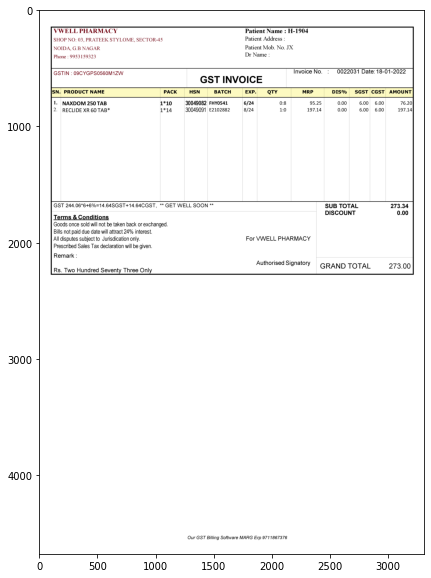


 {'Patient Name': 'H1904', 'Patient Mobile Number': [9953159323], 'Patient Address': '', 'Date': '18-01-2022', 'Invoice Number': '0022031'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DIS%,SGST,CGST,AMOUNT
0,1.,NAXDOM 250 TAB,1*10,30049082,FHY0541,6/24,0:8,95.25,0.00,6.00,6.00,76.20
1,2.,RECLIDE XR 60 TAB*,1*14,30049091,E2102882,8/24,1:0,197.14,0.00,6.00,6.00,197.14



 {'SUB TOTAL': 273.34, 'DISCOUNT': 0.0, 'GRAND TOTAL': 273.0} 


-----------------------------------------------------------------------------------------------------------------------

91-9-1646471391417.png


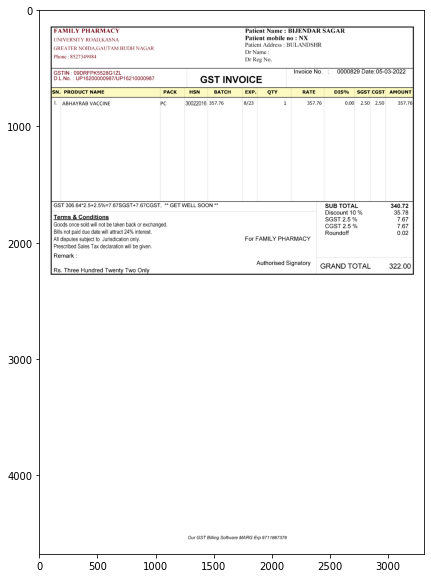


 {'Patient Name': 'BIJENDAR SAGAR', 'Patient Mobile Number': [8527349084], 'Patient Address': 'BULANDSHR', 'Date': '05-03-2022', 'Invoice Number': '0000829'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,RATE,DIS%,SGST,CGST,AMOUnT
0,1.,ABHAYRAB VACCINE,PC,30022016,357.76,8/23,1,357.76,0.00,2.50,2.50,357.76



 {'SuB tOtAL': 340.72, 'Discount 10 %': 35.78, 'SGST 2.5 %': 7.67, 'CGSt 2.5 %': 7.67, 'Roundoff': 0.02, 'GRAND TOTAL': 322.0} 


-----------------------------------------------------------------------------------------------------------------------

91-1-1641208938362.png


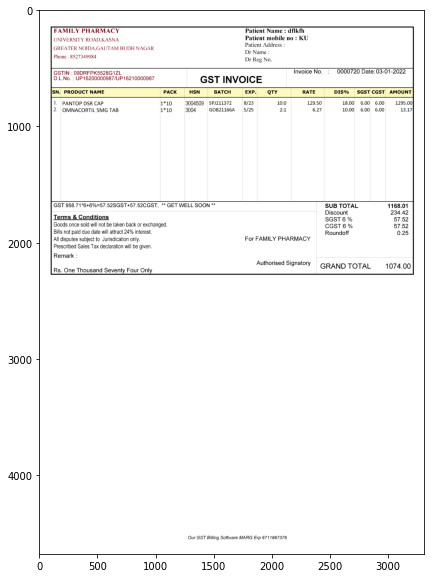


 {'Patient Name': 'dflkfh', 'Patient Mobile Number': [8527349084], 'Patient Address': '', 'Date': '03-01-2022', 'Invoice Number': '0000720'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,RATE,DIS%,SGST,CGST,AMOUnT
0,1.,PANTOP DSR CAP,1*10,3004509,SPJ211372,8/23,10:0,129.50,18.00,6.00,6.00,1295.00
1,2.,OMNACORTIL 5MG TAB,1*10,3004,G0B21166A,5/25,2:1,6.27,10.00,6.00,6.00,13.17



 {'SUB TOTAL': 1168.01, 'Discount': 234.42, 'SGST 6 %': 57.52, 'CGST 6 %': 57.52, 'Roundoff': 0.25, 'GRAND TOTAL': 1074.0} 


-----------------------------------------------------------------------------------------------------------------------

91-5-1647426252895.png


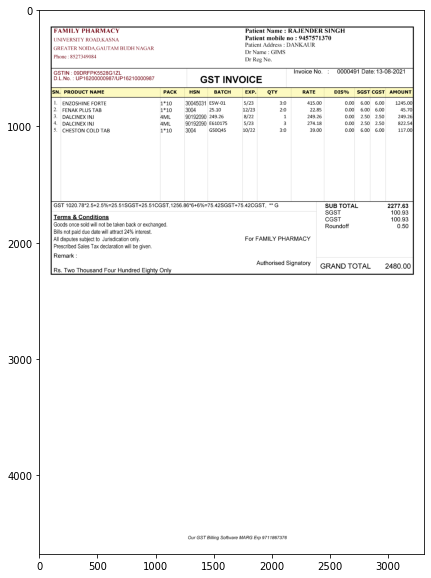


 {'Patient Name': 'RAJENDER SINGH', 'Patient Mobile Number': [9457571370, 8527349084], 'Patient Address': 'DANKAUR', 'Date': '13-08-2021', 'Invoice Number': '0000491'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,RATE,DIS%,SGST,CGST,AMOUnT
0,1.,ENZOSHINE EORTE,1*10,30045031,ESW-01,5/23,3:0,415.00,0.00,6.00,6.00,1245.00
1,2.,FENAK PLUS TAB,1*10,3004,25.10,12/23,2:0,22.85,0.00,6.00,6.00,45.70
2,3.,DALCINEX INJ,4ML,90192090,249.26,8/22,1,249.26,0.00,2.50,2.50,249.26
3,4.,DALCINEX INJ,4ML,90192090,E610175,5/23,3,274.18,0.00,2.50,2.50,822.54
4,5.,CHESTON COLD TAB,1*10,3004,GS0Q45,10/22,3:0,39.00,0.00,6.00,6.00,117.00



 {'SUB TOTAL': 2277.63, 'SGST': 100.93, 'CGST': 100.93, 'Roundoff': 0.5, 'GRAND TOTAL': 2480.0} 


-----------------------------------------------------------------------------------------------------------------------

94-2-1645167904487.png


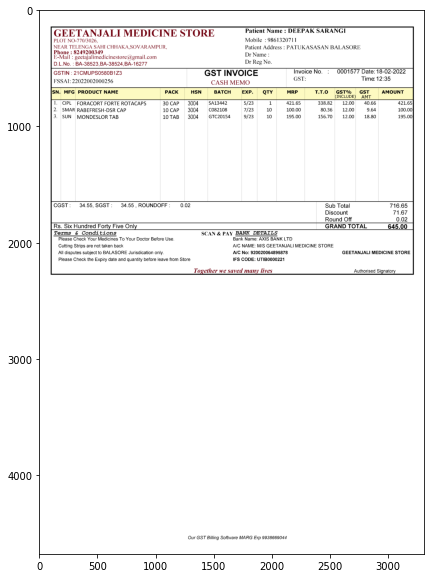


 {'Patient Name': 'DEEPAK SARANGI', 'Patient Mobile Number': [9861320711, 8249200349], 'Patient Address': 'PATUKASASAN BALASORE', 'Date': '18-02-2022', 'Invoice Number': '0001577'} 



,SN.,MFG,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,T.T.0,GST%,GST,AMOUnT
0,1.,CIPL,FORACORT EORTE ROTACAPS,30 CAP,3004,SA13442,5/23,1,421.65,338.82,12.00,40.66,421.65
1,2.,SMAR,RABEFRESH-DSR CAP,10 CAP,3004,C082108,7/23,10,100.00,80.36,12.00,9.64,100.00
2,3.,SUN,MONDESLOR TAB,10 TAB,3004,GTC20154,9/23,10,195.00,156.70,12.00,18.80,195.00



 {'Sub Total': 716.65, 'Discount': 71.67, 'Round Off': 0.02, 'GRAND TOTAL': 645.0} 


-----------------------------------------------------------------------------------------------------------------------

94-11-1647533482145.png


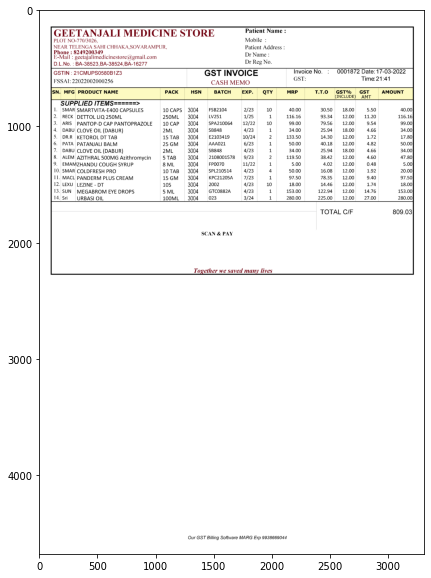


 {'Patient Name': '', 'Patient Mobile Number': [8249200349], 'Patient Address': '', 'Date': '17-03-2022', 'Invoice Number': '0001872'} 



,SN.,MFG,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,t.t.0,GST%,GST,AMOUnt
0,1.,SMAR,SMARTVITA-E4O0 CAPSULES,10 CAPS,3004,FSB2104,2/23,10,40.00,30.50,18.00,5.50,40.00
1,2.,RECK,DETTOL LIQ 250ML,250ML,3004,LV251,1/25,1,116.16,93.34,12.00,11.20,116.16
2,3.,ARIS,PANTOP-D CAP PANTOPRAZOLE,10 CAP,3004,SPA210064,12/22,10,99.00,79.56,12.00,9.54,99.00
3,4.,DABU,CLOVE OIL (DABUR},2ML,3004,SB848,4/23,1,34.00,25.94,18.00,4.66,34.00
4,5.,DR.R,KETOROL DT TAB,15 TAB,3004,E2103419,10/24,2,133.50,14.30,12.00,1.72,17.80
5,6.,PATA,PATANJALLBALM,25 GM,3004,AAA021,6/23,1,50.00,40.18,12.00,4.82,50.00
6,7.,DABU,CLOVE OIL (DABUR,2ML,3004,SB848,4/23,1,34.00,25.94,18.00,4.66,34.00
7,8.,ALEM,AZITHRAL 500MG Azithromycin,5 TAB,3004,2108001578,9/23,2,119.50,38.42,12.00,4.60,47.80
8,9.,EMAM,ZHANDU COUGH SYRUP,8 ML,3004,FP0070,11/22,1,5.00,4.02,12.00,0.48,5.00
9,10.,SMAR,COLDFRESH PRO,10 TAB,3004,SPL210514,4/23,4,50.00,16.08,12.00,1.92,20.00



 {'TOTAL C/E': 809.03} 


-----------------------------------------------------------------------------------------------------------------------

94-6-1644914184583.png


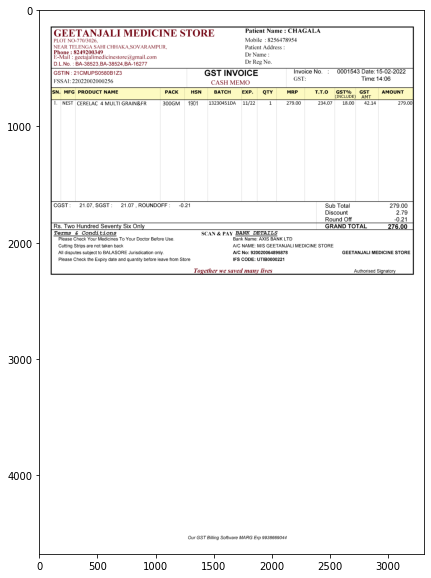


 {'Patient Name': 'CHAGALA', 'Patient Mobile Number': [8256478954, 8249200349], 'Patient Address': '', 'Date': '15-02-2022', 'Invoice Number': '0001543'} 



,SN.,MFG,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,t.t.0,GST%,GST,AMOUnt
0,1.,NEST,CERELAC 4 MULTLGRAIN&ER,300GM,1901,13230451DA,11/22,1,279.00,234.07,18.00,42.14,279.00



 {'Sub Total': 279.0, 'Discount': 2.79, 'Round Off': -0.21, 'GRAND TOTAL': 276.0} 


-----------------------------------------------------------------------------------------------------------------------

94-6-1644849046157.png


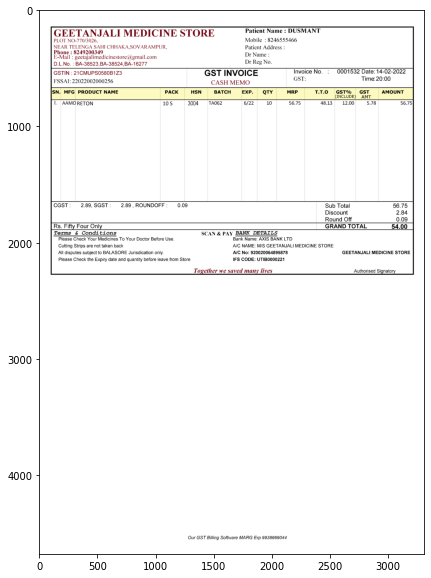


 {'Patient Name': 'DUSMANT', 'Patient Mobile Number': [8246555466, 8249200349], 'Patient Address': '', 'Date': '14-02-2022', 'Invoice Number': '0001532'} 



,SN.,MFG,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,t.t.0,GST%,GST,AMOUnT
0,1.,AAMC,RETON,10 S,3004,TA062,6/22,10,56.75,48.13,12.00,5.78,56.75



 {'Sub Total': 56.75, 'Discount': 2.84, 'Round Off': 0.09, 'GRAND TOTAL': 54.0} 


-----------------------------------------------------------------------------------------------------------------------

94-11-1651236870110.png


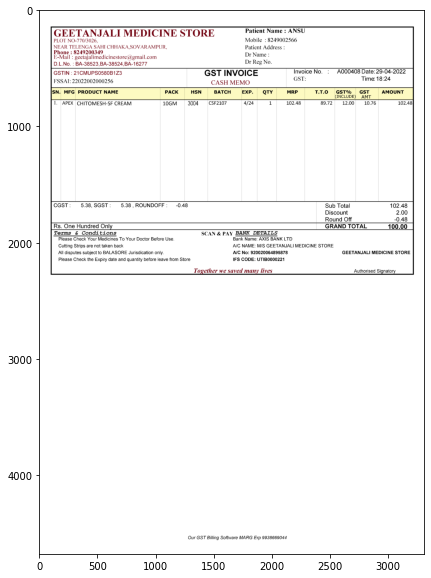


 {'Patient Name': 'ANSU', 'Patient Mobile Number': [8249002566, 8249200349], 'Patient Address': '', 'Date': '29-04-2022', 'Invoice Number': 'A000408'} 



,SN.,MFG,PRODUCt NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,t.t.0,GST%,GST,AMOUnt
0,1.,APEX,CHITOMESH-SE CREAM,10GM,3004,CSF2107,4/24,1,102.48,89.72,12.00,10.76,102.48



 {'Sub Total': 102.48, 'Discount': 2.0, 'Round Off': -0.48, 'GRAND TOTAL': 100.0} 


-----------------------------------------------------------------------------------------------------------------------

95-2-1642683243838.png


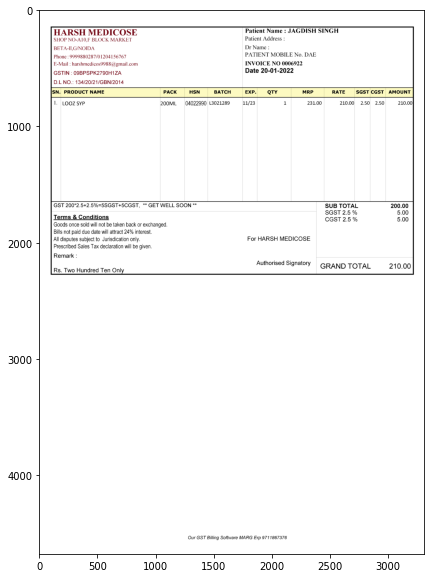


 {'Patient Name': 'JAGDISH SINGH', 'Patient Mobile Number': [], 'Patient Address': '', 'Date': '20-01-2022', 'Invoice Number': '0006922'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,LOOZ SYP,200ML,04022990,L3021289,11/23,1,231.00,210.00,2.50,2.50,210.00



 {'SUB TOTAL': 200.0, 'SGST 2.5 %': 5.0, 'CGST 2.5 %': 5.0, 'GRAND TOTAL': 210.0} 


-----------------------------------------------------------------------------------------------------------------------

95-3-1650720490978.png


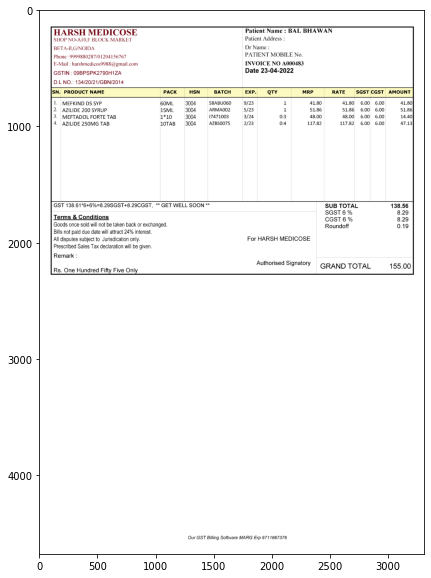


 {'Patient Name': 'BAL BHAWAN', 'Patient Mobile Number': [], 'Patient Address': '', 'Date': '23-04-2022', 'Invoice Number': 'A000483'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnt
0,1.,MEFKIND DS SYP,60ML,3004,S8ABU060,9/23,1,41.80,41.80,6.00,6.00,41.80
1,2.,AZILIDE 200 SYRUP,15ML,3004,ARMA002,5/23,1,51.86,51.86,6.00,6.00,51.86
2,3.,MEETADOL EORTE TAB,1*10,3004,17471003,3/24,0:3,48.00,48.00,6.00,6.00,14.40
3,4.,AZILIDE 250MG TAB,10TAB,3004,AZBS0075,2/23,0:4,117.82,117.82,6.00,6.00,47.13



 {'SUB TOTAL': 138.56, 'SGST 6 %': 8.29, 'CGST 6 %': 8.29, 'Roundoff': 0.19, 'GRAND TOTAL': 155.0} 


-----------------------------------------------------------------------------------------------------------------------

95-5-1649851569191.png


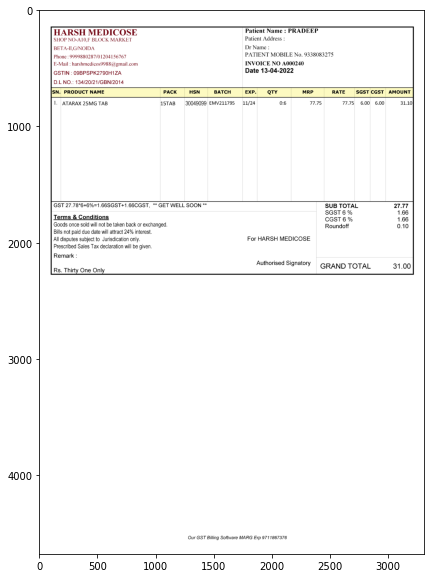


 {'Patient Name': 'PRADEEP', 'Patient Mobile Number': [9338083275], 'Patient Address': '', 'Date': '13-04-2022', 'Invoice Number': 'A000240'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,ATARAX 25MG TAB,15TAB,30049099,EMV211795,11/24,0:6,77.75,77.75,6.00,6.00,31.10



 {'SUB TOTAL': 27.77, 'SGST 6 %': 1.66, 'CGST 6 %': 1.66, 'Roundoff': 0.1, 'GRAND TOTAL': 31.0} 


-----------------------------------------------------------------------------------------------------------------------

95-3-1648012148328.png


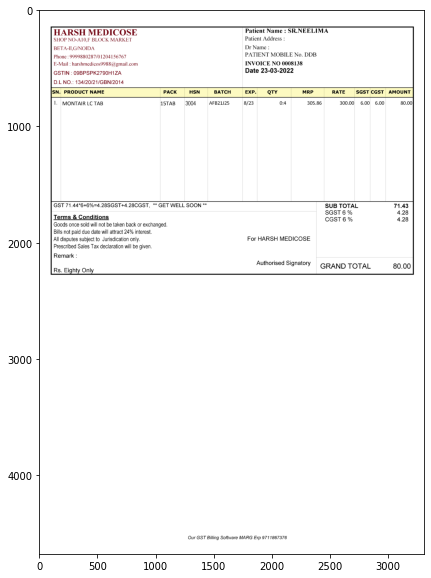


 {'Patient Name': 'SR.NEELIMA', 'Patient Mobile Number': [], 'Patient Address': '', 'Date': '23-03-2022', 'Invoice Number': '0008138'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,MONTAIR LC TAB,15TAB,3004,AFB21J25,8/23,0:4,305.86,300.00,6.00,6.00,80.00



 {'SUB TOTAL': 71.43, 'SGST 6 %': 4.28, 'CGST 6 %': 4.28, 'GRAND TOTAL': 80.0} 


-----------------------------------------------------------------------------------------------------------------------

95-1-1650777650457.png


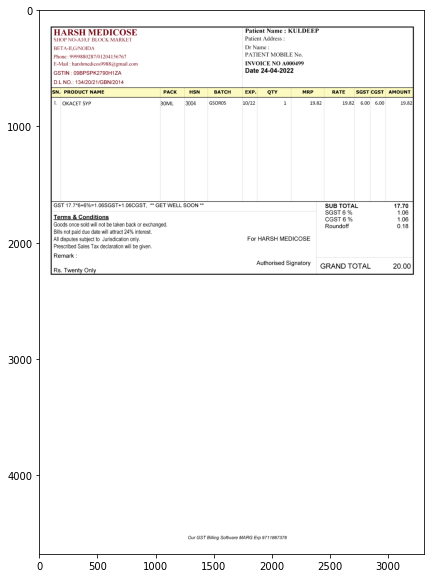


 {'Patient Name': 'KULDEEP', 'Patient Mobile Number': [], 'Patient Address': '', 'Date': '24-04-2022', 'Invoice Number': 'A000499'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,OKACET SYP,30ML,3004,GSOR05,10/22,1,19.82,19.82,6.00,6.00,19.82



 {'SUB TOTAL': 17.7, 'SGST 6 %': 1.06, 'CGST 6 %': 1.06, 'Roundoff': 0.18, 'GRAND TOTAL': 20.0} 


-----------------------------------------------------------------------------------------------------------------------

98-10-1650865519162.png


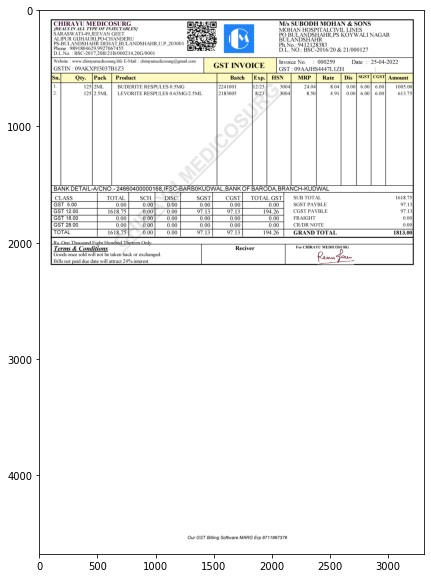


 {'Patient Name': 'SUBODH MOHAN & SONS', 'Patient Mobile Number': [9412128383, 9891804629, 9927067455], 'Patient Address': '', 'Date': '25-04-2022', 'Invoice Number': '000259'} 



,Sn.,Qty.,Pack,Product,Batch,Exp.,HSN,MRP,Rate,Dis,SGST,CGST,Amount
0,1.,125,2ML,BUDERITE RESPULES 0.5MG,BLANK,12/23,3004,24.04,8.04,0.00,6.00,6.00,1005.00
1,2.,125,2.5ML,LEVORITE RESPULES 0.63MG/2.5ML,2183005,8/23,3004,8.50,4.91,0.00,6.00,6.00,613.75



 {'SUB TOTAL': 1618.75, 'SGST PAYBLE': 97.13, 'CGST PAYBLE': 97.13, 'FRAIGHT': 0.0, 'CR/DR NOTE': 0.0, 'GRAND TOTA': 1813.0} 


-----------------------------------------------------------------------------------------------------------------------

98-42-1649930821811.png


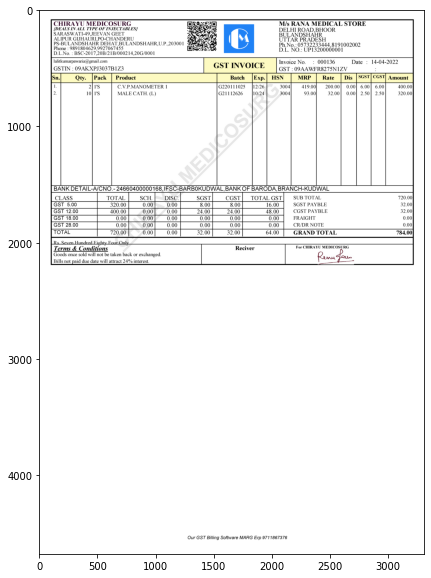


 {'Patient Name': 'RANA MEDICAL STORE', 'Patient Mobile Number': [5732233444, 8191002002, 9891804629, 9927067455], 'Patient Address': '', 'Date': '14-04-2022', 'Invoice Number': '000136'} 



,Sn.,Qty.,Pack,Product,Batch,Exp.,HSN,MRP,Rate,Dis,SGST,CGST,Amount
0,1.,2,1's,C.VP.MANOMETER I,BLANK,12/26,3004,419.00,200.00,0.00,6.00,6.00,400.00
1,2.,10,1's,MALE CATH. (L),G21112626,10/24,3004,93.00,32.00,0.00,2.50,2.50,320.00



 {'SUB TOTAL': 720.0, 'SGST PAYBLE': 32.0, 'CGST PAYBLE': 32.0, 'FRAIGHT': 0.0, 'CR/DR NOTE': 0.0, 'GRAND TOTA': 784.0} 


-----------------------------------------------------------------------------------------------------------------------

98-32-1650424559928.png


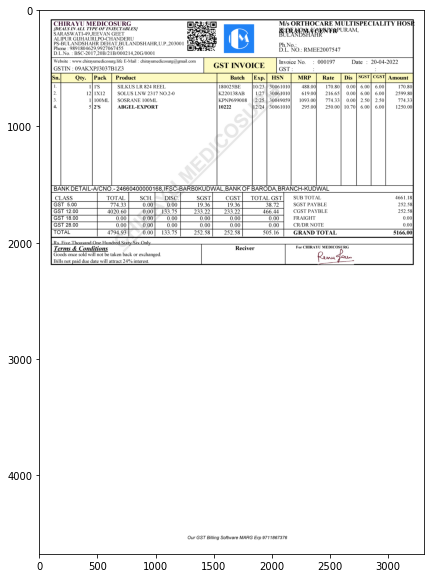


 {'Patient Name': 'ORTHOCARE MULTISPECIALITV HOSI', 'Patient Mobile Number': [9891804629, 9927067455], 'Patient Address': '', 'Date': '20-04-2022', 'Invoice Number': '000197'} 



,Sn.,Qty.,Pack,Product,Batch,Exp.,HSN,MRP,Rate,Dis,SGST,CGST,Amount
0,1.,1,1's,BLANK,180025BE,10/23,30061010,488.00,170.80,0.00,6.00,6.00,170.80
1,2.,12,1X12,SOLUS LNW 2317 NO.2-0,K220138AB,1/27,30061010,619.00,216.65,0.00,6.00,6.00,2599.80
2,3.,1,100ML,SOSRANE 100ML,KPNP699008,2/25,30049059,1093.00,774.33,0.00,2.50,2.50,774.33
3,4.,5,2'S,ABGEL-EXPORT,10222,12/24,30061010,295.00,250.00,10.70,6.00,6.00,1250.00



 {'SUB TOTAL': 4661.18, 'SGST PAYBLE': 252.58, 'CGST PAYBLE': 252.58, 'FRAIGHT': 0.0, 'CR/DR NOTE': 0.0, 'GRAND TOTA': 5166.0} 


-----------------------------------------------------------------------------------------------------------------------

108-13-1650041982235.png


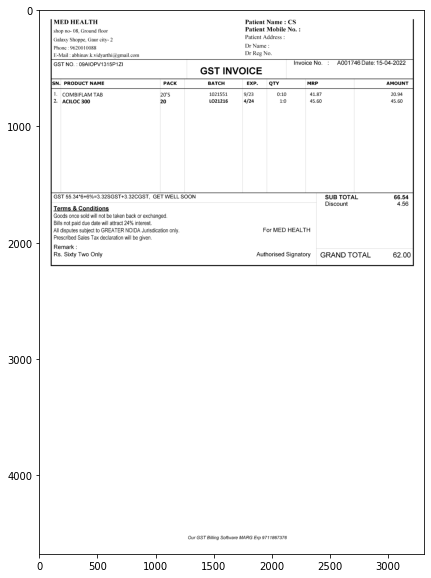


 {'Patient Name': 'CS', 'Patient Mobile Number': [9620010088], 'Patient Address': '', 'Date': '15-04-2022', 'Invoice Number': 'A001746'} 



,SN.,PRODUCT NAME,PACK,BATCH,EXP.,QTY,MRP,AMOUnT
0,1.,COMBIELAMTAB,20'S,1021551,9/23,0:10,41.87,20.94
1,2.,ACIL0C 300,20,L021216,4/24,1:0,45.60,45.60



 {'SUB TOTAL': 66.54, 'Discount': 4.56, 'Signatory GRAND TOTAL': 62.0} 


-----------------------------------------------------------------------------------------------------------------------

109-1-1642667536072.png


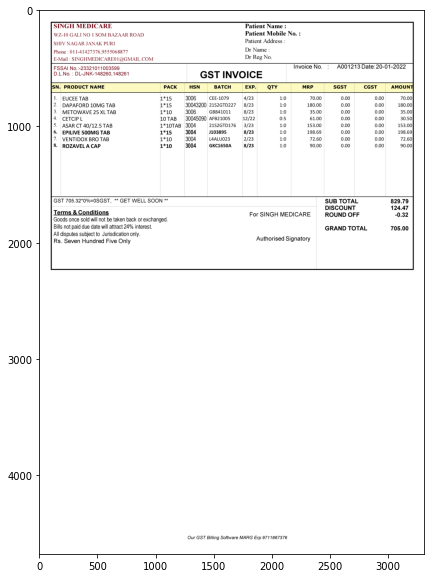


 {'Patient Name': '', 'Patient Mobile Number': [9555068877], 'Patient Address': '', 'Date': '20-01-2022', 'Invoice Number': 'A001213'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,SGST,CGST,AMOUNT
0,1.,EUCEE TAB,1*15,3006,CEE-1079,4/23,1:0,70.00,0.00,0.00,70.00
1,2.,DAPAFORD 1OMG TAB,1*15,30043200,21S2GTD227,8/23,1:0,180.00,0.00,0.00,180.00
2,3.,METOWAVE 25 XL TAB,1*10,3006,GB841011,8/23,1:0,35.00,0.00,0.00,35.00
3,4.,CETCIP L,10 TAB,30045090,AFB21005,12/22,0:5,61.00,0.00,0.00,30.50
4,5.,ASAR CT 40/12.5 TAB,1*10TAB,3004,21S2GTD176,3/23,1:0,153.00,0.00,0.00,153.00
5,6.,EPILIVE 500MG TAB,1*15,3004,J103895,8/23,1:0,198.69,0.00,0.00,198.69
6,7.,VENTIDOX BRO TAB,1*10,3004,L4ALU023,2/23,1:0,72.60,0.00,0.00,72.60
7,8.,ROZAVEL A CAP,1*10,3004,GKC1650A,8/23,1:0,90.00,0.00,0.00,90.00



 {'SUB TOTAL': 829.79, 'DISCOUNT': 124.47, 'EDICARE ROUND OFF': -0.32, 'GRAND TOTAL': 705.0} 


-----------------------------------------------------------------------------------------------------------------------

109-1-1641289664304.png


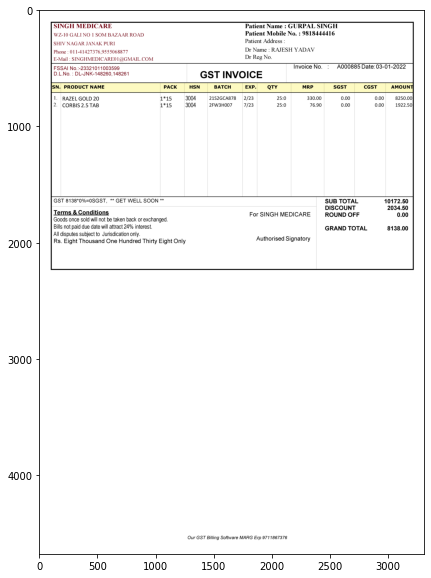


 {'Patient Name': 'GURPAL SINGH', 'Patient Mobile Number': [9818444416, 9555068877], 'Patient Address': '', 'Date': '03-01-2022', 'Invoice Number': 'A000885'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,SGST,CGST,AMOUNT
0,1.,RAZEL GOLD 20,1*15,3004,21S2GCA878,2/23,25:0,330.00,0.00,0.00,8250.00
1,2.,CORBIS 2.5 TAB,1*15,3004,2FW3H007,7/23,25:0,76.90,0.00,0.00,1922.50



 {'SUB TOTAL': 10172.5, 'DISCOUNT': 2034.5, 'EDICARE ROUND OFF': 0.0, 'GRAND TOTAL': 8138.0} 


-----------------------------------------------------------------------------------------------------------------------

110-2-1649220780524.png


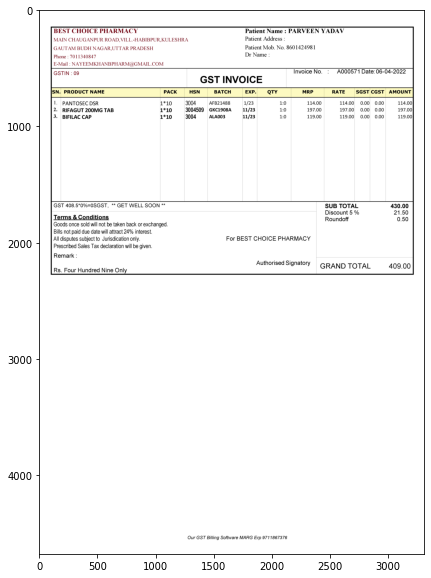


 {'Patient Name': 'PARVEEN YADAV', 'Patient Mobile Number': [8601424981, 7011340847], 'Patient Address': '', 'Date': '06-04-2022', 'Invoice Number': 'A000571'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,PANTOSEC DSR,1*10,3004,AFB21488,1/23,1:0,114.00,114.00,0.00,0.00,114.00
1,2.,RIFAGUT 200MG TAB,1*10,3004509,GKC1908A,11/23,1:0,197.00,197.00,0.00,0.00,197.00
2,3.,BIFILAC CAP,1*10,3004,ALA003,11/23,1:0,119.00,119.00,0.00,0.00,119.00



 {'SUB TOTAL': 430.0, 'Discount 5 %': 21.5, 'Roundoff': 0.5, 'GRAND TOTAL': 409.0} 


-----------------------------------------------------------------------------------------------------------------------

110-1-1647508353191.png


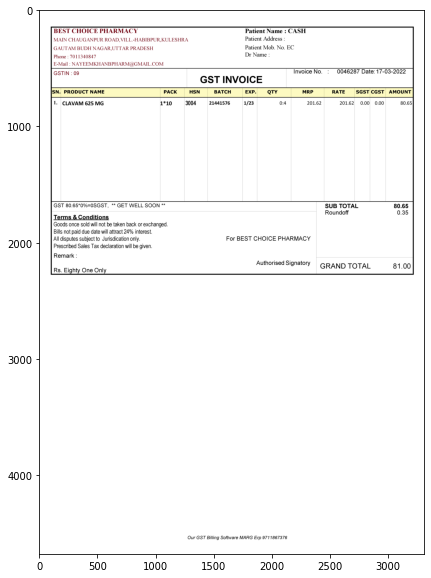


 {'Patient Name': 'CASH', 'Patient Mobile Number': [7011340847], 'Patient Address': '', 'Date': '17-03-2022', 'Invoice Number': '0046287'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,CLAVAM 625 MG,1*10,3004,21441576,1/23,0:4,201.62,201.62,0.00,0.00,80.65



 {'SUB TOTAL': 80.65, 'Roundoff': 0.35, 'GRAND TOTAL': 81.0} 


-----------------------------------------------------------------------------------------------------------------------

110-1-1646732086804.png


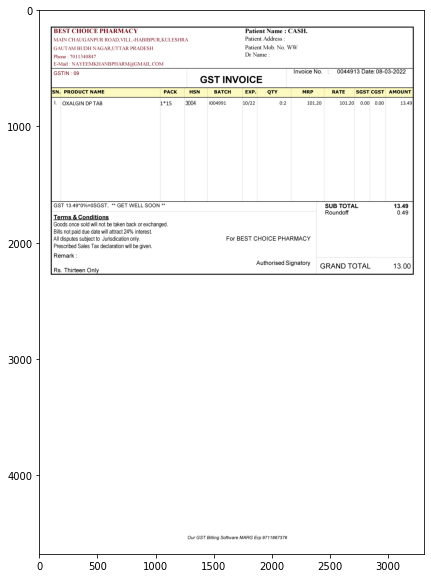


 {'Patient Name': 'CASH.', 'Patient Mobile Number': [7011340847], 'Patient Address': '', 'Date': '08-03-2022', 'Invoice Number': '0044913'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,OXALGIN DP TAB,1*15,3004,I004991,10/22,0:2,101.20,101.20,0.00,0.00,13.49



 {'SUB TOTAL': 13.49, 'Roundoff': 0.49, 'GRAND TOTAL': 13.0} 


-----------------------------------------------------------------------------------------------------------------------

110-2-1649343833391.png


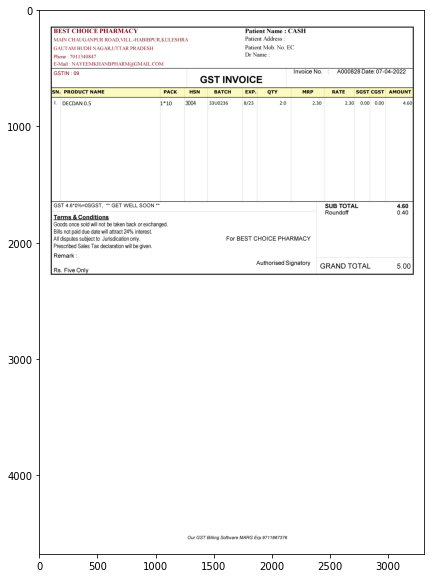


 {'Patient Name': 'CASH', 'Patient Mobile Number': [7011340847], 'Patient Address': '', 'Date': '07-04-2022', 'Invoice Number': 'A000828'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,DECDAN 0.5,1*10,3004,33U0236,8/23,2:0,2.30,2.30,0.00,0.00,4.60



 {'SUB TOTAL': 4.6, 'Roundoff': 0.4, 'GRAND TOTAL': 5.0} 


-----------------------------------------------------------------------------------------------------------------------

112-31-1641476452446.png


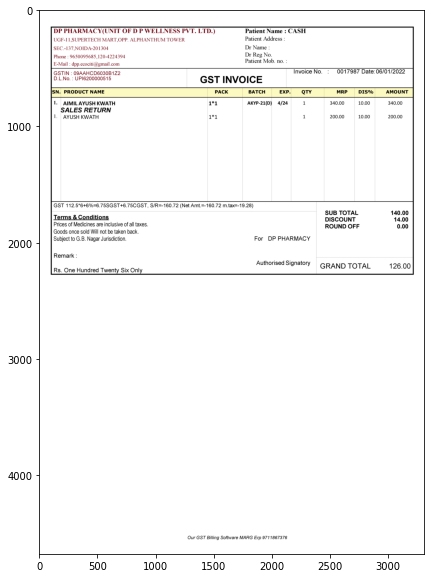


 {'Patient Name': 'CASH', 'Patient Mobile Number': [9650095685], 'Patient Address': '', 'Date': '06/01/2022', 'Invoice Number': '0017987'} 



,SN.,PRODUCT NAME,PACK,BATCH,EXP.,QTY,MRP,DIS%,AMOUNT
0,1.,BLANK,1*1,AKYP-21(D,4/24,1,340.00,10.00,340.00
1,2.,BLANK,1*1,BLANK,BLANK,1,200.00,10.00,200.00



 {'SUB TOTAL': 140.0, 'DISCOUNT': 14.0, 'ROUND OFF': 0.0, 'GRAND TOTAL': 126.0} 


-----------------------------------------------------------------------------------------------------------------------

112-14-1641118811354.png


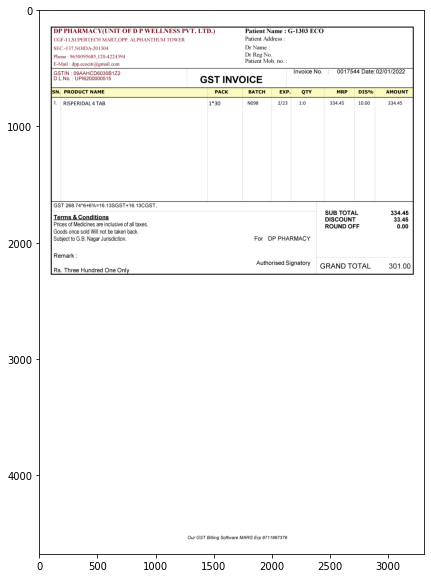


 {'Patient Name': 'G1303 EC0', 'Patient Mobile Number': [9650095685], 'Patient Address': '', 'Date': '02/01/2022', 'Invoice Number': '0017544'} 



,SN.,PRODUCT NAME,PACK,BATCH,EXP.,QTY,MRP,DIS%,AMOUNT
0,1.,RISPERIDAL 4 TAB,1*30,N098,2/23,1:0,334.45,10.00,334.45



 {'SUB TOTAL': 334.45, 'DISCOUNT': 33.45, 'ROUND OFF': 0.0, 'GRAND TOTAL': 301.0} 


-----------------------------------------------------------------------------------------------------------------------

112-20-1641049809243.png


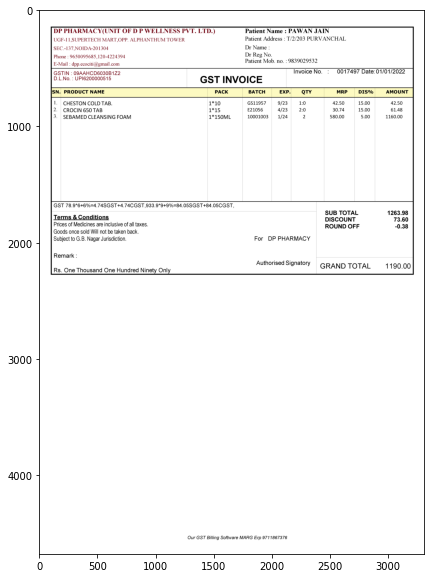


 {'Patient Name': 'PAWAN JAIN', 'Patient Mobile Number': [9650095685, 9839029532], 'Patient Address': 'T/2/203 PURVANCHAL', 'Date': '01/01/2022', 'Invoice Number': '0017497'} 



,SN.,PRODUCT NAME,PACK,BATCH,EXP.,QTY,MRP,DIS%,AMOUNT
0,1.,CHESTON COLD TAB.,1*10,GS11957,9/23,1:0,42.50,15.00,42.50
1,2.,CROCIN 650 TAB,1*15,E21056,4/23,2:0,30.74,15.00,61.48
2,3.,SEBAMED CLEANSING FOAM,1*150ML,10001003,1/24,2,580.00,5.00,1160.00



 {'SUB TOTAL': 1263.98, 'DISCOUNT': 73.6, 'ROUND OFF': -0.38, 'GRAND TOTAL': 1190.0} 


-----------------------------------------------------------------------------------------------------------------------

112-52-1641399954584.png


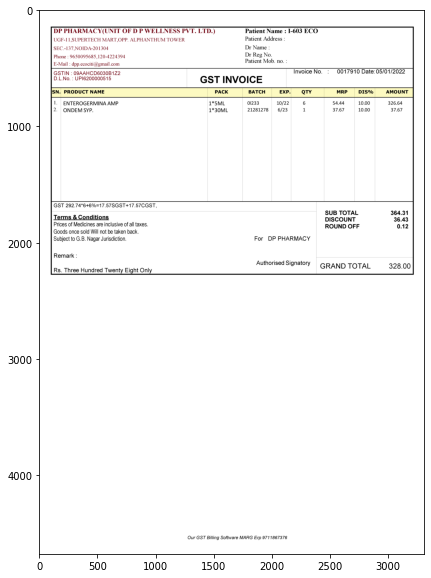


 {'Patient Name': 'I603 ECO', 'Patient Mobile Number': [9650095685], 'Patient Address': '', 'Date': '05/01/2022', 'Invoice Number': '0017910'} 



,SN.,PRODUCT NAME,PACK,BATCH,EXP.,QTY,MRP,DIS%,AMOUNT
0,1.,ENTEROGERMINA AMP,1*5ML,01233,10/22,6,54.44,10.00,326.64
1,2.,ONDEM SYP.,1*30ML,21281278,6/23,1,37.67,10.00,37.67



 {'SUB TOTAL': 364.31, 'DISCOUNT': 36.43, 'ROUND OFF': 0.12, 'GRAND TOTAL': 328.0} 


-----------------------------------------------------------------------------------------------------------------------

112-10-1641113894672.png


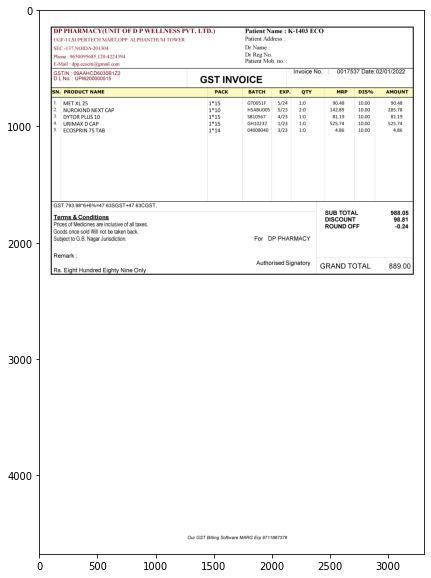


 {'Patient Name': 'K1403 ECO', 'Patient Mobile Number': [9650095685], 'Patient Address': '', 'Date': '02/01/2022', 'Invoice Number': '0017537'} 



,SN.,PRODUCT NAME,PACK,BATCH,EXP.,QTY,MRP,DIS%,AMOUNT
0,1.,MET XL 25,1*15,GT0051F,5/24,1:0,90.48,10.00,90.48
1,2.,NUROKIND NEXT CAP,1*10,H5ABU005,5/23,2:0,142.89,10.00,285.78
2,3.,DYTOR PLUS 10,1*15,SB10567,4/23,1:0,81.19,10.00,81.19
3,4.,URIMAX D CAP,1*15,GH10237,1/23,1:0,525.74,10.00,525.74
4,5.,ECOSPRIN 75 TAB,1*14,04008040,3/23,1:0,4.86,10.00,4.86



 {'SUB TOTAL': 988.05, 'DISCOUNT': 98.81, 'ROUND OFF': -0.24, 'GRAND TOTAL': 889.0} 


-----------------------------------------------------------------------------------------------------------------------

114-2-1641895236518.png


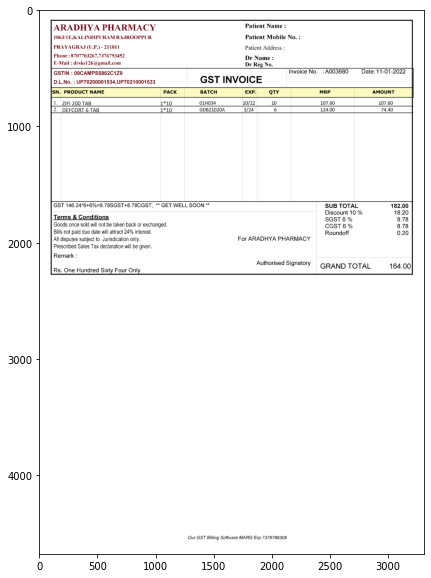


 {'Patient Name': '', 'Patient Mobile Number': [8707703267, 7376793452], 'Patient Address': '', 'Date': '11-01-2022', 'Invoice Number': 'A003680'} 



,SN.,PRODUCt NAME,PACK,BATCH,EXP.,QTY,MRP,AMOUnT
0,1.,ZIFL 20O TAB,1*10,01H034,10/22,10,107.60,107.60
1,2.,DEFCORT 6 TAB,1*10,GDB21020A,3/24,6,124.00,74.40



 {'SuB tOtAL': 182.0, 'Discount 10 %': 18.2, 'SGST 6 %': 8.78, 'CGST 6 %': 8.78, 'Roundoff': 0.2, 'GRAND TOTAL': 164.0} 


-----------------------------------------------------------------------------------------------------------------------

114-1-1642914916503.png


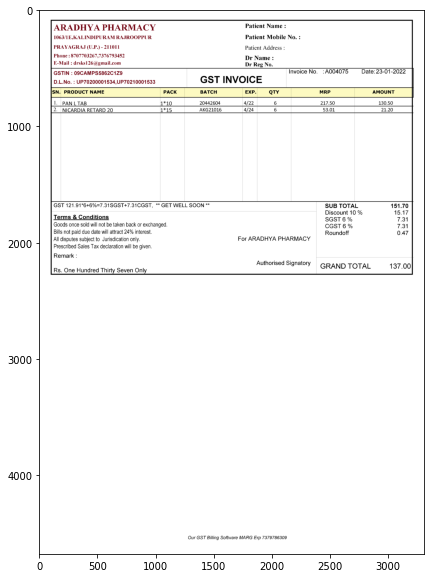


 {'Patient Name': '', 'Patient Mobile Number': [8707703267, 7376793452], 'Patient Address': '', 'Date': '23-01-2022', 'Invoice Number': 'A004075'} 



,SN.,PRODUCT NAME,PACK,BATCH,EXP.,QTY,MRP,AMOUnT
0,1.,PAN LTAB,1*10,20442604,4/22,6,217.50,130.50
1,2.,NICARDIA RETARD 20,1*15,AKG21016,4/24,6,53.01,21.20



 {'SuB tOtAL': 151.7, 'Discount 10 %': 15.17, 'SGST 6 %': 7.31, 'CGST 6 %': 7.31, 'Roundoff': 0.47, 'GRAND TOTAL': 137.0} 


-----------------------------------------------------------------------------------------------------------------------

114-6-1646491561693.png


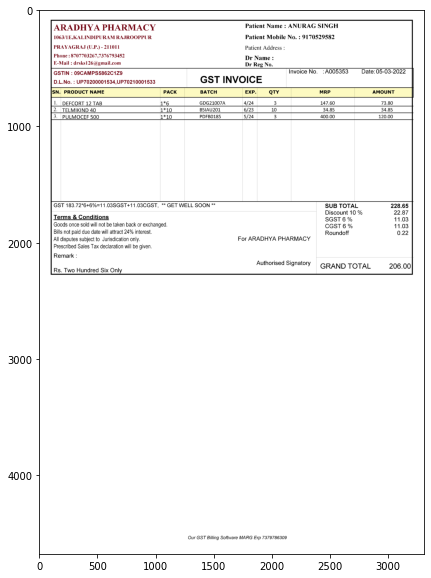


 {'Patient Name': 'ANURAG SINGH', 'Patient Mobile Number': [9170529582, 8707703267, 7376793452], 'Patient Address': '', 'Date': '05-03-2022', 'Invoice Number': 'A005353'} 



,SN.,PRODUCt NAME,PACK,BATCH,EXP.,QTY,MRP,AMOUnT
0,1.,DEFCORT 12 TAB,1*6,GDG21007A,4/24,3,147.60,73.80
1,2.,TELMIKIND 40,1*10,B5IAU201,6/23,10,34.85,34.85
2,3.,PULMOCEF 500,1*10,PDFB0185,5/24,3,400.00,120.00



 {'Sub totAL': 228.65, 'Discount 1o %': 22.87, 'SGST 6 %': 11.03, 'CGST 6 %': 11.03, 'Roundoff': 0.22, 'GRAND TOTAL': 206.0} 


-----------------------------------------------------------------------------------------------------------------------

114-4-1651987288243.png


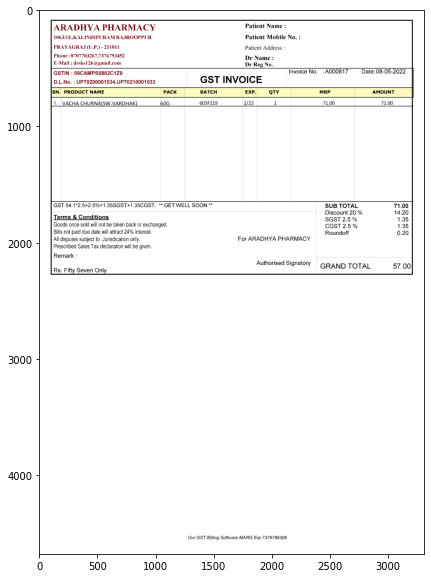


 {'Patient Name': '', 'Patient Mobile Number': [8707703267, 7376793452], 'Patient Address': '', 'Date': '08-05-2022', 'Invoice Number': 'A000817'} 



,SN.,PRODUCT NAME,PACK,BATCH,EXP.,QTY,MRP,AMOUnT
0,1.,VACHA CHURNAISW.VARDHAK,60G,603F219,2/23,1,71.00,71.00



 {'SUB tOtAL': 71.0, 'Discount 20 %': 14.2, 'SGST 2.5 %': 1.35, 'CGST 2.5 %': 1.35, 'Roundoff': 0.2, 'GRAND TOTAL': 57.0} 


-----------------------------------------------------------------------------------------------------------------------

116-10-1647177861336.png


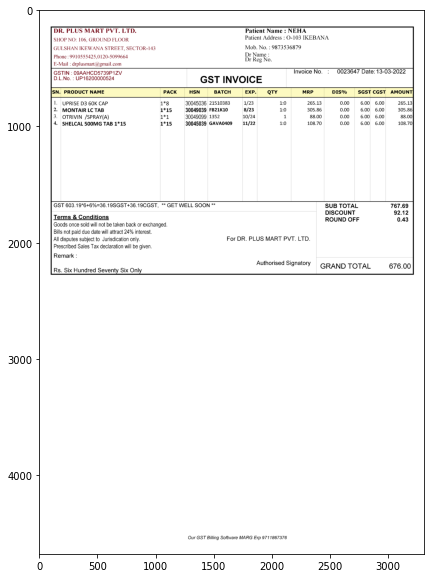


 {'Patient Name': 'NEHA', 'Patient Mobile Number': [9873536879, 9910555425], 'Patient Address': 'O103 IKEBANA', 'Date': '13-03-2022', 'Invoice Number': '0023647'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DIS%,SGST,CGST,AMount
0,1.,UPRISE D3 6OK CAP,1*8,30045036,21510383,1/23,1:0,265.13,0.00,6.00,6.00,265.13
1,2.,MONTAIR LC TAB,1*15,30049039,FB21K10,8/23,1:0,305.86,0.00,6.00,6.00,305.86
2,3.,OTRIVIN /SPRAY(A),1*1,30049099,1352,10/24,1,88.00,0.00,6.00,6.00,88.00
3,4.,SHELCAL 500MG TAB 1*15,1*15,30045039,GAVA0409,11/22,1:0,108.70,0.00,6.00,6.00,108.70



 {'SUB TOTAL': 767.69, 'DISCOUNT': 92.12, 'ROUND OFF': 0.43, 'GRAND TOTAL': 676.0} 


-----------------------------------------------------------------------------------------------------------------------

116-4-1648620031324.png


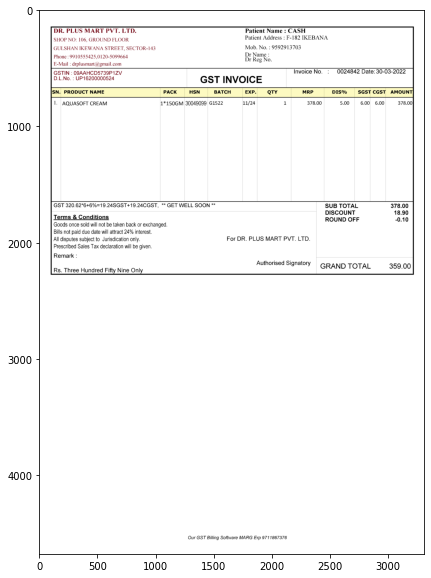


 {'Patient Name': 'CASH', 'Patient Mobile Number': [9592913703, 9910555425], 'Patient Address': 'F182 IKEBANA', 'Date': '30-03-2022', 'Invoice Number': '0024842'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DIS%,SGST,CGST,AMOUnt
0,1.,AQUASOET CREAM,1*150GM,30049099,G1522,11/24,1,378.00,5.00,6.00,6.00,378.00



 {'SUB TOTAL': 378.0, 'DISCOUNT': 18.9, 'ROUND OFF': -0.1, 'GRAND TOTAL': 359.0} 


-----------------------------------------------------------------------------------------------------------------------

116-8-1645543865929.png


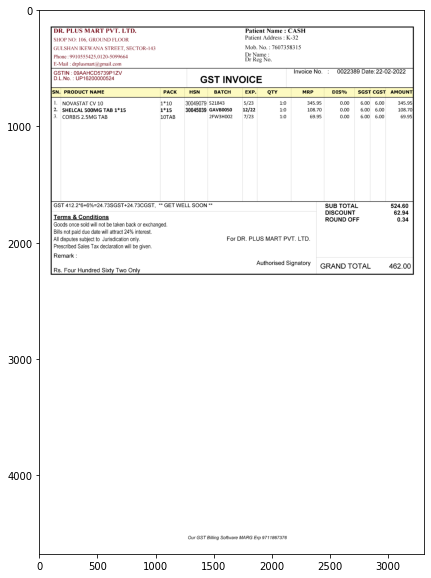


 {'Patient Name': 'CASH', 'Patient Mobile Number': [7607358315, 9910555425], 'Patient Address': 'K32', 'Date': '22-02-2022', 'Invoice Number': '0022389'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DIS%,SGST,CGST,AMount
0,1.,NOVASTAT CV 10,1*10,30049079,S21843,5/23,1:0,345.95,0.00,6.00,6.00,345.95
1,2.,SHELCAL 500MG TAB 1*15,1*15,30045039,GAVB0050,12/22,1:0,108.70,0.00,6.00,6.00,108.70
2,3.,CORBIS 2.5MG TAB,10TAB,BLANK,2FW3H002,7/23,1:0,69.95,0.00,6.00,6.00,69.95



 {'SUB TOTAL': 524.6, 'DISCOUNT': 62.94, 'ROUND OFF': 0.34, 'GRAND TOTAL': 462.0} 


-----------------------------------------------------------------------------------------------------------------------

116-1-1641114734661.png


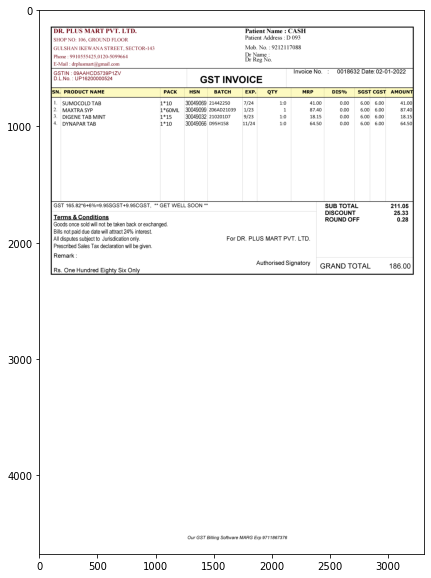


 {'Patient Name': 'CASH', 'Patient Mobile Number': [9212117088, 9910555425], 'Patient Address': 'D 093', 'Date': '02-01-2022', 'Invoice Number': '0018632'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DIS%,SGST,CGST,AMOUNT
0,1.,SUMOCOLD TAB,1*10,30049069,21442250,7/24,1:0,41.00,0.00,6.00,6.00,41.00
1,2.,MAXTRA SYP,1*60ML,30049099,Z06AD21039,1/23,1,87.40,0.00,6.00,6.00,87.40
2,3.,DIGENE TAB MINT,1*15,30049032,210201D7,9/23,1:0,18.15,0.00,6.00,6.00,18.15
3,4.,DYNAPAR TAB,1*10,30049066,D95H158,11/24,1:0,64.50,0.00,6.00,6.00,64.50



 {'SUB TOTAL': 211.05, 'DISCOUNT': 25.33, 'ROUND OFF': 0.28, 'GRAND TOTAL': 186.0} 


-----------------------------------------------------------------------------------------------------------------------

116-8-1651740735207.png


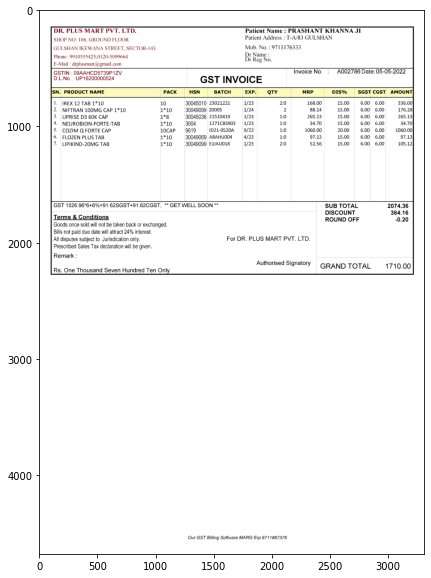


 {'Patient Name': 'PRASHANT KHANNA J', 'Patient Mobile Number': [9711176333, 9910555425], 'Patient Address': 'TA/83 GULSHAN', 'Date': '05-05-2022', 'Invoice Number': 'A002786'} 



,SN.,PRODUCt NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DIS%,SGST,CGST,AMount
0,1.,IREX 12 TAB 1*10,10,30045010,23021221,1/23,2:0,168.00,15.00,6.00,6.00,336.00
1,2.,NIFTRAN 100MG CAP 1*10,1*10,30049099,Z0005,1/24,2,88.14,15.00,6.00,6.00,176.28
2,3.,UPRISE D3 6OK CAP,1*8,30045036,21510419,1/23,1:0,265.13,15.00,6.00,6.00,265.13
3,4.,NEUROBION-FORTE-TAB,1*10,3004,1271C83903,1/23,1:0,34.70,15.00,6.00,6.00,34.70
4,5.,COZIM Q FORTE CAP,10CAP,9619,ID21-0520A,9/22,1:0,1060.00,20.00,6.00,6.00,1060.00
5,6.,FLOZEN PLUS TAB,1*10,30049069,A8AHU004,4/23,1:0,97.13,15.00,6.00,6.00,97.13
6,7.,LIPIKIND-20MG TAB,1*10,30049099,E1IAU018,1/23,2:0,52.56,15.00,6.00,6.00,105.12



 {'SUB TOTAL': 2074.36, 'DISCOUNT': 364.16, 'ROUND OFF': -0.2, 'GRAND TOTAL': 1710.0} 


-----------------------------------------------------------------------------------------------------------------------

117-1-1645510427445.png


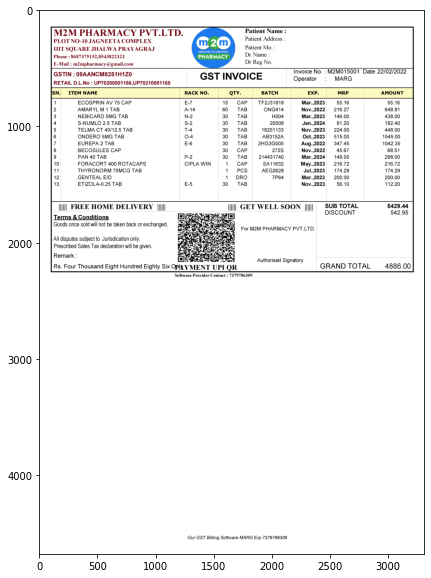


 {'Patient Name': '', 'Patient Mobile Number': [8687375152, 8543822323], 'Patient Address': '', 'Date': '22/02/2022', 'Invoice Number': 'M2M015001'} 



,SN.,ITEM NAME,RACK NO.,QTY.,BATCH,EXP.,MRP,AMOUNT
0,1.,ECOSPRIN AV 75 CAP,E-7,15 CAP,TF2J31818,"Mar.,2023",55.16,55.16
1,2.,AMARYL M 1 TAB,A-14,60 TAB,ONG414,"Nov.,2022",216.27,648.81
2,3.,NEBICARD 5MG TAB,N-2,30 TAB,H004,"Mar.,2023",146.00,438.00
3,4.,S-NUMLO 2.5 tAB,S-2,30 TAB,20008,"Jan.,2024",91.20,182.40
4,5.,TELMA CT 40/12.5 TAB,T-4,30 TAB,18201133,"Nov.,2023",224.00,448.00
5,6.,ONDERO 5MG TAB,O-4,30 TAB,AB3152A,"Oct.,2023",515.00,1545.00
6,7.,EUREPA 2 TAB,E-6,30 TAB,2HG3G005,Aug..2022,347.45,1042.35
7,8.,BECOSULES CAP,BLANK,30 CAP,272S,"Nov.,2022",45.67,68.51
8,9.,PAN 40 TAB,P-2,30 TAB,214431740,"Mar.,2024",149.00,298.00
9,10.,FORACORt 400 ROTACAPS,CIPLA WIN,1 CAP,SA11632,"May.,2023",216.72,216.72



 {'SUB TOTAL OON': 5429.44, 'DISCOUNT': 542.95, 'GRAND TOTAL': 4886.0} 


-----------------------------------------------------------------------------------------------------------------------

117-3-1651917924011.png


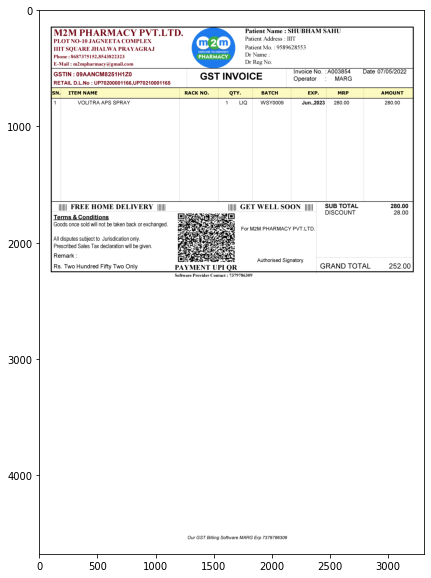


 {'Patient Name': 'SHUBHAM SAHU', 'Patient Mobile Number': [9589628553, 8687375152, 8543822323], 'Patient Address': 'IIIT', 'Date': '07/05/2022', 'Invoice Number': 'A003854'} 



,SN.,ITEM NAME,RACK NO.,QTY.,BATCH,EXP.,MRP,AMOUNT
0,1.,VOLItRA APS SPRAY,BLANK,1 LIQ,WSY0009,Jun..2023,280.00,280.00



 {'SUB TOTAL OON': 280.0, 'DISCOUNT': 28.0, 'GRAND TOTAL': 252.0} 


-----------------------------------------------------------------------------------------------------------------------

117-1-1649134562451.png


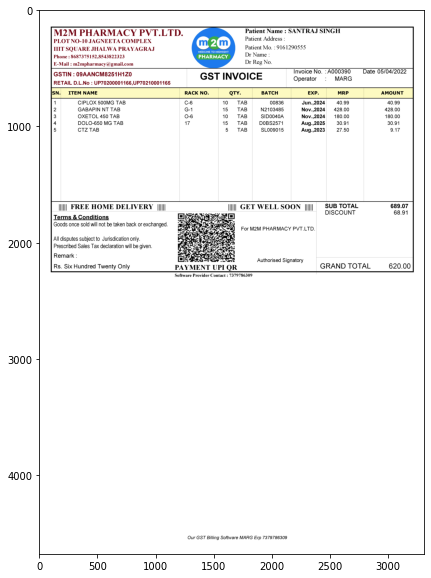


 {'Patient Name': 'SANTRAJ SINGH', 'Patient Mobile Number': [9161290555, 8687375152, 8543822323], 'Patient Address': '', 'Date': '05/04/2022', 'Invoice Number': 'A000390'} 



,SN.,ITEM NAME,RACK NO.,QTY.,BATCH,EXP.,MRP,AMOUNT
0,1.,CIPLOX 500MG TAB,C-6,10 TAB,00836,"Jun.,2024",40.99,40.99
1,2.,GABAPIN NT TAB,G-1,15 TAB,N2103485,Nov..2024,428.00,428.00
2,3.,OXETOL 450 TAB,O-6,10 TAB,SID0040A,"Nov.,2024",180.00,180.00
3,4.,DOLO-650 MG TAB,17,15 TAB,D0BS2571,"Aug.,2025",30.91,30.91
4,5.,CTZ TAB,BLANK,5 TAB,SL009015,Aug.2023,27.50,9.17



 {'SUB TOTAL OON': 689.07, 'DISCOUNT': 68.91, 'GRAND TOTAL': 620.0} 


-----------------------------------------------------------------------------------------------------------------------

117-1-1645334650723.png


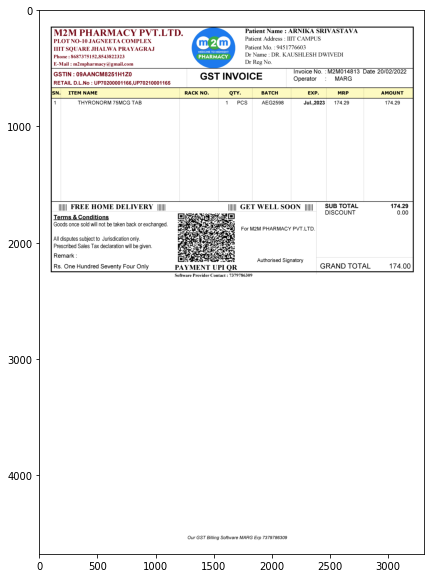


 {'Patient Name': 'ARNIKA SRIVASTAVA', 'Patient Mobile Number': [9451776603, 8687375152, 8543822323], 'Patient Address': 'IIIT CAMPUS', 'Date': '20/02/2022', 'Invoice Number': 'M2M014813'} 



,SN.,ITEM NAME,RACK NO.,QTY.,BATCH,EXP.,MRP,AMOUNT
0,1.,THYRONORM 75MCG TAB,BLANK,1 PCS,AEG2598,"Jul.,2023",174.29,174.29



 {'SUB TOTAL OON': 174.29, 'DISCOUNT': 0.0, 'GRAND TOTAL': 174.0} 


-----------------------------------------------------------------------------------------------------------------------

117-2-1651916389939.png


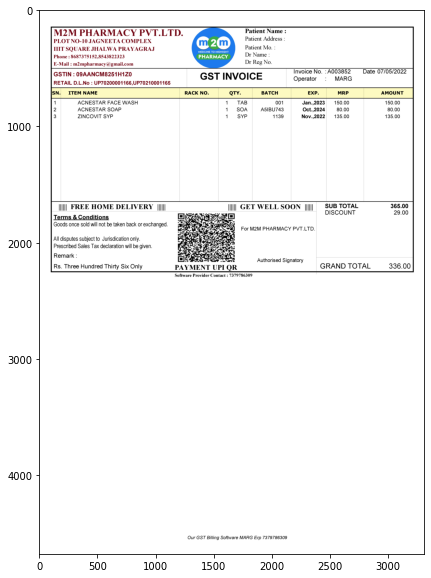


 {'Patient Name': '', 'Patient Mobile Number': [8687375152, 8543822323], 'Patient Address': '', 'Date': '07/05/2022', 'Invoice Number': 'A003852'} 



,SN.,ITEM NAME,RACK NO.,QTY.,BATCH,EXP.,MRP,AMOUNT
0,1.,ACNESTAR EACE WASH,BLANK,1 TAB,001,"Jan.,2023",150.00,150.00
1,2.,ACNESTAR SOAP,BLANK,1 SOA,A5IBU743,"Oct.,2024",80.00,80.00
2,3.,ZINCOVIT SYP,BLANK,1 SYP,1139,"Nov.,2022",135.00,135.00



 {'SUB TOTAL OON': 365.0, 'DISCOUNT': 29.0, 'GRAND TOTAL': 336.0} 


-----------------------------------------------------------------------------------------------------------------------

120-11-1641646178582.png


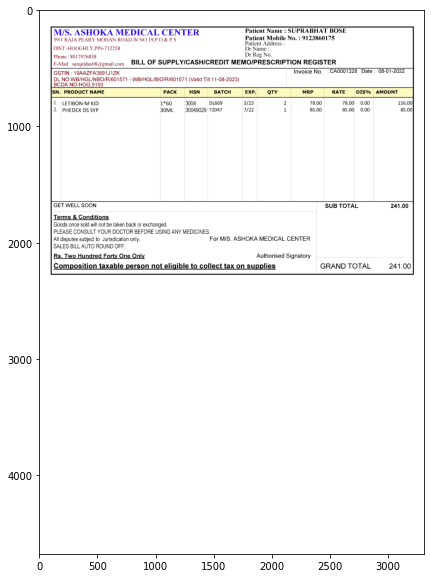


 {'Patient Name': 'SUPRABHAT BOSE', 'Patient Mobile Number': [9123860175, 8017076838], 'Patient Address': '', 'Date': '08-01-2022', 'Invoice Number': 'CA0001328'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,DIS%,AMount
0,1.,LETIBON-M KID,1*60,3004,DL669,3/23,2,78.00,78.00,0.00,156.00
1,2.,PHEDEX DS SYP,30ML,30049029,72047,7/22,1,85.00,85.00,0.00,85.00



 {'SUB TOTAL': 241.0, 'GRAND TOTAL': 241.0} 


-----------------------------------------------------------------------------------------------------------------------

120-2-1644476854424.png


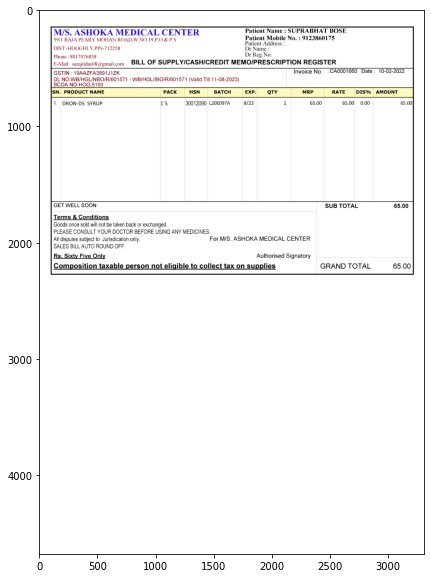


 {'Patient Name': 'SUPRABHAT BOSE', 'Patient Mobile Number': [9123860175, 8017076838], 'Patient Address': '', 'Date': '10-02-2022', 'Invoice Number': 'CA0001660'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,DIS%,AMount
0,1.,DRON-DS SYRUP,1`S,30012090,L20E097A,8/23,1,65.00,65.00,0.00,65.00



 {'SUB TOTAL': 65.0, 'GRAND TOTAL': 65.0} 


-----------------------------------------------------------------------------------------------------------------------

120-4-1646044089503.png


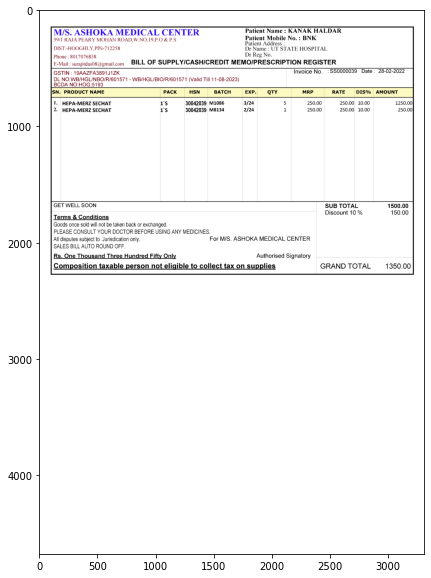


 {'Patient Name': 'KANAK HALDAR', 'Patient Mobile Number': [8017076838], 'Patient Address': '', 'Date': '28-02-2022', 'Invoice Number': 'ss0000039'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,DIS%,AMount
0,1.,HEPA-MERZ SECHAT,1`S,30042039,M1086,3/24,5,250.00,250.00,10.00,1250.00
1,2.,HEPA-MERZ SECHAT,1`S,30042039,M8134,2/24,1,250.00,250.00,10.00,250.00



 {'SUB tOtAL': 1500.0, 'Discount 10 %': 150.0, 'GRAND TOTAL': 1350.0} 


-----------------------------------------------------------------------------------------------------------------------

120-2-1645366890090.png


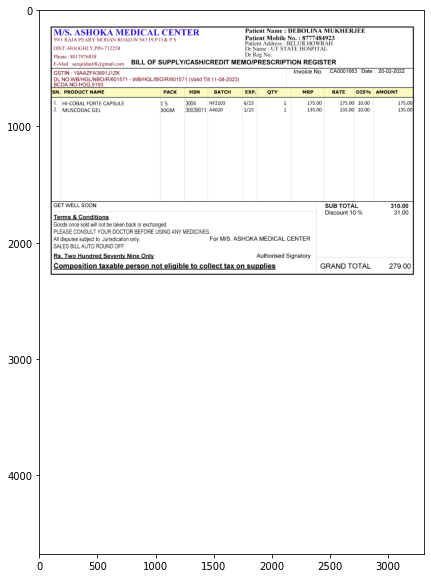


 {'Patient Name': 'DEBOLINA MUKHERJEE', 'Patient Mobile Number': [8777484923, 8017076838], 'Patient Address': 'BELUR HOWRAH', 'Date': '20-02-2022', 'Invoice Number': 'CA0001663'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,DIS%,AMount
0,1.,HI-COBAL FORTE CAPSULE,1`S,3004,HF2103,6/23,1,175.00,175.00,10.00,175.00
1,2.,MUSCODAC GEL,30GM,30039011,A4020,1/23,1,135.00,135.00,10.00,135.00



 {'SUB tOtAL': 310.0, 'Discount 10 %': 31.0, 'GRAND TOTAL': 279.0} 


-----------------------------------------------------------------------------------------------------------------------

120-1-1651564948344.png


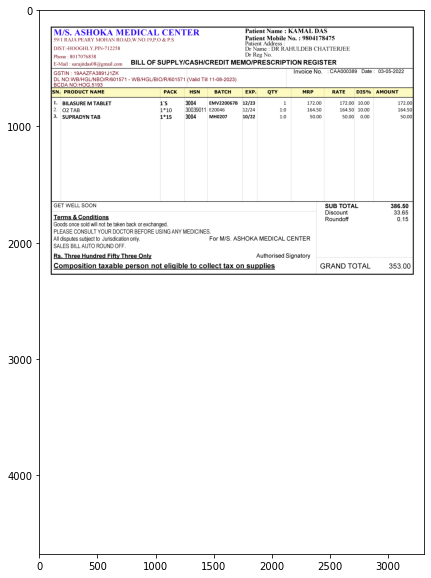


 {'Patient Name': 'KAMAL DAS', 'Patient Mobile Number': [9804178475, 8017076838], 'Patient Address': '', 'Date': '03-05-2022', 'Invoice Number': 'CAA000389'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,DIS%,AMOUNT
0,1.,BILASURE M TABLET,1`S,3004,EMV220067B,12/23,1,172.00,172.00,10.00,172.00
1,2.,O2 TAB,1*10,30039011,E20046,12/24,1:0,164.50,164.50,10.00,164.50
2,3.,SUPRADYN TAB,1*15,3004,MH0207,10/22,1:0,50.00,50.00,0.00,50.00



 {'SUB TOTAL': 386.5, 'Discount': 33.65, 'Roundoff': 0.15, 'GRAND TOTAL': 353.0} 


-----------------------------------------------------------------------------------------------------------------------

122-1-1644484323413.png


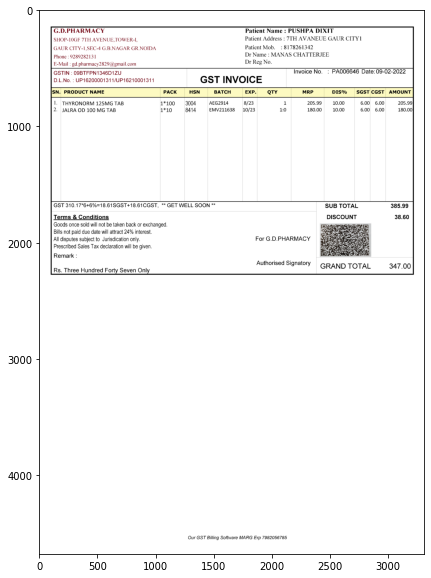


 {'Patient Name': 'PUSHPA DIXIT', 'Patient Mobile Number': [8178261342, 9289282131], 'Patient Address': '7TH AVANEUE GAUR CITY1', 'Date': '09-02-2022', 'Invoice Number': 'PA006646'} 



,1.,THYRONORM 125MG TAB,1*100,3004,AEG2914,8/23,1,205.99,10.00,6.00,6.00,205.99
0,2.,JALRA OD 100 MG TAB,BLANK,8414,EMV211638,10/23,1:0,180.00,10.00,6.00,6.00,180.00
1,GS,T 310.17*6+6%=18.61SGST+18.61CGST,XX,ELL SOOI,**,BLANK,BLANK,BLANK,SUB TOTA,L,BLANK,385.99



 {'DISCOUNT': 38.6, 'GRAND TOTAL': 347.0} 


-----------------------------------------------------------------------------------------------------------------------

122-9-1645341694139.png


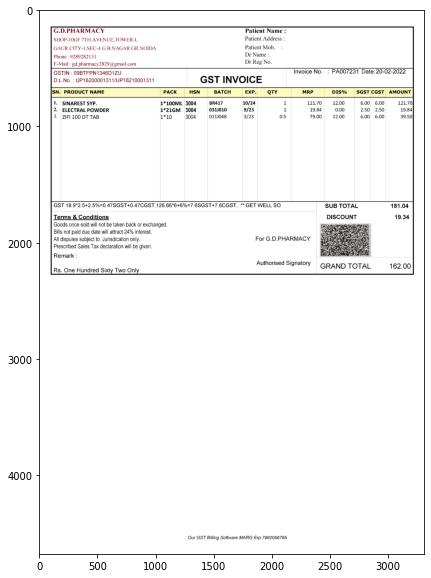


 {'Patient Name': '', 'Patient Mobile Number': [9289282131], 'Patient Address': '', 'Date': '20-02-2022', 'Invoice Number': 'PA007231'} 



,1.,SINAREST SYP.,1*100ML,3004,BR417,10/24,1,121.70,12.00,6.00,6.00,121.70
0,2.,ELECTRAL POWVDER,1*21GM,3004,031J010,9/23,1,19.84,0.00,2.50,2.50,19.84
1,3.,ZIFI 1OO DT TAB,1*10,3004,011J048,3/23,0:5,79.00,12.00,6.00,6.00,39.50
2,GS,T 18.9*2.5+2.5%=0.47SGST+0.47CGST.1,26.66*6+69,=7.6SGS,T+7.6CGST.,GET,WELL SO,BLANK,SUB TOTA,L,BLANK,181.04



 {'DISCOUNT': 19.34, 'GRAND TOTAL': 162.0} 


-----------------------------------------------------------------------------------------------------------------------

123-1-1651580567713.png


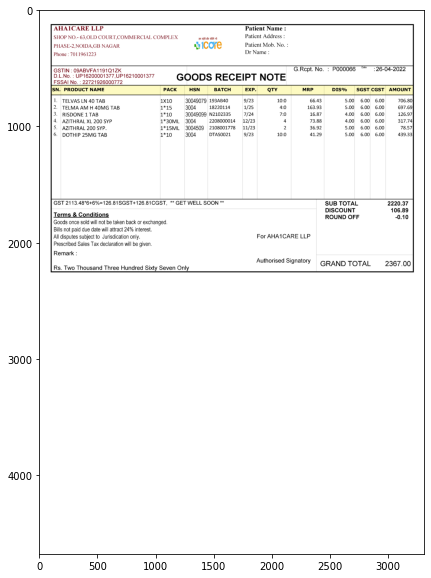


 {'Patient Name': '', 'Patient Mobile Number': [7011961223], 'Patient Address': '', 'Date': 'GRcpt No  P000066  26-04-2022', 'Invoice Number': 'P000066'} 



,SN.,PRODUCt nAMie,PACK,HSN,BATCH,EXP.,QTY,MRP,DIS%,SGST,CGST,AMOUNT
0,1.,TELVAS LN 40 TAB,1X10,30049079,193AB40,9/23,10:0,66.43,5.00,6.00,6.00,706.80
1,2.,TELMA AM H 4OMG TAB,1*15,3004,18220114,1/25,4:0,163.93,5.00,6.00,6.00,697.69
2,3.,RISDONE 1 TAB,1*10,30049099,N2102335,7/24,7:0,16.87,4.00,6.00,6.00,126.97
3,4.,AZITHRAL XL 200 SYP,1*30ML,3004,2208000014,12/23,4,73.88,4.00,6.00,6.00,317.74
4,5.,AZITHRAL 200 SYP.,1*15ML,3004509,2108001778,11/23,2,36.92,5.00,6.00,6.00,78.57
5,6.,DOTHIP 25MG TAB,1*10,3004,DTAS0021,9/23,10:0,41.29,5.00,6.00,6.00,439.33



 {'SUB LOLAL': 2220.37, 'DISCOUNT': 106.89, 'ROUND OFF': -0.1, 'GRAND TOTAL': 2367.0} 


-----------------------------------------------------------------------------------------------------------------------

123-26-1644314695520.png


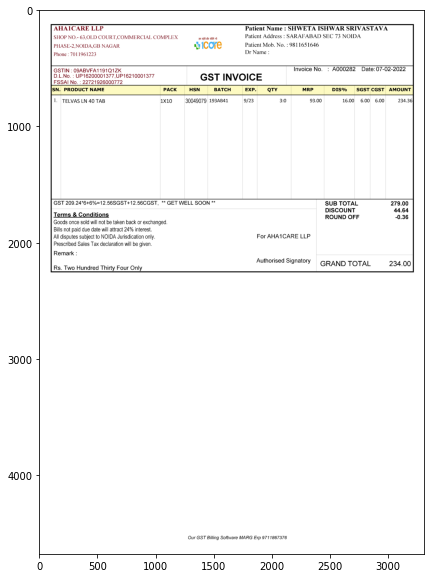


 {'Patient Name': 'SHWETA ISHWAR SRIVASTAVA', 'Patient Mobile Number': [9811651646, 7011961223], 'Patient Address': 'SARAFABAD SEC 73 NOIDA', 'Date': '07-02-2022', 'Invoice Number': 'A000282'} 



,SN.,PRODUCt nAMe,PACK,HSN,BATCH,EXP.,QTY,MRP,DIS%,SGST,CGST,AMOUNT
0,1.,TELVAS LN 40 TAB,1X10,30049079,193AB41,9/23,3:0,93.00,16.00,6.00,6.00,234.36



 {'SUB LOLAL': 279.0, 'DISCOUNT': 44.64, 'ROUND OFF': -0.36, 'GRAND TOTAL': 234.0} 


-----------------------------------------------------------------------------------------------------------------------

123-1-1642677651131.png


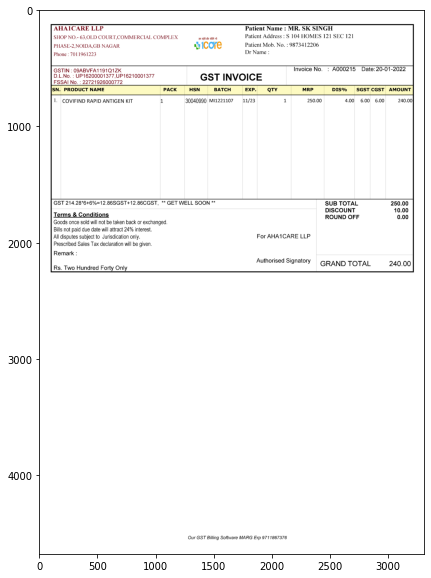


 {'Patient Name': 'MR, SK SINGH', 'Patient Mobile Number': [9873412206, 7011961223], 'Patient Address': 'S 104 HOMES 121 SEC 121', 'Date': '20-01-2022', 'Invoice Number': 'A000215'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DIS%,SGST,CGST,AMOUNT
0,1.,COVIEIND RAPID ANTIGEN KTT,1,30040990,MI1221107,11/23,1,250.00,4.00,6.00,6.00,240.00



 {'SUB LOLAL': 250.0, 'DISCOUNT': 10.0, 'ROUND OFF': 0.0, 'GRAND TOTAL': 240.0} 


-----------------------------------------------------------------------------------------------------------------------

123-1-1641300520874.png


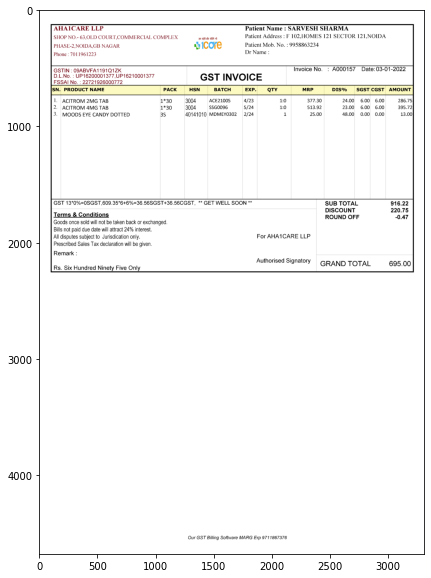


 {'Patient Name': 'SARVESH SHARMA', 'Patient Mobile Number': [9958863234, 7011961223], 'Patient Address': 'F 102.HOMES 121 SECTOR 121.NOIDA', 'Date': '03-01-2022', 'Invoice Number': 'A000157'} 



,SN.,PRODUCt NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DIS%,SGST,CGST,AMOUNT
0,1.,ACITROM 2MG TAB,1*30,3004,ACE21005,4/23,1:0,377.30,24.00,6.00,6.00,286.75
1,2.,ACITROM 4MG TAB,1*30,3004,SSG0096,5/24,1:0,513.92,23.00,6.00,6.00,395.72
2,3.,MOODS EYE CANDY DOTTED,3S,40141010,MDMEY0302,2/24,1,25.00,48.00,0.00,0.00,13.00



 {'SUB LOLAL': 916.22, 'DISCOUNT': 220.75, 'ROUND OFF': -0.47, 'GRAND TOTAL': 695.0} 


-----------------------------------------------------------------------------------------------------------------------

125-12-1642431776591.png


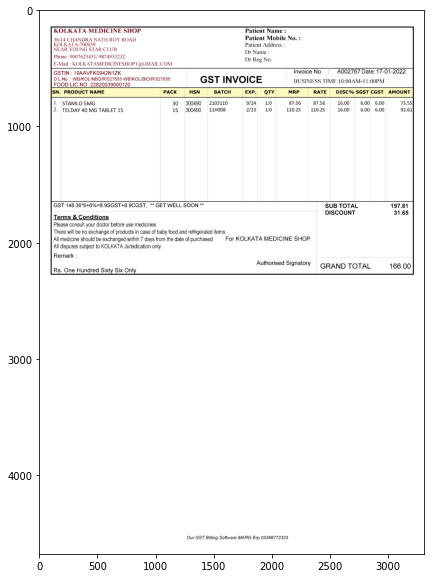


 {'Patient Name': '', 'Patient Mobile Number': [], 'Patient Address': '', 'Date': '17-01-2022', 'Invoice Number': 'A002767'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,DISC%,SGST,CGST,AMOUnt
0,1.,STAMLO 5MG,30,300490,2103110,9/24,1:0,87.56,87.56,16.00,6.00,6.00,73.55
1,2.,TELDAY 4O MG TABLET 15,15,300490,11H008,2/23,1:0,110.25,110.25,16.00,6.00,6.00,92.61



 {'SuB totAL': 197.81, 'DISCOUNT': 31.65, 'GRAND TOTAL': 166.0} 


-----------------------------------------------------------------------------------------------------------------------

125-7-1641059670959.png


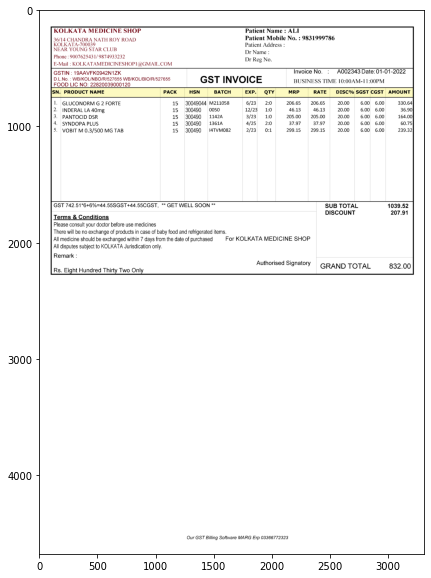


 {'Patient Name': 'ALI', 'Patient Mobile Number': [9831999786], 'Patient Address': '', 'Date': '01-01-2022', 'Invoice Number': 'A002343'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,DISC%,SGSt,CGST,AMOUnt
0,1.,GLUCONORM G 2 EORTE,15,30049044,M211058,6/23,2:0,206.65,206.65,20.00,6.00,6.00,330.64
1,2.,INDERAL LA 40mg,15,300490,0050,12/23,1:0,46.13,46.13,20.00,6.00,6.00,36.90
2,3.,PANTOCID DSR,15,300490,1142A,3/23,1:0,205.00,205.00,20.00,6.00,6.00,164.00
3,4.,SYNDOPA PLUS,15,300490,1361A,4/25,2:0,37.97,37.97,20.00,6.00,6.00,60.75
4,5.,VOBIT M 0.3/500 MG TAB,15,300490,I4TVM082,2/23,0:1,299.15,299.15,20.00,6.00,6.00,239.32



 {'SuB totAL': 1039.52, 'DISCOUNT': 207.91, 'GRAND TOTAL': 832.0} 


-----------------------------------------------------------------------------------------------------------------------

125-1-1647412629586.png


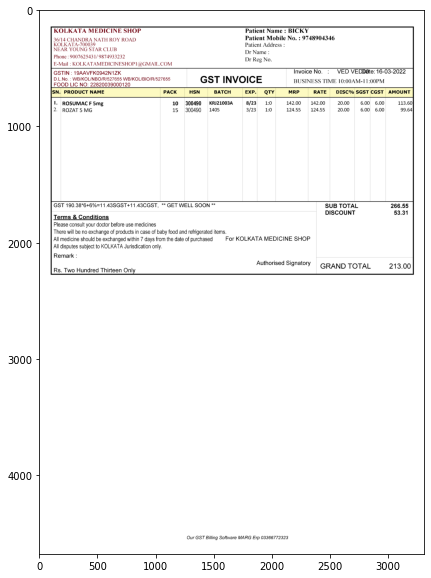


 {'Patient Name': 'BICKY', 'Patient Mobile Number': [9748904346], 'Patient Address': '', 'Date': '', 'Invoice Number': 'VED'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,DISC%,SGST,CGST,AMOUnt
0,1.,ROSUMAC F 5mg,10,300490,KRJ21003A,8/23,1:0,142.00,142.00,20.00,6.00,6.00,113.60
1,2.,ROZAT 5 MG,15,300490,1405,3/23,1:0,124.55,124.55,20.00,6.00,6.00,99.64



 {'SuB totAL': 266.55, 'DISCOUNT': 53.31, 'GRAND TOTAL': 213.0} 


-----------------------------------------------------------------------------------------------------------------------

125-4-1643465142124.png


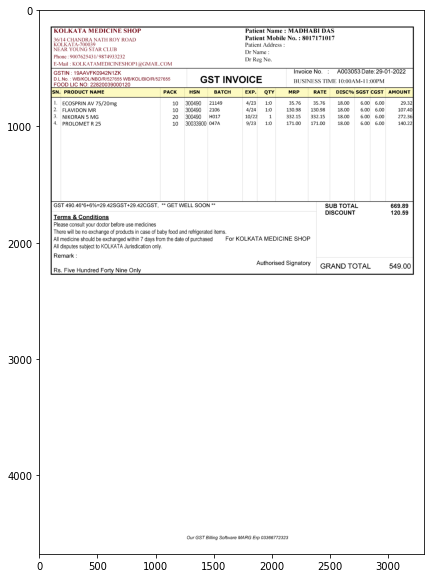


 {'Patient Name': 'MADHABI DAS', 'Patient Mobile Number': [8017171017], 'Patient Address': '', 'Date': '29-01-2022', 'Invoice Number': 'A003053'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,DISC%,SGST,CGST,AMOUnt
0,1.,ECOSPRIN AV 75/20mg,10,300490,21149,4/23,1:0,35.76,35.76,18.00,6.00,6.00,29.32
1,2.,FLAVIDON MR,10,300490,2106,4/24,1:0,130.98,130.98,18.00,6.00,6.00,107.40
2,3.,NIKORAN 5 MG,20,300490,H017,10/22,1,332.15,332.15,18.00,6.00,6.00,272.36
3,4.,PROLOMET R 25,10,30033900,047A,9/23,1:0,171.00,171.00,18.00,6.00,6.00,140.22



 {'SuB totAL': 669.89, 'DISCOUNT': 120.59, 'GRAND TOTAL': 549.0} 


-----------------------------------------------------------------------------------------------------------------------

125-10-1643820628195.png


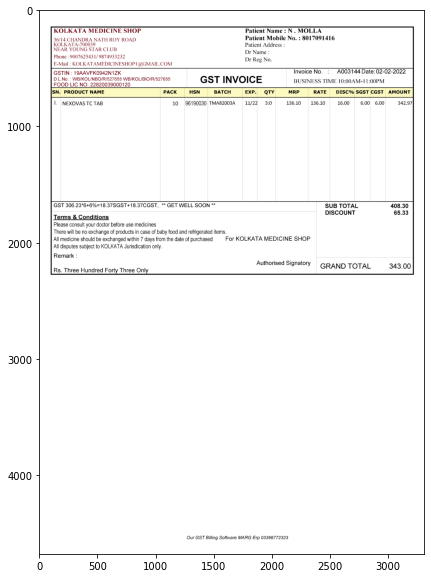


 {'Patient Name': 'N. MOLLA', 'Patient Mobile Number': [8017091416], 'Patient Address': '', 'Date': '02-02-2022', 'Invoice Number': 'A003144'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,DISC%,SGSt,CGST,AMOUnt
0,1.,NEXOVAS TC TAB,10,96190030,TMA82003A,11/22,3:0,136.10,136.10,16.00,6.00,6.00,342.97



 {'SuB totAL': 408.3, 'DISCOUNT': 65.33, 'GRAND TOTAL': 343.0} 


-----------------------------------------------------------------------------------------------------------------------

126-53-1651511610493.png


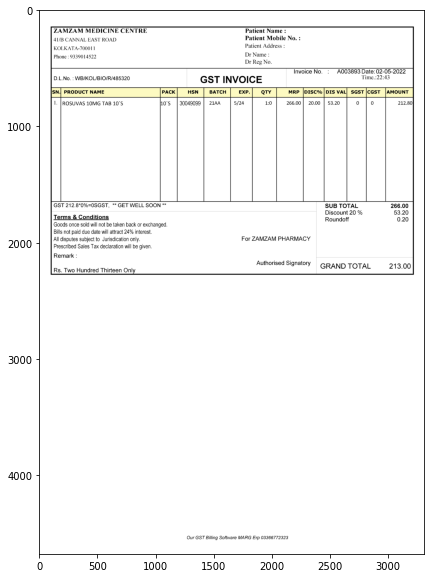


 {'Patient Name': '', 'Patient Mobile Number': [9339014522], 'Patient Address': '', 'Date': '02-05-2022', 'Invoice Number': 'A003893'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DISC%,DIS VAL,SGST,CGST,AMOUnt
0,1.,ROSUVAS 10MG TAB 10`S,10`S,30049099,21AA,5/24,1:0,266.00,20.00,53.20,0,0,212.80



 {'SUB TOTAL': 266.0, 'Discount 20 %': 53.2, 'Roundoff': 0.2, 'GRAND TOTAL': 213.0} 


-----------------------------------------------------------------------------------------------------------------------

126-1-1641967298932.png


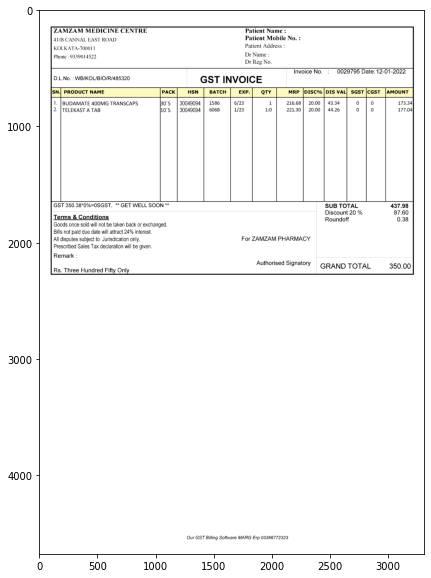


 {'Patient Name': '', 'Patient Mobile Number': [9339014522], 'Patient Address': '', 'Date': '12-01-2022', 'Invoice Number': '0029795'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DISC%,DIS VAL,SGST,CGST,AMOUnt
0,1.,BUDAMATE 4OOMG TRANSCAPS,30`S,30049094,1586,6/23,1,216.68,20.00,43.34,0,0,173.34
1,2.,TELEKAST A TAB,10`S,30049094,606B,1/23,1:0,221.30,20.00,44.26,0,0,177.04



 {'SUB TOTAL': 437.98, 'Discount 20 %': 87.6, 'Roundoff': 0.38, 'GRAND TOTAL': 350.0} 


-----------------------------------------------------------------------------------------------------------------------

126-22-1642002645286.png


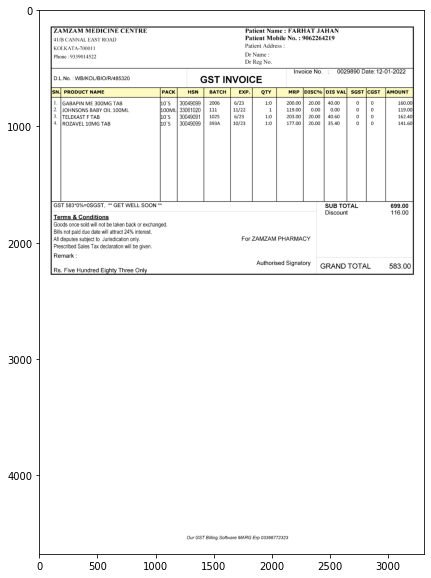


 {'Patient Name': 'FARHAT JAHAN', 'Patient Mobile Number': [9062264219, 9339014522], 'Patient Address': '', 'Date': '12-01-2022', 'Invoice Number': '0029890'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DISC%,DIS VAL,SGST,CGST,AMount
0,1.,GABAPIN ME 3OOMG TAB,10`S,30049099,2006,6/23,1:0,200.00,20.00,40.00,0,0,160.00
1,2.,JOHNSONS BABY OIL 1OOML,100ML,33061020,111,11/22,1,119.00,0.00,0.00,0,0,119.00
2,3.,TELEKAST F TAB,10`S,30049091,1025,6/23,1:0,203.00,20.00,40.60,0,0,162.40
3,4.,ROZAVEL 1OMG TAB,10`S,30049099,393A,10/23,1:0,177.00,20.00,35.40,0,0,141.60



 {'SUB TOTAL': 699.0, 'Discount': 116.0, 'GRAND TOTAL': 583.0} 


-----------------------------------------------------------------------------------------------------------------------

126-31-1644591755556.png


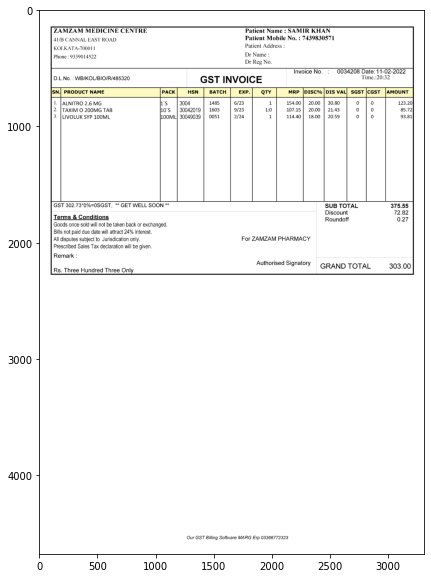


 {'Patient Name': 'SAMR KHAN', 'Patient Mobile Number': [7439830571, 9339014522], 'Patient Address': '', 'Date': '11-02-2022', 'Invoice Number': '0034208'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DISC%,DIS VAL,SGST,CGST,AMOUnt
0,1.,ALNITRO 2.6 MG,1`S,3004,1485,6/23,1,154.00,20.00,30.80,0,0,123.20
1,2.,TAXIM O 200MG TAB,10`S,30042019,1603,9/23,1:0,107.15,20.00,21.43,0,0,85.72
2,3.,LIVOLUK SYP 1OOML,100ML,30049039,0051,2/24,1,114.40,18.00,20.59,0,0,93.81



 {'SUB TOTAL': 375.55, 'Discount': 72.82, 'Roundoff': 0.27, 'GRAND TOTAL': 303.0} 


-----------------------------------------------------------------------------------------------------------------------

126-26-1648142100983.png


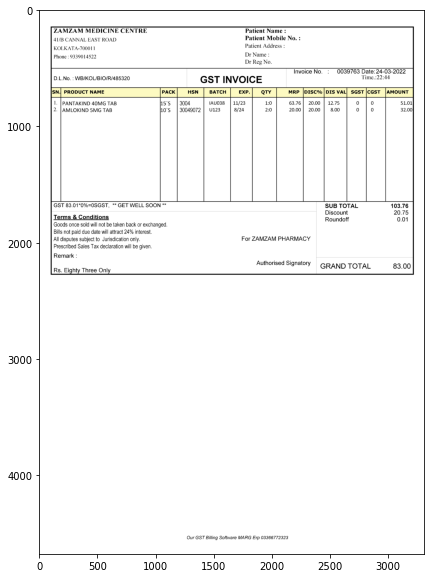


 {'Patient Name': '', 'Patient Mobile Number': [9339014522], 'Patient Address': '', 'Date': '24-03-2022', 'Invoice Number': '0039763'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DISC%,DIS VAL,SGST,CGST,AMOUnt
0,1.,PANTAKIND 4OMG TAB,15`S,3004,IAU038,11/23,1:0,63.76,20.00,12.75,0,0,51.01
1,2.,AMLOKIND 5MG TAB,10`S,30049072,U123,8/24,2:0,20.00,20.00,8.00,0,0,32.00



 {'SUB TOTAL': 103.76, 'Discount': 20.75, 'Roundoff': 0.01, 'GRAND TOTAL': 83.0} 


-----------------------------------------------------------------------------------------------------------------------

127-2-1641021563337.png


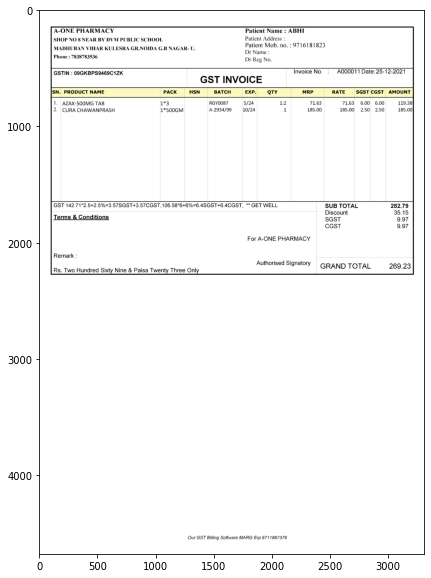


 {'Patient Name': 'ABHI', 'Patient Mobile Number': [9716181823, 7838783536], 'Patient Address': '', 'Date': '25-12-2021', 'Invoice Number': 'A000011'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,AZAX-5O0MG TAB,1*3,BLANK,RGY0087,5/24,1:2,71.63,71.63,6.00,6.00,119.38
1,2.,CURA CHAWANPRASH,1*500GM,BLANK,A-2934/99,10/24,1,185.00,185.00,2.50,2.50,185.00



 {'SUB TOTAL': 282.79, 'Discount': 35.15, 'SGST': 9.97, 'CGST': 9.97, 'GRAND TOTAL': 269.23} 


-----------------------------------------------------------------------------------------------------------------------

127-3-1641021788313.png


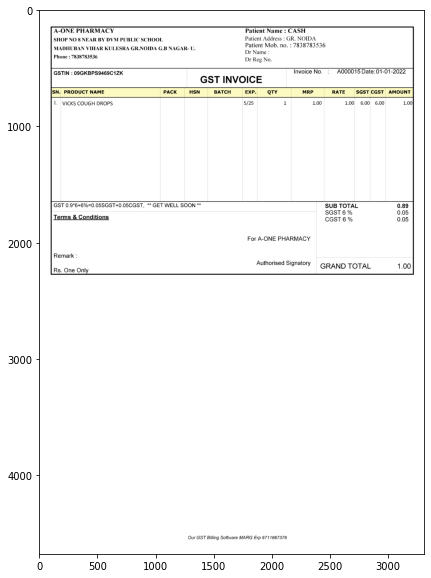


 {'Patient Name': 'CASH', 'Patient Mobile Number': [7838783536, 7838783536], 'Patient Address': 'GR. NOIDA', 'Date': '01-01-2022', 'Invoice Number': 'A000015'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,VICKS COUGH DROPS,BLANK,BLANK,BLANK,5/25,1,1.00,1.00,6.00,6.00,1.00



 {'SUB TOTAL': 0.89, 'SGST 6 %': 0.05, 'CGST 6 %': 0.05, 'GRAND TOTAL': 1.0} 


-----------------------------------------------------------------------------------------------------------------------

127-1-1641021466539.png


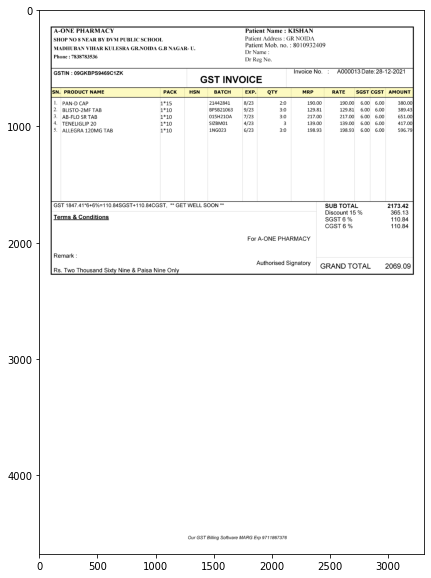


 {'Patient Name': 'KISHAN', 'Patient Mobile Number': [8010932409, 7838783536], 'Patient Address': 'GR NOIDA', 'Date': '28-12-2021', 'Invoice Number': 'A000013'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnt
0,1.,PAN-D CAP,1*15,BLANK,21442841,8/23,2:0,190.00,190.00,6.00,6.00,380.00
1,2.,BLISTO-2MF TAB,1*10,BLANK,BPSB21063,9/23,3:0,129.81,129.81,6.00,6.00,389.43
2,3.,AB-FLO SR TAB,1*10,BLANK,015H210A,7/23,3:0,217.00,217.00,6.00,6.00,651.00
3,4.,TENELIGLIP 20,1*10,BLANK,SIZBM01,4/23,3,139.00,139.00,6.00,6.00,417.00
4,5.,ALLEGRA 120MG TAB,1*10,BLANK,1NG023,6/23,3:0,198.93,198.93,6.00,6.00,596.79



 {'SUB TOTAL': 2173.42, 'Discount 15 %': 365.13, 'SGST 6 %': 110.84, 'CGST 6 %': 110.84, 'GRAND TOTAL': 2069.09} 


-----------------------------------------------------------------------------------------------------------------------

127-2-1641469525784.png


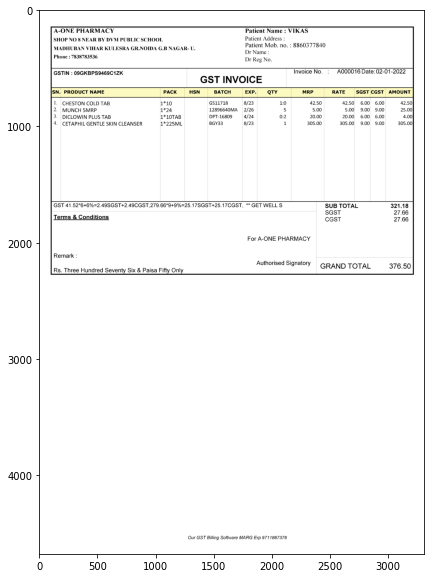


 {'Patient Name': 'VIKAS', 'Patient Mobile Number': [8860377840, 7838783536], 'Patient Address': '', 'Date': '02-01-2022', 'Invoice Number': 'A000016'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,CHESTON COLD TAB,1*10,BLANK,GS11718,8/23,1:0,42.50,42.50,6.00,6.00,42.50
1,2.,MUNCH 5MRP,1*24,BLANK,12896640MA,2/26,5,5.00,5.00,9.00,9.00,25.00
2,3.,DICLOWIN PLUS TAB,1*10TAB,BLANK,DPT-16809,4/24,0:2,20.00,20.00,6.00,6.00,4.00
3,4.,CETAPHIL GENTLE SKIN CLEANSER,1*225ML,BLANK,BGY33,8/23,1,305.00,305.00,9.00,9.00,305.00



 {'SUB TOTAL': 321.18, 'SGST': 27.66, 'CGST': 27.66, 'GRAND TOTAL': 376.5} 


-----------------------------------------------------------------------------------------------------------------------

130-1-1644734182742.png


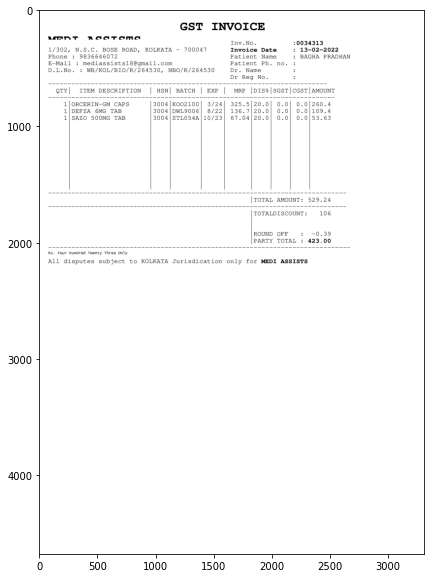


 {'Patient Name': 'BAGHA PRADHAN', 'Patient Mobile Number': [9836646072], 'Patient Address': '', 'Date': '13-02-2022', 'Invoice Number': '0034313'} 



,ITEM,HSN,BATCH,EXP,MRP,DIS%,SGST,CGST
0,ORCERIN-GM,3004,K002100,3/24,325.5,20.0,0.0,0.0
1,BLANK,3004,DWL9006,8/22,136.7,20.0,0.0,0.0
2,BLANK,3004,STL054A,10/23,67.04,20.0,0.0,0.0



 {'OUNT:': 529.24, 'COUNT :': 106.0, 'TAL': 423.0} 


-----------------------------------------------------------------------------------------------------------------------

130-5-1641394063286.png


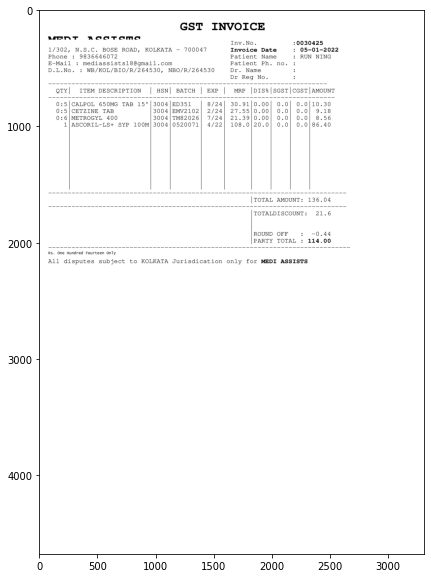


 {'Patient Name': 'RUN NING', 'Patient Mobile Number': [9836646072], 'Patient Address': '', 'Date': '05-01-2022', 'Invoice Number': '0030425'} 



,ITEM,HSN,BATCH,EXP,MRP,DIS%,SGST,CGST
0,65 0MG,3004,ED351,8/24,30.91,0.00,0.0,0.0
1,BLANK,3004,EMV2102,2/24,27.55,0.00,0.0,0.0
2,BLANK,3004,TM82026,7/24,21.39,0.00,0.0,0.0
3,BLANK,3004,0520071,4/22,108.0,20.0,0.0,0.0



 {'OUNT:': 136.04, 'COUNT :': 21.6} 


-----------------------------------------------------------------------------------------------------------------------

130-11-1641569622734.png


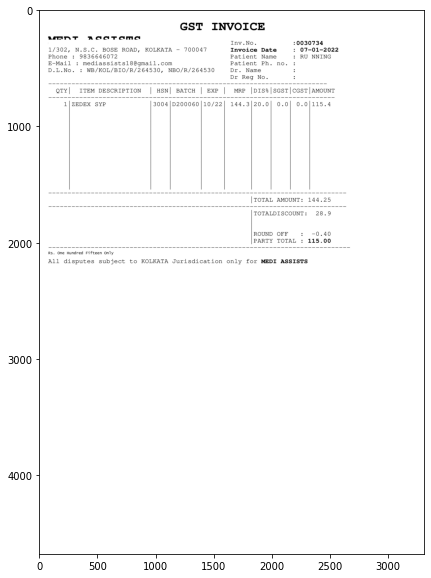


 {'Patient Name': 'RU NNING', 'Patient Mobile Number': [9836646072], 'Patient Address': '', 'Date': '07-01-2022', 'Invoice Number': '0030734'} 



,ITEM,HSN,BATCH,EXP,MRP,DIS%,SGST,CGST
0,ZEDEX,3004,D200060,10/22,144.3,20.0,0.0,0.0



 {'OUNT:': 144.25, 'COUNT :': 28.9} 


-----------------------------------------------------------------------------------------------------------------------

130-1-1641278186233.png


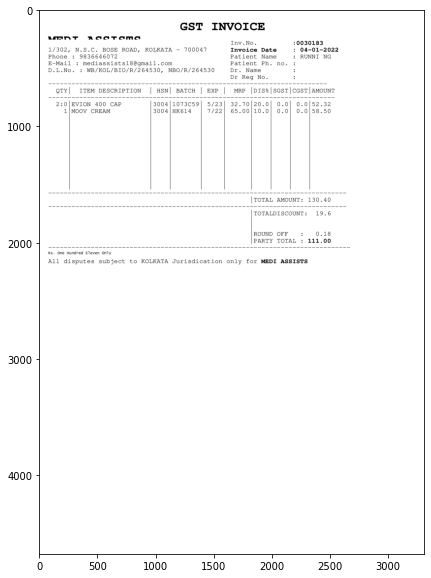


 {'Patient Name': 'RUNNI NG', 'Patient Mobile Number': [9836646072], 'Patient Address': '', 'Date': '04-01-2022', 'Invoice Number': '0030183'} 



,ITEM,HSN,BATCH,EXP,MRP,DIS%,SGST,CGST
0,400,3004,1073C59,5/23,32.70,20.0,0.0,0.0
1,BLANK,3004,HK614,7/22,65.00,10.0,0.0,0.0



 {'OUNT:': 130.4, 'COUNT :': 19.6, 'TAL': 111.0} 


-----------------------------------------------------------------------------------------------------------------------

131-6-1650995962094.png


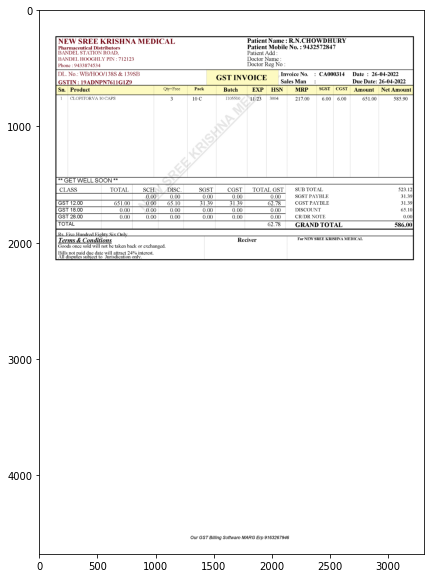


 {'Patient Name': 'R.N.CHOWDHURY', 'Patient Mobile Number': [9432572847, 9433874534], 'Patient Address': '', 'Date': '26-04-2022', 'Invoice Number': 'CA000314'} 



""



 {'SUB TOTAL': 523.12, 'SGST PAYBLE': 31.39, 'CGST PAYBLE': 31.39, 'DSCOUNT': 65.1, 'CRDR NOTF': 0.0, 'GRAND TOTAL': 586.0} 


-----------------------------------------------------------------------------------------------------------------------

131-2-1650714635697.png


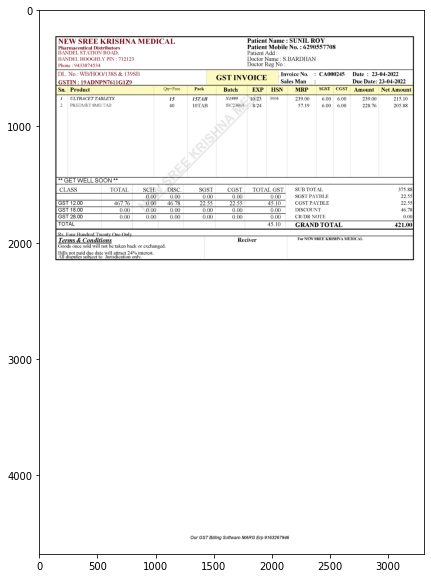


 {'Patient Name': 'SUNL RO Y', 'Patient Mobile Number': [6290557708, 9433874534], 'Patient Address': '', 'Date': '23-04-2022', 'Invoice Number': 'CA000245'} 



""



 {'SUB TOTAL': 375.88, 'SGST PAYBLE': 22.55, 'CGST PAYBLE': 22.55, 'DSCOUNT': 46.78, 'CRDR NOTF': 0.0, 'GRAND TOTAL': 421.0} 


-----------------------------------------------------------------------------------------------------------------------

131-2-1650864975204.png


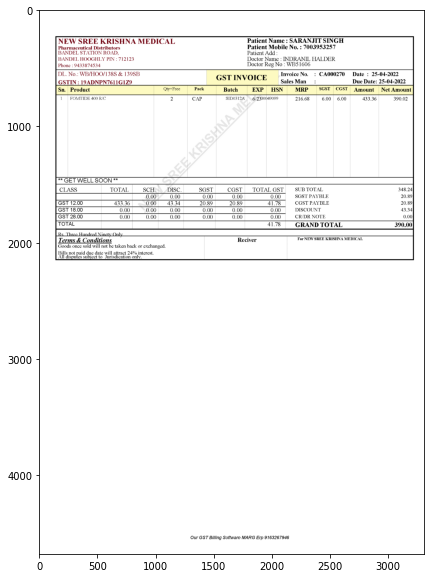


 {'Patient Name': 'SARANJT SINGH', 'Patient Mobile Number': [7003953257, 9433874534], 'Patient Address': '', 'Date': '25-04-2022', 'Invoice Number': 'CA000270'} 



""



 {'SUB TOTAL': 348.24, 'SGST PAYBLE': 20.89, 'CGST PAYBLE': 20.89, 'DSCOUNT': 43.34, 'CRDR NOTF': 0.0, 'GRAND TOTAL': 390.0} 


-----------------------------------------------------------------------------------------------------------------------

131-2-1647668774633.png


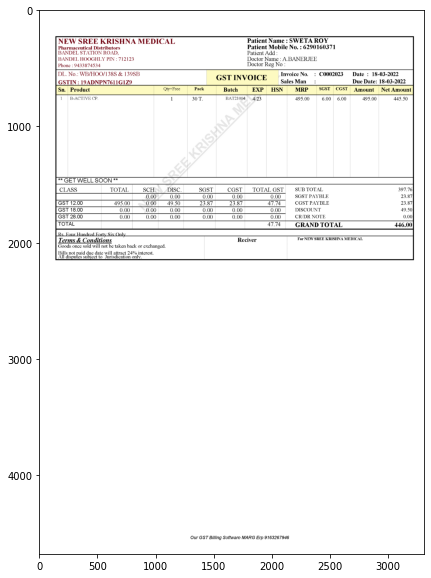


 {'Patient Name': 'SWETA ROY', 'Patient Mobile Number': [6290160371, 9433874534], 'Patient Address': '', 'Date': '18-03-2022', 'Invoice Number': 'C0002023'} 



""



 {'SUB TOTAL': 397.76, 'SGST PAYBLE': 23.87, 'CGST PAYBLE': 23.87, 'DSCOUNT': 49.5, 'CRDR NOTF': 0.0, 'GRAND TOTAL': 446.0} 


-----------------------------------------------------------------------------------------------------------------------



In [ ]:
for i in Data_First:
    print(i)
    image = cv2.imread(f'first/{i}')
    plt.figure(figsize=(20,10))
    plt.imshow(image)
    plt.show()
    print("\n", Data_First[i]['header'], "\n")
    display(Data_First[i]['table'])
    print("\n", Data_First[i]['footer'], "\n")
    print('\n-----------------------------------------------------------------------------------------------------------------------\n')

## Second

In [ ]:
second = os.listdir('second')

Data_Second = {}

for i in second:
    header = extract_header(f'second/{i}')
    table = extract_table(f'second/{i}')
    footer = extract_footer(f'second/{i}')
    Data_Second[i] = {'header': header, 'table': table, 'footer': footer}

[2022/07/05 04:25:32] ppocr WARNING: Since the angle classifier is not initialized, the angle classifier will not be uesd during the forward process
[2022/07/05 04:25:33] ppocr DEBUG: dt_boxes num : 14, elapse : 0.04087662696838379
[2022/07/05 04:25:33] ppocr DEBUG: rec_res num  : 14, elapse : 0.05787944793701172
[2022/07/05 04:25:33] ppocr WARNING: Since the angle classifier is not initialized, the angle classifier will not be uesd during the forward process
[2022/07/05 04:25:33] ppocr DEBUG: dt_boxes num : 12, elapse : 0.02074599266052246
[2022/07/05 04:25:33] ppocr DEBUG: rec_res num  : 12, elapse : 0.06389856338500977
[2022/07/05 04:25:35] ppocr WARNING: Since the angle classifier is not initialized, the angle classifier will not be uesd during the forward process
[2022/07/05 04:25:35] ppocr DEBUG: dt_boxes num : 4, elapse : 0.011893033981323242
[2022/07/05 04:25:35] ppocr DEBUG: rec_res num  : 4, elapse : 0.010169029235839844
[2022/07/05 04:25:35] ppocr WARNING: Since the angle cl

132-1-1641039592820.png


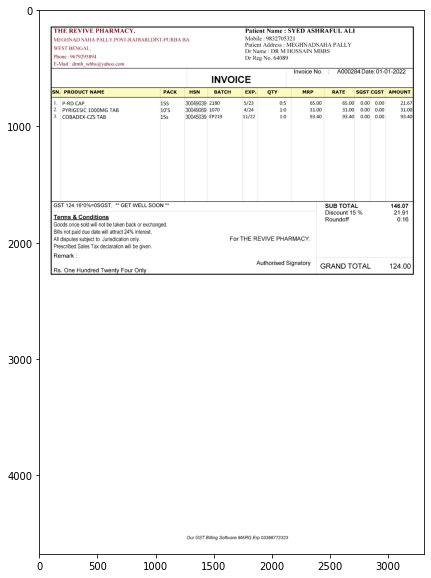


 {'Patient Name': 'SYED ASHRAFUL ALI', 'Patient Mobile Number': [9832705321, 9679295894], 'Patient Address': 'MEGHNADSAHA PALLY', 'Date': '01-01-2022', 'Invoice Number': 'A000284'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,P-RD CAP,15S,30049039,2180,5/23,0:5,65.00,65.00,0.00,0.00,21.67
1,2.,PYRIGESIC 1OOOMG TAB,10'S,30049069,1070,4/24,1:0,31.00,31.00,0.00,0.00,31.00
2,3.,COBADEX-CZS TAB,15s,30045039,EP219,11/22,1:0,93.40,93.40,0.00,0.00,93.40



 {'SUB tOtAL': 146.07, 'Discount 15 %': 21.91, 'Roundoff': 0.16, 'GRAND TOTAL': 124.0} 


-----------------------------------------------------------------------------------------------------------------------

132-2-1641017551225.png


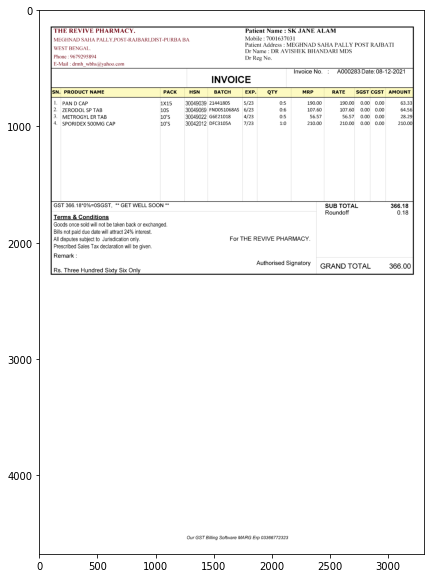


 {'Patient Name': 'SK JANE ALAM', 'Patient Mobile Number': [7001637031, 9679295894], 'Patient Address': 'MEGHNAD SAHA PALLY POST RAJBATI', 'Date': '08-12-2021', 'Invoice Number': 'A000283'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,PAN D CAP,1X15,30049039,21441805,5/23,0:5,190.00,190.00,0.00,0.00,63.33
1,2.,ZERODOL SP TAB,10S,30049069,FND051068AS,6/23,0:6,107.60,107.60,0.00,0.00,64.56
2,3.,METROGYL ER TAB,10'S,30049022,G6E21018,4/23,0:5,56.57,56.57,0.00,0.00,28.29
3,4.,SPORIDEX 50OMG CAP,10'S,30042012,DFC3105A,7/23,1:0,210.00,210.00,0.00,0.00,210.00



 {'SUB TOTAL': 366.18, 'Roundoff': 0.18, 'GRAND TOTAL': 366.0} 


-----------------------------------------------------------------------------------------------------------------------

132-3-1641399228314.png


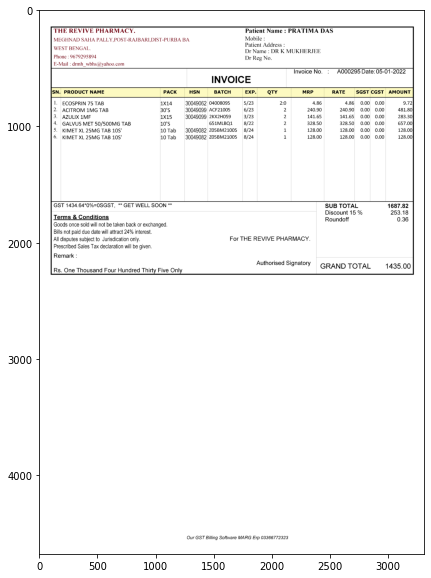


 {'Patient Name': 'PRATIMA DAS', 'Patient Mobile Number': [9679295894], 'Patient Address': '', 'Date': '05-01-2022', 'Invoice Number': 'A000295'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnt
0,1.,ECOSPRIN 75 TAB,1X14,30049062,04008095,5/23,2:0,4.86,4.86,0.00,0.00,9.72
1,2.,ACTTROM 1MG TAB,30'S,30049099,ACF21005,6/23,2,240.90,240.90,0.00,0.00,481.80
2,3.,AZULIX 1MF,1X15,30049099,2KX2H059,3/23,2,141.65,141.65,0.00,0.00,283.30
3,4.,GALVUS MET 50/500MG TAB,10'S,BLANK,651MLBQ1,8/22,2,328.50,328.50,0.00,0.00,657.00
4,5.,KIMET XL 25MG TAB 10S,10 Tab,30049082,Z05BM21005,8/24,1,128.00,128.00,0.00,0.00,128.00
5,6.,KIMET XL 25MG TAB 10S,10 Tab,30049082,Z05BM21005,8/24,1,128.00,128.00,0.00,0.00,128.00



 {'SUB TOTAL': 1687.82, 'Discount 15 %': 253.18, 'Roundoff': 0.36, 'GRAND TOTAL': 1435.0} 


-----------------------------------------------------------------------------------------------------------------------

132-2-1647524255968.png


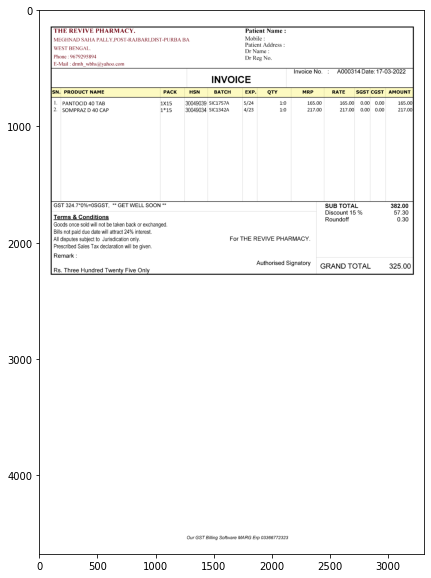


 {'Patient Name': '', 'Patient Mobile Number': [9679295894], 'Patient Address': '', 'Date': '17-03-2022', 'Invoice Number': 'A000314'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,PANTOCID 40 TAB,1X15,30049039,SIC1757A,5/24,1:0,165.00,165.00,0.00,0.00,165.00
1,2.,SOMPRAZ D 40 CAP,1*15,30049034,SIC1342A,4/23,1:0,217.00,217.00,0.00,0.00,217.00



 {'SUB TOTAL': 382.0, 'Discount 15 %': 57.3, 'Roundoff': 0.3, 'GRAND TOTAL': 325.0} 


-----------------------------------------------------------------------------------------------------------------------

132-1-1641728305143.png


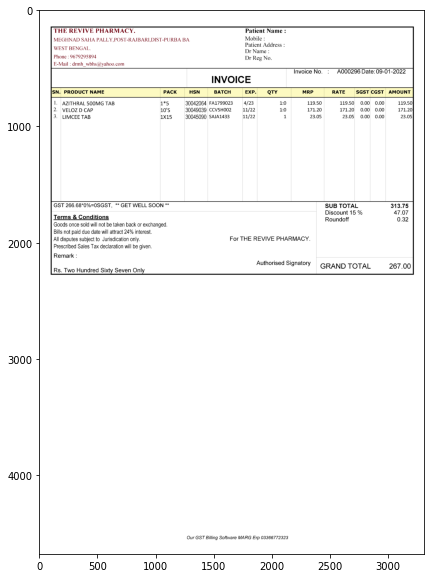


 {'Patient Name': '', 'Patient Mobile Number': [9679295894], 'Patient Address': '', 'Date': '09-01-2022', 'Invoice Number': 'A000296'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,AZITHRAL 50OMG TAB,1*5,30042064,FA1799023,4/23,1:0,119.50,119.50,0.00,0.00,119.50
1,2.,VELOZ D CAP,10'S,30049039,CCV5H002,11/22,1:0,171.20,171.20,0.00,0.00,171.20
2,3.,LIMCEE TAB,1X15,30045090,SAJA1433,11/22,1,23.05,23.05,0.00,0.00,23.05



 {'SUB TOTAL': 313.75, 'Discount 15 %': 47.07, 'Roundoff': 0.32, 'GRAND TOTAL': 267.0} 


-----------------------------------------------------------------------------------------------------------------------

134-15-1648965115816.png


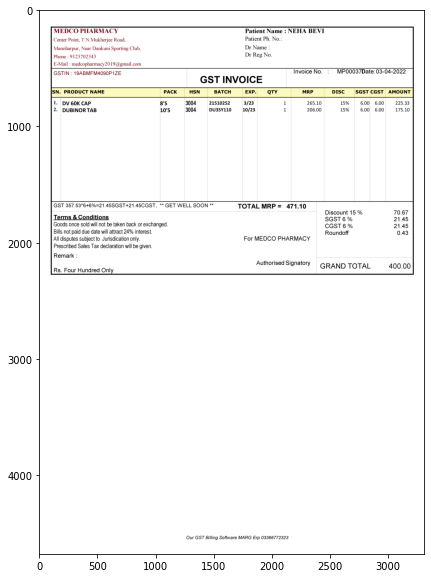


 {'Patient Name': 'NEHA BEVI', 'Patient Mobile Number': [9123702343], 'Patient Address': '', 'Date': '03-04-2022', 'Invoice Number': 'MP00037'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DISC,SGST,CGST,AMOUNT
0,1.,DV 60K CAP,8'S,3004,21510252,3/23,1,265.10,15%,6.00,6.00,225.33
1,2.,DUBINORTAB,10'S,3004,DU3SY110,10/23,1,206.00,15%,6.00,6.00,175.10



 {'Discount 15 %': 70.67, 'SGST 6 %': 21.45, 'CGST 6 %': 21.45, 'Roundoff': 0.43, 'GRAND TOTAL': 400.0} 


-----------------------------------------------------------------------------------------------------------------------

134-33-1650813462629.png


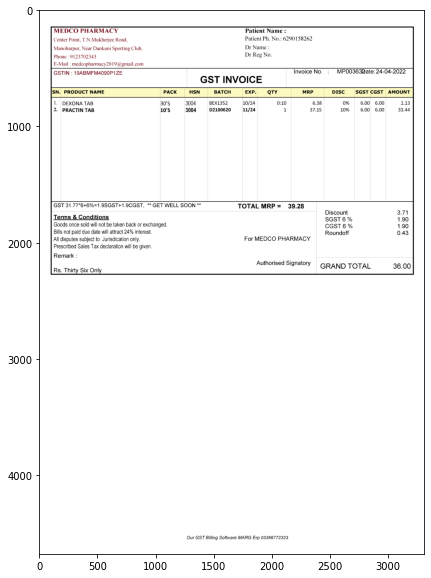


 {'Patient Name': '', 'Patient Mobile Number': [6290158262, 9123702343], 'Patient Address': '', 'Date': '24-04-2022', 'Invoice Number': 'MP00363'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DISC,SGST,CGST,AMOUnT
0,1.,DEXONA TAB,30'S,3004,BEX1352,10/24,0:10,6.38,0%,6.00,6.00,2.13
1,2.,PRACTIN TAB,10'S,3004,D2100620,11/24,1,37.15,10%,6.00,6.00,33.44



 {'Discount': 3.71, 'SGST 6 %': 1.9, 'CGST 6 %': 1.9, 'Roundoff': 0.43, 'GRAND TOTAL': 36.0} 


-----------------------------------------------------------------------------------------------------------------------

134-22-1645013725538.png


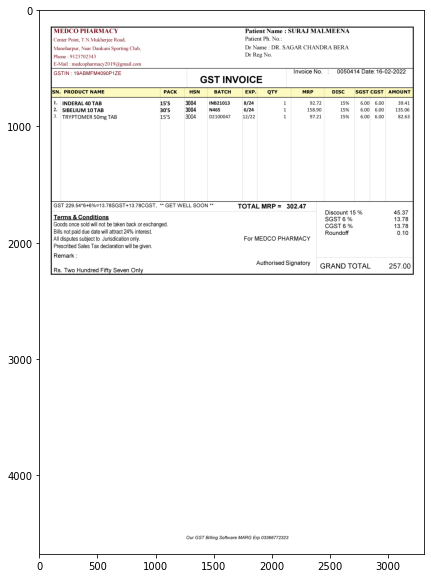


 {'Patient Name': 'SURAJ MALMEENA', 'Patient Mobile Number': [9123702343], 'Patient Address': '', 'Date': '16-02-2022', 'Invoice Number': '0050414'} 



,SN.,PRODUCt NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DISC,SGST,CGST,AMOUNT
0,1.,INDERAL 40 TAB,15'S,3004,INB21013,8/24,1,92.72,15%,6.00,6.00,39.41
1,2.,SIBELIUM 10TAB,30'S,3004,N465,6/24,1,158.90,15%,6.00,6.00,135.06
2,3.,TRYPTOMER 5Omg TAB,15'S,3004,D2100047,12/22,1,97.21,15%,6.00,6.00,82.63



 {'Discount 15 %': 45.37, 'SGST 6 %': 13.78, 'CGST 6 %': 13.78, 'Roundoff': 0.1, 'GRAND TOTAL': 257.0} 


-----------------------------------------------------------------------------------------------------------------------

134-24-1642514630160.png


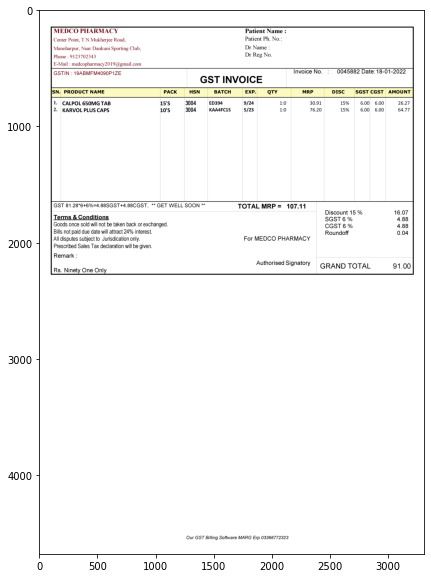


 {'Patient Name': '', 'Patient Mobile Number': [9123702343], 'Patient Address': '', 'Date': '18-01-2022', 'Invoice Number': '0045882'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DISC,SGST,CGST,AMOUNT
0,1.,CALPOL 650MG TAB,15'S,3004,ED394,9/24,1:0,30.91,15%,6.00,6.00,26.27
1,2.,KARVOL PLUS CAPS,10'S,3004,KAA4FC1S,5/23,1:0,76.20,15%,6.00,6.00,64.77



 {'Discount 15 %': 16.07, 'SGST 6 %': 4.88, 'CGST 6 %': 4.88, 'Roundoff': 0.04, 'GRAND TOTAL': 91.0} 


-----------------------------------------------------------------------------------------------------------------------

134-7-1644044590549.png


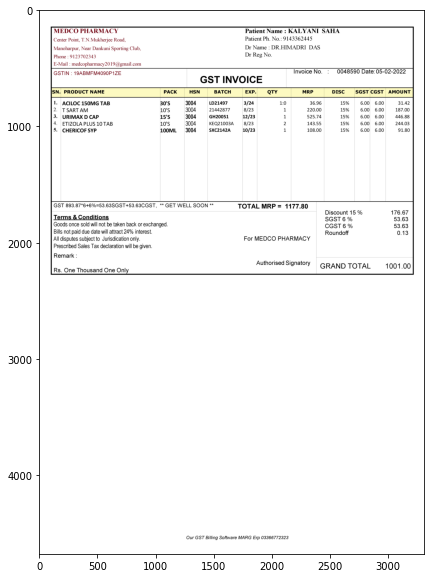


 {'Patient Name': 'KALYANI SAHA', 'Patient Mobile Number': [9143362445, 9123702343], 'Patient Address': '', 'Date': '05-02-2022', 'Invoice Number': '0048590'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DISC,SGST,CGST,AMOUNT
0,1.,ACILOC 150MG TAB,30'S,3004,LD21497,3/24,1:0,36.96,15%,6.00,6.00,31.42
1,2.,T SART AM,10'S,3004,21442877,8/23,1,220.00,15%,6.00,6.00,187.00
2,3.,URIMAX D CAP,15'S,3004,GH20051,12/23,1,525.74,15%,6.00,6.00,446.88
3,4.,ETIZOLA PLUS 1O TAB,10'S,3004,KEQ21003A,8/23,2,143.55,15%,6.00,6.00,244.03
4,5.,CHERICOF SYP,100ML,3004,SXC2142A,10/23,1,108.00,15%,6.00,6.00,91.80



 {'Discount 15 %': 176.67, 'SGST 6 %': 53.63, 'CGST 6 %': 53.63, 'Roundoff': 0.13, 'GRAND TOTAL': 1001.0} 


-----------------------------------------------------------------------------------------------------------------------

135-1-1642171313514.png


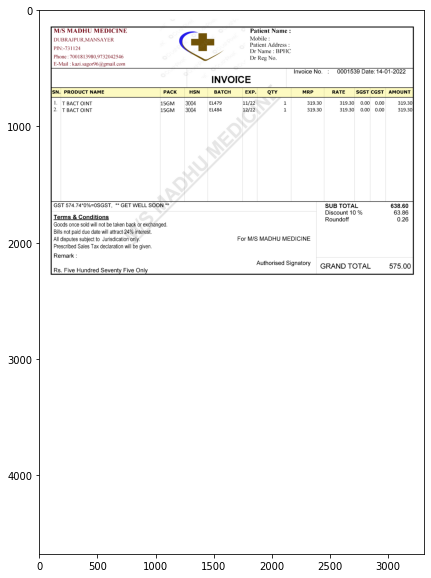


 {'Patient Name': '', 'Patient Mobile Number': [7001813980, 9732042546], 'Patient Address': '', 'Date': '14-01-2022', 'Invoice Number': '0001539'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,T BACT OINT,15GM,3004,EL479,11/22,1,319.30,319.30,0.00,0.00,319.30
1,2.,T BACT OINT,15GM,3004,EL484,12/22,1,319.30,319.30,0.00,0.00,319.30



 {'SUB TOTAL': 638.6, 'Discount 10 %': 63.86, 'Roundoff': 0.26, 'GRAND TOTAL': 575.0} 


-----------------------------------------------------------------------------------------------------------------------

135-1-1645101195357.png


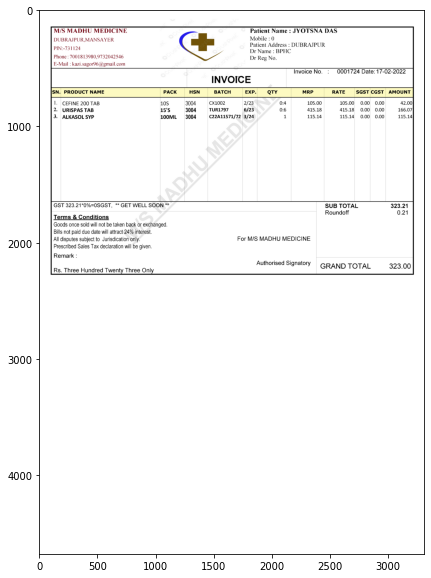


 {'Patient Name': 'JYOTSNA DAS', 'Patient Mobile Number': [7001813980, 9732042546], 'Patient Address': 'DUBRAJPUR', 'Date': '17-02-2022', 'Invoice Number': '0001724'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnt
0,1.,CEFINE 200 TAB,10S,3004,CX1002,2/23,0:4,105.00,105.00,0.00,0.00,42.00
1,2.,URISPAS TAB,15'S,3004,TUR1797,6/23,0:6,415.18,415.18,0.00,0.00,166.07
2,3.,ALKASOL SYP,100ML,3004,C22A11571/72,3/24,1,115.14,115.14,0.00,0.00,115.14



 {'SUB TOTAL': 323.21, 'Roundoff': 0.21, 'GRAND TOTAL': 323.0} 


-----------------------------------------------------------------------------------------------------------------------

135-2-1649082114053.png


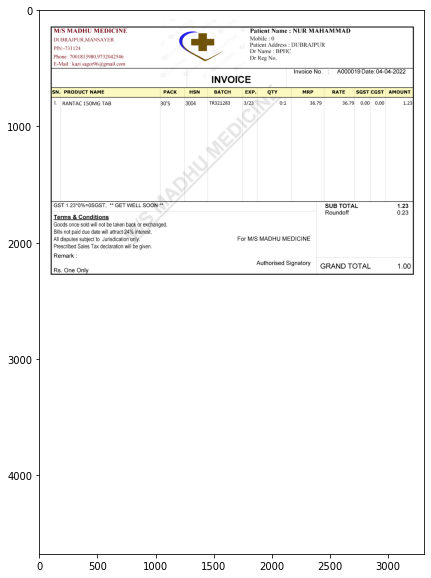


 {'Patient Name': 'NUR MAHAMMAD', 'Patient Mobile Number': [7001813980, 9732042546], 'Patient Address': 'DUBRAJPUR', 'Date': '04-04-2022', 'Invoice Number': 'A000019'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,RANTAC 150MG TAB,30'S,3004,BLANK,3/23,0:1,36.79,36.79,0.00,0.00,1.23



 {'SUB TOTAL': 1.23, 'Roundoff': 0.23, 'GRAND TOTAL': 1.0} 


-----------------------------------------------------------------------------------------------------------------------

135-1-1646109964378.png


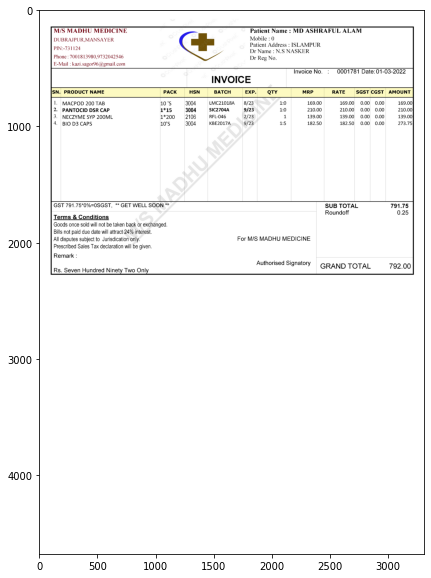


 {'Patient Name': 'MD ASHRAFUL ALAM', 'Patient Mobile Number': [7001813980, 9732042546], 'Patient Address': 'ISLAMPUR', 'Date': '01-03-2022', 'Invoice Number': '0001781'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnt
0,1.,MACPOD 200 TAB,10 'S,3004,BLANK,8/23,1:0,169.00,169.00,0.00,0.00,169.00
1,2.,PANTOCID DSR CAP,1*15,3004,SIC2704A,9/23,1:0,210.00,210.00,0.00,0.00,210.00
2,3.,NECZYME SYP 200ML,1*200,2106,RFL-046,2/23,1,139.00,139.00,0.00,0.00,139.00
3,4.,BIO D3 CAPS,10'S,3004,KBE2017A,9/23,1:5,182.50,182.50,0.00,0.00,273.75



 {'SUB TOTAL': 791.75, 'Roundoff': 0.25, 'GRAND TOTAL': 792.0} 


-----------------------------------------------------------------------------------------------------------------------

137-1-1643771005645.png


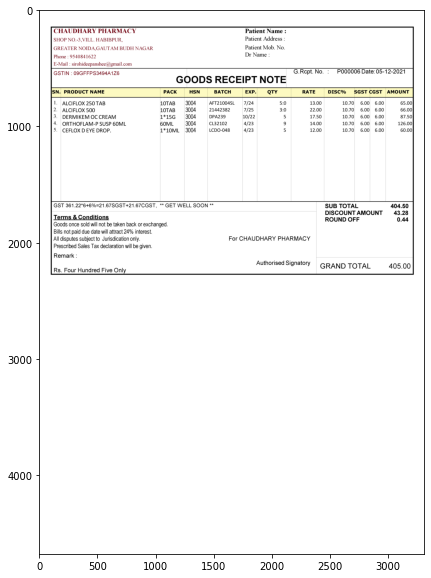


 {'Patient Name': '', 'Patient Mobile Number': [9540841622], 'Patient Address': '', 'Date': '05-12-2021', 'Invoice Number': 'P000006'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,RATE,DISC%,SGST,CGST,AMOUNT
0,1.,ALCIFLOX 250 TAB,10TAB,3004,AFT21004SL,7/24,5:0,13.00,10.70,6.00,6.00,65.00
1,2.,ALCIFLOX 500,10TAB,3004,21442382,7/25,3:0,22.00,10.70,6.00,6.00,66.00
2,3.,DERMIKEM OC CREAM,1*15G,3004,DPA239,10/22,5,17.50,10.70,6.00,6.00,87.50
3,4.,ORTHOELAM-P SUSP 6OML,60ML,3004,CL32102,4/23,9,14.00,10.70,6.00,6.00,126.00
4,5.,CEFLOX D EYE DROP.,1*10ML,3004,LCDO-048,4/23,5,12.00,10.70,6.00,6.00,60.00



 {'SUB TOTAL': 404.5, 'DISCOUNT AMOUNT': 43.28, 'ROUND OFF': 0.44, 'GRAND TOTAL': 405.0} 


-----------------------------------------------------------------------------------------------------------------------

137-1-1643448501303.png


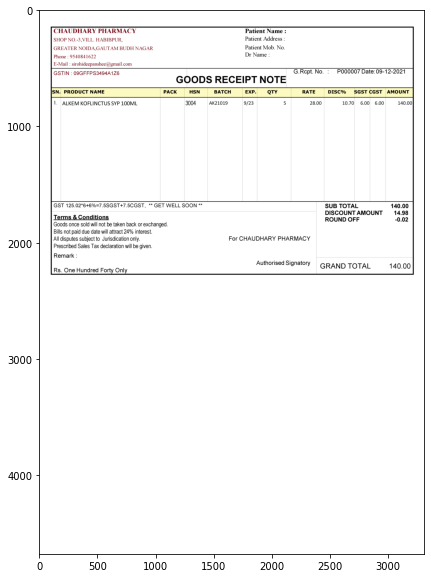


 {'Patient Name': '', 'Patient Mobile Number': [9540841622], 'Patient Address': '', 'Date': '09-12-2021', 'Invoice Number': 'P000007'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,RATE,DISC%,SGST,CGST,AMOUNT
0,1.,ALKEM KOFLINCTUS SYP 1OOML,BLANK,3004,AK21019,9/23,5,28.00,10.70,6.00,6.00,140.00



 {'SUB TOTAL': 140.0, 'DISCOUNT AMOUNT': 14.98, 'ROUND OFF': -0.02, 'GRAND TOTAL': 140.0} 


-----------------------------------------------------------------------------------------------------------------------

141-4-1641195662778.png


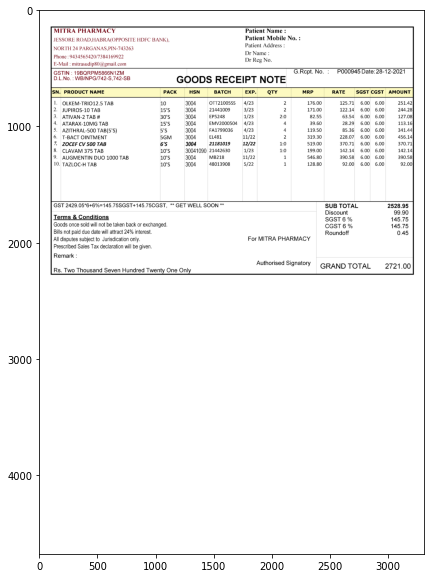


 {'Patient Name': '', 'Patient Mobile Number': [], 'Patient Address': '', 'Date': '28-12-2021', 'Invoice Number': 'P000945'} 



,SN.,PRODUCt nAMe,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnt
0,1.,OLKEM-TRIO12.5 TAB,10,3004,OTT21005SS,4/23,2,176.00,125.71,6.00,6.00,251.42
1,2.,JUPIROS-10 TAB,15'S,3004,21441009,3/23,2,171.00,122.14,6.00,6.00,244.28
2,3.,ATIVAN-2 TAB #,30'S,3004,EP5248,1/23,2:0,82.55,63.54,6.00,6.00,127.08
3,4.,ATARAX-1OMG TAB,15'S,3004,EMV2000504,4/23,4,39.60,28.29,6.00,6.00,113.16
4,5.,AZITHRAL-500 TAB(5'S,5'S,3004,FA1799036,4/23,4,119.50,85.36,6.00,6.00,341.44
5,6.,T-BACT OINTMENT,5GM,3004,EL481,11/22,2,319.30,228.07,6.00,6.00,456.14
6,7.,ZOCEF CV 500 TAB,6'S,3004,21181019,12/22,1:0,519.00,370.71,6.00,6.00,370.71
7,8.,CLAVAM 375 tAB,10'S,30041090,21442630,1/23,1:0,199.00,142.14,6.00,6.00,142.14
8,9.,AUGMENTIN DUO 10OO TAB,10'S,3004,MB218,11/22,1,546.80,390.58,6.00,6.00,390.58
9,10.,TAZLOC-H TAB,10'S,3004,48013908,5/22,1,128.80,92.00,6.00,6.00,92.00



 {'SUB TOTAL': 2528.95, 'Discount': 99.9, 'SGST 6 %': 145.75, 'CGST 6 %': 145.75, 'Roundoff': 0.45, 'GRAND TOTAL': 2721.0} 


-----------------------------------------------------------------------------------------------------------------------

141-5-1644147608973.png


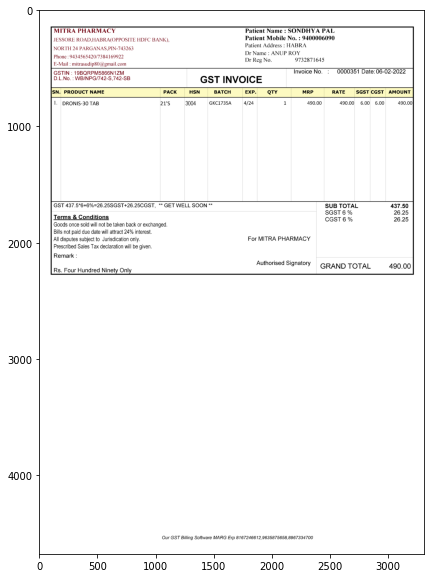


 {'Patient Name': 'SONDHYA PAL', 'Patient Mobile Number': [9400006090, 9732871645], 'Patient Address': 'HABRA', 'Date': '06-02-2022', 'Invoice Number': '0000351'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,DRONIS-30 TAB,21'S,3004,GKC1735A,4/24,1,490.00,490.00,6.00,6.00,490.00



 {'SUB TOTAL': 437.5, 'SGST 6 %': 26.25, 'CGST 6 %': 26.25, 'GRAND TOTAL': 490.0} 


-----------------------------------------------------------------------------------------------------------------------

141-4-1641712599690.png


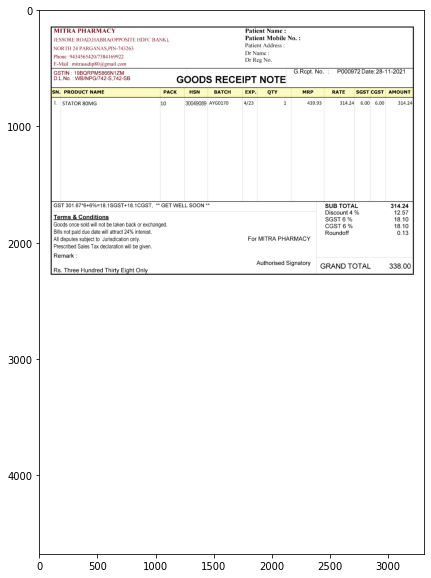


 {'Patient Name': '', 'Patient Mobile Number': [], 'Patient Address': '', 'Date': '28-11-2021', 'Invoice Number': 'P000972'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,STATOR 80MG,10,30049089,AYG0170,4/23,1,439.93,314.24,6.00,6.00,314.24



 {'SUB TOTAL': 314.24, 'Discount 4 %': 12.57, 'SGST 6 %': 18.1, 'CGST 6 %': 18.1, 'Roundoff': 0.13, 'GRAND TOTAL': 338.0} 


-----------------------------------------------------------------------------------------------------------------------

141-1-1642576814008.png


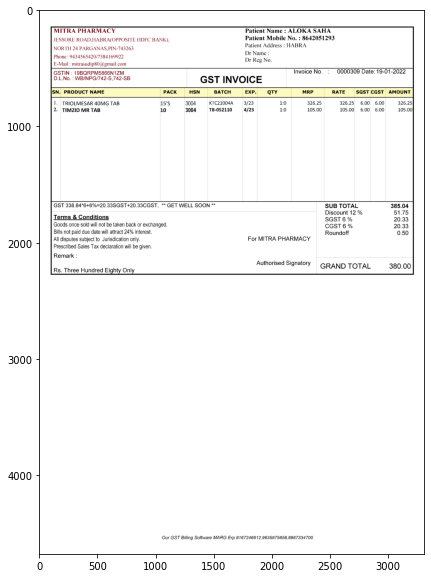


 {'Patient Name': 'ALOKA SAHA', 'Patient Mobile Number': [8642051293], 'Patient Address': 'HABRA', 'Date': '19-01-2022', 'Invoice Number': '0000309'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,TRIOLMESAR 4OMG TAB,15'S,3004,KTC21004A,3/23,1:0,326.25,326.25,6.00,6.00,326.25
1,2.,TIMZID MR TAB,10,3004,TB-052110,4/23,1:0,105.00,105.00,6.00,6.00,105.00



 {'SUB tOtAL': 385.04, 'Discount 12 %': 51.75, 'SGST 6 %': 20.33, 'CGST 6 %': 20.33, 'Roundoff': 0.5, 'GRAND TOTAL': 380.0} 


-----------------------------------------------------------------------------------------------------------------------

141-6-1644070570230.png


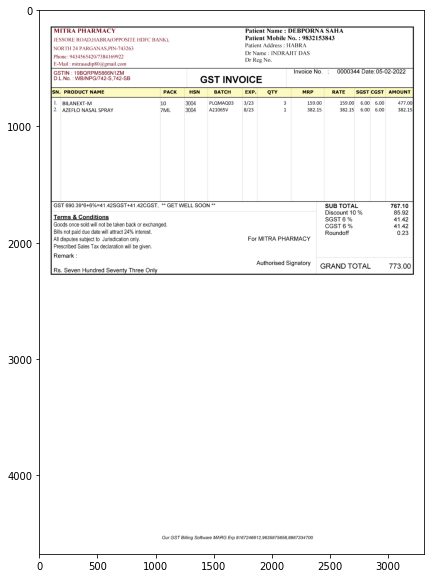


 {'Patient Name': 'DEBPORNA SAHA', 'Patient Mobile Number': [9832153843], 'Patient Address': 'HABRA', 'Date': '05-02-2022', 'Invoice Number': '0000344'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,BILANEXT-M,10,3004,PLQMAQ03,3/23,3,159.00,159.00,6.00,6.00,477.00
1,2.,AZEELO NASAL SPRAY,7ML,3004,A21065V,8/23,1,382.15,382.15,6.00,6.00,382.15



 {'SUB tOtAL': 767.1, 'Discount 1o %': 85.92, 'SGST 6 %': 41.42, 'CGST 6 %': 41.42, 'Roundoff': 0.23, 'GRAND TOTAL': 773.0} 


-----------------------------------------------------------------------------------------------------------------------

143-15-1650540522747.png


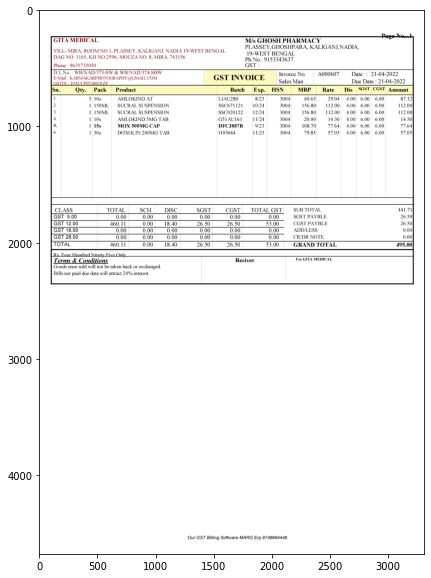


 {'Patient Name': 'GHOSHPHARMACY', 'Patient Mobile Number': [9153343637, 9635735050], 'Patient Address': '', 'Date': '21-04-2022', 'Invoice Number': 'A000607'} 



,Sn.,Qty.,Pack,Product,Batch,Exp.,HSN,MRP,Rate,Dis,SGST,CGST,Amount
0,1.,3,10s,AMLOKIND AT,LIAU280,8/23,3004,40.65,29.04,4.00,6.00,6.00,87.12
1,2.,1,150ML,SUCRAL SUSPENSION,SSC671121,10/24,3004,156.80,112.00,4.00,6.00,6.00,112.00
2,3.,1,150ML,SUCRAL SUSPENSION,SSC020122,12/24,3004,156.80,112.00,4.00,6.00,6.00,112.00
3,4.,1,10s,AMLOKIND 5MG TAB,G51AU161,11/24,3004,20.00,14.30,4.00,6.00,6.00,14.30
4,5.,1,15s,MOX 500MG CAP,DFC3887B,9/23,3004,108.70,77.64,4.00,6.00,6.00,77.64
5,6.,1,30s,DOXOLIN 200MG TAB,I105664,11/23,3004,79.85,57.05,4.00,6.00,6.00,57.05



 {'SUB TOTAL': 441.71, 'SGST PAYBLE': 26.5, 'CGST PAYBLE': 26.5, 'ADD/LESS': 0.0, 'CR/DR NOTE': 0.0, 'GRAND TOTAU': 495.0} 


-----------------------------------------------------------------------------------------------------------------------

143-5-1648874024756.png


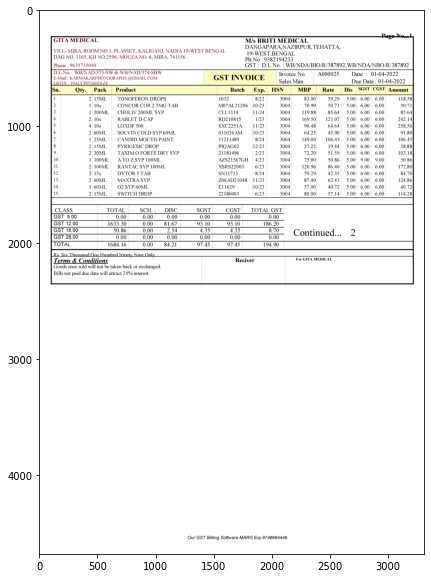


 {'Patient Name': 'BRIT MEDICAL', 'Patient Mobile Number': [9382194233, 9635735050], 'Patient Address': '', 'Date': '01-04-2022', 'Invoice Number': 'A000025'} 



,Sn.,Qty.,Pack,Product,Batch,Exp.,HSN,MRP,Rate,Dis,SGST,CGST,Amount
0,1.,2,15ML,TONOFERONDROPS,1032,8/22,3004,83.00,59.29,5.00,6.00,6.00,118.58
1,2.,BLANK,10s,CONCOR COR 2.5MG TAB,M07AL21206,10/23,3004,70.99,50.71,5.00,6.00,6.00,50.71
2,3.,1,200ML,CHOLIV 200ML SYP,CLL1114,11/24,3004,119.88,85.64,5.00,6.00,6.00,85.64
3,4.,2,10s,RABLET D CAP,RD210815,1/23,3004,169.50,121.07,5.00,6.00,6.00,242.14
4,5.,4,10s,LOXOF 500,SXC2251A,11/23,3004,90.48,64.64,5.00,6.00,6.00,258.56
5,6.,2,60ML,SOLVIN COLD SYP 60ML,031026AM,10/23,3004,64.25,45.90,5.00,6.00,6.00,91.80
6,7.,BLANK,25ML,CANDID MOUTHPAINT,11211489,8/24,3004,149.00,106.45,5.00,6.00,6.00,106.45
7,8.,2,15ML,PYRIGESIC DROP,PIQAG02,12/23,3004,27.22,19.44,5.00,6.00,6.00,38.88
8,9.,2,30ML,TAXIMO FORTEDRY SYP,21181496,2/23,3004,72.20,51.59,5.00,6.00,6.00,103.18
9,10.,BLANK,100ML,A TO Z SYP 100M,AZS21367GH,4/23,3004,75.00,50.86,5.00,9.00,9.00,50.86



 {'Continued...': 2.0} 


-----------------------------------------------------------------------------------------------------------------------

143-28-1648905890668.png


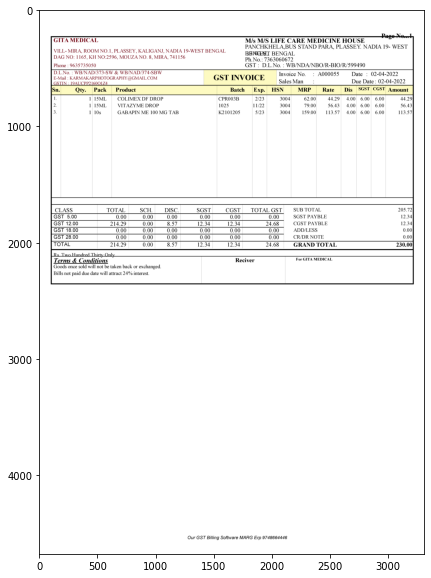


 {'Patient Name': 'M/S LIFE CARE MEDICINE HOUSF', 'Patient Mobile Number': [7363060672, 9635735050], 'Patient Address': '', 'Date': '02-04-2022', 'Invoice Number': 'A000055'} 



,Sn.,Qty.,Pack,Product,Batch,Exp.,HSN,MRP,Rate,Dis,SGST,CGST,Amount
0,1.,1,15ML,COLIMEX DF DROP,CPR003B,2/23,3004,62.00,44.29,4.00,6.00,6.00,44.29
1,2.,1,15ML,VTAZYME DROP,1025,11/22,3004,79.00,56.43,4.00,6.00,6.00,56.43
2,3.,1,10s,GABAPIN ME 100 MG TAB,K2101205,5/23,3004,159.00,113.57,4.00,6.00,6.00,113.57



 {'SUB TOTAL': 205.72, 'SGST PAYBLE': 12.34, 'CGST PAYBLE': 12.34, 'ADD/LESS': 0.0, 'CR/DR NOTE': 0.0, 'GRAND TOTAU': 230.0} 


-----------------------------------------------------------------------------------------------------------------------

143-11-1650527965275.png


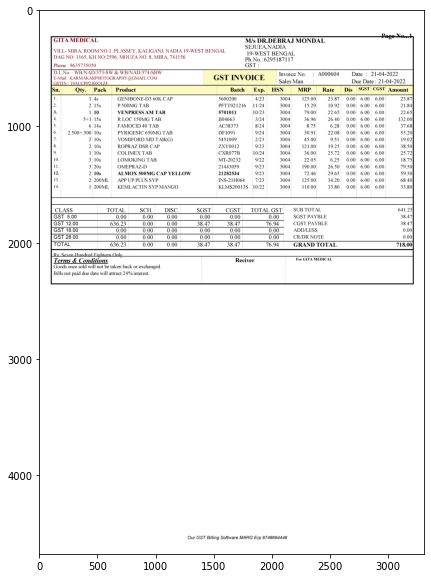


 {'Patient Name': 'DR.DEBRAJ MONDAL', 'Patient Mobile Number': [6295187117, 9635735050], 'Patient Address': '', 'Date': '21-04-2022', 'Invoice Number': 'A000604'} 



,Sn.,Qty.,Pack,Product,Batch,Exp.,HSN,MRP,Rate,Dis,SGST,CGST,Amount
0,1.,1,4s,GENIBONE-D3 60K CAP,5600200,4/23,3004,125.00,23.87,0.00,6.00,6.00,23.87
1,2.,2,15s,P 500MG TAB,PFTT021216,11/24,3004,15.29,10.92,0.00,6.00,6.00,21.84
2,3.,1,10,VENPRESS AM TAB,5701011,10/23,3004,79.00,22.65,0.00,6.00,6.00,22.65
3,4.,5+1,15 s,R LOC 150MG TAB,II04663,3/24,3004,36.96,26.40,0.00,6.00,6.00,132.00
4,5.,6,14s,FAMOCID 40 TAB,AC38373,8/24,3004,8.75,6.28,0.00,6.00,6.00,37.68
5,6.,2.500+.500,10s,PYRIGESIC 650MG TAB,DF1091,9/24,3004,30.91,22.08,0.00,6.00,6.00,55.20
6,7.,2,10s,VOMIFORD MD TAB(G),5451009,2/23,3004,45.00,9.51,0.00,6.00,6.00,19.02
7,8.,2,10s,ROPRAZ DSR CAP,ZXY0012,9/23,3004,121.00,19.25,0.00,6.00,6.00,38.50
8,9.,1,10s,COLIMEX TAB,CXR077B,10/24,3004,36.00,25.72,0.00,6.00,6.00,25.72
9,10.,3,10s,LOMOKING TAB,MT-20232,9/22,3004,22.05,6.25,0.00,6.00,6.00,18.75



 {'SUB TOTAL': 641.23, 'SGST PAYBLE': 38.47, 'CGST PAYBLE': 38.47, 'ADD/LESS': 0.0, 'CR/DR NOTE': 0.0, 'GRAND TOTAU': 718.0} 


-----------------------------------------------------------------------------------------------------------------------

144-6-1645350607739.png


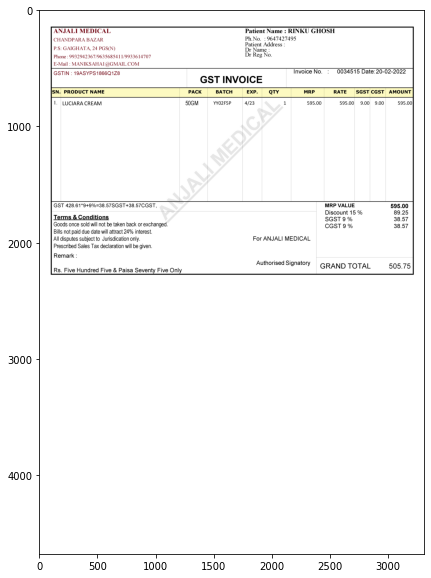


 {'Patient Name': 'RINKU GHOSH', 'Patient Mobile Number': [9647427495], 'Patient Address': '', 'Date': '20-02-2022', 'Invoice Number': '0034515'} 



,SN.,PRODUCt NAME,PACK,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,LUCIARA CREAM,50GM,YY02F5P,4/23,1,595.00,595.00,9.00,9.00,595.00



 {'MRP VALUE': 595.0, 'Discount 15 %': 89.25, 'SGST 9 %': 38.57, 'CGST 9 %': 38.57, 'GRAND TOTAL': 505.75} 


-----------------------------------------------------------------------------------------------------------------------

144-3-1645426795109.png


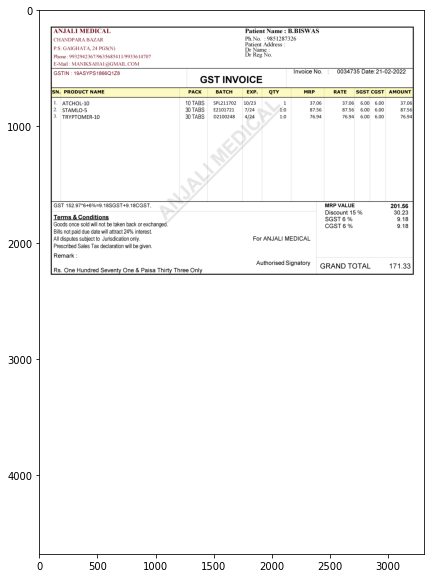


 {'Patient Name': 'B.BISWAS', 'Patient Mobile Number': [9851287326], 'Patient Address': '', 'Date': '21-02-2022', 'Invoice Number': '0034735'} 



,SN.,PRODUCt NAME,PACK,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,ATCHOL-10,10 TABS,SPL211702,10/23,1,37.06,37.06,6.00,6.00,37.06
1,2.,STAMLO-5,30 TABS,E2101721,7/24,1:0,87.56,87.56,6.00,6.00,87.56
2,3.,TRYPTOMER-10,30 TABS,D2100248,4/24,1:0,76.94,76.94,6.00,6.00,76.94



 {'MRP VALUE': 201.56, 'Discount 15 %': 30.23, 'SGST 6 %': 9.18, 'CGST 6 %': 9.18, 'GRAND TOTAL': 171.33} 


-----------------------------------------------------------------------------------------------------------------------

144-28-1645719534983.png


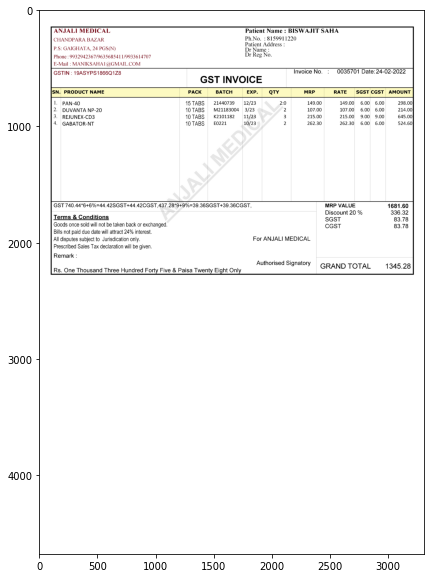


 {'Patient Name': 'BISWAJT SAHA', 'Patient Mobile Number': [8159911220], 'Patient Address': '', 'Date': '24-02-2022', 'Invoice Number': '0035701'} 



,SN.,PRODUCT NAME,PACK,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMount
0,1.,PAN-40,15 TABS,BLANK,12/23,2:0,149.00,149.00,6.00,6.00,298.00
1,2.,DUVANTA NP-20,10 TABS,M21183004,3/23,2,107.00,107.00,6.00,6.00,214.00
2,3.,REJUNEX-CD3,10 TABS,K2101182,11/23,3,215.00,215.00,9.00,9.00,645.00
3,4.,GABATOR-NT,10 TABS,E0221,10/23,2,262.30,262.30,6.00,6.00,524.60



 {'WRP VALUE': 1681.6, 'Discount 20 %': 336.32, 'SGST': 83.78, 'CGST': 83.78, 'GRAND TOTAL': 1345.28} 


-----------------------------------------------------------------------------------------------------------------------

144-5-1646572136407.png


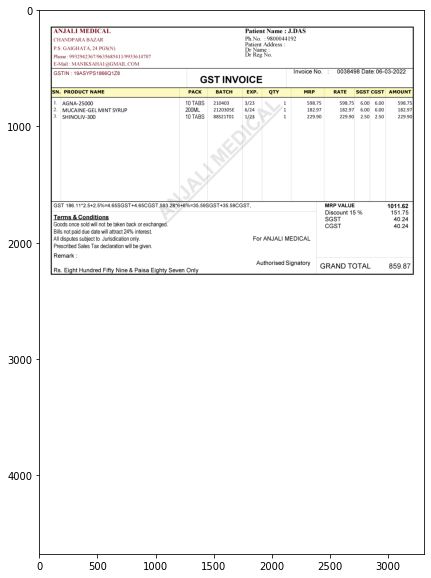


 {'Patient Name': 'J.DAS', 'Patient Mobile Number': [9800044192], 'Patient Address': '', 'Date': '06-03-2022', 'Invoice Number': '0038498'} 



,SN.,PRODUCT NAME,PACK,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,AGNA-25000,10 TABS,210403,3/23,1,598.75,598.75,6.00,6.00,598.75
1,2.,MUCAINE-GEL MINT SYRUP,200ML,2120305E,6/24,1,182.97,182.97,6.00,6.00,182.97
2,3.,SHINOLIV-300,10 TABS,88S21T01,1/23,1,229.90,229.90,2.50,2.50,229.90



 {'MRP VALUE': 1011.62, 'Discount 15 %': 151.75, 'SGST': 40.24, 'CGST': 40.24, 'GRAND TOTAL': 859.87} 


-----------------------------------------------------------------------------------------------------------------------

144-10-1647100505849.png


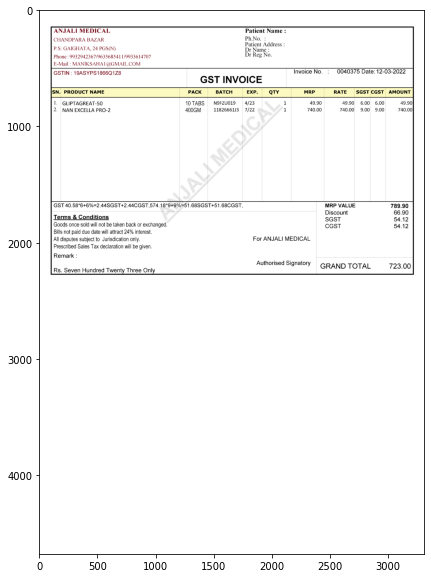


 {'Patient Name': '', 'Patient Mobile Number': [], 'Patient Address': '', 'Date': '12-03-2022', 'Invoice Number': '0040375'} 



,SN.,PRODUCT NAME,PACK,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMount
0,1.,GLIPTAGREAT-50,10 TABS,BLANK,4/23,1,49.90,49.90,6.00,6.00,49.90
1,2.,NAN EXCELLA PRO-2,400GM,11826661J3,7/22,1,740.00,740.00,9.00,9.00,740.00



 {'MRP VALUE': 789.9, 'Discount': 66.9, 'SGST': 54.12, 'CGST': 54.12, 'GRAND TOTAL': 723.0} 


-----------------------------------------------------------------------------------------------------------------------

146-1-1645101530843.png


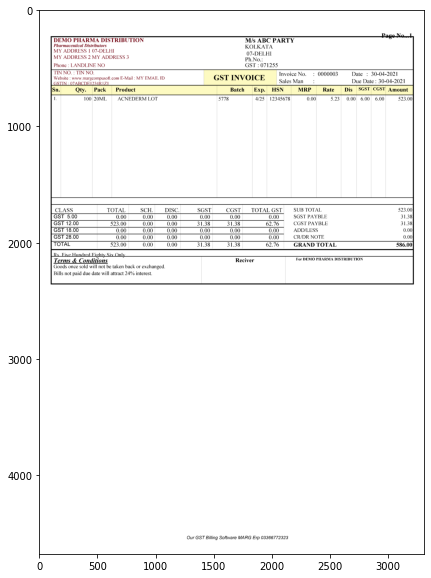


 {'Patient Name': 'ABCPARTY', 'Patient Mobile Number': [], 'Patient Address': '', 'Date': '30-04-2021', 'Invoice Number': '0000003'} 



,Sn.,Qty.,Pack,Product,Batch,Exp.,HSN,MRP,Rate,Dis,SGST,CGST,Amount
0,1.,100,20ML,ACNEDERM LOT,5778,4/25,12345678,0.00,5.23,0.00,6.00,6.00,523.00



 {'SUB TOTAI': 523.0, 'SGST PAYBLE': 31.38, 'CGST PAYBLE': 31.38, 'ADD/LESS': 0.0, 'CR/DR NOTE': 0.0, 'GRAND TOTAL': 586.0} 


-----------------------------------------------------------------------------------------------------------------------

147-4-1642670855866.png


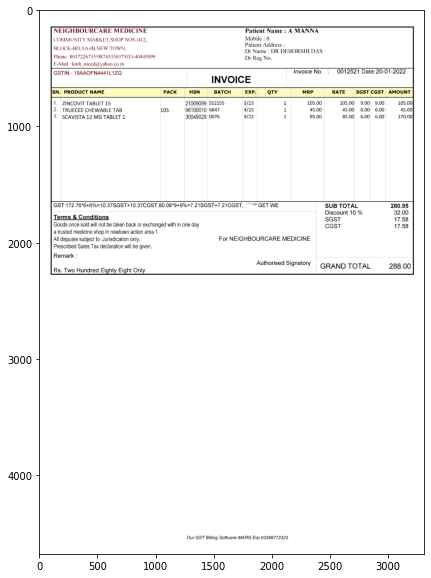


 {'Patient Name': 'A MANNA', 'Patient Mobile Number': [], 'Patient Address': '', 'Date': '20-01-2022', 'Invoice Number': '0012521'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,ZINCOVIT TABLET 15,BLANK,21069099,SS2155,3/23,1,105.00,105.00,9.00,9.00,105.00
1,2.,TRUECEE CHEWVABLE TAB,10S,96190010,6847,4/23,1,45.00,45.00,6.00,6.00,45.00
2,3.,SCAVISTA 12 MG TABLET 1,BLANK,30049029,0076,9/22,2,85.00,85.00,6.00,6.00,170.00



 {'SUB TOTAL': 280.95, 'Discount 10 %': 32.0, 'SGST': 17.58, 'CGST': 17.58, 'GRAND TOTAL': 288.0} 


-----------------------------------------------------------------------------------------------------------------------

147-13-1644750728158.png


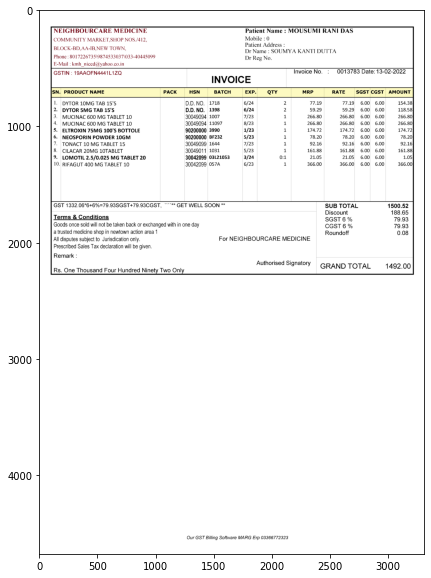


 {'Patient Name': 'MOUSUMI RANI DAS', 'Patient Mobile Number': [], 'Patient Address': '', 'Date': '13-02-2022', 'Invoice Number': '0013783'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnt
0,1.,DYTOR 10MG TAB 15'S,BLANK,D.D.NO.,1718,6/24,2,77.19,77.19,6.00,6.00,154.38
1,2.,DYTOR 5MG TAB 15'S,BLANK,D.D. NO.,1398,6/24,2,59.29,59.29,6.00,6.00,118.58
2,3.,MUCINAC 600 MG TABLET 10,BLANK,30049094,1007,7/23,1,266.80,266.80,6.00,6.00,266.80
3,4.,MUGINAG 6O0 MG TABLET 10,BLANK,30049094,11097,8/23,1,266.80,266.80,6.00,6.00,266.80
4,5.,ELTROXIN 75MG 1OO'S BOTTOLE,BLANK,90200000,3990,1/23,1,174.72,174.72,6.00,6.00,174.72
5,6.,NEOSPORIN POWMDER 1OGM,BLANK,90200000,BF232,5/23,1,78.20,78.20,6.00,6.00,78.20
6,7.,TONACT 10 MG TABLET 15,BLANK,30049099,1644,7/23,1,92.16,92.16,6.00,6.00,92.16
7,8.,CILACAR 20MG 10TABLET,BLANK,30049011,1031,5/23,1,161.88,161.88,6.00,6.00,161.88
8,9.,LOMOTIL 2.5/0.025 MG TABLET 20,BLANK,30042099,03L21053,3/24,0:1,21.05,21.05,6.00,6.00,1.05
9,10.,RIFAGUT 400 MG TABLET 10,BLANK,30042099,057A,6/23,1,366.00,366.00,6.00,6.00,366.00



 {'SUB TOTAL': 1500.52, 'Discount': 188.65, 'SGST 6 %': 79.93, 'CGST 6 %': 79.93, 'Roundoff': 0.08, 'GRAND TOTAL': 1492.0} 


-----------------------------------------------------------------------------------------------------------------------

147-5-1642505429285.png


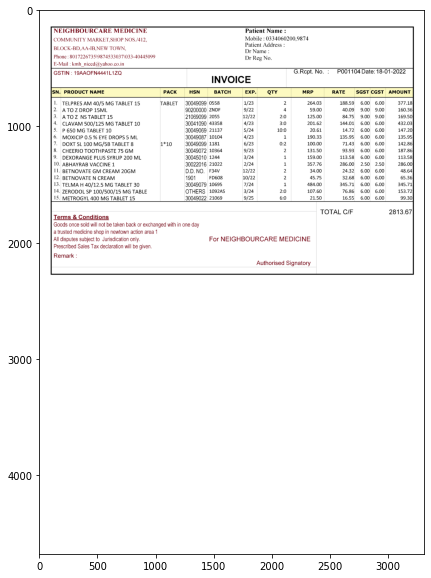


 {'Patient Name': '', 'Patient Mobile Number': [334060200], 'Patient Address': '', 'Date': '18-01-2022', 'Invoice Number': 'P001104'} 



,SN.,PRODUCt NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnt
0,1.,TELPRES AM 40/5 MG TABLET 15,TABLET,30049099,0558,1/23,2,264.03,188.59,6.00,6.00,377.18
1,2.,A TO Z DROP 15ML,BLANK,90200000,ZNDF,9/22,4,59.00,40.09,9.00,9.00,160.36
2,3.,A TO Z NS TABLET 15,BLANK,21069099,2055,12/22,2:0,125.00,84.75,9.00,9.00,169.50
3,4.,CLAVAM 500/125 MG TABLET 10,BLANK,30041090,43358,4/23,3:0,201.62,144.01,6.00,6.00,432.03
4,5.,P 650 MG TABLET 10,BLANK,30049069,21137,5/24,10:0,20.61,14.72,6.00,6.00,147.20
5,6.,MOXICIP 0.5 % EYE DROPS 5 ML,BLANK,30049087,10104,4/23,1,190.33,135.95,6.00,6.00,135.95
6,7.,DOXT SL 100 MG/5B TABLET 8,1*10,30049099,1181,6/23,0:2,100.00,71.43,6.00,6.00,142.86
7,8.,CHEERIO TOOTHPASTE Z5 GM,BLANK,30049072,10364,9/23,2,131.50,93.93,6.00,6.00,187.86
8,9.,DEXORANGE PLUS SYRUP 200 ML,BLANK,30045010,1244,3/24,1,159.00,113.58,6.00,6.00,113.58
9,10.,ABHAYRAB VACCINE 1,BLANK,30022016,21022,2/24,1,357.76,286.00,2.50,2.50,286.00



 {'TOTAL C/E': 2813.67} 


-----------------------------------------------------------------------------------------------------------------------

147-29-1651067402079.png


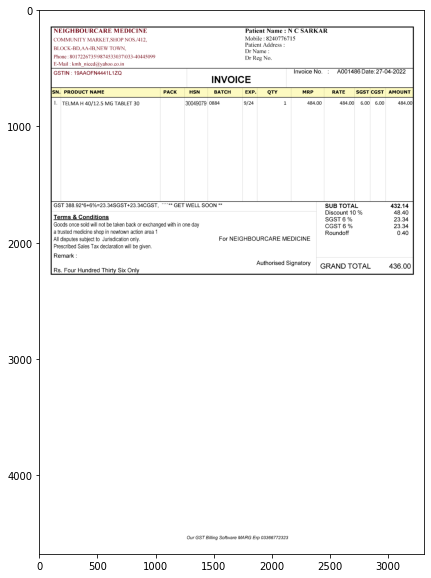


 {'Patient Name': 'N C SARKAR', 'Patient Mobile Number': [8240776715], 'Patient Address': '', 'Date': '27-04-2022', 'Invoice Number': 'A001486'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,TELMA H 40/12.5 MG TABLET 30,BLANK,30049079,0884,9/24,1,484.00,484.00,6.00,6.00,484.00



 {'SuB tOtAL': 432.14, 'Discount 10 %': 48.4, 'SGST 6 %': 23.34, 'CGST 6 %': 23.34, 'Roundoff': 0.4, 'GRAND TOTAL': 436.0} 


-----------------------------------------------------------------------------------------------------------------------

147-37-1651810967309.png


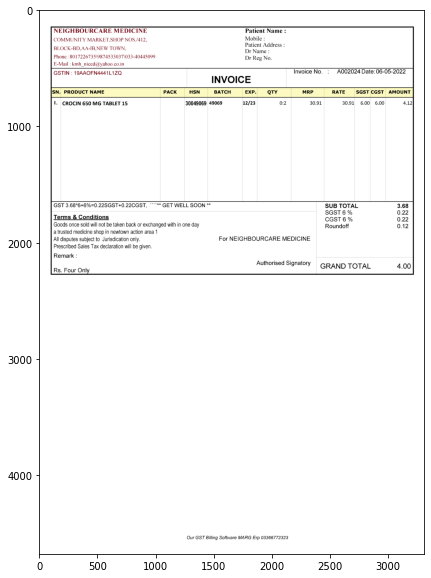


 {'Patient Name': '', 'Patient Mobile Number': [], 'Patient Address': '', 'Date': '06-05-2022', 'Invoice Number': 'A002024'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,CROCIN 650 MG TABLET 15,BLANK,30049069,49069,12/23,0:2,30.91,30.91,6.00,6.00,4.12



 {'SUB TOTAL': 3.68, 'SGST 6 %': 0.22, 'CGST 6 %': 0.22, 'Roundoff': 0.12, 'GRAND TOTAL': 4.0} 


-----------------------------------------------------------------------------------------------------------------------

153-7-1643883253400.png


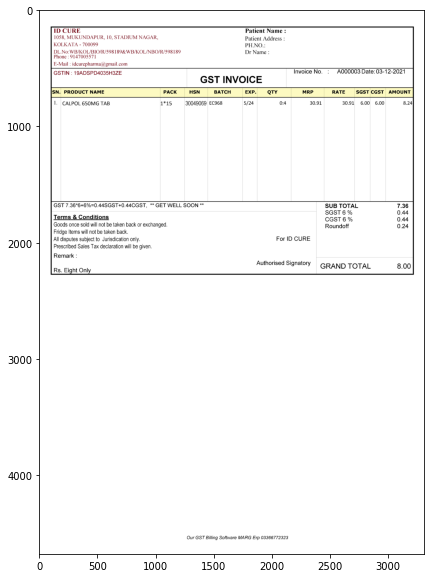


 {'Patient Name': '', 'Patient Mobile Number': [9147005571], 'Patient Address': '', 'Date': '03-12-2021', 'Invoice Number': 'A000003'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,CALPOL 65OMG TAB,1*15,30049069,EC968,5/24,0:4,30.91,30.91,6.00,6.00,8.24



 {'SUB TOTAL': 7.36, 'SGST 6 %': 0.44, 'CGST 6 %': 0.44, 'Roundoff': 0.24, 'GRAND TOTAL': 8.0} 


-----------------------------------------------------------------------------------------------------------------------

153-6-1645189649603.png


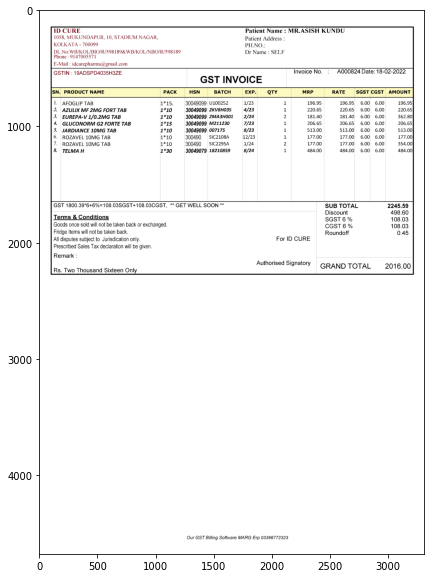


 {'Patient Name': 'MR.ASISH KUNDU', 'Patient Mobile Number': [9147005571], 'Patient Address': '', 'Date': '18-02-2022', 'Invoice Number': 'A000824'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnt
0,1.,AFOGLIP TAB,1*15.,30049099,U100252,1/23,1,196.95,196.95,6.00,6.00,196.95
1,2.,AZULIX MF ZMG FORT TAB,1*10,30049099,2KV8H035,4/23,1,220.65,220.65,6.00,6.00,220.65
2,3.,EUREPA-V 1/0.2MG TAB,1*10,30049099,2MA3H001,2/24,2,181.40,181.40,6.00,6.00,362.80
3,4.,GLUCOMORM GZ FORTE TA:,1*15,30049099,M211230,7/23,1,206.65,206.65,6.00,6.00,206.65
4,5.,JARDIANCE 10MG TAB,1*10,30049099,007175,8/23,1,513.00,513.00,6.00,6.00,513.00
5,6.,ROZAVEL 1OMG TAB,1*10,300490,SIC2108A,12/23,1,177.00,177.00,6.00,6.00,177.00
6,7.,ROZAVEL 1OMG TAB,1*10,300490,SIC2295A,1/24,2,177.00,177.00,6.00,6.00,354.00
7,8.,TELMA H,1*30,30049079,18210859,8/24,1,484.00,484.00,6.00,6.00,484.00



 {'SUB TOTAL': 2245.59, 'Discount': 498.6, 'SGST 6 %': 108.03, 'CGST 6 %': 108.03, 'Roundoff': 0.45, 'GRAND TOTAL': 2016.0} 


-----------------------------------------------------------------------------------------------------------------------

153-90-1644301306434.png


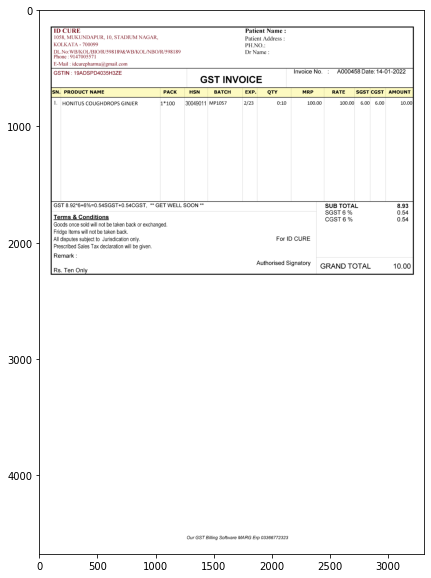


 {'Patient Name': '', 'Patient Mobile Number': [9147005571], 'Patient Address': '', 'Date': '14-01-2022', 'Invoice Number': 'A000458'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,HONITUS COUGHDROPS GINJER,1*100,30049011,MP1057,2/23,0:10,100.00,100.00,6.00,6.00,10.00



 {'SUB TOTAL': 8.93, 'SGST 6 %': 0.54, 'CGST 6 %': 0.54, 'GRAND TOTAL': 10.0} 


-----------------------------------------------------------------------------------------------------------------------

153-16-1644232497511.png


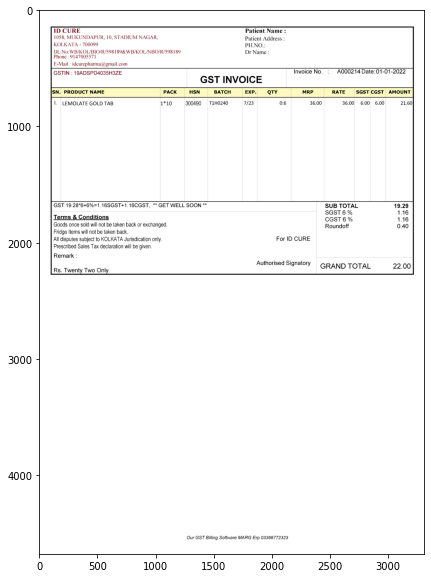


 {'Patient Name': '', 'Patient Mobile Number': [9147005571], 'Patient Address': '', 'Date': '01-01-2022', 'Invoice Number': 'A000214'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,EMOLATE GOLDTAR,1*10,300490,T1H0240,7/23,0:6,36.00,36.00,6.00,6.00,21.60



 {'SUB TOTAL': 19.29, 'SGST 6 %': 1.16, 'CGST 6 %': 1.16, 'Roundoff': 0.4, 'GRAND TOTAL': 22.0} 


-----------------------------------------------------------------------------------------------------------------------

153-148-1644237407879.png


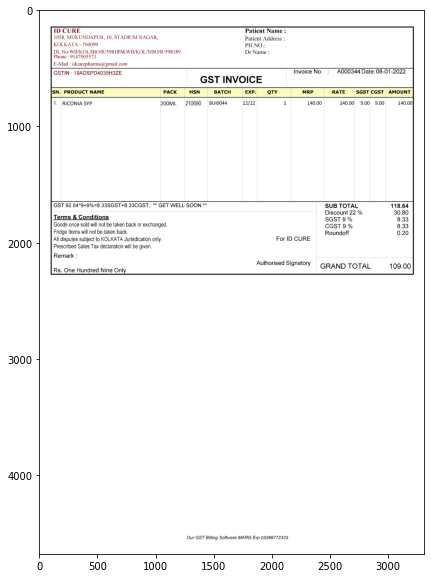


 {'Patient Name': '', 'Patient Mobile Number': [9147005571], 'Patient Address': '', 'Date': '08-01-2022', 'Invoice Number': 'A000344'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,RICONIA SYP,200ML,210690,BUI0044,12/22,1,140.00,140.00,9.00,9.00,140.00



 {'SuB tOtAL': 118.64, 'Discount 22 %': 30.8, 'SGST 9 %': 8.33, 'CGST 9 %': 8.33, 'Roundoff': 0.2, 'GRAND TOTAL': 109.0} 


-----------------------------------------------------------------------------------------------------------------------

154-1-1642837347883.png


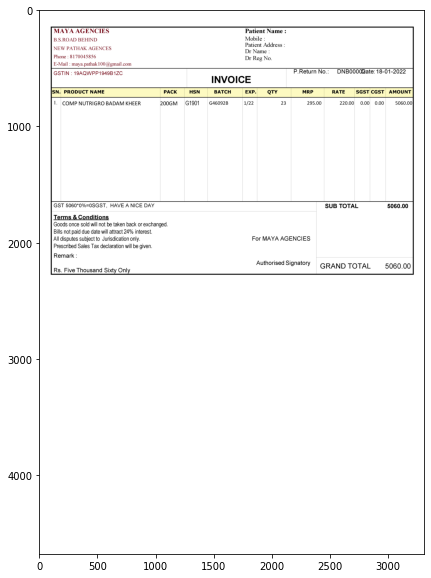


 {'Patient Name': '', 'Patient Mobile Number': [8170045856], 'Patient Address': '', 'Date': '', 'Invoice Number': 'DNB00002ate'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,COMP NUTRIGRO BADAM KHEER,200GM,G1901,G46092B,1/22,23,295.00,220.00,0.00,0.00,5060.00



 {'SUB TOTAL': 5060.0, 'GRAND TOTAL': 5060.0} 


-----------------------------------------------------------------------------------------------------------------------

155-2-1645871338007.png


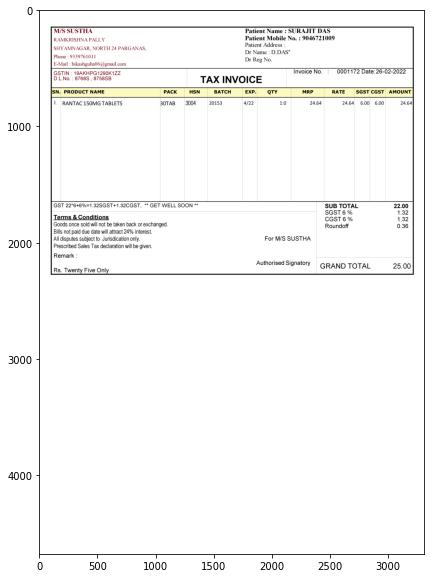


 {'Patient Name': 'SURAJIT DAS', 'Patient Mobile Number': [9046721009, 9339761011], 'Patient Address': '', 'Date': '26-02-2022', 'Invoice Number': '0001172'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,RANTAC 15OMG TABLETS,30TAB,3004,20153,4/22,1:0,24.64,24.64,6.00,6.00,24.64



 {'SUB TOTAL': 22.0, 'SGST 6 %': 1.32, 'CGST 6 %': 1.32, 'Roundoff': 0.36, 'GRAND TOTAL': 25.0} 


-----------------------------------------------------------------------------------------------------------------------

155-1-1646298764650.png


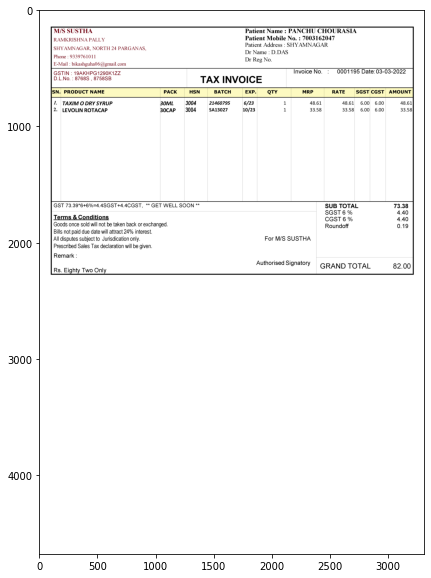


 {'Patient Name': 'PANCHU CHOURASIA', 'Patient Mobile Number': [7003162047, 9339761011], 'Patient Address': 'SHYAMNAGAR', 'Date': '03-03-2022', 'Invoice Number': '0001195'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,TAXIM O DRY SYRUP,30ML,3004,21460795,6/23,1,48.61,48.61,6.00,6.00,48.61
1,2.,LEVOLIN ROTACAP,30CAP,3004,SA13027,10/23,1,33.58,33.58,6.00,6.00,33.58



 {'SUB TOTAL': 73.38, 'SGST 6 %': 4.4, 'CGST 6 %': 4.4, 'Roundoff': 0.19, 'GRAND TOTAL': 82.0} 


-----------------------------------------------------------------------------------------------------------------------

155-1-1645870813857.png


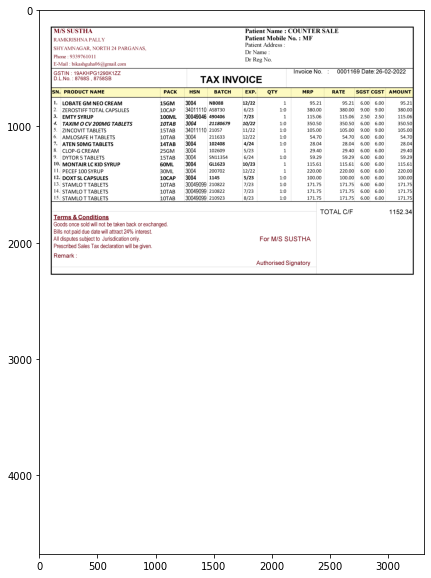


 {'Patient Name': 'COUNTER SALF', 'Patient Mobile Number': [9339761011], 'Patient Address': '', 'Date': '26-02-2022', 'Invoice Number': '0001169'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,LOBATE GMNEO CREAM,15GM,3004,NB088,12/22,1,95.21,95.21,6.00,6.00,95.21
1,2.,ZEROSTIEE TOTAL CAPSULES,10CAP,34011110,ASBT30,6/23,1:0,380.00,380.00,9.00,9.00,380.00
2,3.,EMTY SYRUP,100ML,30049046,490406,7/23,1,115.06,115.06,2.50,2.50,115.06
3,4.,TAXIM O CV 200MG TABLETS,10TAB,3004,21180679,10/22,1:0,350.50,350.50,6.00,6.00,350.50
4,5.,ZINCOVIT TABLETS,15TAB,34011110,21057,11/22,1:0,105.00,105.00,9.00,9.00,105.00
5,6.,AMLOSAEE HTABLETS,10TAB,3004,211633,12/22,1:0,54.70,54.70,6.00,6.00,54.70
6,7.,ATEN 50MG TABLETS,14TAB,3004,102408,4/24,1:0,28.04,28.04,6.00,6.00,28.04
7,8.,CLOP-G CREAM,25GM,3004,102609,5/23,1,29.40,29.40,6.00,6.00,29.40
8,9.,DYTOR 5 TABLETS,15TAB,3004,SN11354,6/24,1:0,59.29,59.29,6.00,6.00,59.29
9,10.,MONTAIR LC KID SYRUP,60ML,3004,GL1623,10/23,1,115.61,115.61,6.00,6.00,115.61



 {'TOTAL C/E': 1152.34} 


-----------------------------------------------------------------------------------------------------------------------

155-2-1645870616424.png


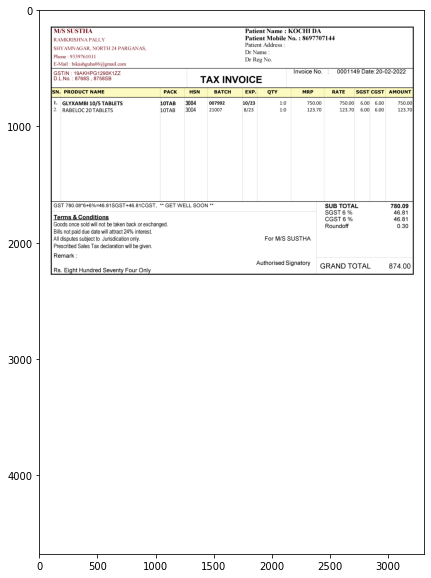


 {'Patient Name': 'KOCH DA', 'Patient Mobile Number': [8697707144, 9339761011], 'Patient Address': '', 'Date': '20-02-2022', 'Invoice Number': '0001149'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,GLYXAMBI 10/5 TABLETS,10TAB,3004,007992,10/23,1:0,750.00,750.00,6.00,6.00,750.00
1,2.,RABELOC 20 TABLETS,10TAB,3004,21007,8/23,1:0,123.70,123.70,6.00,6.00,123.70



 {'SUB TOTAL': 780.09, 'SGST 6 %': 46.81, 'CGST 6 %': 46.81, 'Roundoff': 0.3, 'GRAND TOTAL': 874.0} 


-----------------------------------------------------------------------------------------------------------------------

155-1-1645870462893.png


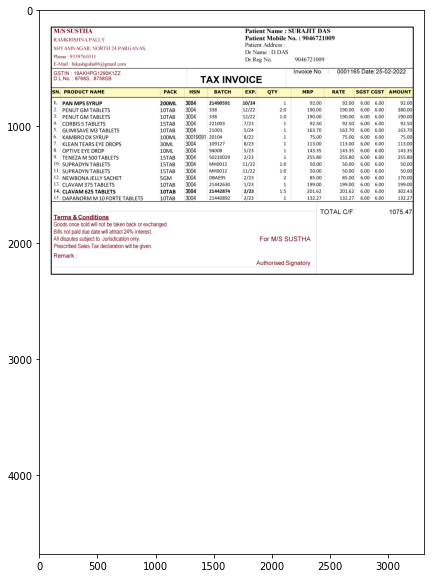


 {'Patient Name': 'SURAJT DAS', 'Patient Mobile Number': [9046721009, 9339761011, 9046721009], 'Patient Address': '', 'Date': '25-02-2022', 'Invoice Number': '0001165'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,PAN MPS SYRUP,200ML,3004,21490591,10/24,1,92.00,92.00,6.00,6.00,92.00
1,2.,PENUT GMTABLETS,10TAB,3004,338,12/22,2:0,190.00,190.00,6.00,6.00,380.00
2,3.,PENUT GMTABLETS,10TAB,3004,338,12/22,1:0,190.00,190.00,6.00,6.00,190.00
3,4.,CORBIS 5 TABLETS,15TAB,3004,221003,7/23,1,92.50,92.50,6.00,6.00,92.50
4,5.,GLIMISAVE M3 TABLETS,10TAB,3004,21003,5/24,1,163.70,163.70,6.00,6.00,163.70
5,6.,KAMBRO DX SYRUP,100ML,30019091,20104,8/22,1,75.00,75.00,6.00,6.00,75.00
6,7.,KLEANTEARS EYE DROPS,30ML,3004,109127,8/23,1,113.00,113.00,6.00,6.00,113.00
7,8.,OPTIVE EYE DROP,10ML,3004,94008,5/23,1,143.35,143.35,6.00,6.00,143.35
8,9.,TENEZA M 5OO TABLETS,15TAB,3004,50210029,2/23,1,255.80,255.80,6.00,6.00,255.80
9,10.,SUPRADYN TABLETS,15TAB,3004,MH0012,11/22,1:0,50.00,50.00,6.00,6.00,50.00



 {'TOTAL C/E': 1075.47} 


-----------------------------------------------------------------------------------------------------------------------

156-1-1642586389437.png


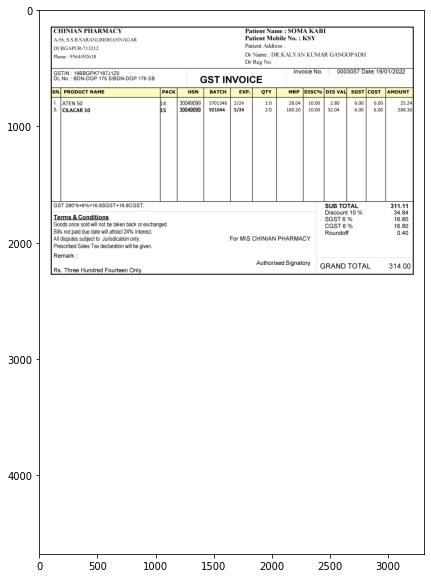


 {'Patient Name': 'SOMA KABI', 'Patient Mobile Number': [9564492618], 'Patient Address': '', 'Date': '19/01/2022', 'Invoice Number': '0003057'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DISC%,DIS VAL,SGST,CGST,AMOUNT
0,1.,ATEN 50,14,30049099,S701346,2/24,1:0,28.04,10.00,2.80,6.00,6.00,25.24
1,2.,CILACAR 10,15,30049099,921044,5/24,2:0,160.20,10.00,32.04,6.00,6.00,288.36



 {'SUB TOTAL': 311.11, 'Discount 10 %': 34.84, 'SGST 6 %': 16.8, 'CGST 6 %': 16.8, 'Roundoff': 0.4, 'GRAND TOTAL': 314.0} 


-----------------------------------------------------------------------------------------------------------------------

157-1-1651766525314.png


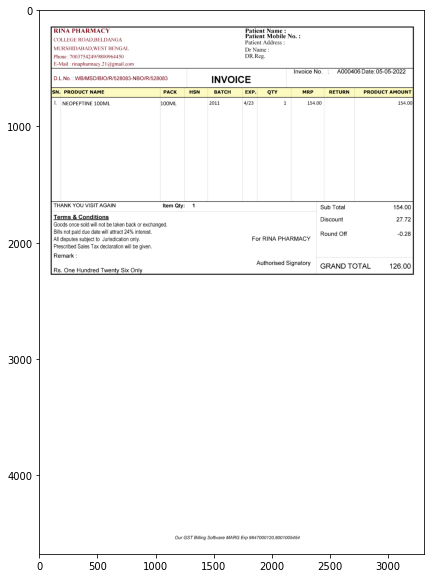


 {'Patient Name': '', 'Patient Mobile Number': [], 'Patient Address': '', 'Date': '05-05-2022', 'Invoice Number': 'A000406'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RETURN,PRODuct AMOUnt
0,1.,NEOPEPTINE 1OOML,100ML,BLANK,2011,4/23,1,154.00,BLANK,154.00



 {'Sub Total': 154.0, 'Discount': 27.72, 'Round Off': -0.28, 'GRAND TOTAL': 126.0} 


-----------------------------------------------------------------------------------------------------------------------

157-1-1648642261039.png


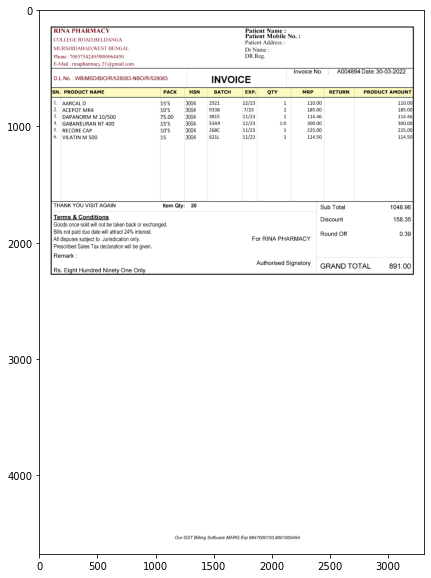


 {'Patient Name': '', 'Patient Mobile Number': [], 'Patient Address': '', 'Date': '30-03-2022', 'Invoice Number': 'A004894'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RETURN,PRODuct AMOUnt
0,1.,AARCAL D,15'S,3004,2921,12/23,1,110.00,BLANK,110.00
1,2.,ACEPOT MR4,10'S,3004,933B,7/23,1,185.00,BLANK,185.00
2,3.,DAPANORM M 10/500,75.00,3004,3815,11/23,1,114.46,BLANK,114.46
3,4.,GABANEURAN NT 4O0,15'S,3004,53AR,12/23,1:0,300.00,BLANK,300.00
4,5.,RECORE CAP,10'S,3004,268C,11/23,1,225.00,BLANK,225.00
5,6.,VILATIN M 5O0,15,3004,621L,11/23,1,114.50,BLANK,114.50



 {'Sub Total': 1048.96, 'Discount': 158.35, 'Round Off': 0.39, 'GRAND TOTAL': 891.0} 


-----------------------------------------------------------------------------------------------------------------------

157-1-1647517034170.png


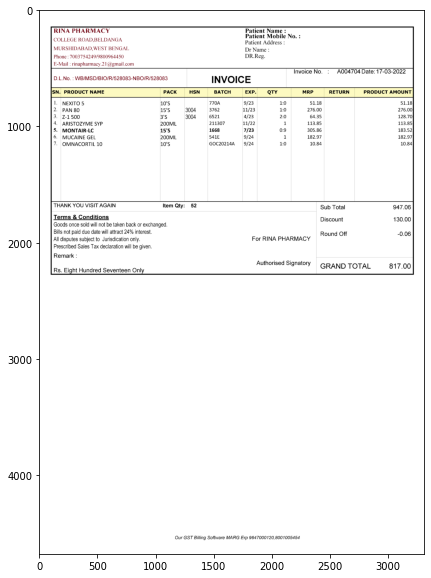


 {'Patient Name': '', 'Patient Mobile Number': [], 'Patient Address': '', 'Date': '17-03-2022', 'Invoice Number': 'A004704'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RETURN,PRODuct AMOUnt
0,1.,NEXITO 5,10'S,BLANK,770A,9/23,1:0,51.18,BLANK,51.18
1,2.,PAN 8O,15'S,3004,3762,11/23,1:0,276.00,BLANK,276.00
2,3.,Z-1 500,3'S,3004,6521,4/23,2:0,64.35,BLANK,128.70
3,4.,ARISTOZYME SYP,200ML,BLANK,211307,11/22,1,113.85,BLANK,113.85
4,5.,MONTAIR-LC,15'S,BLANK,1668,7/23,0:9,305.86,BLANK,183.52
5,6.,MUCAINE GEL,200ML,BLANK,541E,9/24,1,182.97,BLANK,182.97
6,7.,OMNACORTIL 10,10'S,BLANK,G0C20214A,9/24,1:0,10.84,BLANK,10.84



 {'Sub Total': 947.06, 'Discount': 130.0, 'Round Off': -0.06, 'GRAND TOTAL': 817.0} 


-----------------------------------------------------------------------------------------------------------------------

157-1-1647000236054.png


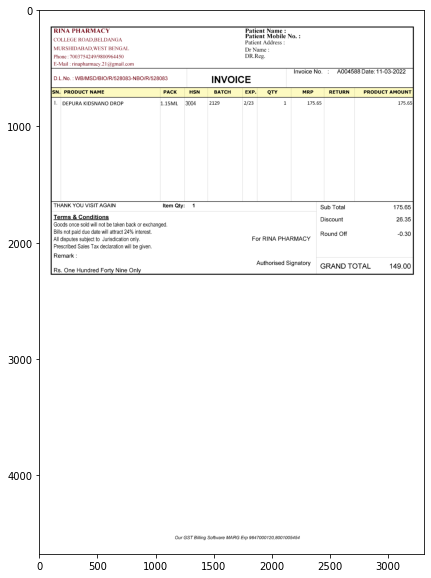


 {'Patient Name': '', 'Patient Mobile Number': [], 'Patient Address': '', 'Date': '11-03-2022', 'Invoice Number': 'A004588'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RETURN,PRODuct AMOUnt
0,1.,DEPURA KIDSNANO DROE,1.15ML,3004,2129,2/23,1,175.65,BLANK,175.65



 {'Sub Total': 175.65, 'Discount': 26.35, 'Round Off': -0.3, 'GRAND TOTAL': 149.0} 


-----------------------------------------------------------------------------------------------------------------------

159-2-1643633494850.png


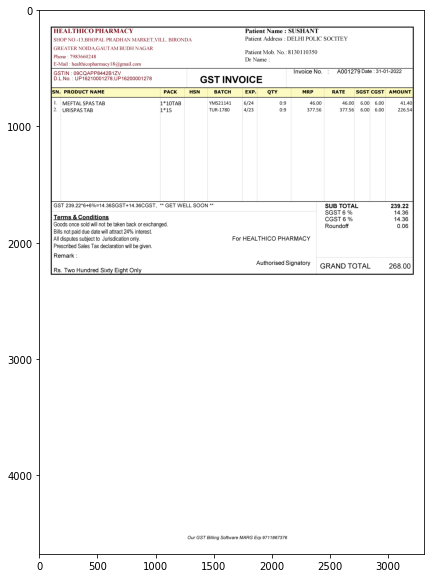


 {'Patient Name': 'SUSHANT', 'Patient Mobile Number': [8130110350, 7983660248], 'Patient Address': 'DELHI POLIC SOCITEY', 'Date': '31-01-2022', 'Invoice Number': 'A001279'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,MEFTALSPASTAB,1*10TAB,BLANK,YMS21141,6/24,0:9,46.00,46.00,6.00,6.00,41.40
1,2.,URISPASTAB,1*15,BLANK,TUR-1780,4/23,0:9,377.56,377.56,6.00,6.00,226.54



 {'SUB TOTAL': 239.22, 'SGST 6 %': 14.36, 'CGST 6 %': 14.36, 'Roundoff': 0.06, 'GRAND TOTAL': 268.0} 


-----------------------------------------------------------------------------------------------------------------------

159-1-1644563851533.png


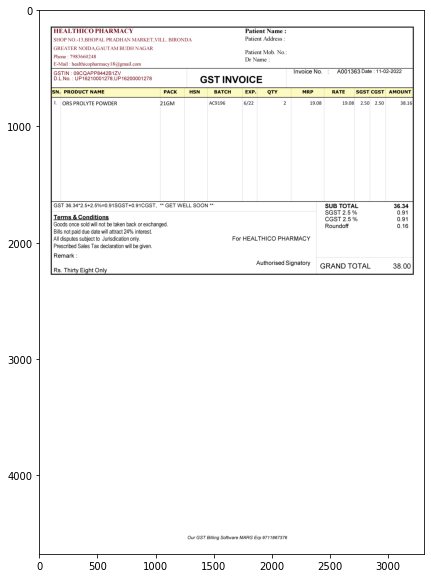


 {'Patient Name': '', 'Patient Mobile Number': [7983660248], 'Patient Address': '', 'Date': '11-02-2022', 'Invoice Number': 'A001363'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,ORS PROLYTE POWDER,21GM,BLANK,AC9196,6/22,2,19.08,19.08,2.50,2.50,38.16



 {'SUB TOTAL': 36.34, 'SGST 2.5 %': 0.91, 'CGST 2.5 %': 0.91, 'Roundoff': 0.16, 'GRAND TOTAL': 38.0} 


-----------------------------------------------------------------------------------------------------------------------

159-1-1641362591789.png


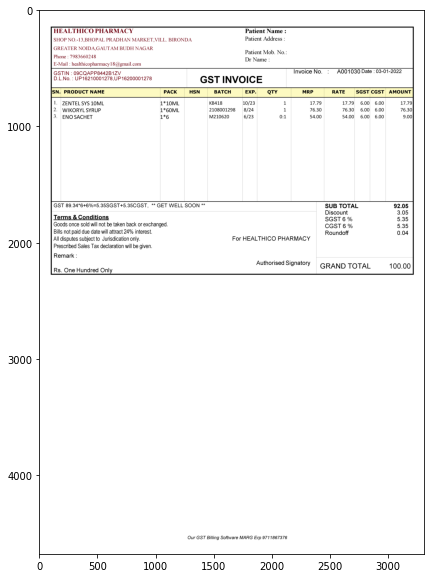


 {'Patient Name': '', 'Patient Mobile Number': [7983660248], 'Patient Address': '', 'Date': '03-01-2022', 'Invoice Number': 'A001030'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,ZENTEL SYS 1OML,1*10ML,BLANK,KB418,10/23,1,17.79,17.79,6.00,6.00,17.79
1,2.,WIKORYL SYRUP,1*60ML,BLANK,2108001298,8/24,1,76.30,76.30,6.00,6.00,76.30
2,3.,ENO SACHET,1*6,BLANK,M210620,6/23,0:1,54.00,54.00,6.00,6.00,9.00



 {'SUB TOTAL': 92.05, 'Discount': 3.05, 'SGST 6 %': 5.35, 'CGST 6 %': 5.35, 'Roundoff': 0.04, 'GRAND TOTAL': 100.0} 


-----------------------------------------------------------------------------------------------------------------------

160-4-1642914038387.png


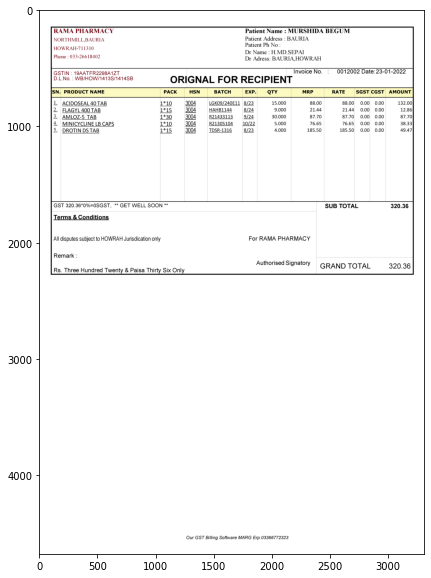


 {'Patient Name': 'MURSHIDA BEGUM', 'Patient Mobile Number': [], 'Patient Address': 'BAURIA', 'Date': '23-01-2022', 'Invoice Number': '0012002'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,ACIDOSEAL 40 TAB,1*10,3004,LGK09/240E11,8/23,15.000,88.00,88.00,0.00,0.00,132.00
1,2.,FLAGYL 400 TAB,1*15,3004,HAHB1144,8/24,9.000,21.44,21.44,0.00,0.00,12.86
2,3.,AMLOZ-5 TAB,1*30,3004,R21433113,9/24,30.000,87.70,87.70,0.00,0.00,87.70
3,4.,MINICYCLINE LB CAPS,1*10,3004,R21305104,10/22,5.000,76.65,76.65,0.00,0.00,38.33
4,5.,DROTIN DSTAB,1*15,3004,TDSR-1316,8/23,4.000,185.50,185.50,0.00,0.00,49.47



 {'SUB TOTAL': 320.36, 'GRAND TOTAL': 320.36} 


-----------------------------------------------------------------------------------------------------------------------

160-5-1646316893957.png


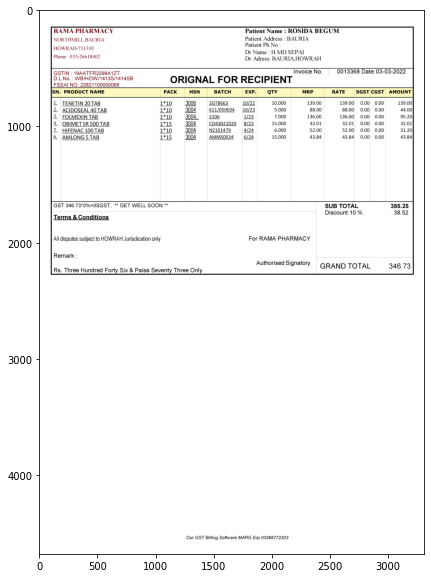


 {'Patient Name': 'ROSIDA BEGUM', 'Patient Mobile Number': [], 'Patient Address': 'BAURIA', 'Date': '03-03-2022', 'Invoice Number': '0013368'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,TENETIN 20 TAB,1*10,3006,2GTB663,10/22,10.000,139.00,139.00,0.00,0.00,139.00
1,2.,ACIDOSEAL 40 TAB,1*10,3004,K11/059E04,10/23,5.000,88.00,88.00,0.00,0.00,44.00
2,3.,FOLMEXIN TAB,1*10,3004..,2106,1/23,7.000,136.00,136.00,0.00,0.00,95.20
3,4.,OBIMET SR 500 TAB,1*15,3004,C043021020,8/23,15.000,32.01,32.01,0.00,0.00,32.01
4,5.,HIFENAC 100 TAB,1*10,3004,N2101479,4/24,6.000,52.00,52.00,0.00,0.00,31.20
5,6.,AMLONG 5 TAB,1*15,3004,AMMS0034,6/24,15.000,43.84,43.84,0.00,0.00,43.84



 {'SUB TOTAL': 385.25, 'Discount 10 %': 38.52, 'GRAND TOTAL': 346.73} 


-----------------------------------------------------------------------------------------------------------------------

160-1-1646313918251.png


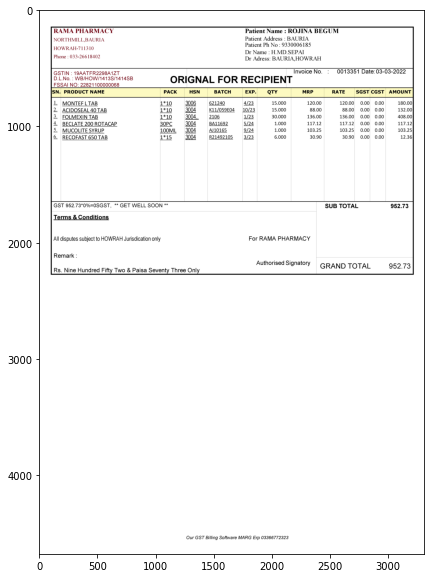


 {'Patient Name': 'ROJINA BEGUM', 'Patient Mobile Number': [9330006185], 'Patient Address': 'BAURIA', 'Date': '03-03-2022', 'Invoice Number': '0013351'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,MONTEELTAB,1*10,3006,621240,4/23,15.000,120.00,120.00,0.00,0.00,180.00
1,2.,ACIDOSEAL 40 TAB,1*10,3004,K11/059E04,10/23,15.000,88.00,88.00,0.00,0.00,132.00
2,3.,FOLMEXIN TAB,1*10,3004..,2106,1/23,30.000,136.00,136.00,0.00,0.00,408.00
3,4.,BECLATE 200 ROTACAP,30PC,3004,BA11692,5/24,1.000,117.12,117.12,0.00,0.00,117.12
4,5.,MUCOLITE SYRUP,100ML,3004,AJ10165,9/24,1.000,103.25,103.25,0.00,0.00,103.25
5,6.,RECOFAST 650 TAB,1*15,3004,R21492105,3/23,6.000,30.90,30.90,0.00,0.00,12.36



 {'SUB TOTAL': 952.73, 'GRAND TOTAL': 952.73} 


-----------------------------------------------------------------------------------------------------------------------

160-7-1646319832095.png


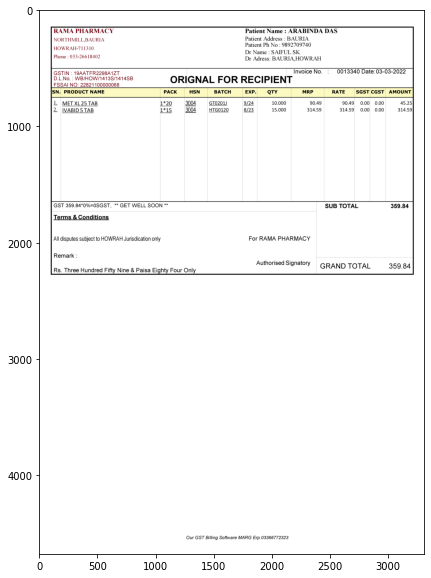


 {'Patient Name': 'ARABINDA DAS', 'Patient Mobile Number': [9892709740], 'Patient Address': 'BAURIA', 'Date': '03-03-2022', 'Invoice Number': '0013340'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,MET XL 25 TAB,1*20,3004,GT0201J,9/24,10.000,90.49,90.49,0.00,0.00,45.25
1,2.,IVABID 5 TAB,1*15,3004,HTG0120,8/23,15.000,314.59,314.59,0.00,0.00,314.59



 {'SUB TOTAL': 359.84, 'GRAND TOTAL': 359.84} 


-----------------------------------------------------------------------------------------------------------------------

160-1-1642909181471.png


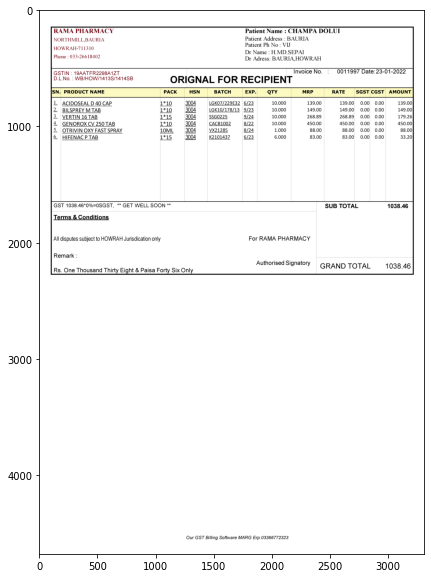


 {'Patient Name': 'CHAMPA DOLUI', 'Patient Mobile Number': [], 'Patient Address': 'BAURIA', 'Date': '23-01-2022', 'Invoice Number': '0011997'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,ACIDOSEAL D 40 CAP,1*10,3004,LGK07/229E32,6/23,10.000,139.00,139.00,0.00,0.00,139.00
1,2.,BILSPREY M TAB,1*10,3004,LGK10/178/13,9/23,10.000,149.00,149.00,0.00,0.00,149.00
2,3.,VERTIN 16 TAB,1*15,3004,SSG0225,9/24,10.000,268.89,268.89,0.00,0.00,179.26
3,4.,GENOROX CV 250 TAB,1*10,3004,CACB1002,8/22,10.000,450.00,450.00,0.00,0.00,450.00
4,5.,OTRIVIN OXY EAST SPRAY,10ML,3004,VX21285,8/24,1.000,88.00,88.00,0.00,0.00,88.00
5,6.,HIFENAC P TAB,1*15,3004,K2101437,6/23,6.000,83.00,83.00,0.00,0.00,33.20



 {'SUB TOTAL': 1038.46, 'GRAND TOTAL': 1038.46} 


-----------------------------------------------------------------------------------------------------------------------

161-11-1648035993377.png


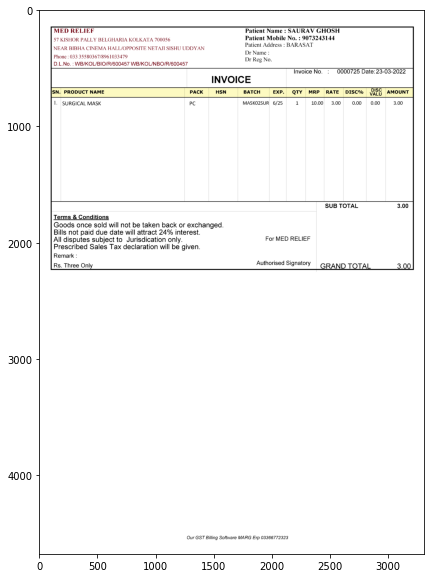


 {'Patient Name': 'SAURAV GHOSH', 'Patient Mobile Number': [9073243144], 'Patient Address': 'BARASAT', 'Date': '23-03-2022', 'Invoice Number': '0000725'} 



,SN.,PRODUCt NAMe,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,DISC%,DISC,AMOUnT
0,1.,SURGICAL MASK,PC,BLANK,MASK02SUR,6/25,1,10.00,3.00,0.00,0.00,3.00



 {'SUB TOTAL': 3.0, 'GRAND TOTAL': 3.0} 


-----------------------------------------------------------------------------------------------------------------------

161-1-1650693180899.png


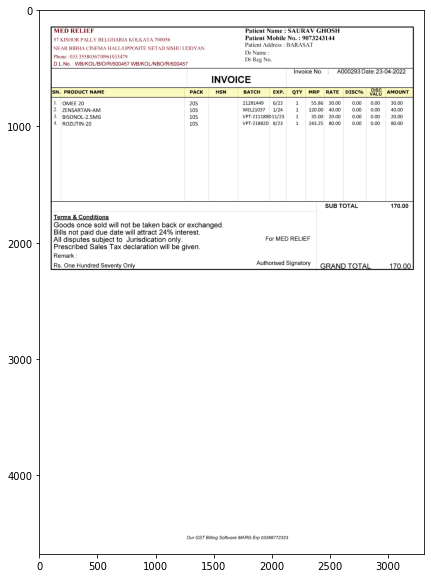


 {'Patient Name': 'SAURAV GHOSH', 'Patient Mobile Number': [9073243144], 'Patient Address': 'BARASAT', 'Date': '23-04-2022', 'Invoice Number': 'A000293'} 



,SN.,PRODUCt NAMe,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,DISC%,DISC,AMOUnT
0,1.,OMEE 20,20S,BLANK,21281449,6/23,1,55.86,30.00,0.00,0.00,30.00
1,2.,ZENSARTAN-AM,10S,BLANK,WEL21037,1/24,1,120.00,40.00,0.00,0.00,40.00
2,3.,BISONOL-2.5MG,10S,BLANK,VPT-211189,D11/23,1,35.00,20.00,0.00,0.00,20.00
3,4.,ROZUTIN-20,10S,BLANK,VPT-21882D,8/23,1,243.25,80.00,0.00,0.00,80.00



 {'SUB TOTAL': 170.0, 'GRAND TOTAL': 170.0} 


-----------------------------------------------------------------------------------------------------------------------

161-9-1646832012748.png


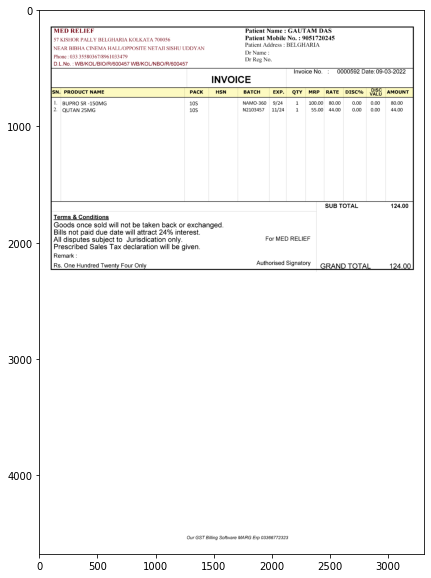


 {'Patient Name': 'GAUTAM DAS', 'Patient Mobile Number': [9051720245], 'Patient Address': 'BELGHARIA', 'Date': '09-03-2022', 'Invoice Number': '0000592'} 



,SN.,PRODUCt NAMe,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,DISC%,DISC,AMOUnT
0,1.,BUPRO SR -150MG,10S,BLANK,NAMO-360,9/24,1,100.00,80.00,0.00,0.00,80.00
1,2.,QUTAN 25MG,10S,BLANK,N2103457,11/24,1,55.00,44.00,0.00,0.00,44.00



 {'SUB TOTAL': 124.0, 'GRAND TOTAL': 124.0} 


-----------------------------------------------------------------------------------------------------------------------

161-5-1648122076158.png


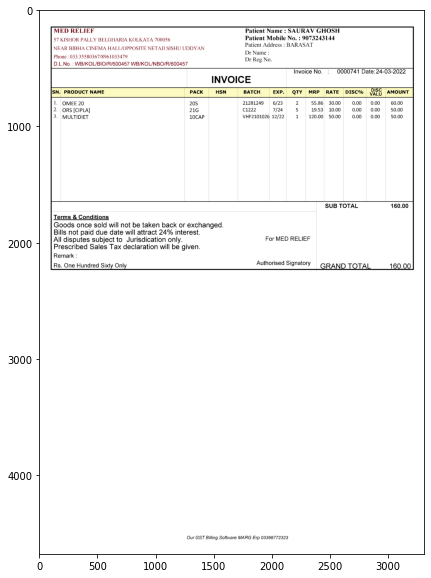


 {'Patient Name': 'SAURAV GHOSH', 'Patient Mobile Number': [9073243144], 'Patient Address': 'BARASAT', 'Date': '24-03-2022', 'Invoice Number': '0000741'} 



,SN.,PRODUCt NAMe,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,DISC%,DISC,AMOUnT
0,1.,OMEE 20,20S,BLANK,21281249,6/23,2,55.86,30.00,0.00,0.00,60.00
1,2.,ORS [CIPLA],21G,BLANK,C1222,7/24,5,19.53,10.00,0.00,0.00,50.00
2,3.,MULTIDIET,10CAP,BLANK,VHF2101026,12/22,1,120.00,50.00,0.00,0.00,50.00



 {'SUB TOTAL': 160.0, 'GRAND TOTAL': 160.0} 


-----------------------------------------------------------------------------------------------------------------------

161-5-1646723299801.png


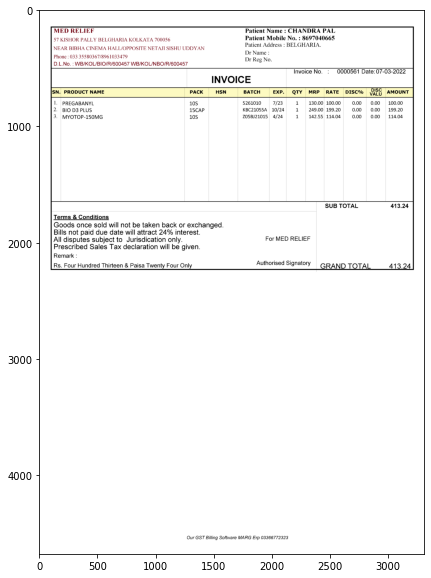


 {'Patient Name': 'CHANDRA PAL', 'Patient Mobile Number': [8697040665], 'Patient Address': 'BELGHARIA', 'Date': '07-03-2022', 'Invoice Number': '0000561'} 



,SN.,PRODUCt NAMe,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,DISC%,DISC,AMOUnT
0,1.,PREGABANYL,10S,BLANK,5261010,7/23,1,130.00,100.00,0.00,0.00,100.00
1,2.,BIO D3 PLUS,15CAP,BLANK,KBC21055A,10/24,1,249.00,199.20,0.00,0.00,199.20
2,3.,MYOTOP-150MG,10S,BLANK,Z05BJ21015,4/24,1,142.55,114.04,0.00,0.00,114.04



 {'SUB TOTAL': 413.24, 'GRAND TOTAL': 413.24} 


-----------------------------------------------------------------------------------------------------------------------

163-1-1644650474334.png


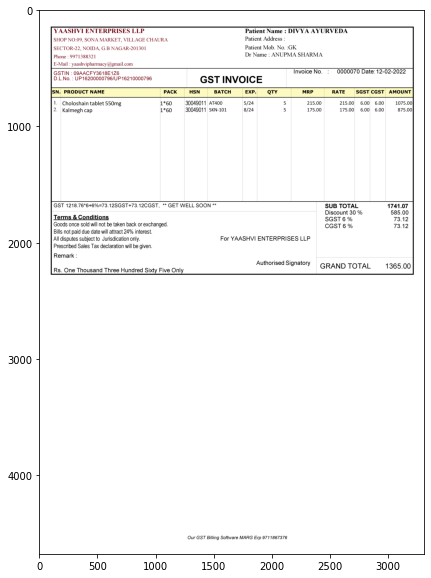


 {'Patient Name': 'DIVYA AYURVEDA', 'Patient Mobile Number': [9971388321], 'Patient Address': '', 'Date': '12-02-2022', 'Invoice Number': '0000070'} 



,SN.,PRODUCt NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,Choloshain tablet 550mg,1*60,30049011,AT400,5/24,5,215.00,215.00,6.00,6.00,1075.00
1,2.,Kalmegh cap,1*60,30049011,SKN-101,8/24,5,175.00,175.00,6.00,6.00,875.00



 {'SUB TOTAL': 1741.07, 'Discount 30 %': 585.0, 'SGST 6 %': 73.12, 'CGST 6 %': 73.12, 'GRAND TOTAL': 1365.0} 


-----------------------------------------------------------------------------------------------------------------------

163-1-1642838082487.png


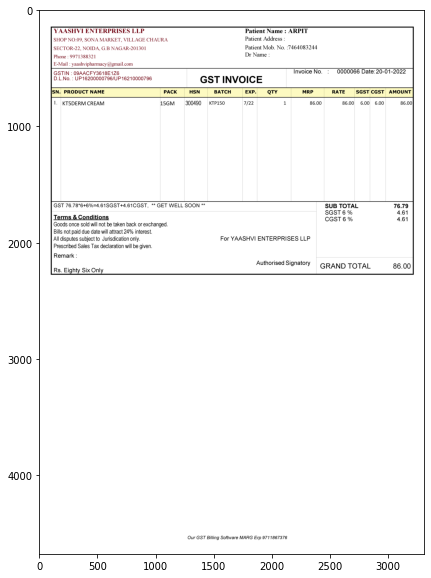


 {'Patient Name': 'ARPIT', 'Patient Mobile Number': [9971388321], 'Patient Address': '', 'Date': '20-01-2022', 'Invoice Number': '0000066'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,KT5DERM CREAM,15GM,300490,KTP150,7/22,1,86.00,86.00,6.00,6.00,86.00



 {'SUB TOTAL': 76.79, 'SGST 6 %': 4.61, 'CGST 6 %': 4.61, 'GRAND TOTAL': 86.0} 


-----------------------------------------------------------------------------------------------------------------------

163-1-1642683926071.png


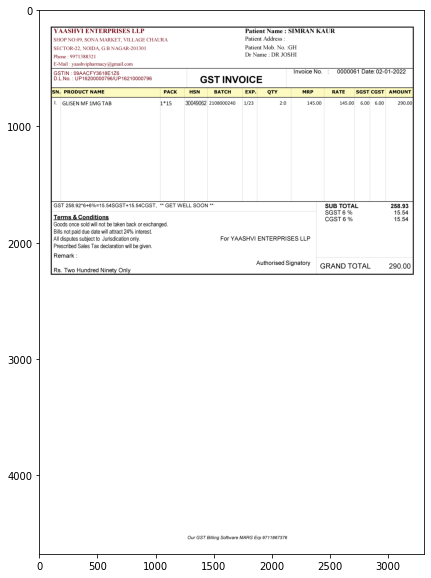


 {'Patient Name': 'SIMRAN KAUR', 'Patient Mobile Number': [9971388321], 'Patient Address': '', 'Date': '02-01-2022', 'Invoice Number': '0000061'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,GLISEN MF 1MG TAB,1*15,30049062,2108000240,1/23,2:0,145.00,145.00,6.00,6.00,290.00



 {'SUB TOTAL': 258.93, 'SGST 6 %': 15.54, 'CGST 6 %': 15.54, 'GRAND TOTAL': 290.0} 


-----------------------------------------------------------------------------------------------------------------------

163-1-1647671839078.png


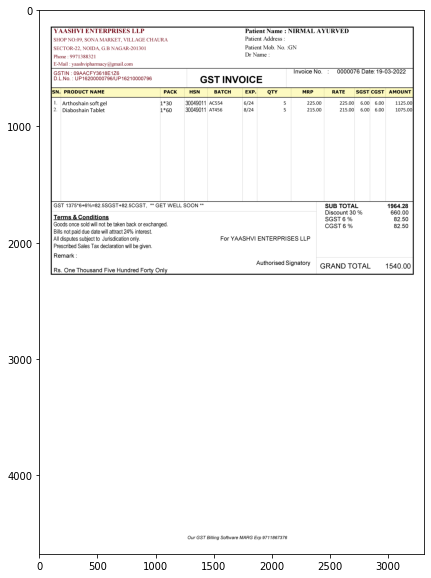


 {'Patient Name': 'NIRMAL AYURVED', 'Patient Mobile Number': [9971388321], 'Patient Address': '', 'Date': '19-03-2022', 'Invoice Number': '0000076'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,Arthoshain soft gel,1*30,30049011,AC554,6/24,5,225.00,225.00,6.00,6.00,1125.00
1,2.,Diaboshain Tablet,1*60,30049011,AT456,8/24,5,215.00,215.00,6.00,6.00,1075.00



 {'SUB TOTAL': 1964.28, 'Discount 30 %': 660.0, 'SGST 6 %': 82.5, 'CGST 6 %': 82.5, 'GRAND TOTAL': 1540.0} 


-----------------------------------------------------------------------------------------------------------------------

164-2-1647701129960.png


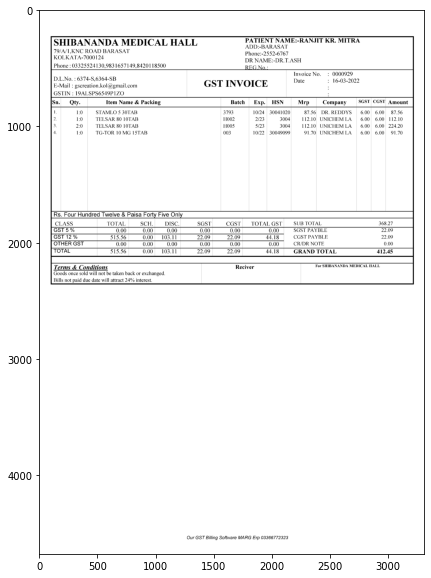


 {'Patient Name': 'RANJIT KR. MITRA', 'Patient Mobile Number': [3325524130, 9831657149, 8420118500], 'Patient Address': 'BARASAT', 'Date': '16-03-2022', 'Invoice Number': '0000929'} 



,Sn.,Qty.,Item Name & Packing,Batch,Exp.,HSN,Mrp,Company,SGST,CGST,Amount
0,1.,1:0,STAMLO 5 30TAB,3793,10/24,30041020,87.56,DR.REDDYS,6.00,6.00,87.56
1,2.,1:0,TELSAR 80 10TAB,H002,2/23,3004,112.10,UNCHEM LA,6.00,6.00,112.10
2,3.,2:0,TELSAR 80 10TAB,H005,5/23,3004,112.10,UNCHEM LA,6.00,6.00,224.20
3,4.,1:0,TG-TOR 10 MG 15TAB,003,10/22,30049099,91.70,UNICHEM LA,6.00,6.00,91.70



 {'SUB TOTAL': 368.27, 'SGST PAYBLE': 22.09, 'CGST PAYBLE': 22.09, 'CR/DR NOTE': 0.0, 'GRAND TOTAL': 412.45} 


-----------------------------------------------------------------------------------------------------------------------

164-5-1650694925000.png


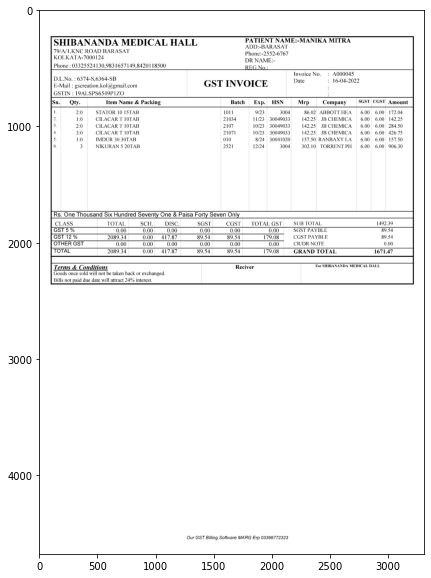


 {'Patient Name': '', 'Patient Mobile Number': [3325524130, 9831657149, 8420118500], 'Patient Address': 'BARASAT', 'Date': '16-04-2022', 'Invoice Number': 'A000045'} 



,Sn.,Qty.,Item Name & Packing,Batch,Exp.,HSN,Mrp,Company,SGST,CGST,Amount
0,1.,2:0,STATOR 10 15TAB,1011,9/23,3004,86.02,ABBOTT HEA,6.00,6.00,172.04
1,2.,1:0,CILACAR T 10TAB,21034,11/23,30049033,142.25,JB CHEMICA,6.00,6.00,142.25
2,3.,2:0,CILAGAR T iOTAB,2107,10/23,30049033,142.25,JB CHEMICA,6.00,6.00,284.50
3,4.,3:0,CILACAR T 1OTAB,21071,10/23,30049033,142.25,JB CHEMICA,6.00,6.00,426.75
4,5.,1:0,IMDUR 30 30TAB,010,8/24,30041020,157.50,RANBAXY LA,6.00,6.00,157.50
5,6.,3,NIKURAN 5 20TAB,2521,12/24,3004,302.10,TORRENT PH,6.00,6.00,906.30



 {'SUB TOTAL': 1492.39, 'SGST PAYBLE': 89.54, 'CGST PAYBLE': 89.54, 'CR/DR NOTE': 0.0, 'GRAND TOTAL': 1671.47} 


-----------------------------------------------------------------------------------------------------------------------

164-1-1647836812581.png


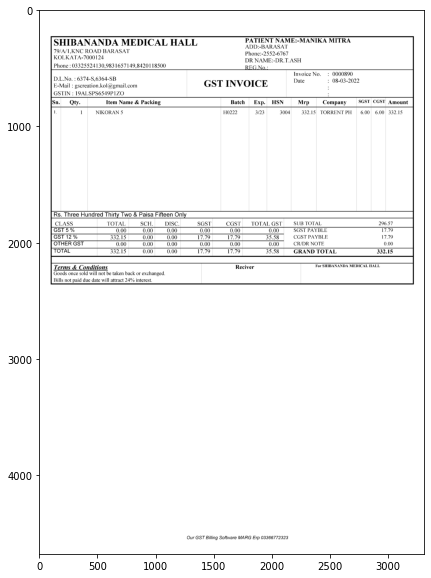


 {'Patient Name': '', 'Patient Mobile Number': [3325524130, 9831657149, 8420118500], 'Patient Address': 'BARASAT', 'Date': '08-03-2022', 'Invoice Number': '0000890'} 



,Sn.,Qty.,Item Name & Packing,Batch,Exp.,HSN,Mrp,Company,SGST,CGST,Amount
0,1.,1,NIKORAN 5,H0222,3/23,3004,332.15,TORRENT PH,6.00,6.00,332.15



 {'SUB TOTAL': 296.57, 'SGST PA YBLE': 17.79, 'CGST PAYBLE': 17.79, 'CR/DR NOTE': 0.0, 'GRAND TOTAL': 332.15} 


-----------------------------------------------------------------------------------------------------------------------

164-3-1643353380938.png


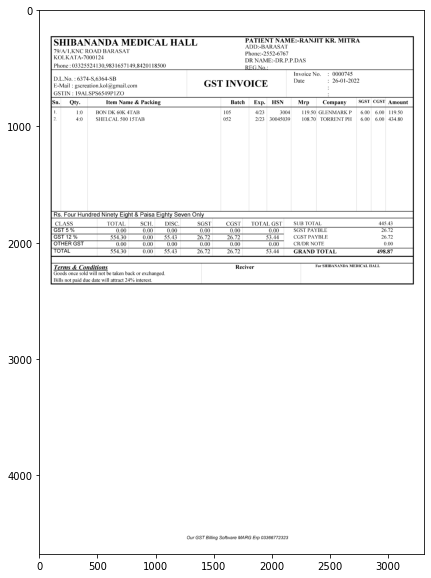


 {'Patient Name': 'RANJIT KR. MITRA', 'Patient Mobile Number': [3325524130, 9831657149, 8420118500], 'Patient Address': 'BARASAT', 'Date': '26-01-2022', 'Invoice Number': '.0000745'} 



,Sn.,Qty.,Item Name & Packing,Batch,Exp.,HSN,Mrp,Company,SGST,CGST,Amount
0,1.,1:0,BON DK 60K 4TAB,105,4/23,3004,119.50,GLENMARK P,6.00,6.00,119.50
1,2.,4:0,SHEICAL SO0 L5TAB,052,2/23,30045039,108.70,TORRENTPH,6.00,6.00,434.80



 {'SUB TOTAL': 445.43, 'SGST PA YBLE': 26.72, 'CGST PAYBLE': 26.72, 'CR/DR NOTE': 0.0, 'GRAND TOTAL': 498.87} 


-----------------------------------------------------------------------------------------------------------------------

164-4-1647065905359.png


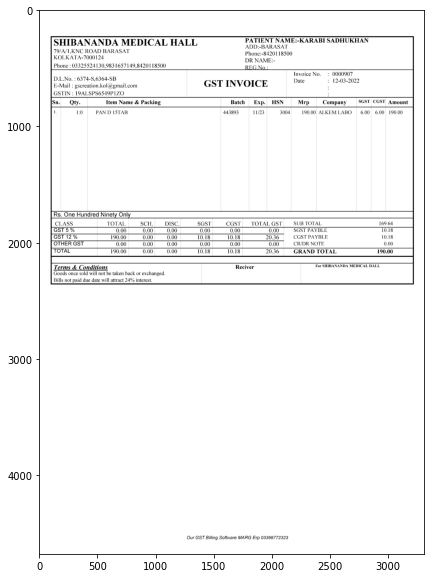


 {'Patient Name': 'KARABI SADHUKHAN', 'Patient Mobile Number': [3325524130, 9831657149, 8420118500], 'Patient Address': 'BARASAT', 'Date': '12-03-2022', 'Invoice Number': '0000907'} 



,Sn.,Qty.,Item Name & Packing,Batch,Exp.,HSN,Mrp,Company,SGST,CGST,Amount
0,1.,1:0,PAND 15TAB,443893,11/23,3004,190.00,ALKEMLABO,6.00,6.00,190.00



 {'SUB TOTAL': 169.64, 'SGST PAYBLE': 10.18, 'CGST PAYBLE': 10.18, 'CR/DR NOTE': 0.0, 'GRAND TOTAL': 190.0} 


-----------------------------------------------------------------------------------------------------------------------

166-3-1648535748355.png


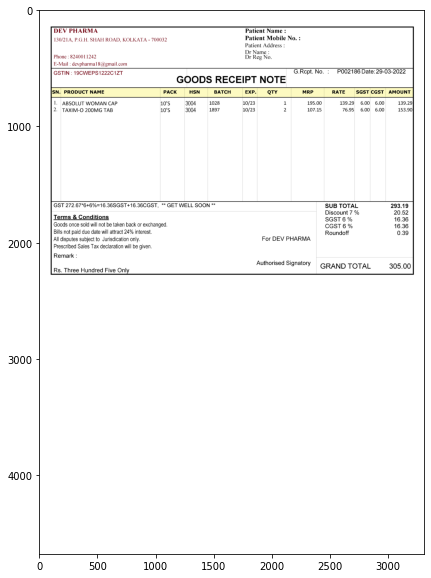


 {'Patient Name': '', 'Patient Mobile Number': [8240011242], 'Patient Address': '', 'Date': '29-03-2022', 'Invoice Number': 'P002186'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,ABSOLUT WMOMAN CAE,10'S,3004,1028,10/23,1,195.00,139.29,6.00,6.00,139.29
1,2.,TAXIM-O 200MG TAB,10'S,3004,1897,10/23,2,107.15,76.95,6.00,6.00,153.90



 {'SuB tOtAL': 293.19, 'Discount 7 %': 20.52, 'SGST 6 %': 16.36, 'CGST 6 %': 16.36, 'Roundoff': 0.39, 'GRAND TOTAL': 305.0} 


-----------------------------------------------------------------------------------------------------------------------

166-10-1646321160387.png


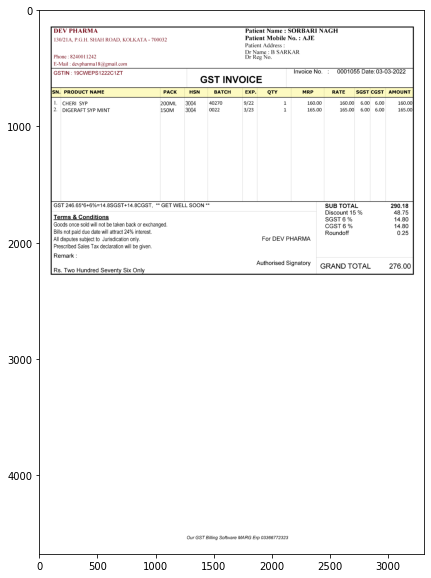


 {'Patient Name': 'SORBARI NAGH', 'Patient Mobile Number': [8240011242], 'Patient Address': '', 'Date': '03-03-2022', 'Invoice Number': '0001055'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,CHERI SYP,200ML,3004,40270,9/22,1,160.00,160.00,6.00,6.00,160.00
1,2.,DIGERAET SYP MINT,150M,3004,0022,3/23,1,165.00,165.00,6.00,6.00,165.00



 {'SuB tOtAL': 290.18, 'Discount 15 %': 48.75, 'SGST 6 %': 14.8, 'CGST 6 %': 14.8, 'Roundoff': 0.25, 'GRAND TOTAL': 276.0} 


-----------------------------------------------------------------------------------------------------------------------

166-6-1647241302131.png


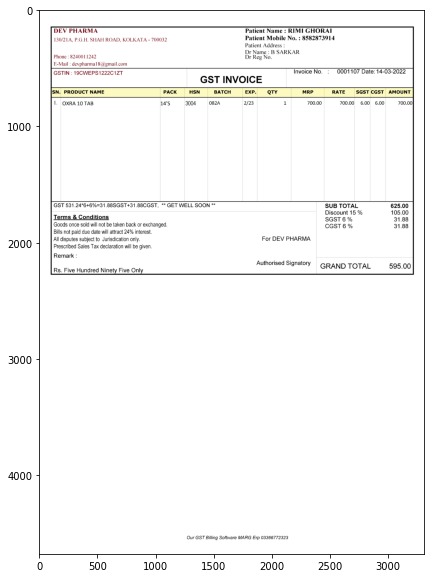


 {'Patient Name': 'RIM GHORAI', 'Patient Mobile Number': [8582873914, 8240011242], 'Patient Address': '', 'Date': '14-03-2022', 'Invoice Number': '0001107'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,OXRA 10 TAB,14'S,3004,082A,2/23,1,700.00,700.00,6.00,6.00,700.00



 {'SUB tOTAL': 625.0, 'Discount 15 %': 105.0, 'SGST 6 %': 31.88, 'CGST 6 %': 31.88, 'GRAND TOTAL': 595.0} 


-----------------------------------------------------------------------------------------------------------------------

166-1-1647960225555.png


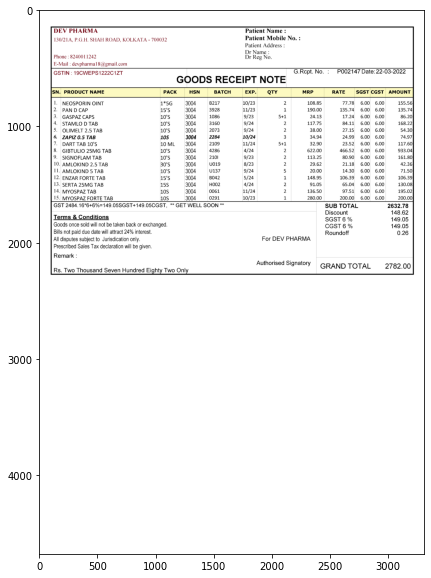


 {'Patient Name': '', 'Patient Mobile Number': [8240011242], 'Patient Address': '', 'Date': '22-03-2022', 'Invoice Number': 'P002147'} 



,SN.,PRODUCt NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnt
0,1.,NEOSPORIN OINT,1*5G,3004,B217,10/23,2,108.85,77.78,6.00,6.00,155.56
1,2.,PAN D CAP,15'S,3004,3928,11/23,1,190.00,135.74,6.00,6.00,135.74
2,3.,GASPAZ CAPS,10'S,3004,1086,9/23,5+1,24.13,17.24,6.00,6.00,86.20
3,4.,STAMLO D TAB,10'S,3004,3160,9/24,2,117.75,84.11,6.00,6.00,168.22
4,5.,OLIMELT 2.5 TAB,10'S,3004,2073,9/24,2,38.00,27.15,6.00,6.00,54.30
5,6.,ZAPIZ 0.5 TAB,10S,3004,2284,10/24,3,34.94,24.99,6.00,6.00,74.97
6,7.,DART TAB 1O'S,10 ML,3004,2109,11/24,5+1,32.90,23.52,6.00,6.00,117.60
7,8.,GIBTULIO 25MG TAB,10'S,3004,4286,4/24,2,622.00,466.52,6.00,6.00,933.04
8,9.,SIGNOELAM TAB,10'S,3004,2101,9/23,2,113.25,80.90,6.00,6.00,161.80
9,10.,AMLOKIND 2.5 TAB,30'S,3004,U019,8/23,2,29.62,21.18,6.00,6.00,42.36



 {'SUB TOTAL': 2632.78, 'Discount': 148.62, 'SGST 6 %': 149.05, 'CGST 6 %': 149.05, 'Roundoff': 0.26, 'GRAND TOTAL': 2782.0} 


-----------------------------------------------------------------------------------------------------------------------

167-2-1645771726625.png


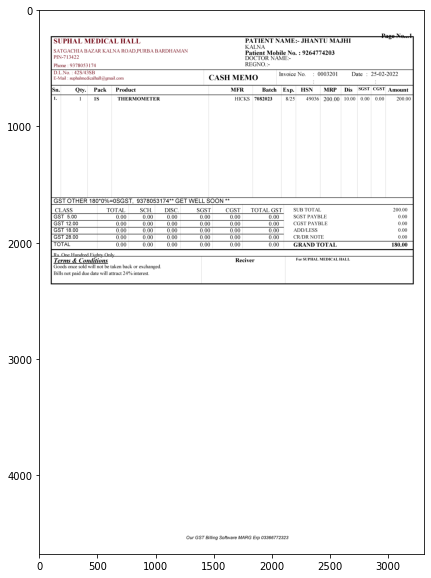


 {'Patient Name': 'JHANTU MAJHI', 'Patient Mobile Number': [9264774203, 9378053174], 'Patient Address': '', 'Date': '25-02-2022', 'Invoice Number': '0003201'} 



,Sn.,Qty.,Pack,Product,MFR,Batch,Exp.,HSN,MRP,Dis,SGST,CGST,Amount
0,1.,1,1S,THERMOMETER,HICKS,7082023,8/25,49036,200.00,10.00,0.00,0.00,200.00



 {'SUB TOTAL': 200.0, 'SGST PAYBLE': 0.0, 'CGST PAYBLE': 0.0, 'ADD/LESS': 0.0, 'CR/DR NOTE': 0.0, 'GRAND TOTAL': 180.0} 


-----------------------------------------------------------------------------------------------------------------------

167-1-1645771647736.png


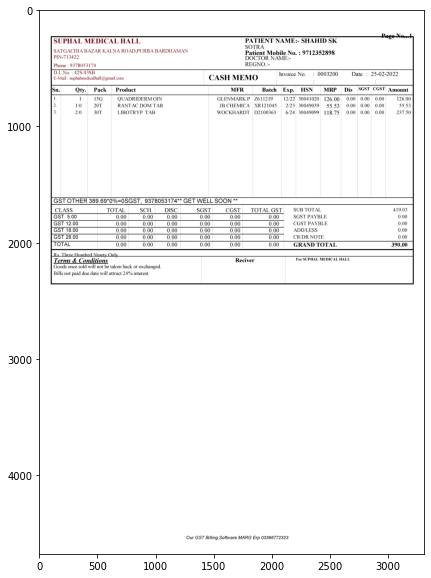


 {'Patient Name': 'SHAHID SK', 'Patient Mobile Number': [9712352898, 9378053174], 'Patient Address': '', 'Date': '25-02-2022', 'Invoice Number': '0003200'} 



,Sn.,Qty.,Pack,Product,MFR,Batch,Exp.,HSN,MRP,Dis,SGST,CGST,Amount
0,1.,1,15G,QUADRIDERM OIN,GLENMARK P,Z611219,12/22,30041020,126.00,0.00,0.00,0.00,126.00
1,2.,1:0,20T,RANTAC DOM TAB,JB CHEMICA,XR121045,2/23,30049039,55.53,0.00,0.00,0.00,55.53
2,3.,2:0,30T,LIBOTRYP TAB,WOCKHARDT,D2100363,6/24,30049099,118.75,0.00,0.00,0.00,237.50



 {'SUB TOTAL': 419.03, 'SGST PAYBLE': 0.0, 'CGST PAYBLE': 0.0, 'ADD/LESS': 0.0, 'CR/DR NOTE': 0.0, 'GRAND TOTAL': 390.0} 


-----------------------------------------------------------------------------------------------------------------------

167-4-1645772435459.png


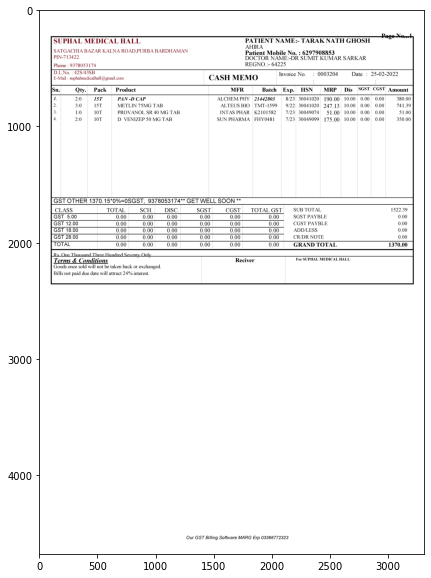


 {'Patient Name': 'TARAKNATH GHOSH', 'Patient Mobile Number': [6297908853, 9378053174], 'Patient Address': '', 'Date': '25-02-2022', 'Invoice Number': '0003204'} 



,Sn.,Qty.,Pack,Product,MFR,Batch,Exp.,HSN,MRP,Dis,SGST,CGST,Amount
0,1.,2:0,15T,PAN -D CAP,ALCHEM PHY,21442803,8/23,30041020,190.00,10.00,0.00,0.00,380.00
1,2.,3:0,15T,METLIN 75MG TAB,ALTEUS BIO,TMT-1599,9/22,30041020,247.13,10.00,0.00,0.00,741.39
2,3.,1:0,10T,PROVANOL SR 4O MG TAB,INTAS PHAR,K2101582,7/23,30049074,51.00,10.00,0.00,0.00,51.00
3,4.,2:0,10T,D VENIZEP 50 MG TAB,SUN PHARMA,FHY0481,7/23,30049099,175.00,10.00,0.00,0.00,350.00



 {'SUB TOTAL': 1522.39, 'SGST PAYBLE': 0.0, 'CGST PAYBLE': 0.0, 'ADD/LESS': 0.0, 'CR/DR NOTE': 0.0, 'GRAND TOTAL': 1370.0} 


-----------------------------------------------------------------------------------------------------------------------

167-5-1645969671678.png


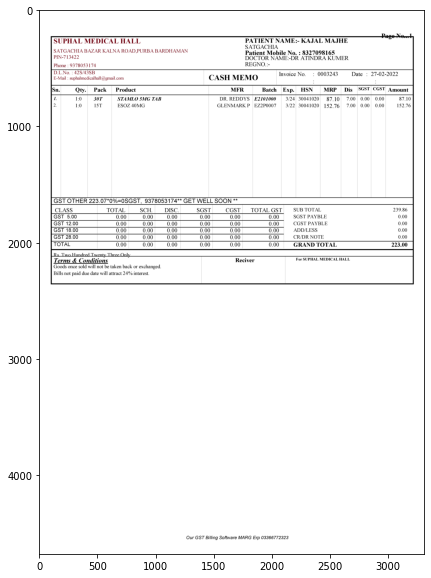


 {'Patient Name': 'KAJAL MAJHF', 'Patient Mobile Number': [8327098165, 9378053174], 'Patient Address': '', 'Date': '27-02-2022', 'Invoice Number': '0003243'} 



,Sn.,Qty.,Pack,Product,MFR,Batch,Exp.,HSN,MRP,Dis,SGST,CGST,Amount
0,1.,1:0,30T,STAMLO 5MG TAB,DR.REDDYS,E2101000,3/24,30041020,87.10,7.00,0.00,0.00,87.10
1,2.,1:0,15T,ESOZ 40MG,GLENMARK P,EZ2P0007,3/22,30041020,152.76,7.00,0.00,0.00,152.76



 {'SUB TOTAL': 239.86, 'SGST PAYBLE': 0.0, 'CGST PAYBLE': 0.0, 'ADD/LESS': 0.0, 'CR/DR NOTE': 0.0, 'GRAND TOTAL': 223.0} 


-----------------------------------------------------------------------------------------------------------------------

167-2-1644315576124.png


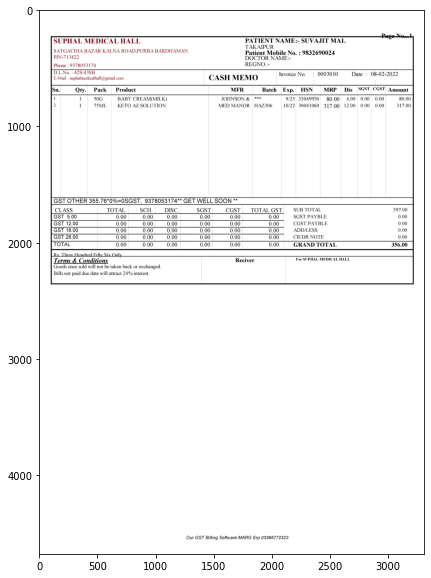


 {'Patient Name': 'SUVAJIT MAL', 'Patient Mobile Number': [9832690024, 9378053174], 'Patient Address': '', 'Date': '08-02-2022', 'Invoice Number': '0003010'} 



,Sn.,Qty.,Pack,Product,MFR,Batch,Exp.,HSN,MRP,Dis,SGST,CGST,Amount
0,1.,1,50G,BABY CREAM(MILK),JOHNSON &,***,9/23,33049930,80.00,4.00,0.00,0.00,80.00
1,2.,1,75ML,KETO AZ SOLUTION,MED MANOR,HAZ306,10/22,30041060,317.00,12.00,0.00,0.00,317.00



 {'SUB TOTAL': 397.0, 'SGST PAYBLE': 0.0, 'CGST PAYBLE': 0.0, 'ADD/LESS': 0.0, 'CR/DR NOTE': 0.0, 'GRAND TOTAL': 356.0} 


-----------------------------------------------------------------------------------------------------------------------

172-7-1648285758723.png


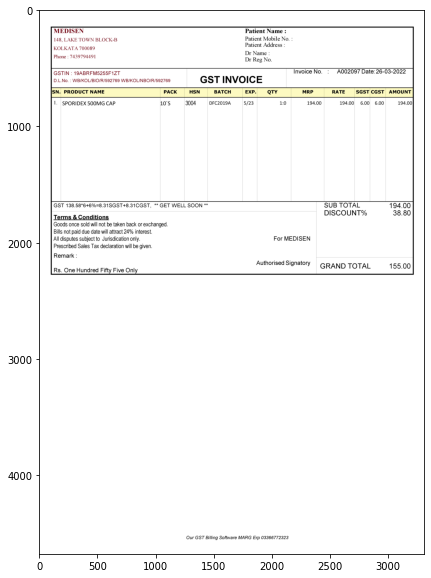


 {'Patient Name': '', 'Patient Mobile Number': [7439794491], 'Patient Address': '', 'Date': '26-03-2022', 'Invoice Number': 'A002097'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,SPORIDEX 500MG CAP,10`S,3004,DFC2019A,5/23,1:0,194.00,194.00,6.00,6.00,194.00



 {'SuB TotAL': 194.0, 'DISCOUNT%': 38.8, 'GRAND TOTAL': 155.0} 


-----------------------------------------------------------------------------------------------------------------------

172-15-1644411762508.png


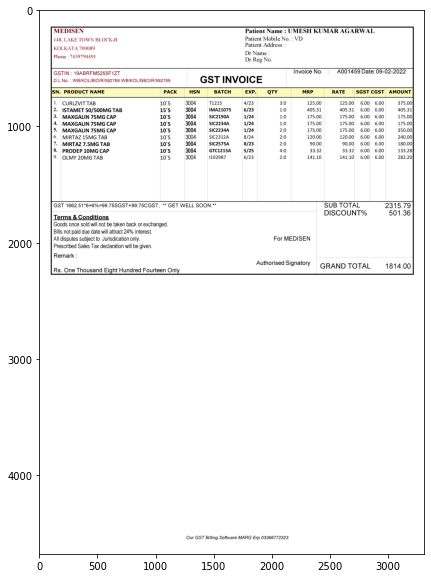


 {'Patient Name': 'UMESH KUMAR AGARWAL', 'Patient Mobile Number': [7439794491], 'Patient Address': '', 'Date': '09-02-2022', 'Invoice Number': 'A001459'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,CURLZVIT TAB,10`S,3004,T1215,4/23,3:0,125.00,125.00,6.00,6.00,375.00
1,2.,ISTAMET 50/500MG TAB,15`S,3004,IMA21075,6/23,1:0,405.31,405.31,6.00,6.00,405.31
2,3.,MAXGALIN 75MG CAP,10`S,3004,SIC2190A,1/24,1:0,175.00,175.00,6.00,6.00,175.00
3,4.,MAXGALIN 75MG CAP,10`S,3004,SIC2234A,1/24,1:0,175.00,175.00,6.00,6.00,175.00
4,5.,MAXGALIN 75MG CAP,10`S,3004,SIC2234A,1/24,2:0,175.00,175.00,6.00,6.00,350.00
5,6.,MIRTAZ 15MG TAB,10`S,3004,SIC2312A,8/24,2:0,120.00,120.00,6.00,6.00,240.00
6,7.,MIRTAZ 7.5MG TAB,10`S,3004,SIC2575A,8/23,2:0,90.00,90.00,6.00,6.00,180.00
7,8.,PRODEP 10MG CAP,10`S,3004,GTC1215A,5/25,4:0,33.32,33.32,6.00,6.00,133.28
8,9.,OLMY 20MG TAB,10`S,3004,1102987,6/23,2:0,141.10,141.10,6.00,6.00,282.20



 {'SuB TotAL': 2315.79, 'DISCOUNT%': 501.36, 'GRAND TOTAL': 1814.0} 


-----------------------------------------------------------------------------------------------------------------------

172-9-1645707774599.png


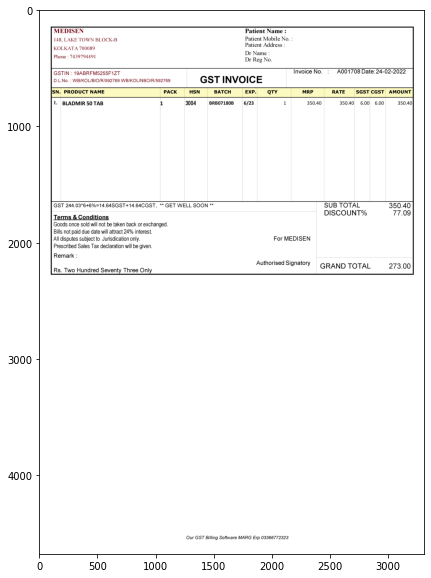


 {'Patient Name': '', 'Patient Mobile Number': [7439794491], 'Patient Address': '', 'Date': '24-02-2022', 'Invoice Number': 'A001708'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,BLADMIR 50 TAB,1,3004,BRB07180B,6/23,1,350.40,350.40,6.00,6.00,350.40



 {'SuB TotAL': 350.4, 'DISCOUNT%': 77.09, 'GRAND TOTAL': 273.0} 


-----------------------------------------------------------------------------------------------------------------------

172-4-1650608711612.png


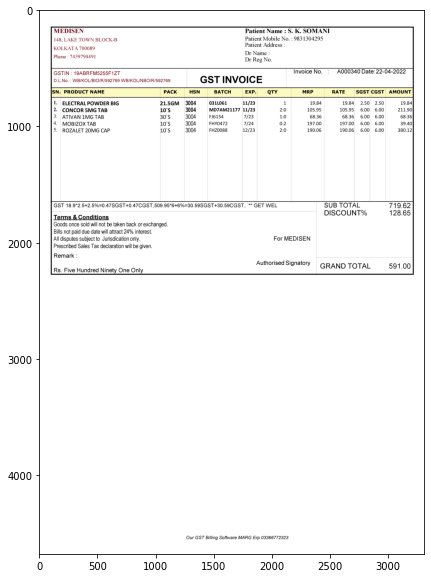


 {'Patient Name': 'S. K, SOMANI', 'Patient Mobile Number': [9831304295, 7439794491], 'Patient Address': '', 'Date': '22-04-2022', 'Invoice Number': 'A000340'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,ELECTRALPOWDER BIG,21.5GM,3004,031L061,11/23,1,19.84,19.84,2.50,2.50,19.84
1,2.,CONCOR 5MG TAB,10`S,3004,MD7AM21177,11/23,2:0,105.95,105.95,6.00,6.00,211.90
2,3.,ATIVAN 1MG TAB,30`S,3004,FJ6154,7/23,1:0,68.36,68.36,6.00,6.00,68.36
3,4.,MOBIZOX TAB,10`S,3004,FHY0472,7/24,0:2,197.00,197.00,6.00,6.00,39.40
4,5.,ROZALET 20MG CAP,10`S,3004,FHZ0088,12/23,2:0,190.06,190.06,6.00,6.00,380.12



 {'SuB TotAL': 719.62, 'DISCOUNT%': 128.65, 'GRAND TOTAL': 591.0} 


-----------------------------------------------------------------------------------------------------------------------

172-15-1645630130159.png


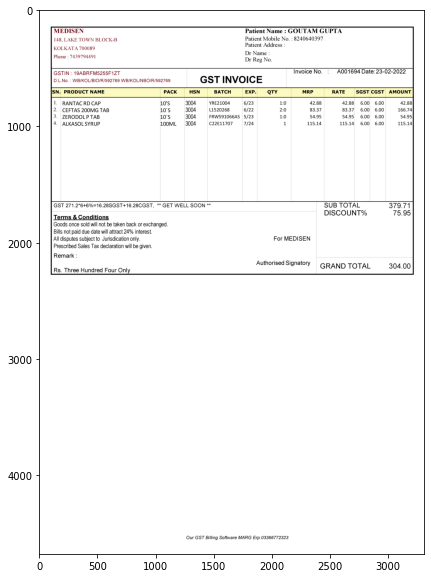


 {'Patient Name': 'GOUTAM GUPTA', 'Patient Mobile Number': [8240640397, 7439794491], 'Patient Address': '', 'Date': '23-02-2022', 'Invoice Number': 'A001694'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,RANTAC RD CAP,10'S,3004,YRE21004,6/23,1:0,42.88,42.88,6.00,6.00,42.88
1,2.,CEETAS 200MG TAB,10`S,3004,L1520268,6/22,2:0,83.37,83.37,6.00,6.00,166.74
2,3.,ZERODOLP TAB,10`S,3004,FRW591066AS,5/23,1:0,54.95,54.95,6.00,6.00,54.95
3,4.,ALKASOL SYRUP,100ML,3004,C22E11707,7/24,1,115.14,115.14,6.00,6.00,115.14



 {'SuB TotAL': 379.71, 'DISCOUNT%': 75.95, 'GRAND TOTAL': 304.0} 


-----------------------------------------------------------------------------------------------------------------------

183-1-1648991206754.png


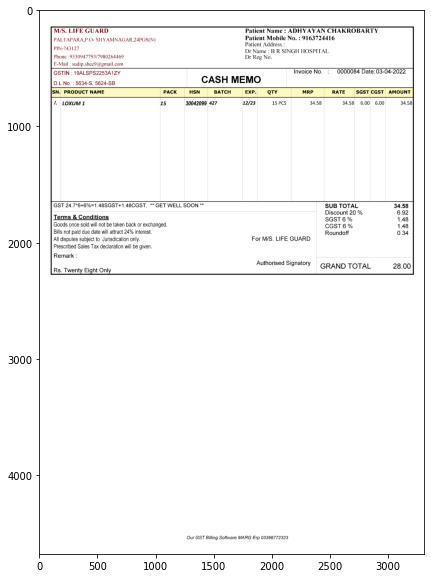


 {'Patient Name': 'ADHYAYAN CHAKROBARTY', 'Patient Mobile Number': [9163724416], 'Patient Address': '', 'Date': '03-04-2022', 'Invoice Number': '0000084'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,LOXUM 1,15,30042099,427,12/23,15 PCS,34.58,34.58,6.00,6.00,34.58



 {'SUB TOTAL': 34.58, 'Discount 20 %': 6.92, 'SGST 6 %': 1.48, 'CGST 6 %': 1.48, 'Roundoff': 0.34, 'GRAND TOTAL': 28.0} 


-----------------------------------------------------------------------------------------------------------------------

183-2-1651644889092.png


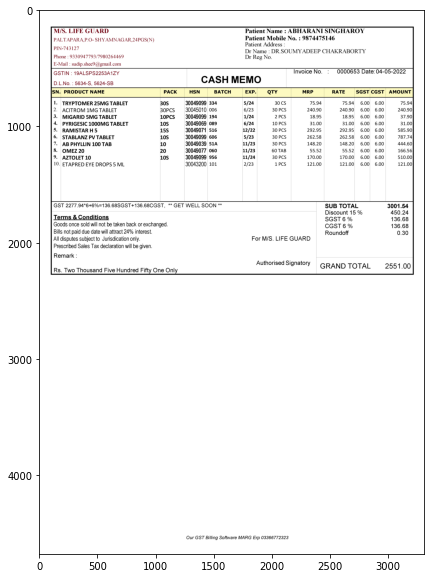


 {'Patient Name': 'ABHARAN SINGHAROY', 'Patient Mobile Number': [9874475146], 'Patient Address': '', 'Date': '04-05-2022', 'Invoice Number': '0000653'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,TRYPTOMER 25MG TABLET,30S,30049099,334,5/24,30 CS,75.94,75.94,6.00,6.00,75.94
1,2.,ACITROM 1MG TABLET,30PCS,30045010,006,6/23,30 PCS,240.90,240.90,6.00,6.00,240.90
2,3.,MIGARID 5MG TABLET,10PCS,30049099,194,1/24,2 PCS,18.95,18.95,6.00,6.00,37.90
3,4.,PYRIGESIC 1OOOMG TABLET,10S,30049069,089,6/24,10 PCS,31.00,31.00,6.00,6.00,31.00
4,5.,RAMISTAR H 5,15S,30049071,516,12/22,30 PCS,292.95,292.95,6.00,6.00,585.90
5,6.,STABLANZ PV TABLET,10S,30049099,606,5/23,30 PCS,262.58,262.58,6.00,6.00,787.74
6,7.,AB PHYLLIN 100 TAB,10,30049039,51A,11/23,30 PCS,148.20,148.20,6.00,6.00,444.60
7,8.,OMEZ 20,20,30049077,060,11/23,60 TAB,55.52,55.52,6.00,6.00,166.56
8,9.,AZTOLET 10,10S,30049099,956,11/24,30 PCS,170.00,170.00,6.00,6.00,510.00
9,10.,ETAPRED EYE DROPS 5 ML,BLANK,30043200,101,2/23,1 PCS,121.00,121.00,6.00,6.00,121.00



 {'SUB TOTAL': 3001.54, 'Discount 15 %': 450.24, 'SGST 6 %': 136.68, 'CGST 6 %': 136.68, 'Roundoff': 0.3, 'GRAND TOTAL': 2551.0} 


-----------------------------------------------------------------------------------------------------------------------

183-3-1650175922755.png


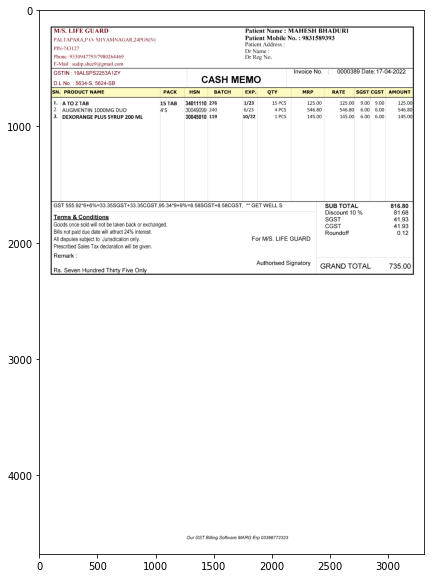


 {'Patient Name': 'MAHESH BHADURI', 'Patient Mobile Number': [9831589393], 'Patient Address': '', 'Date': '17-04-2022', 'Invoice Number': '0000389'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,A TO Z TAB,15 TAB,34011110,276,1/23,15 PCS,125.00,125.00,9.00,9.00,125.00
1,2.,AUGMENTIN 1O0OMG DUO,4'S,30049099,240,6/23,4 PCS,546.80,546.80,6.00,6.00,546.80
2,3.,DEXORANGE PLUS SYRUP 2OO ML,BLANK,30045010,119,10/22,1 PCS,145.00,145.00,6.00,6.00,145.00



 {'SUB tOtAL': 816.8, 'Discount 1o %': 81.68, 'SGST': 41.93, 'CGST': 41.93, 'Roundoff': 0.12, 'GRAND TOTAL': 735.0} 


-----------------------------------------------------------------------------------------------------------------------

183-1-1645683189079.png


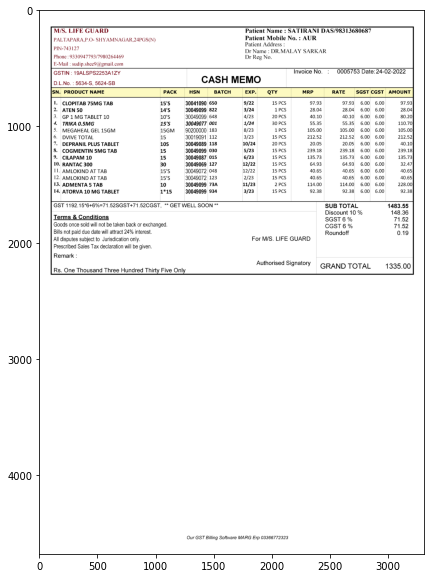


 {'Patient Name': 'SATIRANI DAS/98313680687', 'Patient Mobile Number': [], 'Patient Address': '', 'Date': '24-02-2022', 'Invoice Number': '0005753'} 



,SN.,PRODUCt NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnt
0,1.,CLOPITAB 75MG TAB,15'S,30041090,650,9/22,15 PCS,97.93,97.93,6.00,6.00,97.93
1,2.,ATEN 50,14'S,30049099,822,3/24,1 PCS,28.04,28.04,6.00,6.00,28.04
2,3.,GP 1 MG TABLET 10,10'S,30049099,648,4/23,20 PCS,40.10,40.10,6.00,6.00,80.20
3,4.,TRIKA 0.5MG,15'S,30049077,001,1/24,30 PCS,55.35,55.35,6.00,6.00,110.70
4,5.,MEGAHEAL GEL 15GM,15GM,90200000,183,8/23,1 PCS,105.00,105.00,6.00,6.00,105.00
5,6.,DVIVE TOTAL,15,30019091,112,3/23,15 PCS,212.52,212.52,6.00,6.00,212.52
6,7.,DEPRANIL PLUS TABLET,10S,30049089,118,10/24,20 PCS,20.05,20.05,6.00,6.00,40.10
7,8.,COGMENTIN 5MG TAB,15,30049099,030,5/23,15 PCS,239.18,239.18,6.00,6.00,239.18
8,9.,CILAPAM 10,15,30049087,015,6/23,15 PCS,135.73,135.73,6.00,6.00,135.73
9,10.,RANTAC 300,30,30049069,127,12/22,15 PCS,64.93,64.93,6.00,6.00,32.47



 {'SUB tOtAL': 1483.55, 'Discount 1o %': 148.36, 'SGST 6 %': 71.52, 'CGST 6 %': 71.52, 'Roundoff': 0.19, 'GRAND TOTAL': 1335.0} 


-----------------------------------------------------------------------------------------------------------------------

183-1-1651928486502.png


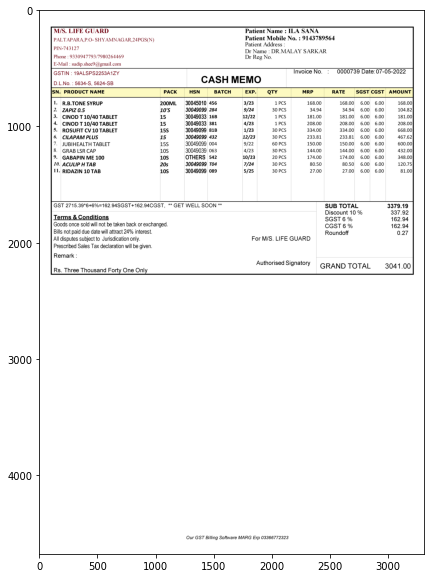


 {'Patient Name': 'ILA SANA', 'Patient Mobile Number': [9143789564], 'Patient Address': '', 'Date': '07-05-2022', 'Invoice Number': '0000739'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,R.B.TONE SYRUP,200ML,30045010,456,3/23,1 PCS,168.00,168.00,6.00,6.00,168.00
1,2.,ZAPIZ 0.5,10'S,30049099,284,9/24,30 PCS,34.94,34.94,6.00,6.00,104.82
2,3.,CINOD T 10/40 TABLET,15,30049033,16B,12/22,1 PCS,181.00,181.00,6.00,6.00,181.00
3,4.,CINOD T 10/40 TABLET,15,30049033,381,4/23,1 PCS,208.00,208.00,6.00,6.00,208.00
4,5.,ROSUFIT CV 10 TABLET,15S,30049099,81B,1/23,30 PCS,334.00,334.00,6.00,6.00,668.00
5,6.,CILAPAM PLUS,15,30049099,432,12/23,30 PCS,233.81,233.81,6.00,6.00,467.62
6,7.,JUBIHEALTH TABLET,15S,30049099,004,9/22,60 PCS,150.00,150.00,6.00,6.00,600.00
7,8.,GRAB LSR CAP,10S,30049039,063,4/23,30 PCS,144.00,144.00,6.00,6.00,432.00
8,9.,GABAPIN ME 100,10S,OTHERS,542,10/23,20 PCS,174.00,174.00,6.00,6.00,348.00
9,10.,ACULIP H TAB,20s,30049099,T04,7/24,30 PCS,80.50,80.50,6.00,6.00,120.75



 {'SUB TOTAL': 3379.19, 'Discount 10 %': 337.92, 'SGST 6 %': 162.94, 'CGST 6 %': 162.94, 'Roundoff': 0.27, 'GRAND TOTAL': 3041.0} 


-----------------------------------------------------------------------------------------------------------------------

184-2-1642219684398.png


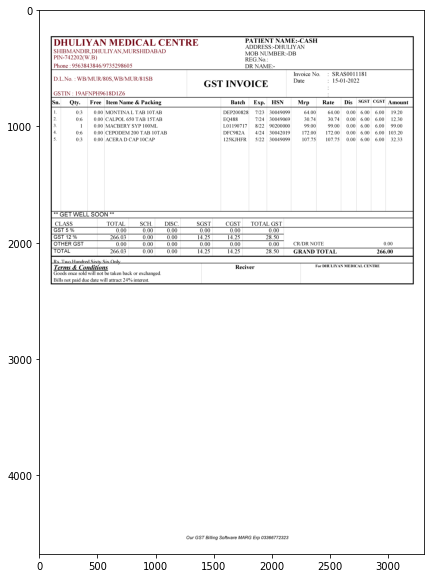


 {'Patient Name': 'CASH', 'Patient Mobile Number': [], 'Patient Address': 'DHULIYAN', 'Date': '15-01-2022', 'Invoice Number': 'SRAS0011181'} 



,Sn.,Qty.,Free,Item Name & Packing,Batch,Exp.,HSN,Mrp,Rate,Dis,SGST,CGST,Amount
0,1.,0:3,0.00,MONTINA L TAB 1OTAB,DEP200828,7/23,30049099,64.00,64.00,0.00,6.00,6.00,19.20
1,2.,0:6,0.00,CALPOL 650 TAB 15TAB,EQ488,7/24,30049069,30.74,30.74,0.00,6.00,6.00,12.30
2,3.,1,0.00,MACBERY SYP 100ML,L01190717,8/22,90200000,99.00,99.00,0.00,6.00,6.00,99.00
3,4.,0:6,0.00,CEPODEM 200 TAB 10TAB,DFC982A,4/24,30042019,172.00,172.00,0.00,6.00,6.00,103.20
4,5.,0:3,0.00,ACERA D CAP 10CAP,125KJHFR,5/22,30049099,107.75,107.75,0.00,6.00,6.00,32.33



 {'CR/DR NOTE': 0.0, 'GRAND TOTAL': 266.0} 


-----------------------------------------------------------------------------------------------------------------------

184-20-1642162134831.png


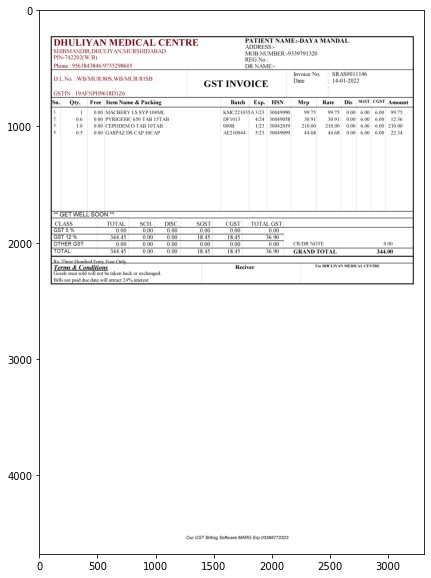


 {'Patient Name': 'DAYA MANDAL', 'Patient Mobile Number': [], 'Patient Address': '', 'Date': '14-01-2022', 'Invoice Number': 'SRAS0011146'} 



,Sn.,Qty.,Free,Item Name & Packing,Batch,Exp.,HSN,Mrp,Rate,Dis,SGST,CGST,Amount
0,1.,1,0.00,MACBERY LS SYP 10OML,KMC22103,A 3/23,30049990,99.75,99.75,0.00,6.00,6.00,99.75
1,2.,0:6,0.00,PYRIGESIC 650 TAB 15TAB,DF1013,4/24,30049058,30.91,30.91,0.00,6.00,6.00,12.36
2,3.,1:0,0.00,CEPODEM O TAB 10TAB,000B,1/23,30042019,210.00,210.00,0.00,6.00,6.00,210.00
3,4.,0:5,0.00,GASPAZ DS CAP 10CAP,AE210044,5/23,30049099,44.68,44.68,0.00,6.00,6.00,22.34



 {'CR/DR NOTE': 0.0, 'GRAND TOTAL': 344.0} 


-----------------------------------------------------------------------------------------------------------------------

184-15-1642224102620.png


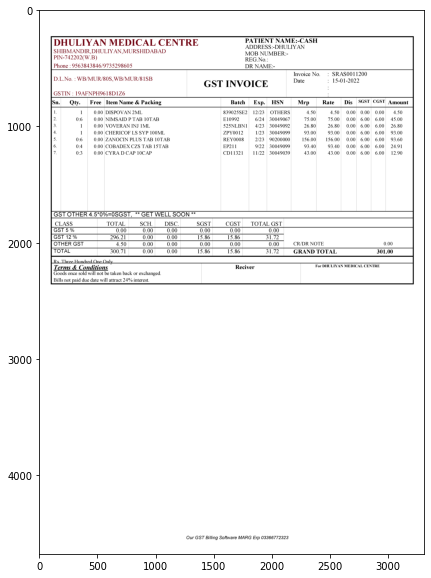


 {'Patient Name': 'CASH', 'Patient Mobile Number': [], 'Patient Address': 'DHULIYAN', 'Date': '15-01-2022', 'Invoice Number': 'SRAS0011200'} 



,Sn.,Qty.,Free,Item Name & Packing,Batch,Exp.,HSN,Mrp,Rate,Dis,SGST,CGST,Amount
0,1.,1,0.00,DISPOVAN 2MI,839025SE2,12/23,OTHERS,4.50,4.50,0.00,0.00,0.00,4.50
1,2.,0:6,0.00,NIMSAID P TAB 1OTAB,E10992,6/24,30049067,75.00,75.00,0.00,6.00,6.00,45.00
2,3.,1,0.00,VOVERANINJ IML,525NLBN1,4/23,30049092,26.80,26.80,0.00,6.00,6.00,26.80
3,4.,1,0.00,CHERICOF LS SYP 100ML,ZPY0012,1/23,30049099,93.00,93.00,0.00,6.00,6.00,93.00
4,5.,0:6,0.00,ZANOCIN PLUS TAB IOTAB,REY0008,2/23,90200000,156.00,156.00,0.00,6.00,6.00,93.60
5,6.,0:4,0.00,COBADEX CZS TAB 15TAB,EP211,9/22,30049099,93.40,93.40,0.00,6.00,6.00,24.91
6,7.,0:3,0.00,CYRA D CAP 10CAP,CD11321,11/22,30049039,43.00,43.00,0.00,6.00,6.00,12.90



 {'CR/DR NOTE': 0.0, 'GRAND TOTAL': 301.0} 


-----------------------------------------------------------------------------------------------------------------------

184-18-1642161605068.png


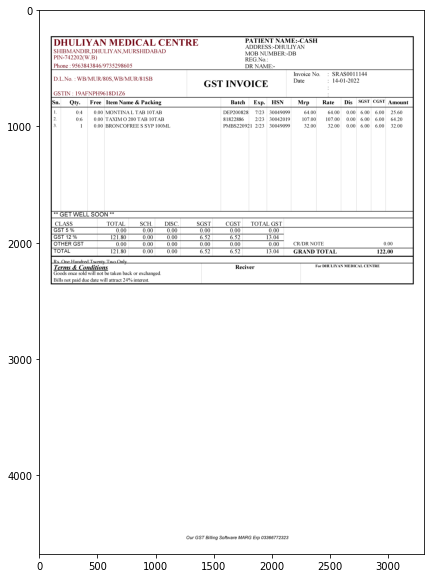


 {'Patient Name': 'CASH', 'Patient Mobile Number': [], 'Patient Address': 'DHULIYAN', 'Date': '14-01-2022', 'Invoice Number': 'SRAS0011144'} 



,Sn.,Qty.,Free,Item Name & Packing,Batch,Exp.,HSN,Mrp,Rate,Dis,SGST,CGST,Amount
0,1.,0:4,0.00,MONTINA L TAB 10TAB,DEP200828,BLANK,30049099,64.00,64.00,0.00,6.00,6.00,25.60
1,2.,0:6,0.00,TAXIM O 200 TAB 10TAB,81822886,2/23,30042019,107.00,107.00,0.00,6.00,6.00,64.20
2,3.,1,0.00,BRONCOFREE S SYP 100ML,PMBS22092,1,30049099,32.00,32.00,0.00,6.00,6.00,32.00



 {'CR/DR NOTE': 0.0, 'GRAND TOTAL': 122.0} 


-----------------------------------------------------------------------------------------------------------------------

186-3-1650288142978.png


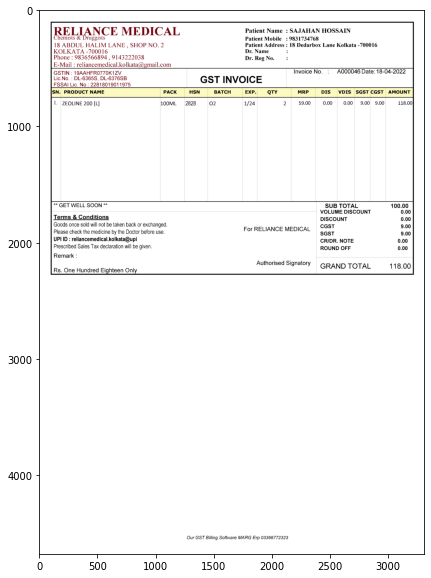


 {'Patient Name': 'SAJAHANHOSSAIN', 'Patient Mobile Number': [9831734768, 9836566894, 9143222038], 'Patient Address': '18 Dedarbox Lane Kolkata 700016', 'Date': '18-04-2022', 'Invoice Number': 'A000046'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DIS,VDIS,SGSt,CGST,AMOUnT
0,1.,ZEOLINE 200 [L],100ML,2828,02,1/24,2,59.00,0.00,0.00,9.00,9.00,118.00



 {'SUB TOTAL': 100.0, 'VOLUME DISCOUNT': 0.0, 'DISCOUNT': 0.0, 'CGST': 9.0, 'SGST': 9.0, 'CR/DR.NOTE': 0.0, 'ROUND OFF': 0.0, 'GRAND TOTAL': 118.0} 


-----------------------------------------------------------------------------------------------------------------------

186-2-1645260613717.png


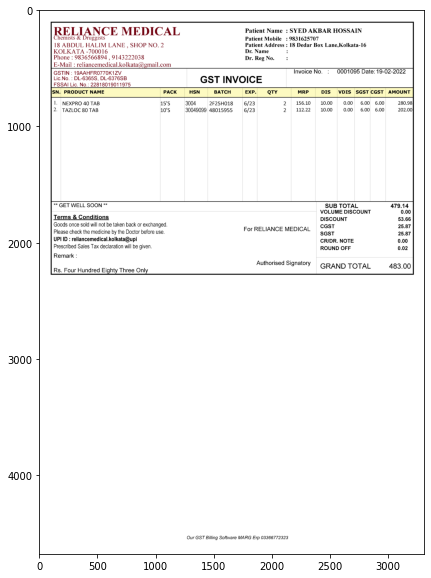


 {'Patient Name': 'SYED AKBAR HOSSAIN', 'Patient Mobile Number': [9831625707, 9836566894, 9143222038], 'Patient Address': '18 Dedar Box Lane,Kolkata16', 'Date': '19-02-2022', 'Invoice Number': '0001095'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DIS,VDIS,SGSt,CGST,AMOUnT
0,1.,NEXPRO 40 TAB,15'S,3004,2F25H018,6/23,2,156.10,10.00,0.00,6.00,6.00,280.98
1,2.,TAZLOC 80 TAB,10'S,30049099,48015955,6/23,2,112.22,10.00,0.00,6.00,6.00,202.00



 {'SUB TOTAL': 479.14, 'VOLUME DISCOUNT': 0.0, 'DISCOUNT': 53.66, 'CGST': 25.87, 'SGST': 25.87, 'CR/DR.NOTE': 0.0, 'ROUND OFF': 0.02, 'GRAND TOTAL': 483.0} 


-----------------------------------------------------------------------------------------------------------------------

186-1-1643467868607.png


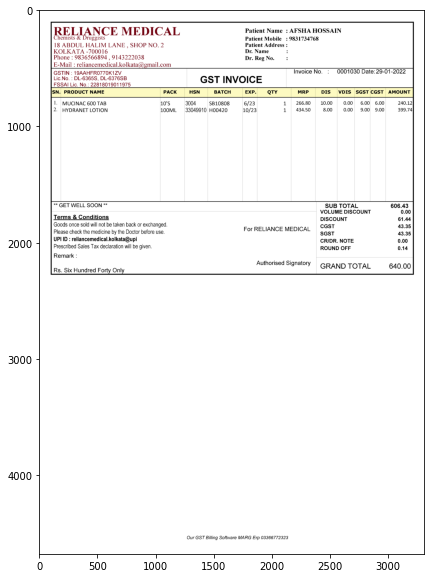


 {'Patient Name': 'AFSHA HOSSAIN', 'Patient Mobile Number': [9831734768, 9836566894, 9143222038], 'Patient Address': '', 'Date': '29-01-2022', 'Invoice Number': '0001030'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DIS,VDIS,SGSt,CGST,AMOUnT
0,1.,MUCINAC 600 TAB,10'S,3004,SB10808,6/23,1,266.80,10.00,0.00,6.00,6.00,240.12
1,2.,HYDRANET LOTION,100ML,33049910,H00420,10/23,1,434.50,8.00,0.00,9.00,9.00,399.74



 {'SUB TOTAL': 606.43, 'VOLUME DISCOUNT': 0.0, 'DISCOUNT': 61.44, 'CGST': 43.35, 'SGST': 43.35, 'CR/DR.NOTE': 0.0, 'ROUND OFF': 0.14, 'GRAND TOTAL': 640.0} 


-----------------------------------------------------------------------------------------------------------------------



In [ ]:
for i in Data_Second:
    print(i)
    image = cv2.imread(f'second/{i}')
    plt.figure(figsize=(20,10))
    plt.imshow(image)
    plt.show()
    print("\n", Data_Second[i]['header'], "\n")
    display(Data_Second[i]['table'])
    print("\n", Data_Second[i]['footer'], "\n")
    print('\n-----------------------------------------------------------------------------------------------------------------------\n')

## Third

In [ ]:
third = os.listdir('third')

Data_Third = {}

for i in third:
    header = extract_header(f'third/{i}')
    table = extract_table(f'third/{i}')
    footer = extract_footer(f'third/{i}')
    Data_Third[i] = {'header': header, 'table': table, 'footer': footer}

[2022/07/05 04:36:29] ppocr WARNING: Since the angle classifier is not initialized, the angle classifier will not be uesd during the forward process
[2022/07/05 04:36:29] ppocr DEBUG: dt_boxes num : 17, elapse : 0.041188955307006836
[2022/07/05 04:36:29] ppocr DEBUG: rec_res num  : 17, elapse : 0.04655122756958008
[2022/07/05 04:36:29] ppocr WARNING: Since the angle classifier is not initialized, the angle classifier will not be uesd during the forward process
[2022/07/05 04:36:29] ppocr DEBUG: dt_boxes num : 16, elapse : 0.01992964744567871
[2022/07/05 04:36:29] ppocr DEBUG: rec_res num  : 16, elapse : 0.061769962310791016
[2022/07/05 04:36:32] ppocr WARNING: Since the angle classifier is not initialized, the angle classifier will not be uesd during the forward process
[2022/07/05 04:36:32] ppocr DEBUG: dt_boxes num : 4, elapse : 0.011861085891723633
[2022/07/05 04:36:32] ppocr DEBUG: rec_res num  : 4, elapse : 0.010384798049926758
[2022/07/05 04:36:32] ppocr WARNING: Since the angle 

186-2-1651233691930.png


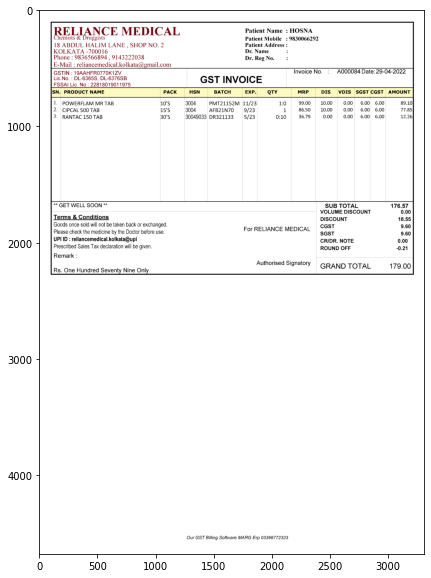


 {'Patient Name': 'HOSNA', 'Patient Mobile Number': [9830066292, 9836566894, 9143222038], 'Patient Address': '', 'Date': '29-04-2022', 'Invoice Number': 'A000084'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DIS,VDIS,SGSt,CGST,AMOUnT
0,1.,POWERELAM MR TAB,10'S,3004,PMT21152M,11/23,1:0,99.00,10.00,0.00,6.00,6.00,89.10
1,2.,CIPCAL 500 TAB,15'S,3004,AFB21N70,9/23,1,86.50,10.00,0.00,6.00,6.00,77.85
2,3.,RANTAC 150 TAB,30'S,30049033,DR321133,5/23,0:10,36.79,0.00,0.00,6.00,6.00,12.26



 {'SUB TOTAL': 176.57, 'VOLUME DISCOUNT': 0.0, 'DISCOUNT': 18.55, 'CGST': 9.6, 'SGST': 9.6, 'CR/DR.NOTE': 0.0, 'ROUND OFF': -0.21, 'GRAND TOTAL': 179.0} 


-----------------------------------------------------------------------------------------------------------------------

186-1-1644581979444.png


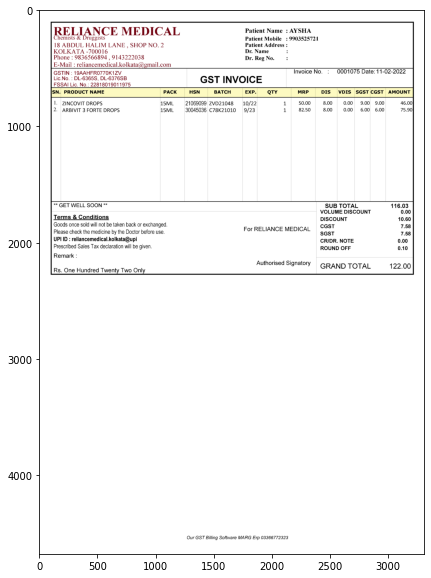


 {'Patient Name': 'AYSHA', 'Patient Mobile Number': [9903525721, 9836566894, 9143222038], 'Patient Address': '', 'Date': '11-02-2022', 'Invoice Number': '0001075'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DIS,VDIS,SGSt,CGST,AMOUnT
0,1.,ZINCOVIT DROPS,15ML,21069099,ZVD21048,10/22,1,50.00,8.00,0.00,9.00,9.00,46.00
1,2.,ARBIVIT 3 FORTE DROPS,15ML,30045036,C78K21010,9/23,1,82.50,8.00,0.00,6.00,6.00,75.90



 {'SUB TOTAL': 116.03, 'VOLUME DISCOUNT': 0.0, 'DISCOUNT': 10.6, 'CGST': 7.58, 'SGST': 7.58, 'CR/DR.NOTE': 0.0, 'ROUND OFF': 0.1, 'GRAND TOTAL': 122.0} 


-----------------------------------------------------------------------------------------------------------------------

187-6-1643051077176.png


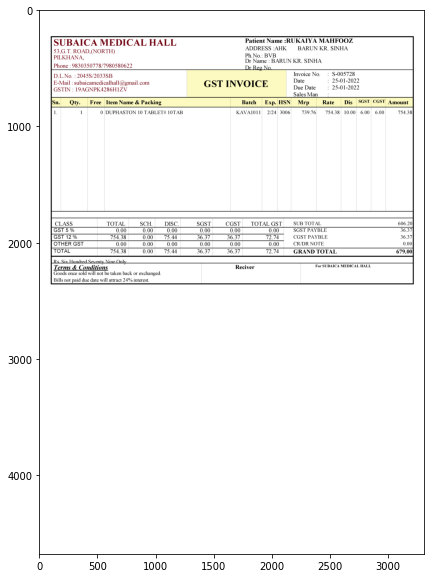


 {'Patient Name': 'RUKAIYA MAHFOOZ', 'Patient Mobile Number': [], 'Patient Address': 'AHK BARUN KR. SINHA', 'Date': '25-01-2022', 'Invoice Number': 'S-005728'} 



,Sn.,Qty.,Free,Item Name & Packing,Batch,Exp.,HSN,Mrp,Rate,Dis,SGST,CGST,Amount
0,1.,1,0,DUPHASTON 10 TABLET# IOTAB,KAVA1011,2/24,3006,739.76,754.38,10.00,6.00,6.00,754.38



 {'SUB TOTAL': 606.2, 'SGST PAYBLE': 36.37, 'CGST PAYBLE': 36.37, 'CR/DR NOTE': 0.0, 'GRAND TOTAL': 679.0} 


-----------------------------------------------------------------------------------------------------------------------

187-11-1645631940735.png


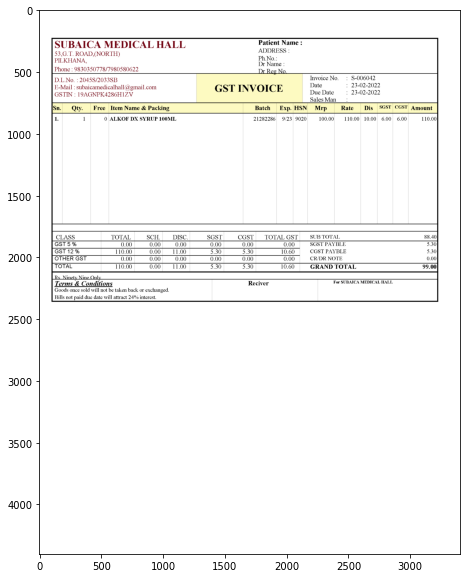


 {'Patient Name': '', 'Patient Mobile Number': [], 'Patient Address': '', 'Date': '23-02-2022 VOICE', 'Invoice Number': 'S-006042'} 



,Sn.,Qty.,Free,Item Name & Packing,Batch,Exp.,HSN,Mrp,Rate,Dis,SGST,CGST,Amount
0,1.,1,0,ALKOFDX SYRUP 1OOML,21282286,9/23,9020,100.00,110.00,10.00,6.00,6.00,110.00



 {'SUBTOTAL': 88.4, 'SGSTFAYBLE': 5.3, 'CGST PAYBLE': 5.3, 'CR/DR NOTE': 0.0, 'GRANDTOTAL': 99.0} 


-----------------------------------------------------------------------------------------------------------------------

187-27-1645799568433.png


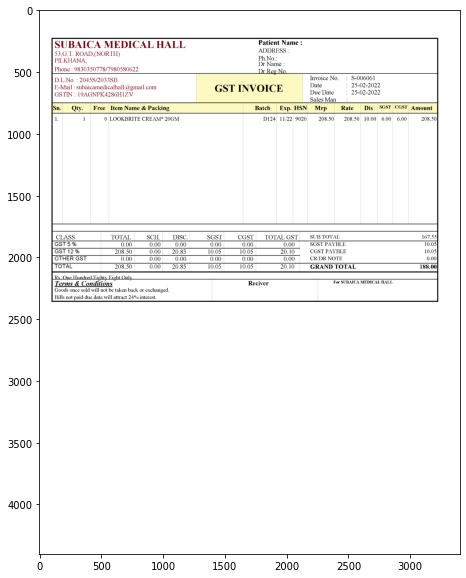


 {'Patient Name': '', 'Patient Mobile Number': [], 'Patient Address': '', 'Date': '25-02-2022 VOICE', 'Invoice Number': 'S-006061'} 



,Sn.,Qty.,Free,Item Name & Packing,Batch,Exp.,HSN,Mrp,Rate,Dis,SGST,CGST,Amount
0,1.,1,0,LOOKBRTE CREAM* Z0GM,D124,11/22,9020,208.50,208.50,10.00,6.00,6.00,208.50



 {'SUB TOTAL': 167.55, 'SGSTFAYBLE': 10.05, 'CGST PAYBLE': 10.05, 'CR/DR NOTE': 0.0, 'GRANDTOTAL': 188.0} 


-----------------------------------------------------------------------------------------------------------------------

187-15-1647270208396.png


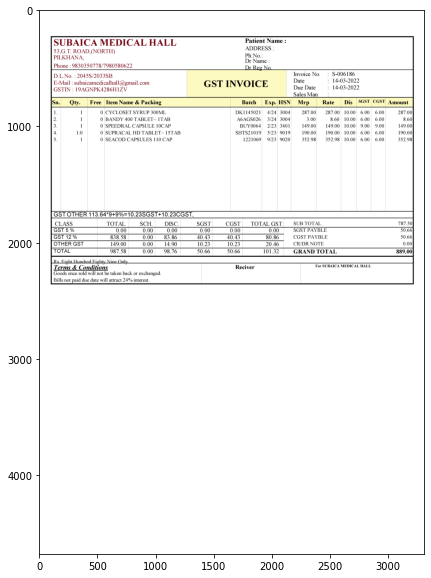


 {'Patient Name': '', 'Patient Mobile Number': [], 'Patient Address': '', 'Date': '14-03-2022', 'Invoice Number': 'S-006186'} 



,Sn.,Qty.,Free,Item Name & Packing,Batch,Exp.,HSN,Mrp,Rate,Dis,SGST,CGST,Amount
0,1.,1,0,CYCLOSET SYRUP 300MI,DK1145021,4/24,3004,287.00,287.00,10.00,6.00,6.00,287.00
1,2.,1,0,BANDY 4O0 TABLET~ 1TAB,A6AGS026,3/24,3004,3.00,8.60,10.00,6.00,6.00,8.60
2,3.,1,0,SPEEDRAL CAPSULE 10CAP,BUY0064,2/23,3401,149.00,149.00,10.00,9.00,9.00,149.00
3,4.,1:0,0,SUPRACAL HD TABLET~ 15TAB,SHTS21019,5/23,9019,190.00,190.00,10.00,6.00,6.00,190.00
4,5.,1,0,SEACOD CAPSULES 110 CAP,1221069,9/23,9020,352.98,352.98,10.00,6.00,6.00,352.98



 {'SUB TOTAL': 787.5, 'SGST PAYBLE': 50.66, 'CGST PAYBLE': 50.66, 'CR/DR NOTE': 0.0, 'GRAND TOTAL': 889.0} 


-----------------------------------------------------------------------------------------------------------------------

187-13-1649257644244.png


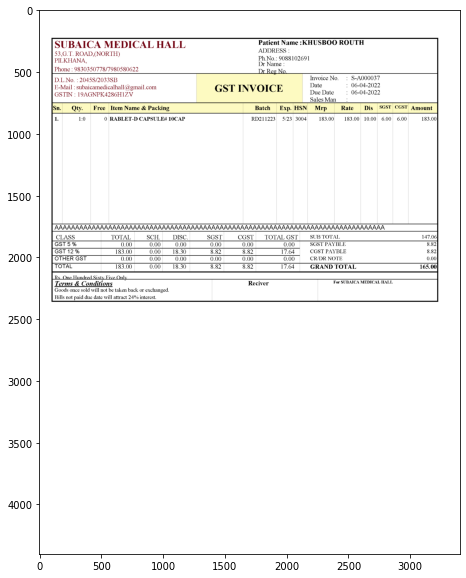


 {'Patient Name': 'KHUSBOO ROUTH', 'Patient Mobile Number': [9088102691], 'Patient Address': '', 'Date': '06-04-2022 VOICE', 'Invoice Number': 'S-A000037'} 



,Sn.,Qty.,Free,Item Name & Packing,Batch,Exp.,HSN,Mrp,Rate,Dis,SGST,CGST,Amount
0,1.,1:0,0,RABLET-D CAPSULE# 1OCAP,RD211223,5/23,3004,183.00,183.00,10.00,6.00,6.00,183.00



 {'SUBTOTAJ': 147.06, 'SGST PAYBLE': 8.82, 'CGST PAYBLE': 8.82, 'CR/DR NOTE': 0.0, 'GRANDTOTAL': 165.0} 


-----------------------------------------------------------------------------------------------------------------------

190-2-1651499645300.png


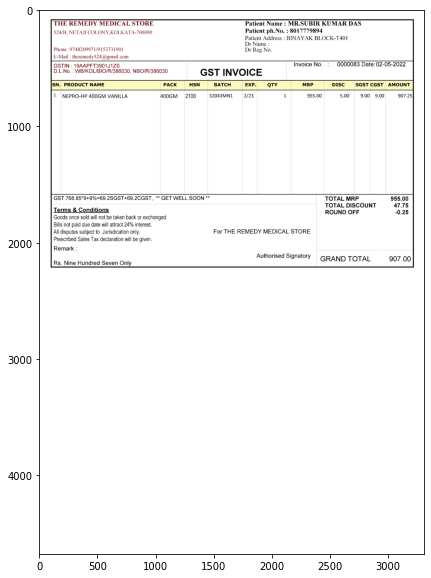


 {'Patient Name': 'MR.SUBIR KUMAR DAS', 'Patient Mobile Number': [8017779894], 'Patient Address': 'BINAYAK BLOCKT401', 'Date': '02-05-2022', 'Invoice Number': '0000083'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DISC,SGST,CGST,AMOUNT
0,1.,NEPRO-HP 4OOGM VANILLA,400GM,2106,32043MN1,2/23,1,955.00,5.00,9.00,9.00,907.25



 {'TOTAL MRP': 955.0, 'TOTAL DISCOUNT': 47.75, 'ROUND OFF': -0.25, 'GRAND TOTAL': 907.0} 


-----------------------------------------------------------------------------------------------------------------------

190-3-1649258970526.png


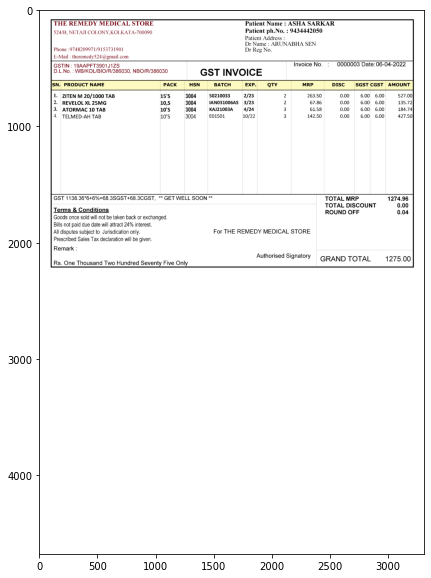


 {'Patient Name': 'ASHA SARKAR', 'Patient Mobile Number': [9434442050], 'Patient Address': '', 'Date': '06-04-2022', 'Invoice Number': '0000003'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DISC,SGST,CGST,AMOUNT
0,1.,ZITEN M 20/1000 TAB,15'S,3004,50210033,2/23,2,263.50,0.00,6.00,6.00,527.00
1,2.,REVELOL XL 25MG,"10,S",3004,IAN031006AS,3/23,2,67.86,0.00,6.00,6.00,135.72
2,3.,ATORMAC 10 TAB,10'S,3004,KAJ21003A,4/24,3,61.58,0.00,6.00,6.00,184.74
3,4.,TELMED-AH TAB,10'S,3004,E01501,10/22,3,142.50,0.00,6.00,6.00,427.50



 {'TOTAL MRP': 1274.96, 'TOTAL DISCOUNT': 0.0, 'ROUND OFF': 0.04, 'GRAND TOTAL': 1275.0} 


-----------------------------------------------------------------------------------------------------------------------

190-5-1648488135157.png


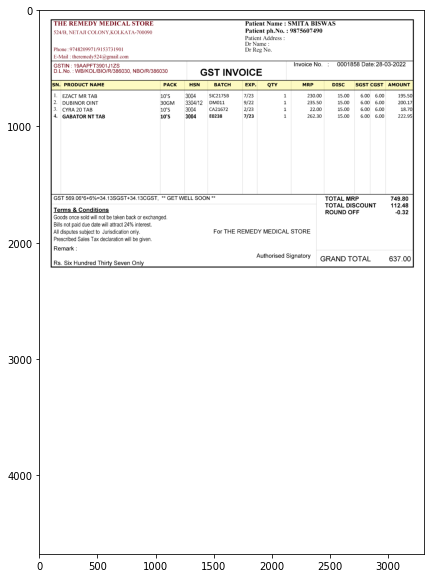


 {'Patient Name': 'SMITA BISWAS', 'Patient Mobile Number': [9875607490], 'Patient Address': '', 'Date': '28-03-2022', 'Invoice Number': '0001858'} 



,SN.,PRODUct nAMe,PACK,HSN,BATCH,EXP.,QTY,MRP,DISC,SGST,CGST,AMOUNT
0,1.,EZACT MR TAB,10'S,3004,SIC2175B,7/23,1,230.00,15.00,6.00,6.00,195.50
1,2.,DUBINOR OINT,30GM,3304/12,DM011,9/22,1,235.50,15.00,6.00,6.00,200.17
2,3.,CYRA 20 TAB,10'S,3004,CA21672,2/23,1,22.00,15.00,6.00,6.00,18.70
3,4.,GABATOR NT TAB,10'S,3004,E0238,7/23,1,262.30,15.00,6.00,6.00,222.95



 {'TOTAL MRP': 749.8, 'TOTAL DISCOUNT': 112.48, 'ROUND OFF': -0.32, 'GRAND TOTAL': 637.0} 


-----------------------------------------------------------------------------------------------------------------------

190-2-1645510783234.png


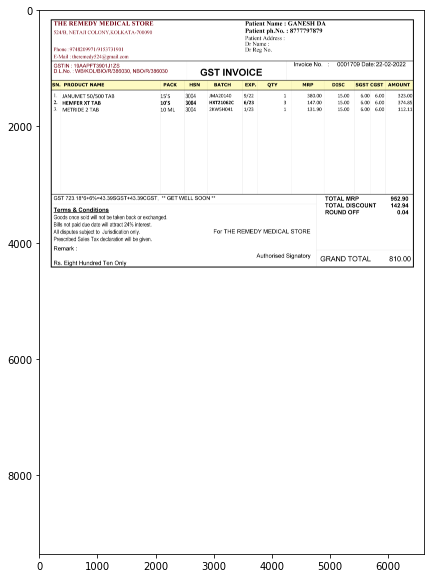


 {'Patient Name': 'GANESH DA', 'Patient Mobile Number': [8777797879], 'Patient Address': '', 'Date': '22-02-2022', 'Invoice Number': ''} 



,Phone : 9748209971/9153731901
0,Dr Reg No.
1,E-Mail : theremedy524@gmail.com
2,Invoice No. :
3,0001709 Date: 22-02-2022
4,GSTIN : 19AAPFT3901J1ZS
5,"D.L.No. : WB/KOL/BIO/R/386030, NBO/R/386030"
6,GST INVOICE
7,SN.PROdUCt NAME
8,PACK
9,HSN



 {'totAL MRP': 952.9, 'TOTAL DISCOUNT': 142.94, 'ROUND OFF': 0.04, 'GRAND TOTAL': 810.0} 


-----------------------------------------------------------------------------------------------------------------------

190-10-1646321414881.png


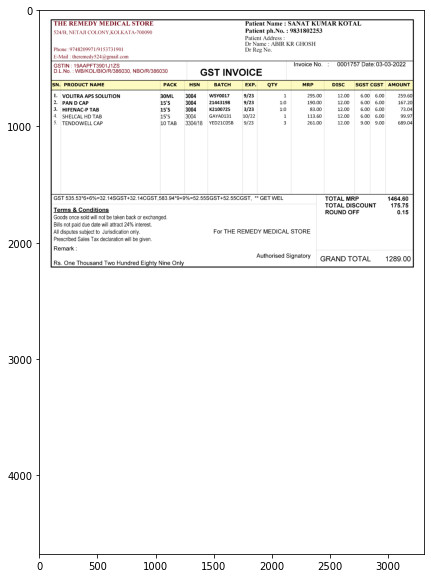


 {'Patient Name': 'SANAT KUMAR KOTAL', 'Patient Mobile Number': [9831802253], 'Patient Address': '', 'Date': '03-03-2022', 'Invoice Number': '0001757'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DISC,SGST,CGST,AMOUNT
0,1.,VOLITRA APS SOLUTION,30ML,3004,WSY0017,9/23,1,295.00,12.00,6.00,6.00,259.60
1,2.,PAN D CAP,15'S,3004,21443198,9/23,1:0,190.00,12.00,6.00,6.00,167.20
2,3.,HIFENAC-P TAB,15'S,3004,K2100725,3/23,1:0,83.00,12.00,6.00,6.00,73.04
3,4.,SHELCAL HD TAB,15'S,3004,GAYA0131,10/22,1,113.60,12.00,6.00,6.00,99.97
4,5.,TENDOWELL CAP,10 TAB,3304/18,YED21C05B,9/23,3,261.00,12.00,9.00,9.00,689.04



 {'TOTAL MRP': 1464.6, 'TOTAL DISCOUNT': 175.75, 'ROUND OFF': 0.15, 'GRAND TOTAL': 1289.0} 


-----------------------------------------------------------------------------------------------------------------------

191-7-1649419355885.png


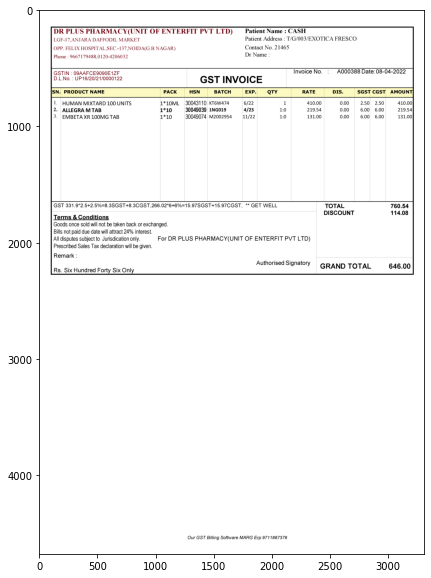


 {'Patient Name': 'CASH', 'Patient Mobile Number': [9667179488], 'Patient Address': 'T/G/003/EXOTICA FRESCO', 'Date': '08-04-2022', 'Invoice Number': 'A000388'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,RATE,DIS.,SGST,CGST,AMOUNT
0,1.,HUMAN MIXTARD 1OO UNITS,1*10ML,30043110,KT6W474,6/22,1,410.00,0.00,2.50,2.50,410.00
1,2.,ALLEGRA MTAB,1*10,30049039,1NG019,4/23,1:0,219.54,0.00,6.00,6.00,219.54
2,3.,EMBETA XR 1OOMG TAB,1*10,30049074,M2002954,11/22,1:0,131.00,0.00,6.00,6.00,131.00



 {'TOTAL': 760.54, 'DISCOUNT': 114.08, 'GRAND tOtAL': 646.0} 


-----------------------------------------------------------------------------------------------------------------------

191-11-1645113677952.png


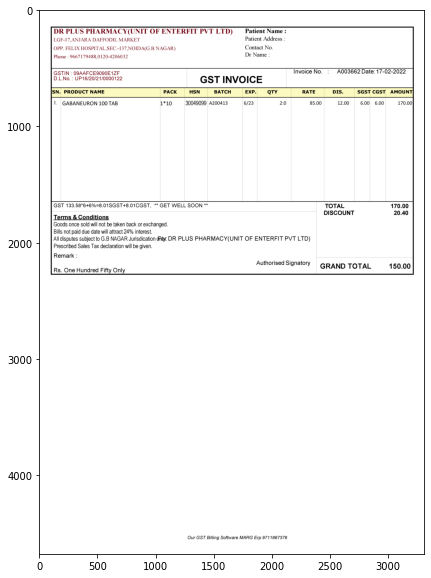


 {'Patient Name': '', 'Patient Mobile Number': [9667179488], 'Patient Address': '', 'Date': '17-02-2022', 'Invoice Number': 'A003662'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,RATE,DIS.,SGST,CGST,AMOUNT
0,1.,GABANEURON 100 TAB,1*10,30049099,A200413,6/23,2:0,85.00,12.00,6.00,6.00,170.00



 {'TOTAL': 170.0, 'DISCOUNT': 20.4, 'GRAND tOtAL': 150.0} 


-----------------------------------------------------------------------------------------------------------------------

191-22-1649688907623.png


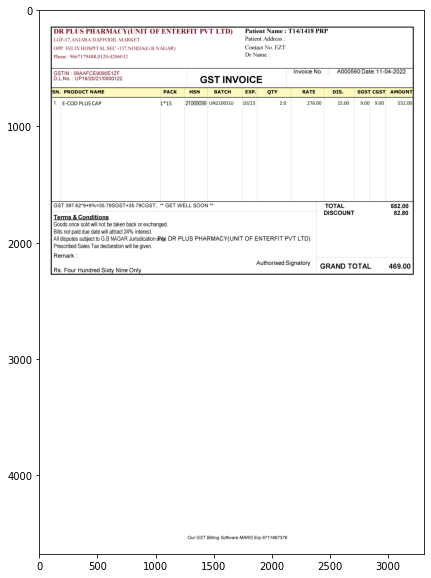


 {'Patient Name': 'T14/1418 PRP', 'Patient Mobile Number': [9667179488], 'Patient Address': '', 'Date': '11-04-2022', 'Invoice Number': 'A000560'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,RATE,DIS.,SGST,CGST,AMOUNT
0,1.,E-COD PLUS CAP,1*15,21069099,UN21001GJ,10/23,2:0,276.00,15.00,9.00,9.00,552.00



 {'TOTAL': 552.0, 'DISCOUNT': 82.8, 'GRAND tOtAL': 469.0} 


-----------------------------------------------------------------------------------------------------------------------

191-6-1646397590479.png


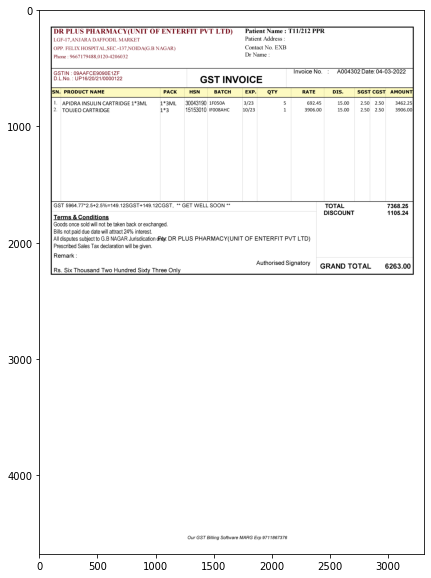


 {'Patient Name': 'T11/212 PPR', 'Patient Mobile Number': [9667179488], 'Patient Address': '', 'Date': '04-03-2022', 'Invoice Number': 'A004302'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,RATE,DIS.,SGST,CGST,AMOUNT
0,1.,APIDRA INSULIN CARTRIDGE 1*3ML,1*3ML,30043190,1F050A,3/23,5,692.45,15.00,2.50,2.50,3462.25
1,2.,TOUJEO CARTRIDGE,1*3,15153010,IF008AHC,10/23,1,3906.00,15.00,2.50,2.50,3906.00



 {'TOTAL': 7368.25, 'DISCOUNT': 1105.24, 'GRAND tOtAL': 6263.0} 


-----------------------------------------------------------------------------------------------------------------------

191-11-1649333237044.png


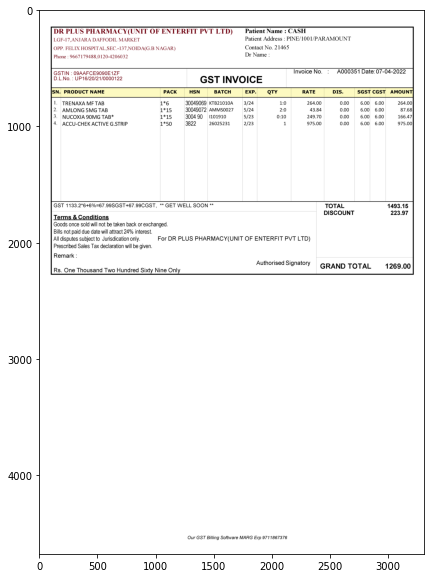


 {'Patient Name': 'CASH', 'Patient Mobile Number': [9667179488], 'Patient Address': 'PINE/1001/PARAMOUNT', 'Date': '07-04-2022', 'Invoice Number': 'A000351'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,RATE,DIS.,SGST,CGST,AMOUNT
0,1.,TRENAXA ME TAB,1*6,30049069,KTB21010A,3/24,1:0,264.00,0.00,6.00,6.00,264.00
1,2.,AMLONG 5MG TAB,1*15,30049072,AMMS0027,5/24,2:0,43.84,0.00,6.00,6.00,87.68
2,3.,NUCOXIA 9OMG TAB*,1*15,3004 90,|101910,5/23,0:10,249.70,0.00,6.00,6.00,166.47
3,4.,ACCU-CHEK ACTIVE G.STRIP,1*50,3822,26025231,2/23,1,975.00,0.00,6.00,6.00,975.00



 {'TOTAL': 1493.15, 'DISCOUNT': 223.97, 'GRAND TOTAL': 1269.0} 


-----------------------------------------------------------------------------------------------------------------------

192-4-1643519798813.png


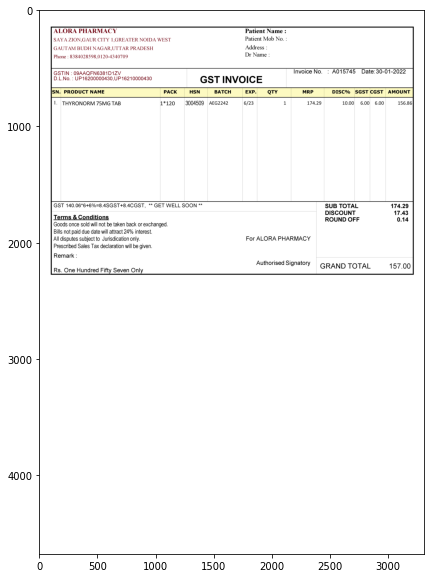


 {'Patient Name': '', 'Patient Mobile Number': [8384028598], 'Patient Address': '', 'Date': '30-01-2022', 'Invoice Number': 'A015745'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DISC%,SGST,CGST,AMOUNT
0,1.,THYRONORM 75MG TAB,1*120,3004509,AEG2242,6/23,1,174.29,10.00,6.00,6.00,156.86



 {'SUB TOTAL': 174.29, 'DISCOUNT': 17.43, 'ROUND OFF': 0.14, 'GRAND TOTAL': 157.0} 


-----------------------------------------------------------------------------------------------------------------------

192-4-1642851584166.png


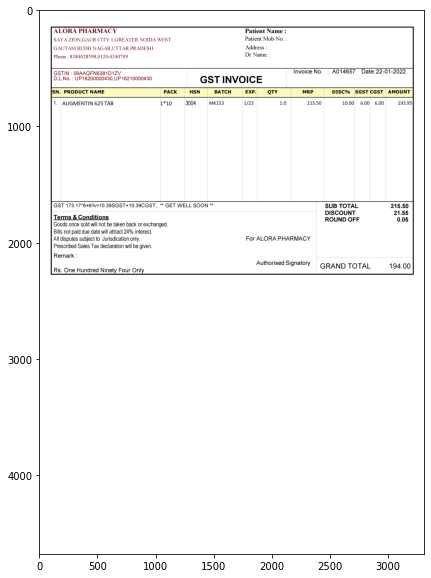


 {'Patient Name': '', 'Patient Mobile Number': [8384028598], 'Patient Address': '', 'Date': '22-01-2022', 'Invoice Number': 'A014657'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DISC%,SGST,CGST,AMOUNT
0,1.,AUGMENTIN 625 TAB,1*10,3004,MK153,1/23,1:0,215.50,10.00,6.00,6.00,193.95



 {'SUB TOTAL': 215.5, 'DISCOUNT': 21.55, 'ROUND OFF': 0.05, 'GRAND TOTAL': 194.0} 


-----------------------------------------------------------------------------------------------------------------------

195-19-1643730210959.png


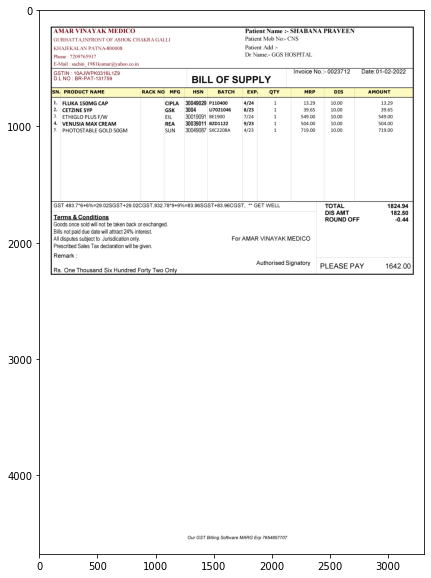


 {'Patient Name': 'SHABANA PRAVEEN', 'Patient Mobile Number': [7209765917], 'Patient Address': '', 'Date': '01-02-2022', 'Invoice Number': '-'} 



,SN.,PRODUCT NAME,RACK NO,MFG,HSN,BATCH,EXP,QTY,MRP,DIS,AMOUNT
0,1.,FLUKA 150MG CAP,BLANK,CIPLA,30049029,P110400,4/24,1,13.29,10.00,13.29
1,2.,CETZINE SYP,BLANK,GSK,3004,LI7021046,8/23,1,39.65,10.00,39.65
2,3.,ETHIGLO PLUS F/W,BLANK,EIL,30019091,BE1900,7/24,1,549.00,10.00,549.00
3,4.,VENUSIA MAX CREAM,BLANK,REA,30039011,BZD1122,9/23,1,504.00,10.00,504.00
4,5.,PHOTOSTABLE GOLD 5OGM,BLANK,SUN,30049087,SXC2208A,4/23,1,719.00,10.00,719.00



 {'TOTAL': 1824.94, 'DIS AMT': 182.5, 'ROUND OFF': -0.44, 'PLEASE PAY': 1642.0} 


-----------------------------------------------------------------------------------------------------------------------

195-1-1648643643695.png


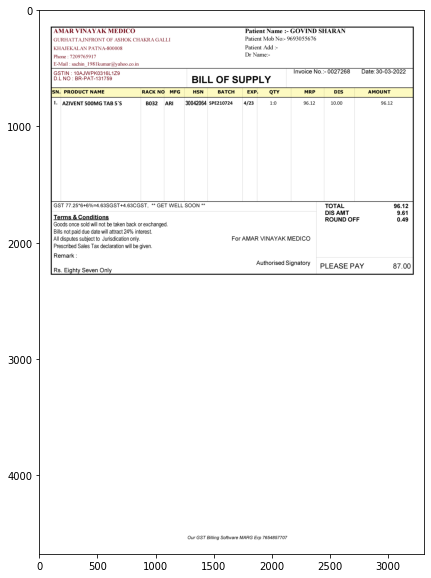


 {'Patient Name': 'GOVIND SHARAN', 'Patient Mobile Number': [9693055676, 7209765917], 'Patient Address': '', 'Date': '30-03-2022', 'Invoice Number': '-'} 



,SN.,PRODUCT NAME,RACK NO,MFG,HSN,BATCH,EXP,QTY,MRP,DIS,AMOUNT
0,1.,AZIVENT 500MG TAB 5`S,B032,ARI,30042064,SPE210724,4/23,1:0,96.12,10.00,96.12



 {'TOTAL': 96.12, 'DIS AMT': 9.61, 'ROUND OFF': 0.49, 'PLEASE PAY': 87.0} 


-----------------------------------------------------------------------------------------------------------------------

195-3-1643635388502.png


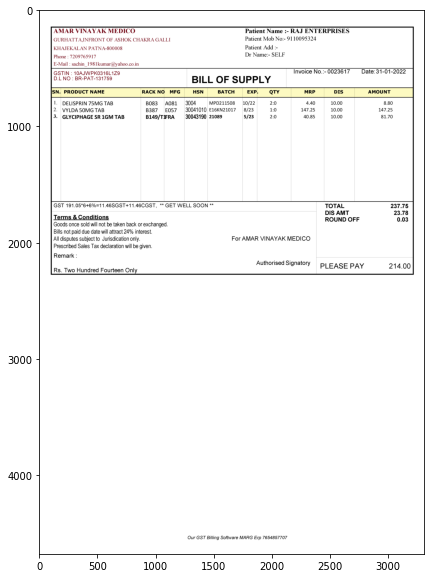


 {'Patient Name': 'RAJ ENTERPRISES', 'Patient Mobile Number': [9110095324, 7209765917], 'Patient Address': '', 'Date': '31-01-2022', 'Invoice Number': '-'} 



,SN.,PRODUCT NAME,RACK NO,MFG,HSN,BATCH,EXP,QTY,MRP,DIS,AMOUNT
0,1.,DELISPRIN 75MG TAB,B083,A081,3004,MPD211508,10/22,2:0,4.40,10.00,8.80
1,2.,VYLDA 5OMG TAB,B387,E057,30041010,E16KN21017,8/23,1:0,147.25,10.00,147.25
2,3.,GLYCIPHAGE SR 1GM TAB,B149/T,IFRA,30043190,21089,5/23,2:0,40.85,10.00,81.70



 {'TOTAL': 237.75, 'DIS AMT': 23.78, 'ROUND OFF': 0.03, 'PLEASE PAY': 214.0} 


-----------------------------------------------------------------------------------------------------------------------

195-8-1643718591760.png


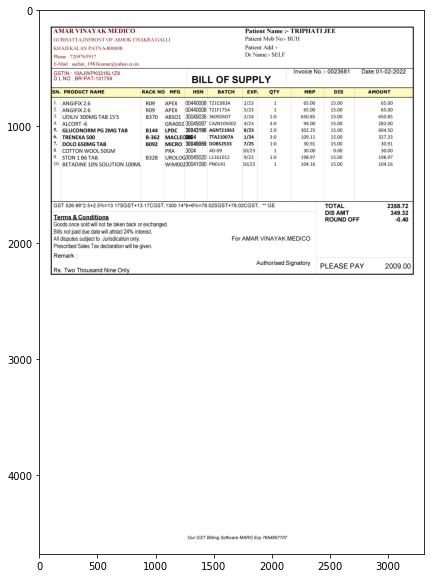


 {'Patient Name': 'TRIPHATI JEF', 'Patient Mobile Number': [7209765917], 'Patient Address': '', 'Date': '01-02-2022', 'Invoice Number': '-'} 



,SN.,PRODUCT NAME,RACK NO,MFG,HSN,BATCH,EXP,QTY,MRP,DIS,AMOUNT
0,1.,ANGIFIX 2.6,R09,APEX,00440008,T21C083A,2/23,1,65.00,15.00,65.00
1,2.,ANGIFIX 2.6,R09,APEX,00440008,T21F175A,5/23,1,65.00,15.00,65.00
2,3.,UDILIV 300MG TAB 15'S,B370,ABSO1,30049036,360926D7,2/24,1:0,650.85,15.00,650.85
3,4.,ALCORT -6,BLANK,GRA002,30049087,CAZN105002,4/23,3:0,94.00,15.00,282.00
4,5.,GLUCONORM PG 2MG TAB,B144,LPDC,30043190,AGNT21063,8/23,2:0,302.25,15.00,604.50
5,6.,TRENEXA 500,B-362,MACLEC,0305 4,TTA21007A,1/24,30,109.11,15.00,327.33
6,7.,DOLO 650MG TAB,B092,MICRO,30049069,DOBS2533,7/25,1:0,30.91,15.00,30.91
7,8.,COTTON WMOOL50GM,BLANK,PRA,3004,AD-09,10/23,1,30.00,0.00,30.00
8,9.,STON 1 B6 TAB,B328,UROLOC,30045020,L1161012,9/22,1:0,198.97,15.00,198.97
9,10.,BETADINE 10% SOLUTION 100MI,BLANK,WIMOO,30041090,PN0141,10/23,1,104.16,15.00,104.16



 {'TOTAL': 2358.72, 'DIS AMT': 349.32, 'ROUND OFF': -0.4, 'PLEASE PAY': 2009.0} 


-----------------------------------------------------------------------------------------------------------------------

195-1-1643633355624.png


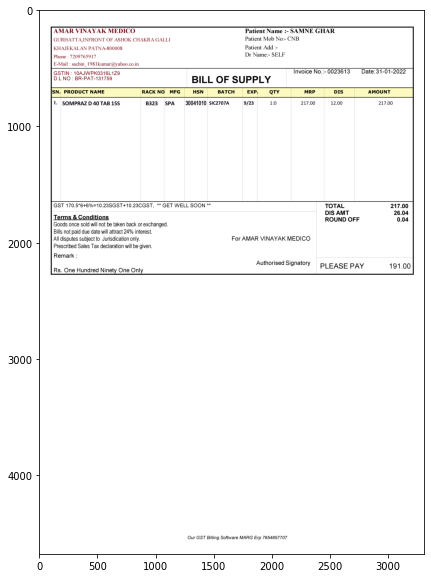


 {'Patient Name': 'SAMNE GHAR', 'Patient Mobile Number': [7209765917], 'Patient Address': '', 'Date': '31-01-2022', 'Invoice Number': '-'} 



,SN.,PRODUCT NAME,RACK NO,MFG,HSN,BATCH,EXP,QTY,MRP,DIS,AMOUNT
0,1.,SOMPRAZ D 40 TAB 15S,B323,SPA,30041010,SIC2707A,9/23,1:0,217.00,12.00,217.00



 {'TOTAL': 217.0, 'DIS AMT': 26.04, 'ROUND OFF': 0.04, 'PLEASE PAY': 191.0} 


-----------------------------------------------------------------------------------------------------------------------

197-1-1644927589030.png


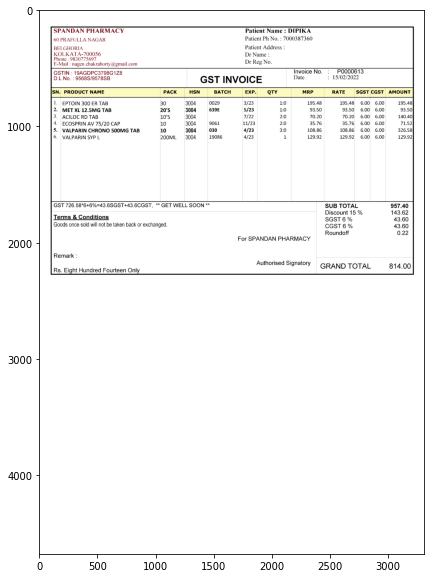


 {'Patient Name': 'DIPIKA', 'Patient Mobile Number': [7000387360, 9830775697], 'Patient Address': '', 'Date': 'VOICE  15/02/2022', 'Invoice Number': 'P0000613'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnt
0,1.,EPTOIN 3OO ER TAB,30,3004,0029,3/23,1:0,195.48,195.48,6.00,6.00,195.48
1,2.,VET XL 12.5VG TAB,20'S,3004,639E,5/23,1:0,93.50,93.50,6.00,6.00,93.50
2,3.,ACILOC RD TAB,10'S,3004,BLANK,7/22,2:0,70.20,70.20,6.00,6.00,140.40
3,4.,ECOSPRIN AV 75/20 CAF,10,3004,9061,11/23,2:0,35.76,35.76,6.00,6.00,71.52
4,5.,VALPARIN CHRONO 5OOMG TAB,10,3004,030,4/23,3:0,108.86,108.86,6.00,6.00,326.58
5,6.,VALPARIN SYP L,200ML,3004,19086,4/23,1,129.92,129.92,6.00,6.00,129.92



 {'SuB tOtAL': 957.4, 'Discount 15 %': 143.62, 'SGST 6 %': 43.6, 'CGST 6 %': 43.6, 'Roundoff': 0.22, 'GRAND TOTAL': 814.0} 


-----------------------------------------------------------------------------------------------------------------------

197-1-1643724678312.png


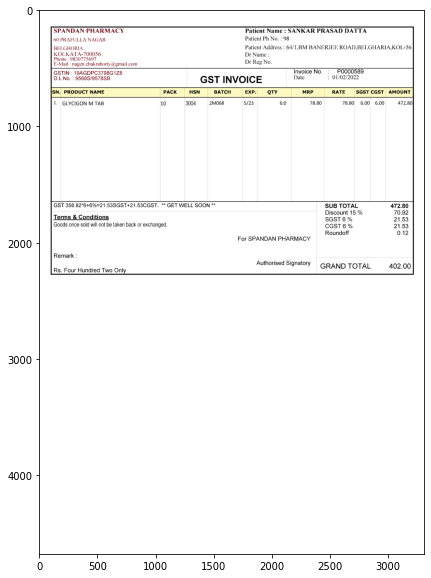


 {'Patient Name': 'SANKAR PRASAD DATTA', 'Patient Mobile Number': [9830775697], 'Patient Address': '64/1.BM BANERJEE ROAD.BELGHARIA.KOL56', 'Date': 'VOICE  01/02/2022', 'Invoice Number': 'P0000589'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,GLYCIGON M TAB,10,3004,2M068,5/23,6:0,78.80,78.80,6.00,6.00,472.80



 {'SuB tOtAL': 472.8, 'Discount 15 %': 70.92, 'SGST 6 %': 21.53, 'CGST 6 %': 21.53, 'Roundoff': 0.12, 'GRAND TOTAL': 402.0} 


-----------------------------------------------------------------------------------------------------------------------

197-3-1646668175860.png


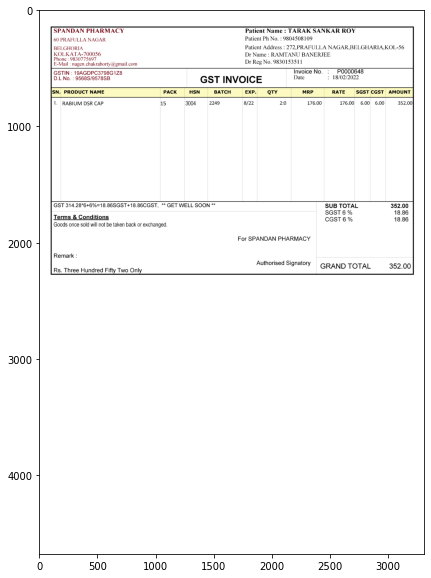


 {'Patient Name': 'TARAK SANKAR ROY', 'Patient Mobile Number': [9804508109, 9830775697, 9830153511], 'Patient Address': '272.PRAFULLA NAGAR.BELGHARLA.KOL56', 'Date': 'VOICE  18/02/2022', 'Invoice Number': 'P0000648'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,RABIUM DSR CAP,15,3004,2249,8/22,2:0,176.00,176.00,6.00,6.00,352.00



 {'SUB TOTAL': 352.0, 'SGST 6 %': 18.86, 'CGST 6 %': 18.86, 'GRAND TOTAL': 352.0} 


-----------------------------------------------------------------------------------------------------------------------

197-2-1646494738336.png


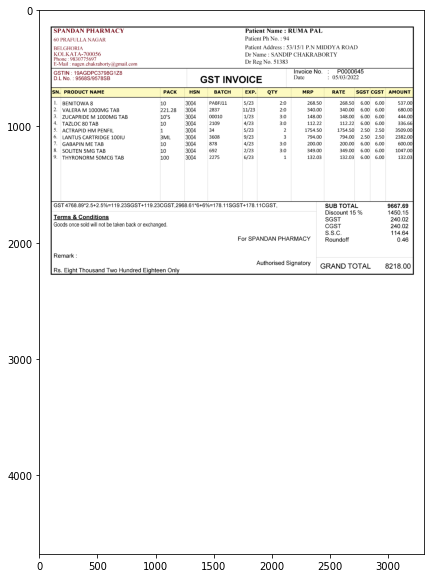


 {'Patient Name': 'RUMA PAL', 'Patient Mobile Number': [9830775697], 'Patient Address': '53/15/1 P.N MIDDYA ROAD', 'Date': 'VOICE  05/03/2022', 'Invoice Number': 'P0000645'} 



,SN.,PRODUCt NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnt
0,1.,BENITOWA 8,10,3004,PABFJ11,5/23,2:0,268.50,268.50,6.00,6.00,537.00
1,2.,VALERA M 1OO0MG TAB,221.28,3004,2837,11/23,2:0,340.00,340.00,6.00,6.00,680.00
2,3.,ZUCAPRIDE M 10OOMG TAB,10'S,3004,00010,1/23,3:0,148.00,148.00,6.00,6.00,444.00
3,4.,TAZLOC 80 TAB,10,3004,2109,4/23,3:0,112.22,112.22,6.00,6.00,336.66
4,5.,ACTRAPID HM PENEIL,1,3004,34,5/23,2,1754.50,1754.50,2.50,2.50,3509.00
5,6.,LANTUS CARTRIDGE 1OOIU,3ML,3004,3608,9/23,3,794.00,794.00,2.50,2.50,2382.00
6,7.,GABAPIN ME TAB,10,3004,878,4/23,3:0,200.00,200.00,6.00,6.00,600.00
7,8.,SOLITEN 5MG TAB,10,3004,692,2/23,3:0,349.00,349.00,6.00,6.00,1047.00
8,9.,THYRONORM 5OMCG TAB,100,3004,2275,6/23,1,132.03,132.03,6.00,6.00,132.03



 {'SUB TOTAL': 9667.69, 'Discount 15 %': 1450.15, 'SGST': 240.02, 'CGST': 240.02, 'S.S.C.': 114.64, 'IARMACY Roundoff': 0.46, 'GRAND TOTAL': 8218.0} 


-----------------------------------------------------------------------------------------------------------------------

197-1-1651066564325.png


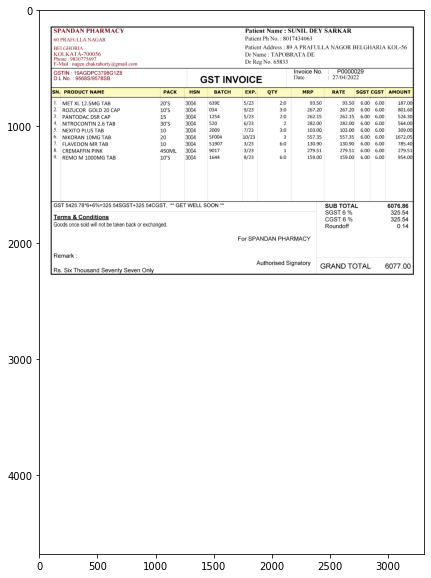


 {'Patient Name': 'SUNL DEY SARKAR', 'Patient Mobile Number': [8017434063, 9830775697], 'Patient Address': '89 A PRAFULLA NAGOR BELGHARIA KOL56', 'Date': 'VOICE  27/04/2022', 'Invoice Number': 'P0000029'} 



,SN.,PRODUCt NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnt
0,1.,MET XL 12.5MG TAB,20'S,3004,639E,5/23,2:0,93.50,93.50,6.00,6.00,187.00
1,2.,ROZUCOR GOLD 20 CAP,10'S,3004,034,9/23,3:0,267.20,267.20,6.00,6.00,801.60
2,3.,PANTODAC DSR CAP,15,3004,1254,5/23,2:0,262.15,262.15,6.00,6.00,524.30
3,4.,NITROCONTIN 2.6 TAB,30'S,3004,520,6/23,2,282.00,282.00,6.00,6.00,564.00
4,5.,NEXITO PLUS TAB,10,3004,2009,7/23,3:0,103.00,103.00,6.00,6.00,309.00
5,6.,NIKORAN 1OMG TAB,20,3004,5 F004,10/23,3,557.35,557.35,6.00,6.00,1672.05
6,7.,ELAVEDON MR TAB,10,3004,51907,3/23,6:0,130.90,130.90,6.00,6.00,785.40
7,8.,CREMAFEIN PINK,450ML,3004,9017,3/23,1,279.51,279.51,6.00,6.00,279.51
8,9.,REMO M 100OMG TAB,10'S,3004,1644,8/23,6:0,159.00,159.00,6.00,6.00,954.00



 {'SUB TOTAL': 6076.86, 'SGST 6 %': 325.54, 'CGST 6 %': 325.54, 'Roundoff': 0.14, 'GRAND TOTAL': 6077.0} 


-----------------------------------------------------------------------------------------------------------------------

201-5-1642867177472.png


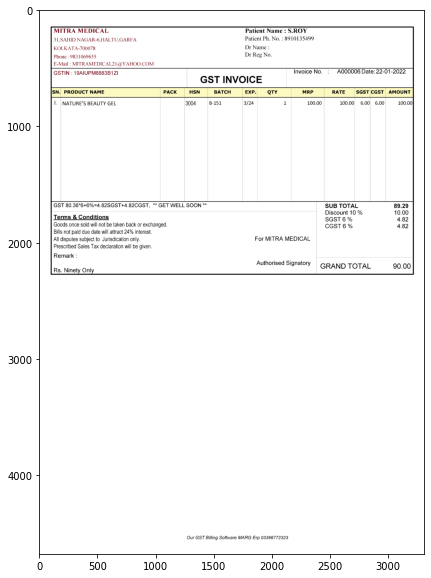


 {'Patient Name': 'S.ROY', 'Patient Mobile Number': [8910135499, 9831069655], 'Patient Address': '', 'Date': '22-01-2022', 'Invoice Number': 'A000006'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnt
0,1.,NATURE'S BEAUTY GEL,BLANK,3004,B-151,3/24,1,100.00,100.00,6.00,6.00,100.00



 {'SUB tOTAL': 89.29, 'Discount 10 %': 10.0, 'SGST 6 %': 4.82, 'CGST 6 %': 4.82, 'GRAND TOTAL': 90.0} 


-----------------------------------------------------------------------------------------------------------------------

201-1-1642952613732.png


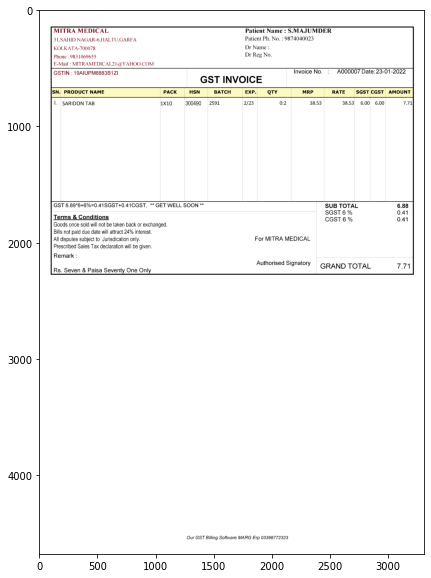


 {'Patient Name': 'S.MAJUMDER', 'Patient Mobile Number': [9874040023, 9831069655], 'Patient Address': '', 'Date': '23-01-2022', 'Invoice Number': 'A000007'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,SARIDON TAB,1X10,300490,2591,2/23,0:2,38.53,38.53,6.00,6.00,7.71



 {'SUB TOTAL': 6.88, 'SGST 6 %': 0.41, 'CGST 6 %': 0.41, 'GRAND TOTAL': 7.71} 


-----------------------------------------------------------------------------------------------------------------------

201-6-1642867246261.png


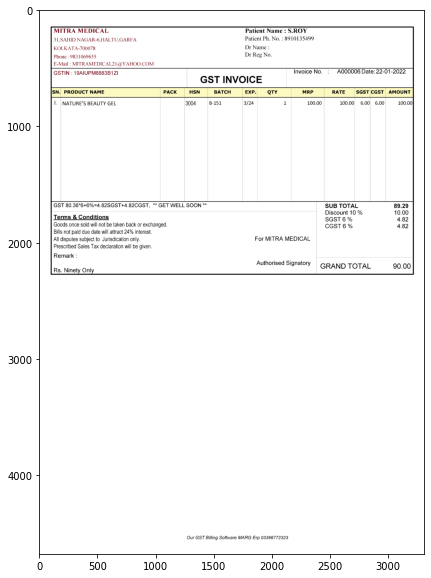


 {'Patient Name': 'S.ROY', 'Patient Mobile Number': [8910135499, 9831069655], 'Patient Address': '', 'Date': '22-01-2022', 'Invoice Number': 'A000006'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnt
0,1.,NATURE'S BEAUTY GEL,BLANK,3004,B-151,3/24,1,100.00,100.00,6.00,6.00,100.00



 {'SUB tOTAL': 89.29, 'Discount 10 %': 10.0, 'SGST 6 %': 4.82, 'CGST 6 %': 4.82, 'GRAND TOTAL': 90.0} 


-----------------------------------------------------------------------------------------------------------------------

202-1-1644583044787.png


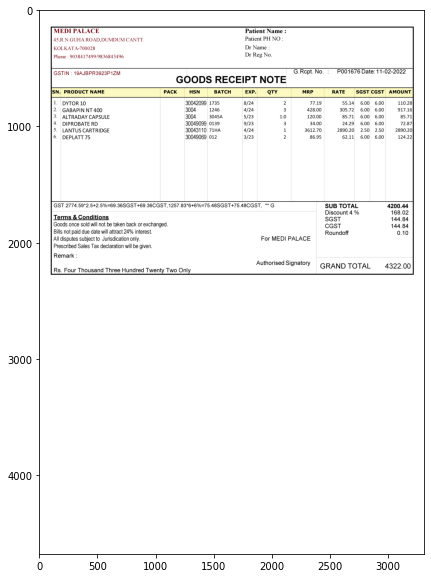


 {'Patient Name': '', 'Patient Mobile Number': [], 'Patient Address': '', 'Date': '11-02-2022', 'Invoice Number': 'P001676'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,DYTOR 10,BLANK,30042099,1735,8/24,2,77.19,55.14,6.00,6.00,110.28
1,2.,GABAPIN NT 400,BLANK,3004,1246,4/24,3,428.00,305.72,6.00,6.00,917.16
2,3.,ALTRADAY CAPSULE,BLANK,3004,3045A,5/23,1:0,120.00,85.71,6.00,6.00,85.71
3,4.,DIPROBATE RD,BLANK,30049099,0139,9/23,3,34.00,24.29,6.00,6.00,72.87
4,5.,LANTUS CARTRIDGE,BLANK,30043110,71HA,4/24,1,3612.70,2890.20,2.50,2.50,2890.20
5,6.,DEPLATT 75,BLANK,30049069,012,3/23,2,86.95,62.11,6.00,6.00,124.22



 {'SUB TOtAL': 4200.44, 'Discount 4 %': 168.02, 'SGST': 144.84, 'CGST': 144.84, 'Roundoff': 0.1, 'GRAND TOTAL': 4322.0} 


-----------------------------------------------------------------------------------------------------------------------

202-3-1642824827732.png


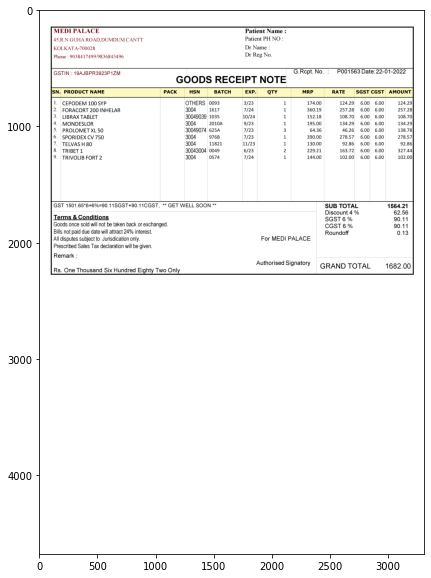


 {'Patient Name': '', 'Patient Mobile Number': [], 'Patient Address': '', 'Date': '22-01-2022', 'Invoice Number': 'P001563'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,CEPODEM 100 SYP,BLANK,OTHERS,0093,3/23,1,174.00,124.29,6.00,6.00,124.29
1,2.,FORACORT 200INHELAR,BLANK,3004,1617,7/24,1,360.19,257.28,6.00,6.00,257.28
2,3.,LIBRAXTABLET,BLANK,30049039,1035,10/24,1,152.18,108.70,6.00,6.00,108.70
3,4.,MONDESLOR,BLANK,3004,2010A,9/23,1,195.00,134.29,6.00,6.00,134.29
4,5.,PROLOMET XL 50,BLANK,30049074,625A,7/23,3,64.36,46.26,6.00,6.00,138.78
5,6.,SPORIDEX CV 750,BLANK,3004,976B,7/23,1,390.00,278.57,6.00,6.00,278.57
6,7.,TELVAS H 80,BLANK,3004,11821,11/23,1,130.00,92.86,6.00,6.00,92.86
7,8.,TRIBET 1,BLANK,30043004,0049,6/23,2,229.21,163.72,6.00,6.00,327.44
8,9.,TRIVOLIB FORT 2,BLANK,3004,0574,7/24,1,144.00,102.00,6.00,6.00,102.00



 {'SuB tOtAL': 1564.21, 'Discount 4 %': 62.56, 'SGST 6 %': 90.11, 'CGST 6 %': 90.11, 'Roundoff': 0.13, 'GRAND TOTAL': 1682.0} 


-----------------------------------------------------------------------------------------------------------------------

202-1-1644211038203.png


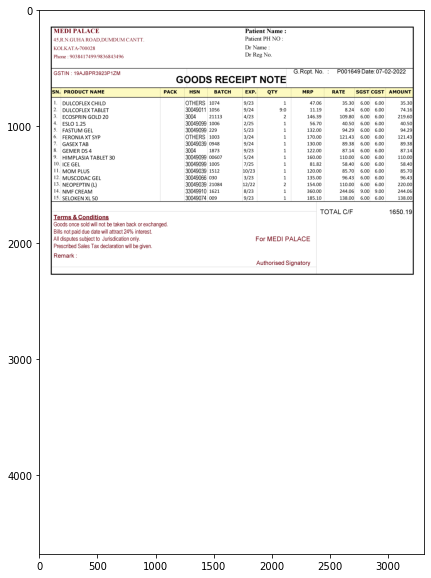


 {'Patient Name': '', 'Patient Mobile Number': [], 'Patient Address': '', 'Date': '07-02-2022', 'Invoice Number': 'P001649'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,DULCOELEX CHILD,BLANK,OTHERS,1074,9/23,1,47.06,35.30,6.00,6.00,35.30
1,2.,DULCOELEX TABLET,BLANK,30049011,1056,9/24,9:0,11.19,8.24,6.00,6.00,74.16
2,3.,ECOSPRIN GOLD 20,BLANK,3004,21113,4/23,2,146.39,109.80,6.00,6.00,219.60
3,4.,ESLO 1.25,BLANK,30049099,1006,2/25,1,56.70,40.50,6.00,6.00,40.50
4,5.,FASTUM GEL,BLANK,30049099,229,5/23,1,132.00,94.29,6.00,6.00,94.29
5,6.,FERONIA XT SYP,BLANK,OTHERS,1003,3/24,1,170.00,121.43,6.00,6.00,121.43
6,7.,GASEX TAB,BLANK,30049039,0948,9/24,1,130.00,89.38,6.00,6.00,89.38
7,8.,GEMER DS 4,BLANK,3004,1873,9/23,1,122.00,87.14,6.00,6.00,87.14
8,9.,HIMPLASIATABLET 30,BLANK,30049099,00607,5/24,1,160.00,110.00,6.00,6.00,110.00
9,10.,ICE GEL,BLANK,30049099,1005,7/25,1,81.82,58.40,6.00,6.00,58.40



 {'TOTAL C/E': 1650.19} 


-----------------------------------------------------------------------------------------------------------------------

202-1-1646656104261.png


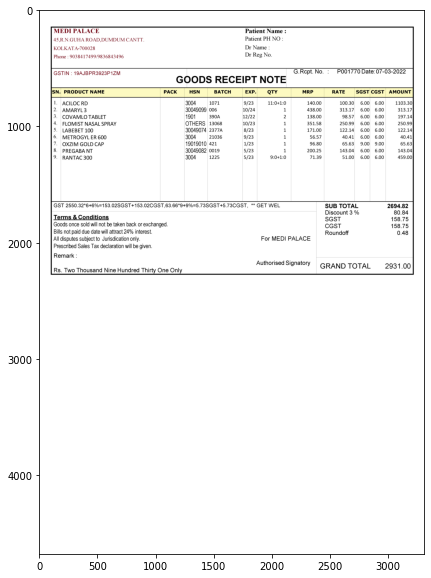


 {'Patient Name': '', 'Patient Mobile Number': [], 'Patient Address': '', 'Date': '07-03-2022', 'Invoice Number': 'P001770'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,ACILOC RD,BLANK,3004,1071,9/23,11:0+1:0,140.00,100.30,6.00,6.00,1103.30
1,2.,AMARYL 3,BLANK,30049099,006,10/24,1,438.00,313.17,6.00,6.00,313.17
2,3.,COVAMLO TABLET,BLANK,1901,390A,12/22,2,138.00,98.57,6.00,6.00,197.14
3,4.,FLOMIST NASAL SPRAY,BLANK,OTHERS,13068,10/23,1,351.58,250.99,6.00,6.00,250.99
4,5.,LABEBET 100,BLANK,30049074,2377A,8/23,1,171.00,122.14,6.00,6.00,122.14
5,6.,METROGYL ER 600,BLANK,3004,21036,9/23,1,56.57,40.41,6.00,6.00,40.41
6,7.,OXZIM GOLD CAP,BLANK,19019010,421,1/23,1,96.80,65.63,9.00,9.00,65.63
7,8.,PREGABA NT,BLANK,30049082,0019,5/23,1,200.25,143.04,6.00,6.00,143.04
8,9.,RANTAC 300,BLANK,3004,1225,5/23,9:0+1:0,71.39,51.00,6.00,6.00,459.00



 {'SUB tOtAL': 2694.82, 'Discount 3 %': 80.84, 'SGST': 158.75, 'CGST': 158.75, 'Roundoff': 0.48, 'GRAND TOTAL': 2931.0} 


-----------------------------------------------------------------------------------------------------------------------

202-1-1650168457004.png


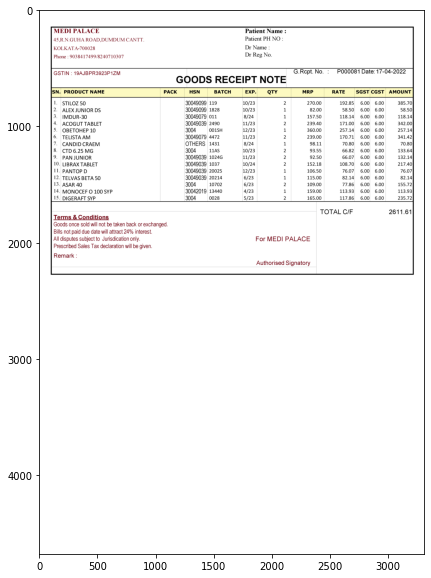


 {'Patient Name': '', 'Patient Mobile Number': [], 'Patient Address': '', 'Date': '17-04-2022', 'Invoice Number': 'P000081'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,STILOZ 50,BLANK,30049099,119,10/23,2,270.00,192.85,6.00,6.00,385.70
1,2.,ALEX JUNIOR DS,BLANK,30049099,1828,10/23,1,82.00,58.50,6.00,6.00,58.50
2,3.,IMDUR-30,BLANK,30049079,011,8/24,1,157.50,118.14,6.00,6.00,118.14
3,4.,ACOGUT TABLET,BLANK,30049039,2490,11/23,2,239.40,171.00,6.00,6.00,342.00
4,5.,OBETOHEP 10,BLANK,3004,001SH,12/23,1,360.00,257.14,6.00,6.00,257.14
5,6.,TELISTA AM,BLANK,30049079,4472,11/23,2,239.00,170.71,6.00,6.00,341.42
6,7.,CANDID CRAEM,BLANK,OTHERS,1431,8/24,1,98.11,70.80,6.00,6.00,70.80
7,8.,CTD 6.25 MG,BLANK,3004,11AS,10/23,2,93.55,66.82,6.00,6.00,133.64
8,9.,PAN JUNIOR,BLANK,30049039,1024G,11/23,2,92.50,66.07,6.00,6.00,132.14
9,10.,LIBRAXTABLET,BLANK,30049039,1037,10/24,2,152.18,108.70,6.00,6.00,217.40



 {'TOTAL C/E': 2611.61} 


-----------------------------------------------------------------------------------------------------------------------

203-4-1647525418395.png


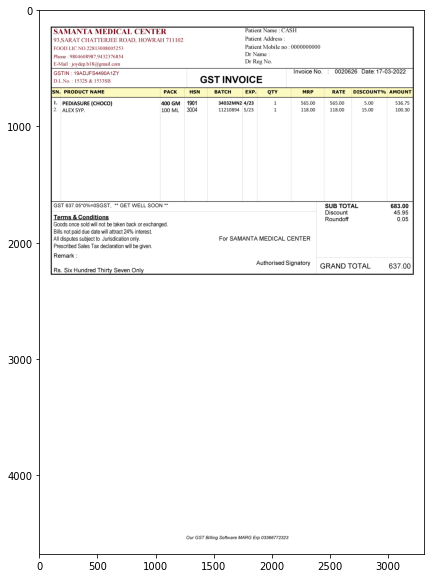


 {'Patient Name': 'CASH', 'Patient Mobile Number': [0, 9804608987, 9432376854], 'Patient Address': '', 'Date': '17-03-2022', 'Invoice Number': '0020626'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,DISCOUNT%,AMOUNT
0,1.,PEDIASURE (CHOCO),400 GM,1901,34032MN2,4/23,1,565.00,565.00,5.00,536.75
1,2.,ALEX SYP.,100 ML,3004,11210894,5/23,1,118.00,118.00,15.00,100.30



 {'SUB TOTAL': 683.0, 'Discount': 45.95, 'Roundoff': 0.05, 'GRAND TOTAL': 637.0} 


-----------------------------------------------------------------------------------------------------------------------

203-21-1647532988440.png


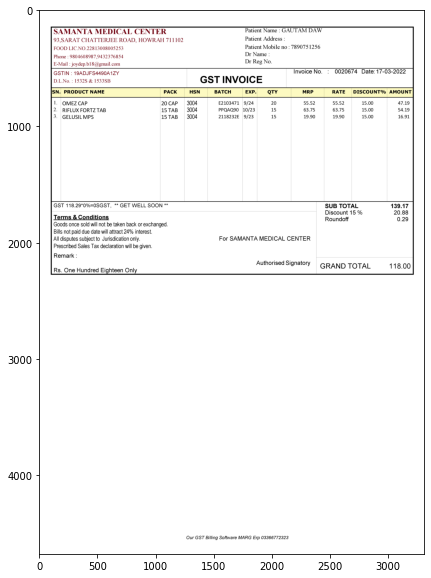


 {'Patient Name': 'GAUTAM DAW', 'Patient Mobile Number': [7890751256, 9804608987, 9432376854], 'Patient Address': '', 'Date': '17-03-2022', 'Invoice Number': '0020674'} 



,SN.,PRODUCt NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,DISCOUNT%,AMOUNT
0,1.,OMEZ CAP,20 CAP,3004,E2103471,9/24,20,55.52,55.52,15.00,47.19
1,2.,RIELUX EORTZ TAB,15 TAB,3004,PPQAQ90,10/23,15,63.75,63.75,15.00,54.19
2,3.,GELUSILMPS,15 TAB,3004,2118232E,9/23,15,19.90,19.90,15.00,16.91



 {'SUB TOTAL': 139.17, 'Discount 15 %': 20.88, 'Roundoff': 0.29, 'GRAND TOTAL': 118.0} 


-----------------------------------------------------------------------------------------------------------------------

203-3-1647697399912.png


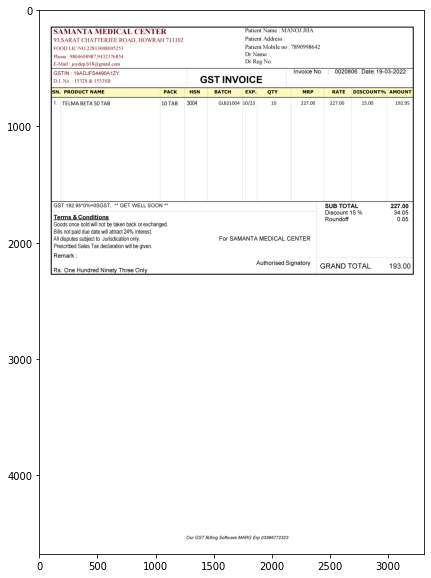


 {'Patient Name': 'MANOJ JHA', 'Patient Mobile Number': [7890998642, 9804608987, 9432376854], 'Patient Address': '', 'Date': '19-03-2022', 'Invoice Number': '0020806'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,DISCOUNT%,AMOUNT
0,1.,TELMA BETA 50 TAB,10 TAB,3004,GLB21004,10/23,10,227.00,227.00,15.00,192.95



 {'SUB TOTAL': 227.0, 'Discount 15 %': 34.05, 'Roundoff': 0.05, 'GRAND TOTAL': 193.0} 


-----------------------------------------------------------------------------------------------------------------------

203-5-1649399985377.png


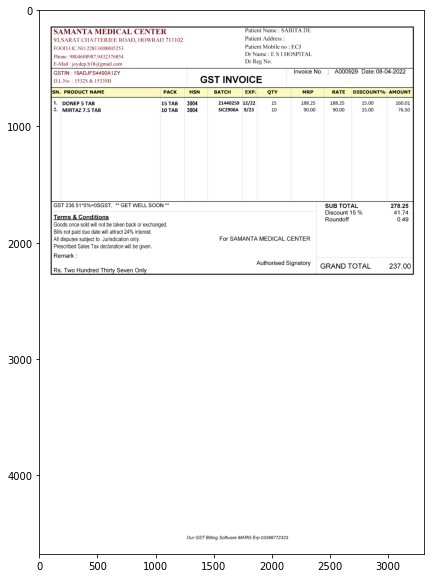


 {'Patient Name': 'SABITA DE', 'Patient Mobile Number': [9804608987, 9432376854], 'Patient Address': '', 'Date': '08-04-2022', 'Invoice Number': 'A000929'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,DISCOUNT%,AMOUnT
0,1.,DONEP 5 TAB,15 TAB,3004,21440259,12/22,15,188.25,188.25,15.00,160.01
1,2.,MIRTAZ 7.5 TAB,10 TAB,3004,SIC2906A,9/23,10,90.00,90.00,15.00,76.50



 {'SUB tOtAL': 278.25, 'Discount 15 %': 41.74, 'Roundoff': 0.49, 'GRAND TOTAL': 237.0} 


-----------------------------------------------------------------------------------------------------------------------

203-1-1649651490707.png


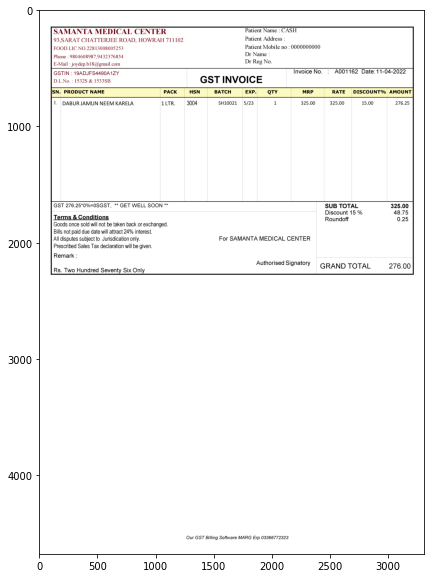


 {'Patient Name': 'CASH', 'Patient Mobile Number': [0, 9804608987, 9432376854], 'Patient Address': '', 'Date': '11-04-2022', 'Invoice Number': 'A001162'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,DISCOUNT%,AMOUNT
0,1.,DABUR JAMUN NEEM KARELA,1 LTR.,3004,SH10021,5/23,1,325.00,325.00,15.00,276.25



 {'SUB TOTAL': 325.0, 'Discount 15 %': 48.75, 'Roundoff': 0.25, 'GRAND TOTAL': 276.0} 


-----------------------------------------------------------------------------------------------------------------------

207-1-1644042778514.png


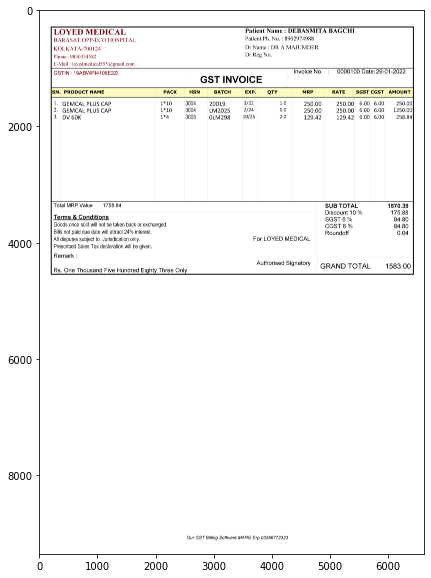


 {'Patient Name': 'DEBASMTA BAGCHI', 'Patient Mobile Number': [8902974988, 9830334582], 'Patient Address': '', 'Date': '29-01-2022', 'Invoice Number': '0000100'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,GEMCAL PLUS CAP,1*10,3004,20019,3/22,1:0,250.00,250.00,6.00,6.00,250.00
1,2.,GEMCAL PLUS CAP,1*10,3004,LM2025,2/24,5:0,250.00,250.00,6.00,6.00,1250.00
2,3.,DV 60K,1*4,3005,0LM298,10/25,2:0,129.42,129.42,6.00,6.00,258.84



 {'SUB TOTAL': 1570.39, 'Discount 10 %': 175.88, 'SGST 6 %': 84.8, 'CGST 6 %': 84.8, 'Roundoff': 0.04, 'GRAND TOTAL': 1583.0} 


-----------------------------------------------------------------------------------------------------------------------

207-2-1644225983679.png


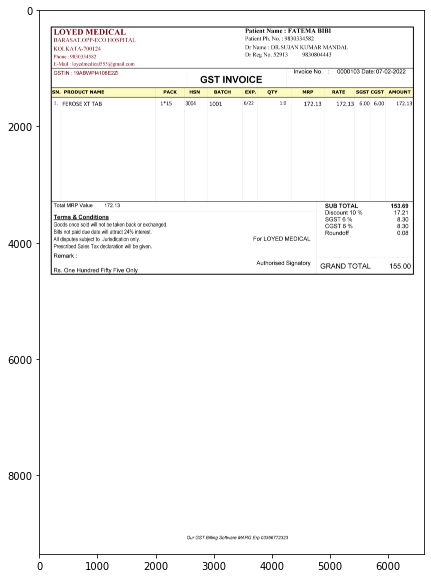


 {'Patient Name': 'FATEMA BIBI', 'Patient Mobile Number': [9830334582, 9830804443, 9830334582], 'Patient Address': '', 'Date': '07-02-2022', 'Invoice Number': '0000103'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,FEROSE XT TAB,1*15,3004,1001,6/22,1:0,172.13,172.13,6.00,6.00,172.13



 {'SUB TOTAL': 153.69, 'Discount 10 %': 17.21, 'SGST 6 %': 8.3, 'CGST 6 %': 8.3, 'Roundoff': 0.08, 'GRAND TOTAL': 155.0} 


-----------------------------------------------------------------------------------------------------------------------

207-1-1644295730789.png


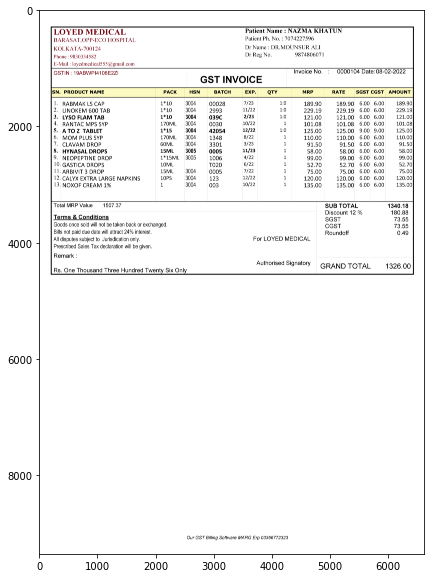


 {'Patient Name': 'NAZMA KHATUN', 'Patient Mobile Number': [7074227596, 9874806071, 9830334582], 'Patient Address': '', 'Date': '08-02-2022', 'Invoice Number': '0000104'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,RABMAK LS CAP,1*10,3004,00028,7/23,1:0,189.90,189.90,6.00,6.00,189.90
1,2.,LINOKEM 6O0 TAB,1*10,3004,2993,11/22,1:0,229.19,229.19,6.00,6.00,229.19
2,3.,LYSO FLAM TAB,1*10,3004,039C,2/23,1:0,121.00,121.00,6.00,6.00,121.00
3,4.,RANTAC MPS SYP,170ML,3004,0030,10/22,1,101.08,101.08,6.00,6.00,101.08
4,5.,A TO Z TABLET,1*15,3004,42054,12/22,1:0,125.00,125.00,9.00,9.00,125.00
5,6.,MOM PLUS SYP,170ML,3004,1348,8/22,1,110.00,110.00,6.00,6.00,110.00
6,7.,CLAVAM DROP,60ML,3004,3301,3/23,1,91.50,91.50,6.00,6.00,91.50
7,8.,HYNASAL DROPS,15ML,3005,0005,11/23,1,58.00,58.00,6.00,6.00,58.00
8,9.,NEOPEPTINE DROP,1*15ML,3005,1006,4/22,1,99.00,99.00,6.00,6.00,99.00
9,10.,GASTICA DROPS,10ML,BLANK,T020,6/22,1,52.70,52.70,6.00,6.00,52.70



 {'SuB totAL': 1340.18, 'Discount 12 %': 180.88, 'SGST': 73.55, 'CGST': 73.55, 'Roundoff': 0.49, 'GRAND TOTAL': 1326.0} 


-----------------------------------------------------------------------------------------------------------------------

207-1-1644568643012.png


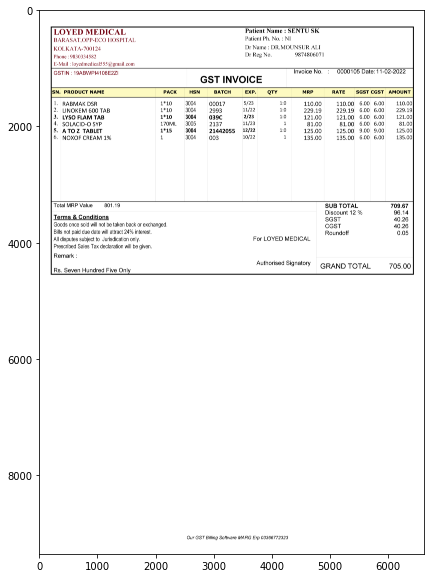


 {'Patient Name': 'SENTU SK', 'Patient Mobile Number': [9874806071, 9830334582], 'Patient Address': '', 'Date': '11-02-2022', 'Invoice Number': '0000105'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,RABMAK DSR,1*10,3004,00017,5/23,1:0,110.00,110.00,6.00,6.00,110.00
1,2.,LINOKEM 6OO TAB,1*10,3004,2993,11/22,1:0,229.19,229.19,6.00,6.00,229.19
2,3.,LYSO FLAM TAB,1*10,3004,039C,2/23,1:0,121.00,121.00,6.00,6.00,121.00
3,4.,SOLACID-O SYP,170ML,3005,2137,11/23,1,81.00,81.00,6.00,6.00,81.00
4,5.,A TO Z TABLET,1*15,3004,21442055,12/22,1:0,125.00,125.00,9.00,9.00,125.00
5,6.,NOXOF CREAM 1%,1,3004,003,10/22,1,135.00,135.00,6.00,6.00,135.00



 {'SUB TOTAL': 709.67, 'Discount 12 %': 96.14, 'SGST': 40.26, 'CGST': 40.26, 'Roundoff': 0.05, 'GRAND TOTAL': 705.0} 


-----------------------------------------------------------------------------------------------------------------------

209-1-1643264730290.png


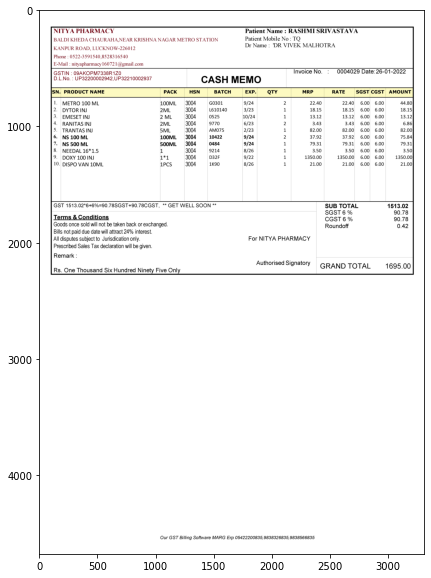


 {'Patient Name': 'RASHM SRIVASTAVA', 'Patient Mobile Number': [8528316540], 'Patient Address': '', 'Date': '26-01-2022', 'Invoice Number': '0004029'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,METRO 100 ML,100ML,3004,G0301,9/24,2,22.40,22.40,6.00,6.00,44.80
1,2.,DYTOR INJ,2ML,3004,L610140,3/23,1,18.15,18.15,6.00,6.00,18.15
2,3.,EMESETINJ,2 ML,3004,0525,10/24,1,13.12,13.12,6.00,6.00,13.12
3,4.,RANITAS INJ,2ML,3004,9770,6/23,2,3.43,3.43,6.00,6.00,6.86
4,5.,TRANTAS INJ,5ML,3004,AM075,2/23,1,82.00,82.00,6.00,6.00,82.00
5,6.,NS 100 ML,100ML,3004,10422,9/24,2,37.92,37.92,6.00,6.00,75.84
6,7.,NS 500 ML,500ML,3004,0484,9/24,1,79.31,79.31,6.00,6.00,79.31
7,8.,NEEDAL 16*1.5,1,3004,9214,8/26,1,3.50,3.50,6.00,6.00,3.50
8,9.,DOXY 100 INJ,1*1,3004,D32F,9/22,1,1350.00,1350.00,6.00,6.00,1350.00
9,10.,DISPO VAN 1OML,1PCS,3004,1K90,8/26,1,21.00,21.00,6.00,6.00,21.00



 {'SUB TOTAL': 1513.02, 'SGST 6 %': 90.78, 'CGST 6 %': 90.78, 'Roundoff': 0.42, 'GRAND TOTAL': 1695.0} 


-----------------------------------------------------------------------------------------------------------------------

209-8-1643272649738.png


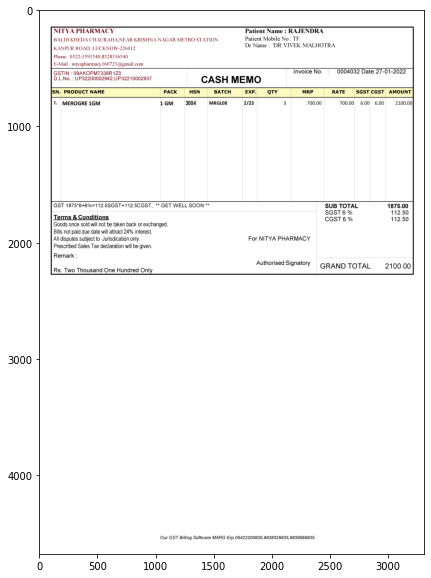


 {'Patient Name': 'RAJENDRA', 'Patient Mobile Number': [8528316540], 'Patient Address': '', 'Date': '27-01-2022', 'Invoice Number': '0004032'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,MEROGRE 1GM,1 GM,3004,MRGL08,2/23,3,700.00,700.00,6.00,6.00,2100.00



 {'SUB TOTAL': 1875.0, 'SGST 6 %': 112.5, 'CGST 6 %': 112.5, 'GRAND TOTAL': 2100.0} 


-----------------------------------------------------------------------------------------------------------------------

209-2-1643272862061.png


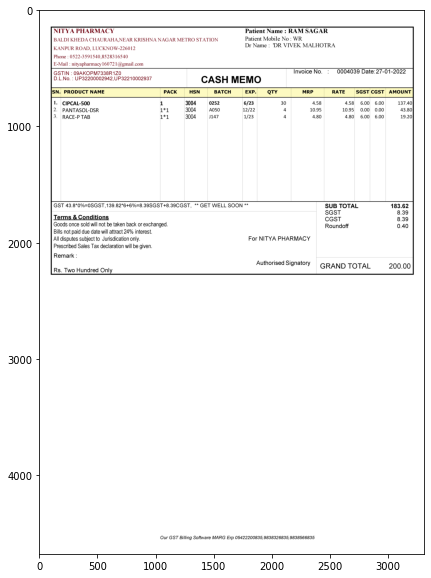


 {'Patient Name': 'RAM SAGAR', 'Patient Mobile Number': [8528316540], 'Patient Address': '', 'Date': '27-01-2022', 'Invoice Number': '0004039'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,CIPCAL-500,1,3004,0252,6/23,30,4.58,4.58,6.00,6.00,137.40
1,2.,PANTASOL-DSR,1*1,3004,A050,12/22,4,10.95,10.95,0.00,0.00,43.80
2,3.,RACE-P TAB,1*1,3004,J147,1/23,4,4.80,4.80,6.00,6.00,19.20



 {'SUB TOTAL': 183.62, 'SGST': 8.39, 'CGST': 8.39, 'Roundoff': 0.4, 'GRAND TOTAL': 200.0} 


-----------------------------------------------------------------------------------------------------------------------

209-1-1643273282925.png


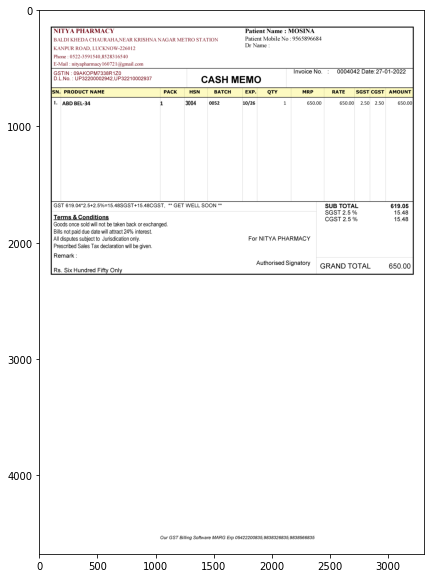


 {'Patient Name': 'MOSINA', 'Patient Mobile Number': [9565896684, 8528316540], 'Patient Address': '', 'Date': '27-01-2022', 'Invoice Number': '0004042'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,ABD BEL-34,1,3004,0052,10/26,1,650.00,650.00,2.50,2.50,650.00



 {'SUB TOTAL': 619.05, 'SGST 2.5 %': 15.48, 'CGST 2.5 %': 15.48, 'GRAND TOTAL': 650.0} 


-----------------------------------------------------------------------------------------------------------------------

211-1-1644318564386.png


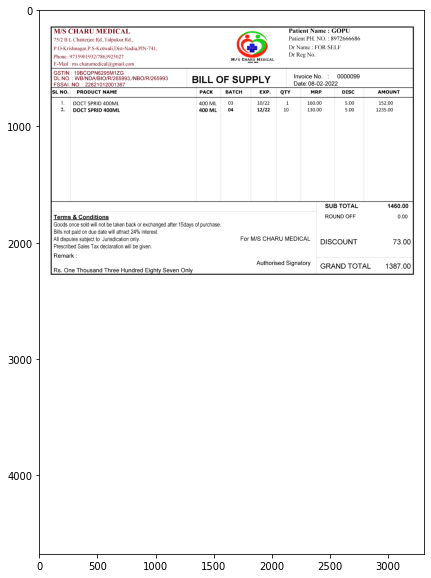


 {'Patient Name': 'GOPU', 'Patient Mobile Number': [8972666686], 'Patient Address': '', 'Date': '08-02-2022', 'Invoice Number': '0000099'} 



,SL NO.,PRODUCT NAME,PACK,BATCH,EXP.,QTY,MRP,DISC,AMOUnt
0,1.,DOCT SPRID 4OOML,400 ML,03,10/22,1,160.00,5.00,152.00
1,2.,DOCT SPRID 4OOML,400 ML,04,12/22,10,130.00,5.00,1235.00



 {'SUB TOTAL': 1460.0, 'ROUND OFF': 0.0, 'DISCOUNT': 73.0, 'GRAND TOTAL': 1387.0} 


-----------------------------------------------------------------------------------------------------------------------

211-3-1648302362227.png


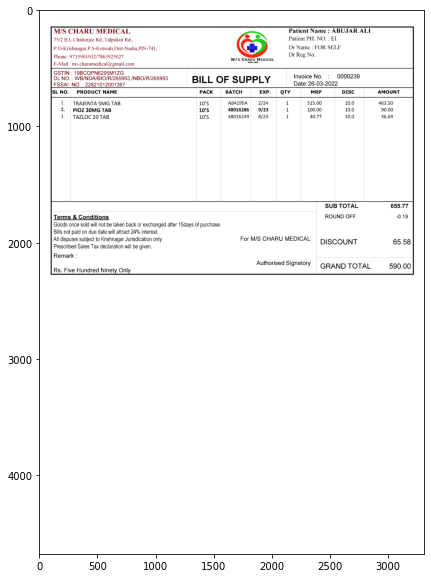


 {'Patient Name': 'ABU.JAR ALJ', 'Patient Mobile Number': [], 'Patient Address': '', 'Date': '26-03-2022', 'Invoice Number': '0000239'} 



,SL NO.,PRODUCT NAME,PACK,BATCH,EXP.,QTY,MRP,DISC,AMOUnt
0,1.,TRAJENTA 5MG TAB,10'S,AB4195A,2/24,1,515.00,10.0,463.50
1,2.,PIOZ 30MG TAB,10'S,48016286,9/23,1,100.00,10.0,90.00
2,3.,TAZLOC 20 TAB,10'S,48016249,8/23,1,40.77,10.0,36.69



 {'SUB TOTAL': 655.77, 'ROUND OFF': -0.19, 'DISCOUNT': 65.58, 'GRAND TOTAL': 590.0} 


-----------------------------------------------------------------------------------------------------------------------

211-2-1648302283351.png


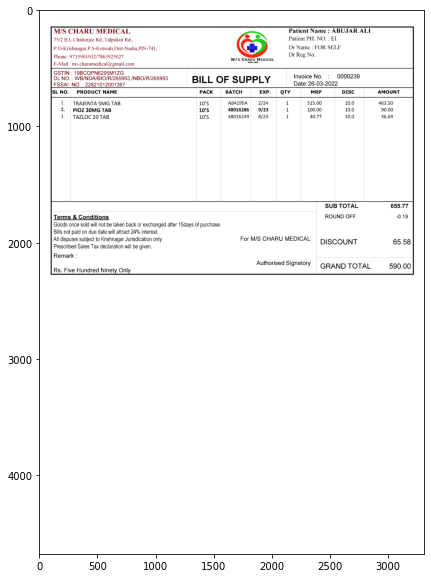


 {'Patient Name': 'ABU.JAR ALJ', 'Patient Mobile Number': [], 'Patient Address': '', 'Date': '26-03-2022', 'Invoice Number': '0000239'} 



,SL NO.,PRODUCT NAME,PACK,BATCH,EXP.,QTY,MRP,DISC,AMOUnt
0,1.,TRAJENTA 5MG TAB,10'S,AB4195A,2/24,1,515.00,10.0,463.50
1,2.,PIOZ 30MG TAB,10'S,48016286,9/23,1,100.00,10.0,90.00
2,3.,TAZLOC 20 TAB,10'S,48016249,8/23,1,40.77,10.0,36.69



 {'SUB TOTAL': 655.77, 'ROUND OFF': -0.19, 'DISCOUNT': 65.58, 'GRAND TOTAL': 590.0} 


-----------------------------------------------------------------------------------------------------------------------

211-19-1651325794757.png


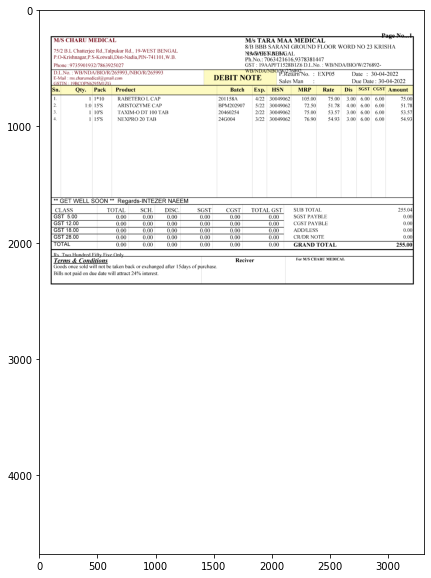


 {'Patient Name': 'TARA MAA MEDICAL', 'Patient Mobile Number': [7063421616, 9378381447], 'Patient Address': '', 'Date': '30-04-2022', 'Invoice Number': 'EXP05'} 



,Sn.,Qty.,Pack,Product,Batch,Exp.,HSN,MRP,Rate,Dis,SGST,CGST,Amount
0,1.,1 1:0,1*10,RABETERO L CAP,201158A,4/22,30049062,105.00,75.00,3.00,6.00,6.00,75.00
1,2.,BLANK,15'S,ARISTOZYME CAP,BPM202907,5/22,30049062,72.50,51.78,4.00,6.00,6.00,51.78
2,3.,1 1,10'S,TAXIM-O DT iOO TAB,20460254,2/22,30049062,75.00,53.57,3.00,6.00,6.00,53.57
3,4.,BLANK,15'S,NEXPRO 20 TAB,24G004,3/22,30049062,76.90,54.93,3.00,6.00,6.00,54.93



 {'SUB TOTAI': 255.04, 'SGST PAYBLE': 0.0, 'CGST PAYBLE': 0.0, 'ADD/LESS': 0.0, 'CR/DR NOTE': 0.0, 'GRAND TOTAL': 255.0} 


-----------------------------------------------------------------------------------------------------------------------

214-33-1650122038867.png


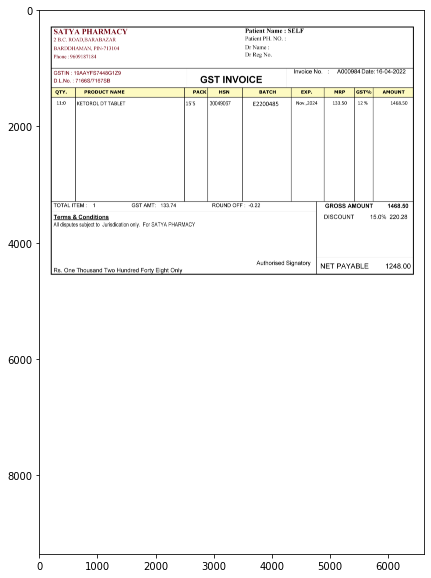


 {'Patient Name': 'SELF', 'Patient Mobile Number': [9609187184], 'Patient Address': '', 'Date': '16-04-2022', 'Invoice Number': 'A000984'} 



,QTY.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,MRP,GST%,AMOUNT
0,11:0,KETOROLDT TABLET,15'S,30049067,E2200485,"Nov.,2024",133.50,12 %,1468.50



 {'DISCOUNT 15.0%': 220.28, 'NET PAYABLE': 1248.0} 


-----------------------------------------------------------------------------------------------------------------------

214-41-1647944493963.png


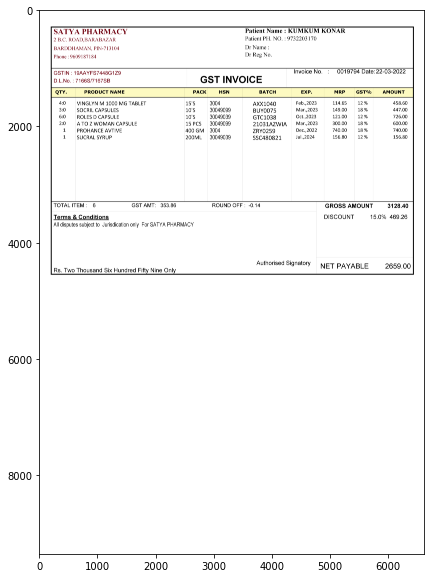


 {'Patient Name': 'KUMKUM KONAR', 'Patient Mobile Number': [9732203170, 9609187184], 'Patient Address': '', 'Date': '22-03-2022', 'Invoice Number': '0019794'} 



,QTY.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,MRP,GST%,AMOUNT
0,4:0,VINGLYN M 1OOO MG TABLET,15'S,3004,AXX1040,"Feb.,2023",114.65,12 %,458.60
1,3:0,SOCRIL CAPSULES,10'S,30049099,BUY0075,Mar..2023,149.00,18 %,447.00
2,6:0,ROLES D CAPSULE,10'S,30049039,GTC1038,Oct..2023,121.00,12 %,726.00
3,2:0,A TO Z WOMAN CAPSULE,15 PCS,30049099,21031AZWIA,Mar..2023,300.00,18 %,600.00
4,1,PROHANCE AVTIVE,400 GM,3004,ZRY0259,Dec..2022,740.00,18 %,740.00
5,1,SUCRAL SYRUP,200ML,30049039,SSC480821,Jul..2024,156.80,12 %,156.80



 {'Jul.,2024 156.80 12 %': 156.8, 'GROSS AMOUNT': 3128.4, 'DISCOUNT 15.0%': 469.26, 'NET PAYABLE': 2659.0} 


-----------------------------------------------------------------------------------------------------------------------

214-53-1646313654888.png


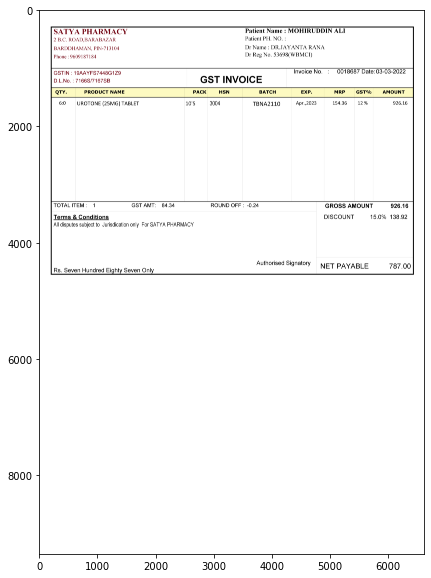


 {'Patient Name': 'MOHIRUDDIN ALI', 'Patient Mobile Number': [9609187184], 'Patient Address': '', 'Date': '03-03-2022', 'Invoice Number': '0018687'} 



,QTY.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,MRP,GST%,AMOUNT
0,6:0,UROTONE (25MG) TABLET,10'S,3004,TBNA2110,Apr.2023,154.36,12 %,926.16



 {'GROSS AMOUNT': 926.16, 'DISCOUNT 15.0%': 138.92, 'NET PAYABLE': 787.0} 


-----------------------------------------------------------------------------------------------------------------------

214-26-1651478692893.png


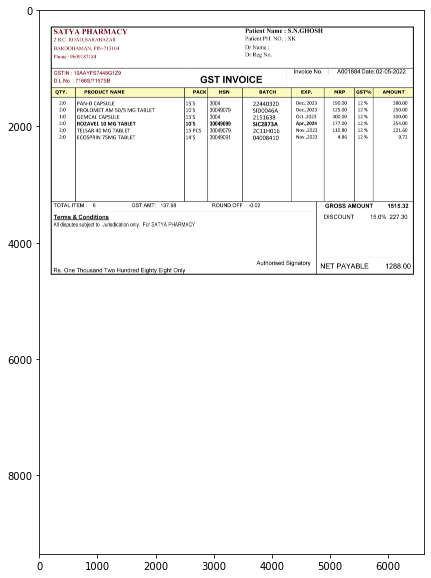


 {'Patient Name': 'S.N.GHOSH', 'Patient Mobile Number': [9609187184], 'Patient Address': '', 'Date': '02-05-2022', 'Invoice Number': 'A001884'} 



,QTY.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,MRP,GST%,AMOUNT
0,2:0,PAN-D CAPSULE,15'S,3004,22440320,"Dec.,2023",190.00,12 %,380.00
1,2:0,PROLOMET AM 5O/5 MG TABLET,10'S,30049079,SID0046A,"Dec.,2023",125.00,12 %,250.00
2,1:0,GEMCAL CAPSULE,15'S,3004,2151638,"Oct.,2023",300.00,12 %,300.00
3,2:0,ROZAVEL 1O VG TABLET,10'S,30049099,SIC2873A,"Apr.,2024",177.00,12 %,354.00
4,2:0,TELSAR 4O MG TABLET,15 PCS,30049079,2C11H016,"Nov.,2023",110.80,12 %,221.60
5,2:0,ECOSPRIN 75MG TABLET,14'S,30049091,04008410,"Nov.,2023",4.86,12 %,9.72



 {'GROSS AMOUNT': 1515.32, 'DISCOUNT 15.0%': 227.3, 'NET PAYABLE': 1288.0} 


-----------------------------------------------------------------------------------------------------------------------

215-26-1647270758290.png


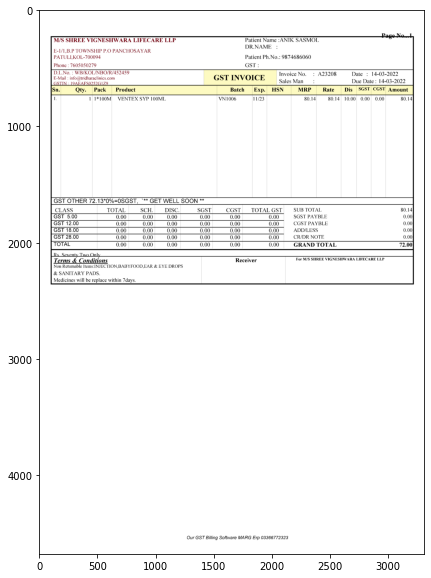


 {'Patient Name': 'ANIK SASMOL', 'Patient Mobile Number': [9874686060, 7605050279], 'Patient Address': '', 'Date': '14-03-2022', 'Invoice Number': 'A23208'} 



,Sn.,Qty.,Pack,Product,Batch,Exp.,HSN,MRP,Rate,Dis,SGST,CGST,Amount
0,1.,1,1*100M,VENTEX SYP 1OOML,VN1006,11/23,BLANK,80.14,80.14,10.00,0.00,0.00,80.14



 {'SUB TOTAL': 80.14, 'SGST PAYBLE': 0.0, 'CGST PAYBLE': 0.0, 'ADD/LESS': 0.0, 'CR/DR NOTE': 0.0, 'GRAND TOTAL': 72.0} 


-----------------------------------------------------------------------------------------------------------------------

215-6-1647839014471.png


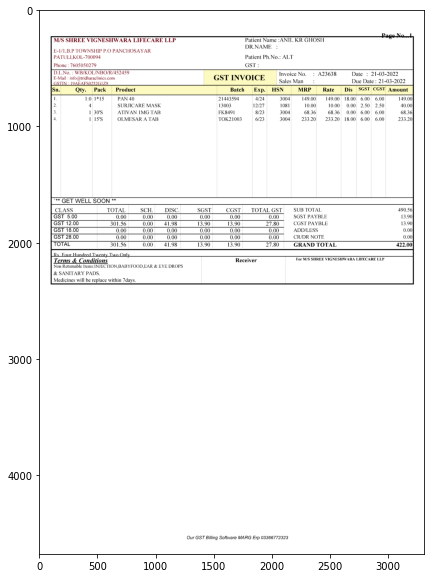


 {'Patient Name': 'ANIL KR GHOSH', 'Patient Mobile Number': [7605050279], 'Patient Address': '', 'Date': '21-03-2022', 'Invoice Number': 'A23638'} 



,Sn.,Qty.,Pack,Product,Batch,Exp.,HSN,MRP,Rate,Dis,SGST,CGST,Amount
0,1.,1:0,1*15,PAN 40,21443594,4/24,3004,149.00,149.00,18.00,6.00,6.00,149.00
1,2.,4,BLANK,SURJICARE MASK,13003,12/27,1081,10.00,10.00,0.00,2.50,2.50,40.00
2,3.,1,30'S,ATIVAn IMGTAB,FK8491,8/23,3004,68.36,68.36,0.00,6.00,6.00,68.36
3,4.,1,15'S,OLMESAR A TAB,TOK21003,6/23,3004,233.20,233.20,18.00,6.00,6.00,233.20



 {'SUB TOTAL': 490.56, 'SGST PAYBLE': 13.9, 'CGST PAYBLE': 13.9, 'ADD/LESS': 0.0, 'CR/DR NOTE': 0.0, 'GRAND TOTAL': 422.0} 


-----------------------------------------------------------------------------------------------------------------------

215-8-1646978070854.png


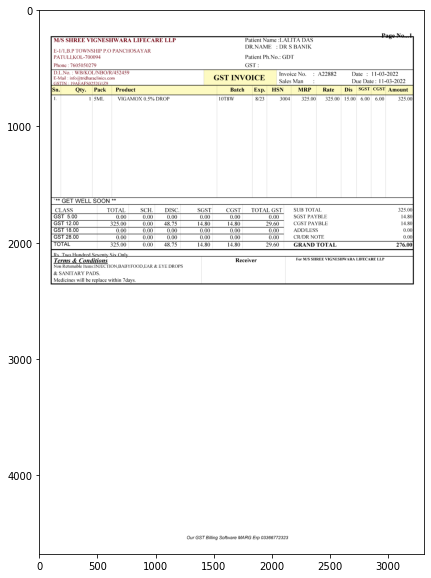


 {'Patient Name': 'LALITA DAS', 'Patient Mobile Number': [7605050279], 'Patient Address': '', 'Date': '11-03-2022', 'Invoice Number': 'A22882'} 



,Sn.,Qty.,Pack,Product,Batch,Exp.,HSN,MRP,Rate,Dis,SGST,CGST,Amount
0,1.,1,5ML,YIGAMOX 0.5% DROP,10T8W,8/23,3004,325.00,325.00,15.00,6.00,6.00,325.00



 {'SUB TOTAL': 325.0, 'SGST PAYBLE': 14.8, 'CGST PAYBLE': 14.8, 'ADD/LESS': 0.0, 'CR/DR NOTE': 0.0, 'GRAND TOTAL': 276.0} 


-----------------------------------------------------------------------------------------------------------------------

215-22-1649070158458.png


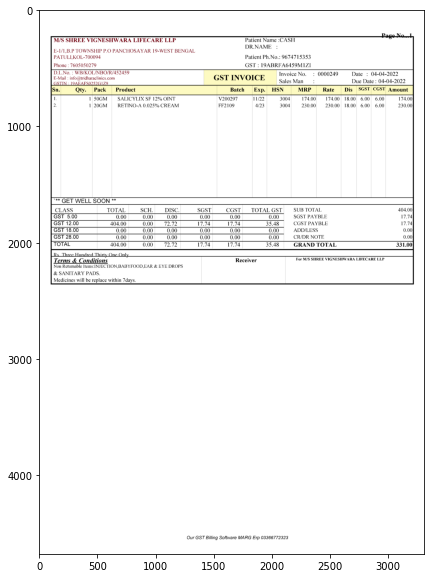


 {'Patient Name': 'CASH', 'Patient Mobile Number': [9674715353, 7605050279], 'Patient Address': '', 'Date': '04-04-2022', 'Invoice Number': '0000249'} 



,Sn.,Qty.,Pack,Product,Batch,Exp.,HSN,MRP,Rate,Dis,SGST,CGST,Amount
0,1.,1,50GM,SALCYLIX SF 12% OINT,V200297,11/22,3004,174.00,174.00,18.00,6.00,6.00,174.00
1,2.,1,20GM,RETINO-A 0.025% CREAM,FF2109,4/23,3004,230.00,230.00,18.00,6.00,6.00,230.00



 {'SUB TOTAL': 404.0, 'SGST PAYBLE': 17.74, 'CGST PAYBLE': 17.74, 'ADD/LESS': 0.0, 'CR/DR NOTE': 0.0, 'GRAND TOTAL': 331.0} 


-----------------------------------------------------------------------------------------------------------------------

216-6-1648197161434.png


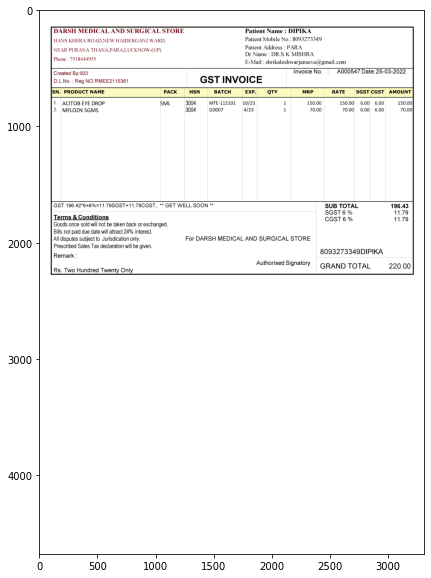


 {'Patient Name': 'DIPIKA', 'Patient Mobile Number': [8093273349, 7518444955], 'Patient Address': 'PARA', 'Date': '25-03-2022', 'Invoice Number': 'A000547'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,ACITOB EYE DROP,5ML,3004,MTE-112101,10/23,1,150.00,150.00,6.00,6.00,150.00
1,2.,MFLOZN 5GMS,BLANK,3004,GD007,4/23,1,70.00,70.00,6.00,6.00,70.00



 {'SUB TOTAL': 196.43, 'SGST 6 %': 11.79, 'CGST 6 %': 11.79, 'GRAND TOTAL': 220.0} 


-----------------------------------------------------------------------------------------------------------------------

216-3-1649771381238.png


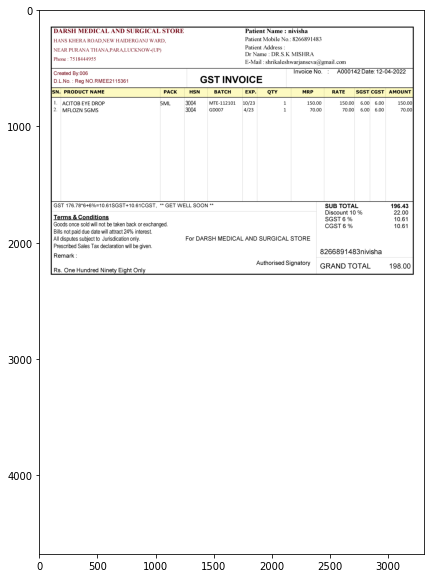


 {'Patient Name': 'nivisha', 'Patient Mobile Number': [8266891483, 7518444955], 'Patient Address': '', 'Date': '12-04-2022', 'Invoice Number': 'A000142'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,ACITOB EYE DROP,5ML,3004,MTE-112101,10/23,1,150.00,150.00,6.00,6.00,150.00
1,2.,MFLOZN 5GMS,BLANK,3004,GD007,4/23,1,70.00,70.00,6.00,6.00,70.00



 {'SUB TOTAL': 196.43, 'Discount 10 %': 22.0, 'SGST 6 %': 10.61, 'CGST 6 %': 10.61, 'GRAND TOTAL': 198.0} 


-----------------------------------------------------------------------------------------------------------------------

216-1-1650690524566.png


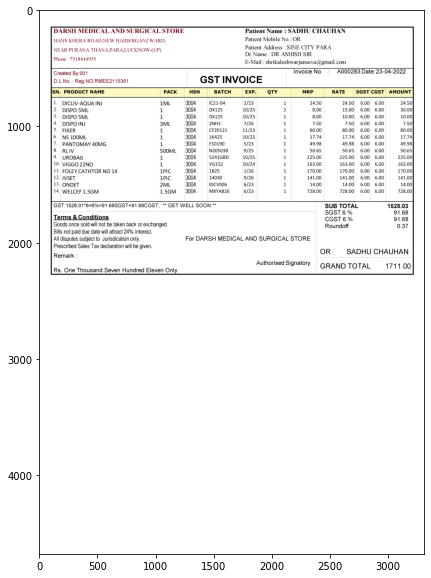


 {'Patient Name': 'SADHU CHAUHAN', 'Patient Mobile Number': [7518444955], 'Patient Address': 'SINE CITY PARA', 'Date': '23-04-2022', 'Invoice Number': 'A000283'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,DICLIV-AQUAINJ,1ML,3004,IC21-04,2/23,1,24.50,24.50,6.00,6.00,24.50
1,2.,DISPO 5ML,1,3004,DX125,10/25,2,8.00,15.00,6.00,6.00,30.00
2,3.,DISPO 5ML,1,3004,DX125,10/25,1,8.00,10.00,6.00,6.00,10.00
3,4.,DISPO INJ,3ML,3004,2NH2,7/26,1,7.50,7.50,6.00,6.00,7.50
4,5.,FIXER,1,3004,CF20121,11/23,1,60.00,80.00,6.00,6.00,80.00
5,6.,NS 100ML,1,3004,1K425,10/23,1,17.74,17.74,6.00,6.00,17.74
6,7.,PANTOMAY 4OMG,1,3004,F10190,5/23,1,49.98,49.98,6.00,6.00,49.98
7,8.,RL IV,500ML,3004,N205038,9/25,1,50.65,50.65,6.00,6.00,50.65
8,9.,UROBAG,1,3004,5241GBD,10/25,1,225.00,225.00,6.00,6.00,225.00
9,10.,VIGGO 22N0,1,3004,VG152,10/24,1,163.00,163.00,6.00,6.00,163.00



 {'SUB TOtAL': 1528.03, 'SGST 6 %': 91.68, 'CGST 6 %': 91.68, 'Roundoff': 0.37, 'GRAND TOTAL': 1711.0} 


-----------------------------------------------------------------------------------------------------------------------

216-1-1644831491198.png


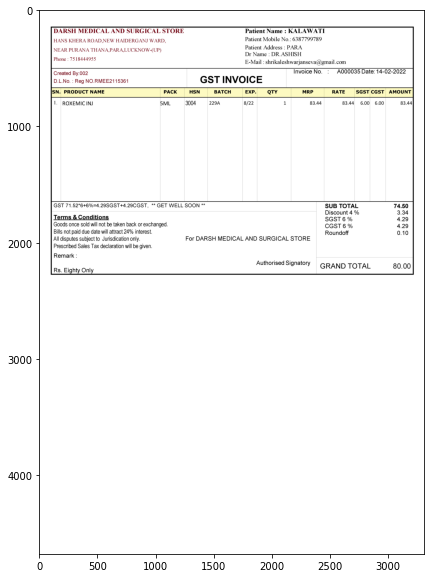


 {'Patient Name': 'KALAWATI', 'Patient Mobile Number': [6387799789, 7518444955], 'Patient Address': 'PARA', 'Date': '14-02-2022', 'Invoice Number': 'A000035'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,ROXEMICINJ,5ML,3004,229A,8/22,1,83.44,83.44,6.00,6.00,83.44



 {'SUB TOTAL': 74.5, 'Discount 4 %': 3.34, 'SGST 6 %': 4.29, 'CGST 6 %': 4.29, 'Roundoff': 0.1, 'GRAND TOTAL': 80.0} 


-----------------------------------------------------------------------------------------------------------------------

218-11-1644619405315.png


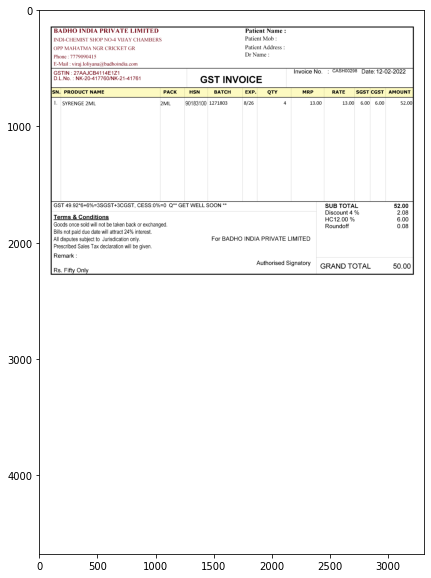


 {'Patient Name': '', 'Patient Mobile Number': [7779090415], 'Patient Address': '', 'Date': '12-02-2022', 'Invoice Number': 'CASH00298'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,SYRENGE 2ML,2ML,90183100,1271803,8/26,4,13.00,13.00,6.00,6.00,52.00



 {'SUB TOTAL': 52.0, 'Discount 4 %': 2.08, 'HC12.00 %': 6.0, 'Roundoff': 0.08, 'GRAND TOTAL': 50.0} 


-----------------------------------------------------------------------------------------------------------------------

218-17-1644636863121.png


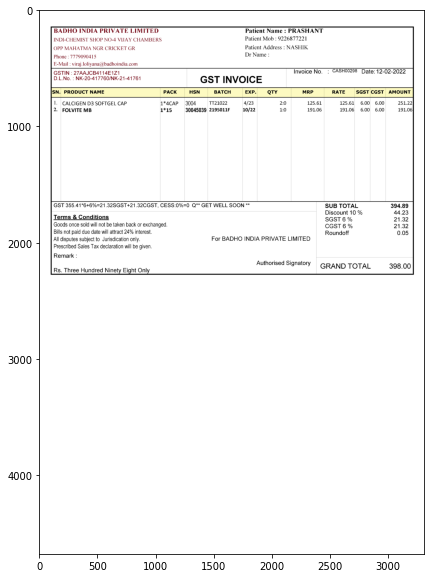


 {'Patient Name': 'PRASHANT', 'Patient Mobile Number': [9226877221, 7779090415], 'Patient Address': 'NASHIK', 'Date': '12-02-2022', 'Invoice Number': 'CASH00298'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,CALCIGEN D3 SOETGEL CAP,1*4CAP,3004,TT21022,4/23,2:0,125.61,125.61,6.00,6.00,251.22
1,2.,FOLVITE MB,1*15,30045039,2195011F,10/22,1:0,191.06,191.06,6.00,6.00,191.06



 {'SuB tOtAL': 394.89, 'Discount 10 %': 44.23, 'SGST 6 %': 21.32, 'CGST 6 %': 21.32, 'Roundoff': 0.05, 'GRAND TOTAL': 398.0} 


-----------------------------------------------------------------------------------------------------------------------

218-1-1648122914641.png


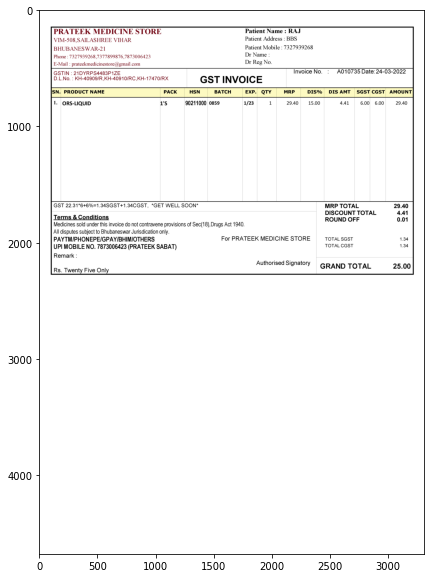


 {'Patient Name': 'RAJ', 'Patient Mobile Number': [7327939268, 7327939268, 7377899876, 7873006423], 'Patient Address': 'BBS', 'Date': '24-03-2022', 'Invoice Number': 'A010735'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DIS%,DIS AMT,SGST,CGST,AMOUNT
0,1.,ORS-LIQUID,1'S,90211000,0859,1/23,1,29.40,15.00,4.41,6.00,6.00,29.40



 {'MRP TOTAL': 29.4, 'DISCOUNT TOTAL': 4.41, 'ROUND OFF': 0.01, 'E STORE TOtAL SGSt': 1.34, 'TOTAL CGSt': 1.34, 'GRAND TOTAL': 25.0} 


-----------------------------------------------------------------------------------------------------------------------

218-1-1644402947548.png


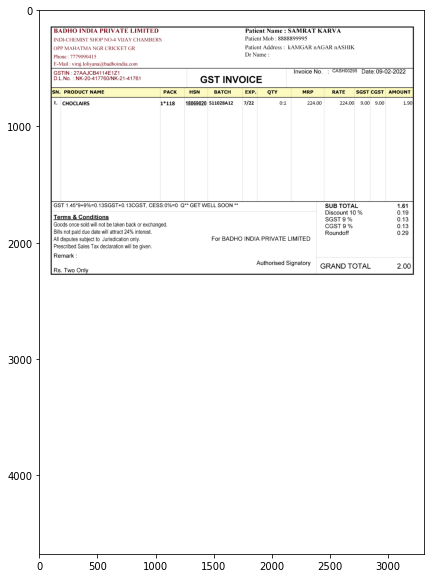


 {'Patient Name': 'SAMRAT KARVA', 'Patient Mobile Number': [8888899995, 7779090415], 'Patient Address': 'kAMGAR nAGAR nASHIK', 'Date': '09-02-2022', 'Invoice Number': 'CASH00295'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,CHOCLAIRS,1*118,18069020,S11028A12,7/22,0:1,224.00,224.00,9.00,9.00,1.90



 {'SuB tOtAL': 1.61, 'Discount 10 %': 0.19, 'SGST 9 %': 0.13, 'CGST 9 %': 0.13, 'Roundoff': 0.29, 'GRAND TOTAL': 2.0} 


-----------------------------------------------------------------------------------------------------------------------

220-10-1644232236231.png


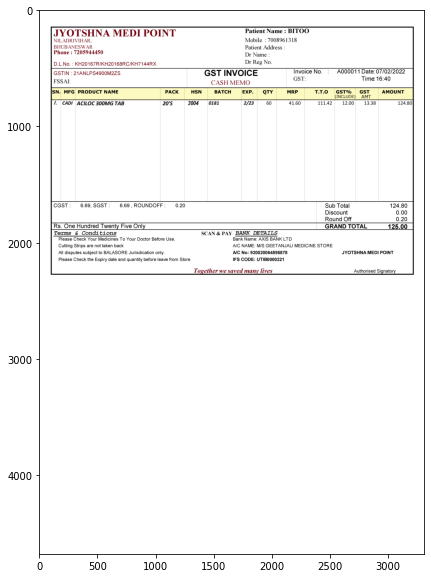


 {'Patient Name': 'BITOO', 'Patient Mobile Number': [7008961318, 7205944450], 'Patient Address': '', 'Date': '07/02/2022', 'Invoice Number': 'A000011'} 



,SN.,MFG,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,t.t.0,GST%,GST,AMOUNT
0,1.,CADI,ACILOC 300MG TAB,20'S,3004,0181,2/23,60,41.60,111.42,12.00,13.38,124.80



 {'Sub Total': 124.8, 'Discount': 0.0, 'Round Off': 0.2, 'GRAND TOTAL': 125.0} 


-----------------------------------------------------------------------------------------------------------------------

220-8-1644641293094.png


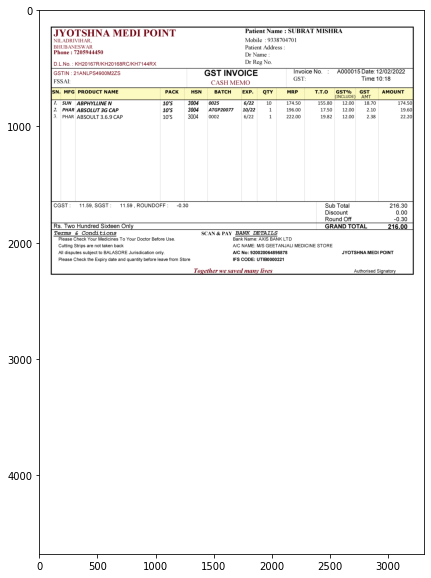


 {'Patient Name': 'SUBRAT MISHRA', 'Patient Mobile Number': [9338704701, 7205944450], 'Patient Address': '', 'Date': '12/02/2022', 'Invoice Number': 'A000015'} 



,SN.,MFG,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,t.t.0,GST%,GST,AMOUNT
0,1.,SUN,ABPHYLLINE N,10'S,3004,0025,6/22,10,174.50,155.80,12.00,18.70,174.50
1,2.,PHAR,ABSOLUT 3G CAP,10'S,3004,ATGP20077,10/22,1,196.00,17.50,12.00,2.10,19.60
2,3.,PHAR,ABSOULt 3.6.9 CAP,10'S,3004,0002,6/22,1,222.00,19.82,12.00,2.38,22.20



 {'Sub Total': 216.3, 'Discount': 0.0, 'Round Off': -0.3, 'GRAND TOTAL': 216.0} 


-----------------------------------------------------------------------------------------------------------------------

220-9-1645083756487.png


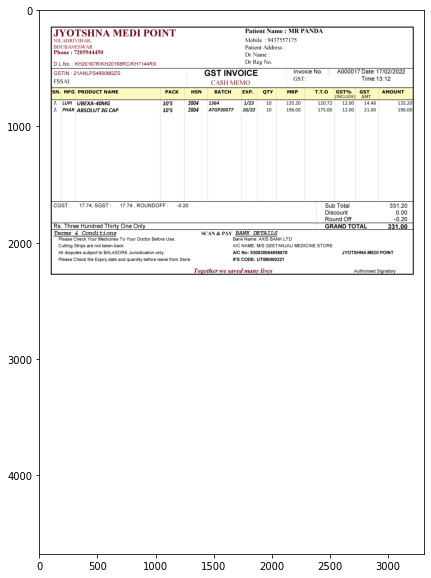


 {'Patient Name': 'MR PANDA', 'Patient Mobile Number': [9437557175, 7205944450], 'Patient Address': '', 'Date': '17/02/2022', 'Invoice Number': 'A000017'} 



,SN.,MFG,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,t.t.0,GST%,GST,AMOUNT
0,1.,LUPI,UBEXA-40MG,10'S,3004,1364,1/23,10,135.20,120.72,12.00,14.48,135.20
1,2.,PHAR,ABSOLUT 3G CAP,10'S,3004,ATGP20077,10/22,10,196.00,175.00,12.00,21.00,196.00



 {'Sub Total': 331.2, 'Discount': 0.0, 'Round Off': -0.2, 'GRAND TOTAL': 331.0} 


-----------------------------------------------------------------------------------------------------------------------

220-10-1645084087367.png


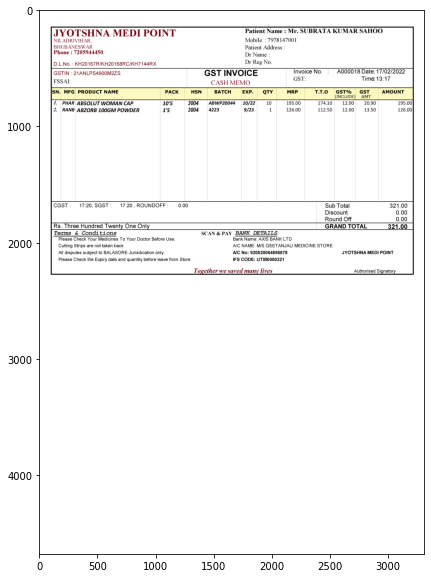


 {'Patient Name': 'Mr. SUBRATA KUMAR SAHOO', 'Patient Mobile Number': [7978147001, 7205944450], 'Patient Address': '', 'Date': '17/02/2022', 'Invoice Number': 'A000018'} 



,SN.,MFG,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,t.t.0,GST%,GST,AMOUNT
0,1.,PHAR,ABSOLUT WOMAN CAP,10'S,3004,ABWP20044,10/22,10,195.00,174.10,12.00,20.90,195.00
1,2.,RANB,ABZORB 100GM POWDER,1'S,3004,4223,9/23,1,126.00,112.50,12.00,13.50,126.00



 {'Sub Total': 321.0, 'Discount': 0.0, 'Round Off': 0.0, 'GRAND TOTAL': 321.0} 


-----------------------------------------------------------------------------------------------------------------------

221-3-1647356597968.png


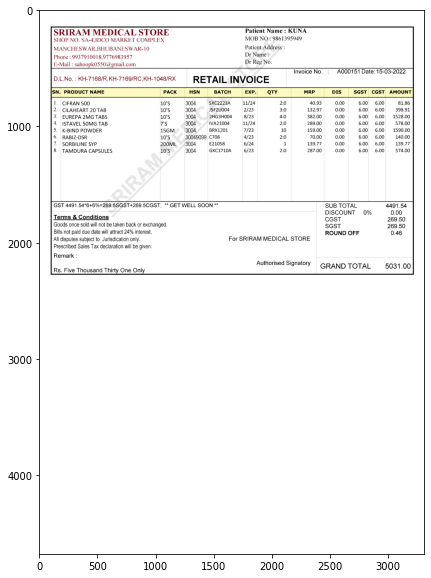


 {'Patient Name': 'KUNA', 'Patient Mobile Number': [9861395949, 9937910018, 9776983957], 'Patient Address': '', 'Date': '15-03-2022', 'Invoice Number': 'A000151'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DIS,SGST,CGST,AMOUnt
0,1.,BLANK,10'S,3004,SXC2223A,11/24,2:0,40.93,0.00,6.00,6.00,81.86
1,2.,CILAHEART 20 TAB,10'S,3004,J5FZU004,2/23,3:0,132.97,0.00,6.00,6.00,398.91
2,3.,EUREPA 2MG TABS,10'S,3004,2HG3H004,8/23,4:0,382.00,0.00,6.00,6.00,1528.00
3,4.,ISTAVEL 5OMG TAB,7'S,3004,IVA21004,11/24,2:0,289.00,0.00,6.00,6.00,578.00
4,5.,K-BIND POWMDER,15GM,3004,BRX1201,7/23,10,159.00,0.00,6.00,6.00,1590.00
5,6.,RABIZ-DSR,10'S,30049099,C708,4/23,2:0,70.00,0.00,6.00,6.00,140.00
6,7.,SORBILINE SYP,200ML,3004,E21058,6/24,1,139.77,0.00,6.00,6.00,139.77
7,8.,TAMDURA CAPSULES,10'S,3004,GKC1710A,6/23,2:0,287.00,0.00,6.00,6.00,574.00



 {'SUB TOTAL': 4491.54, 'CGST': 269.5, 'SGST': 269.5, 'ROUND OFF': 0.46, 'GRAND TOTAL': 5031.0} 


-----------------------------------------------------------------------------------------------------------------------

221-1-1647968257945.png


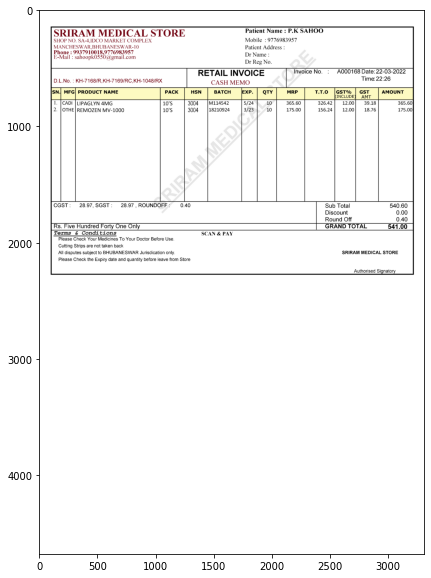


 {'Patient Name': 'P.K SAHOO', 'Patient Mobile Number': [9776983957, 9937910018, 9776983957], 'Patient Address': '', 'Date': '22-03-2022', 'Invoice Number': 'NVOICE'} 



,SN.,MFG,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,t.t.0,GST%,GST,AMOUnT
0,1.,CADI,LIPAGLYN 4MG,10'S,3004,M114542,5/24,10,365.60,326.42,12.00,39.18,365.60
1,2.,OTHE,REMOZEN MV-1OO0,10'S,3004,18210924,3/23,10,175.00,156.24,12.00,18.76,175.00



 {'Sub Total': 540.6, 'Discount': 0.0, 'Round Off': 0.4, 'GRAND TOTAL': 541.0} 


-----------------------------------------------------------------------------------------------------------------------

221-1-1647519228084.png


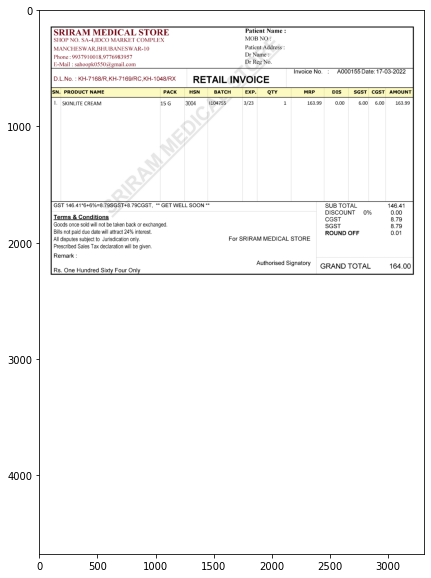


 {'Patient Name': '', 'Patient Mobile Number': [9937910018, 9776983957], 'Patient Address': '', 'Date': '17-03-2022', 'Invoice Number': 'A000155'} 



,SN.,PRODUCt NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DIS,SGST,CGST,AMoUnt
0,1.,BLANK,15 G,3004,1104755,3/23,1,163.99,0.00,6.00,6.00,163.99



 {'SUB TOTAL': 146.41, 'CGST': 8.79, 'SGST': 8.79, 'ROUND OFF': 0.01, 'GRAND TOTAL': 164.0} 


-----------------------------------------------------------------------------------------------------------------------

221-9-1645201152248.png


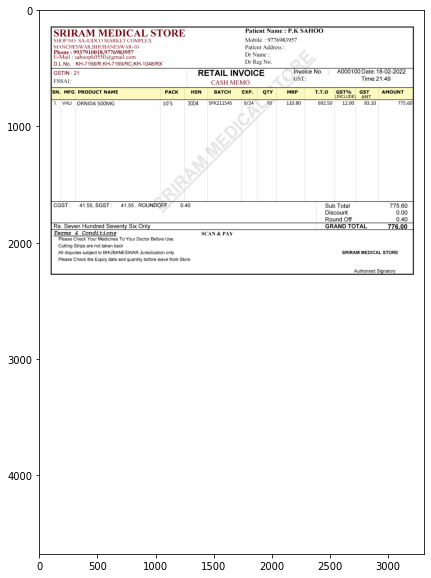


 {'Patient Name': 'P.K SAHOO', 'Patient Mobile Number': [9776983957, 9937910018, 9776983957], 'Patient Address': '', 'Date': '18-02-2022', 'Invoice Number': 'NVOICE'} 



,SN.,MFG,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,t.t.0,GST%,GST,AMOUnt
0,1.,VALI,ORNIDA 500MG,10'S,3004,BLANK,9/24,70,110.80,692.50,12.00,83.10,775.60



 {'Sub Total': 775.6, 'Discount': 0.0, 'Round Off': 0.4, 'GRANID TOTAL': 776.0} 


-----------------------------------------------------------------------------------------------------------------------

221-2-1646751748501.png


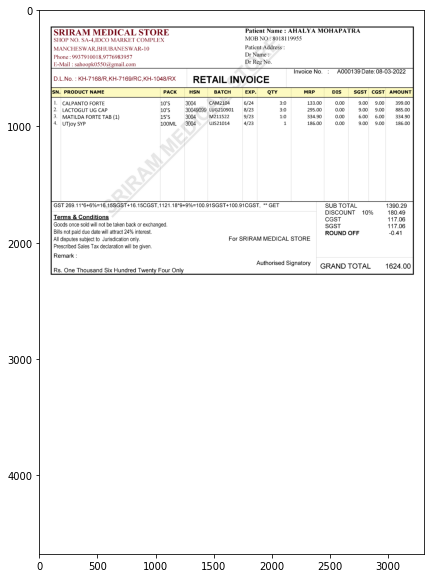


 {'Patient Name': 'AHALYA MOHAPATRA', 'Patient Mobile Number': [8018119955, 9937910018, 9776983957], 'Patient Address': '', 'Date': '08-03-2022', 'Invoice Number': 'A000139'} 



,SN.,PRODUCt NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DIS,SGST,CGST,AMoUnt
0,1.,BLANK,10'S,3004,CAM2104,6/24,3:0,133.00,0.00,9.00,9.00,399.00
1,2.,LACTOGUT UG CAP,10'S,30049099,LUG210901,8/23,3:0,295.00,0.00,9.00,9.00,885.00
2,3.,MATILDA FORTE TAB (1),15'S,3004,M211522,9/23,1:0,334.90,0.00,6.00,6.00,334.90
3,4.,UTjoy SYP,100ML,3004,UJS21014,4/23,1,186.00,0.00,9.00,9.00,186.00



 {'SUB TOTAL': 1390.29, 'CGST': 117.06, 'SGST': 117.06, 'ROUND OFF': -0.41, 'GRAND TOTAL': 1624.0} 


-----------------------------------------------------------------------------------------------------------------------

223-6-1646137338811.png


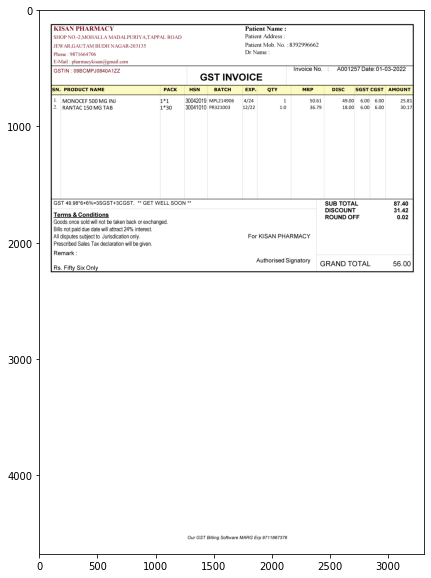


 {'Patient Name': '', 'Patient Mobile Number': [8392996662, 9871664706], 'Patient Address': '', 'Date': '01-03-2022', 'Invoice Number': 'A001257'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DISC,SGST,CGST,AMOUNT
0,1.,MONOCEE 500 MG INJ,1*1,30042019,MPL214906,4/24,1,50.61,49.00,6.00,6.00,25.81
1,2.,RANTAC 150 MG TAB,1*30,30041010,PR321003,12/22,1:0,36.79,18.00,6.00,6.00,30.17



 {'SUB TOTAL': 87.4, 'DISCOUNT': 31.42, 'ROUND OFF': 0.02, 'GRAND TOTAL': 56.0} 


-----------------------------------------------------------------------------------------------------------------------

223-1-1651722210989.png


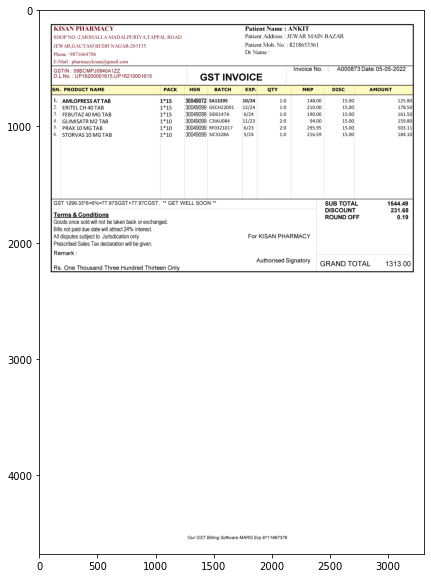


 {'Patient Name': 'ANKIT', 'Patient Mobile Number': [8218653361, 9871664706], 'Patient Address': 'JEWAR MAIN BAZAR', 'Date': '05-05-2022', 'Invoice Number': 'A000873'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DISC,AMOUNT
0,1.,AMLOPRESS AT TAB,1*15,30049072,SA13205,10/24,1:0,148.00,15.00,125.80
1,2.,ERITEL CH 40 TAB,1*15,30049099,GECH22001,12/24,1:0,210.00,15.00,178.50
2,3.,EEBUTAZ 4O MG TAB,1*15,30049099,SID0147A,6/24,1:0,190.00,15.00,161.50
3,4.,GLIMISATR M2 TAB,1*10,30049099,C3IAU084,11/23,2:0,94.00,15.00,159.80
4,5.,PRAX 10 MG TAB,1*10,30049099,RF0321017,6/23,2:0,295.95,15.00,503.11
5,6.,STORVAS 10 MG TAB,1*10,30049099,SIC3328A,5/24,1:0,216.59,15.00,184.10



 {'SUB TOTAL': 1544.49, 'DISCOUNT': 231.68, 'ROUND OFF': 0.19, 'GRAND TOTAL': 1313.0} 


-----------------------------------------------------------------------------------------------------------------------

223-6-1649226572916.png


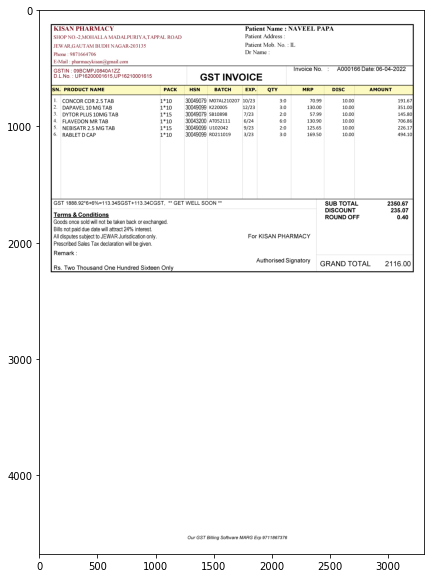


 {'Patient Name': 'NAVEEL PAPA', 'Patient Mobile Number': [9871664706], 'Patient Address': '', 'Date': '06-04-2022', 'Invoice Number': 'A000166'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DISC,AMOUNT
0,1.,CONCOR COR 2.5 TAB,1*10,30049079,M07AL210207,10/23,3:0,70.99,10.00,191.67
1,2.,DAPAVEL 1OMG TAB,1*10,30049099,K220005,12/23,3:0,130.00,10.00,351.00
2,3.,DYTOR PLUS 1OMG TAB,1*15,30049079,SB10898,7/23,2:0,57.99,10.00,145.80
3,4.,FLAVEDON MR TAB,1*10,30043200,AT052111,6/24,6:0,130.90,10.00,706.86
4,5.,NEBISATR 2.5 MG TAB,1*15,30049099,U102042,9/23,2:0,125.65,10.00,226.17
5,6.,RABLET D CAP,1*10,30049099,RD211019,3/23,3:0,169.50,10.00,494.10



 {'SUB TOTAL': 2350.67, 'DISCOUNT': 235.07, 'ROUND OFF': 0.4, 'GRAND TOTAL': 2116.0} 


-----------------------------------------------------------------------------------------------------------------------

226-1-1646035199159.png


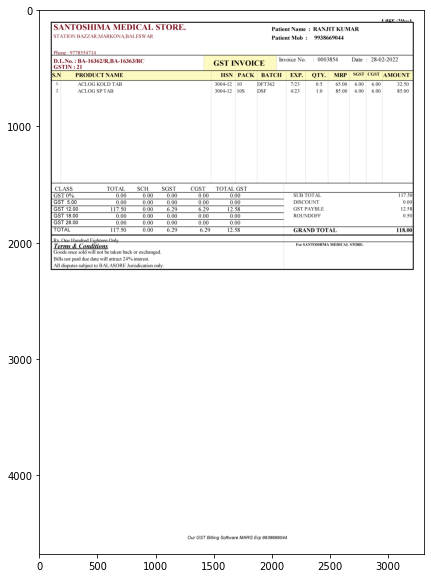


 {'Patient Name': 'RANJT KUMAR', 'Patient Mobile Number': [9938669044, 9778554714], 'Patient Address': '', 'Date': '28-02-2022', 'Invoice Number': '0003854'} 



,2.,ACLOG SP TAB,3004-12,10S,DSF,4/23,1:0,85.00,6.00,6.00,85.00
0,GS,BLANK,0.,00,BLANK,SUB,TOTAL,BLANK,BLANK,BLANK,117.50



 {'GST PAYBLE': 12.58, 'ROUNDOFF': 0.5, 'GRAND TOTAL': 118.0} 


-----------------------------------------------------------------------------------------------------------------------

227-10-1649602705954.png


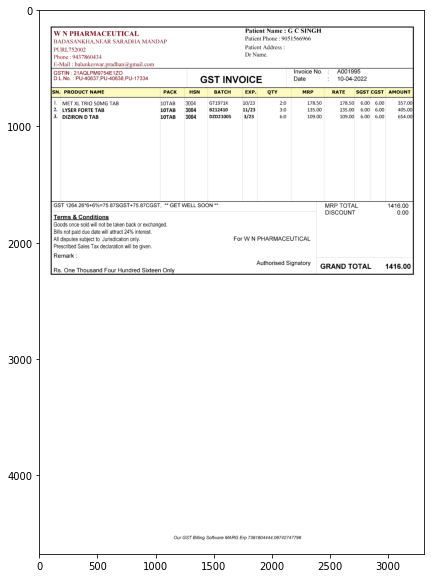


 {'Patient Name': 'G C SINGH', 'Patient Mobile Number': [9051566966, 9437860434], 'Patient Address': '', 'Date': '10-04-2022', 'Invoice Number': 'A001995'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,MET XL TRIO 5OMG TAB,10TAB,3004,GT1971K,10/23,2:0,178.50,178.50,6.00,6.00,357.00
1,2.,LYSER FORTE TAB,10TAB,3004,B212410,11/23,3:0,135.00,135.00,6.00,6.00,405.00
2,3.,DIZIRON D TAB,10TAB,3004,DZD21005,3/23,6:0,109.00,109.00,6.00,6.00,654.00



 {'MRP TOTAL': 1416.0, 'DISCOUNT': 0.0, 'GRAND TOTAL': 1416.0} 


-----------------------------------------------------------------------------------------------------------------------

227-31-1648548586415.png


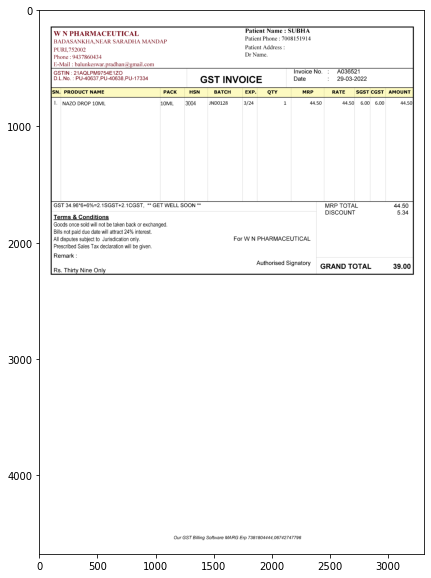


 {'Patient Name': 'SUBHA', 'Patient Mobile Number': [7008151914, 9437860434], 'Patient Address': '', 'Date': '29-03-2022', 'Invoice Number': 'A036521'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,NAZO DROP 10ML,10ML,3004,JND0128,3/24,1,44.50,44.50,6.00,6.00,44.50



 {'MRP TOTAL': 44.5, 'DISCOUNT': 5.34, 'GRAND TOTAL': 39.0} 


-----------------------------------------------------------------------------------------------------------------------

227-32-1646145659321.png


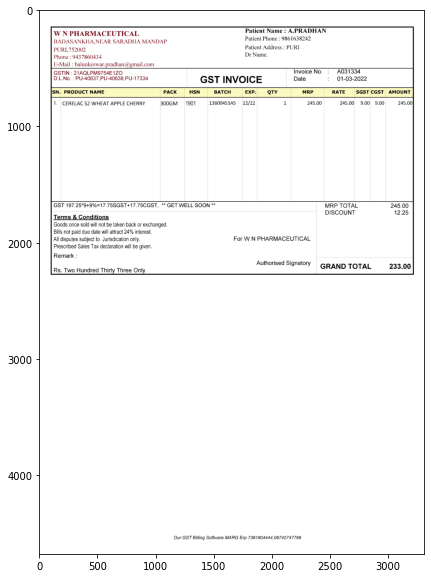


 {'Patient Name': 'A.PRADHAN', 'Patient Mobile Number': [9861638242, 9437860434], 'Patient Address': 'PURI', 'Date': '01-03-2022', 'Invoice Number': 'A031334'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,CERELAC S2 WVHEAT APPLE CHERRY,300GM,1901,13600453A5,12/22,1,245.00,245.00,9.00,9.00,245.00



 {'MRP TOTAL': 245.0, 'DISCOUNT': 12.25, 'GRAND TOTAL': 233.0} 


-----------------------------------------------------------------------------------------------------------------------

227-83-1650037944917.png


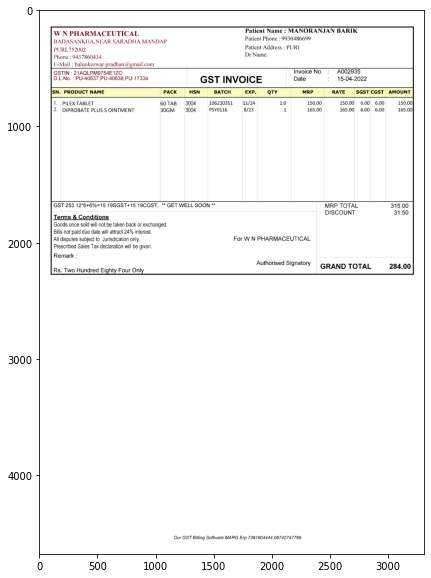


 {'Patient Name': 'MANORANJAN BARIK', 'Patient Mobile Number': [9930486699, 9437860434], 'Patient Address': 'PURI', 'Date': '15-04-2022', 'Invoice Number': 'A002935'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,PILEX TABLET,60 TAB,3004,106210351,11/24,1:0,150.00,150.00,6.00,6.00,150.00
1,2.,DIPROBATE PLUS S OINTMENT,30GM,3004,PSY0116,8/23,1,165.00,165.00,6.00,6.00,165.00



 {'MRP TOTAL': 315.0, 'DISCOUNT': 31.5, 'GRAND TOTAL': 284.0} 


-----------------------------------------------------------------------------------------------------------------------

228-2-1645794519066.png


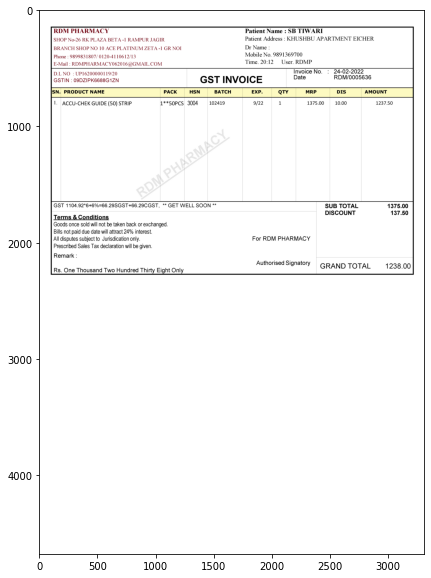


 {'Patient Name': 'SB TIWARI', 'Patient Mobile Number': [9891369700], 'Patient Address': 'KHUSHBU APARTMENT EICHER', 'Date': 'VOICE RDM/0005636', 'Invoice Number': '24-02-2022'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DIS,AMOUNT
0,1.,BLANK,BLANK,BLANK,102419,9/22,1,1375.00,10.00,1237.50



 {'SUB TOTAL': 1375.0, 'DISCOUNT': 137.5, 'GRAND TOTAL': 1238.0} 


-----------------------------------------------------------------------------------------------------------------------

228-1-1645793520456.png


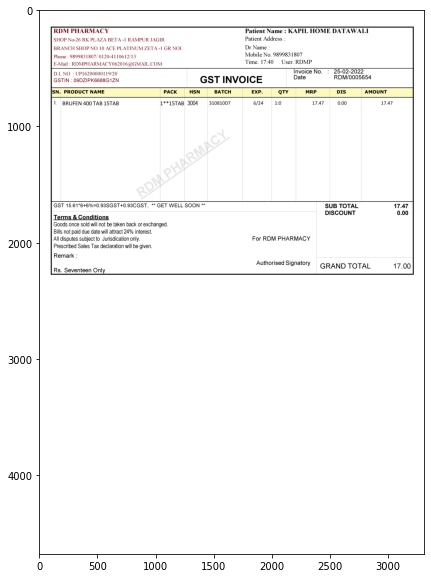


 {'Patient Name': 'KAPIL HOME DATAWALJ', 'Patient Mobile Number': [9899831807], 'Patient Address': '', 'Date': 'VOICE RDM/0005654', 'Invoice Number': '25-02-2022'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DIS,AMOUNT
0,1.,BLANK,BLANK,BLANK,310810D7,6/24,1:0,17.47,0.00,17.47



 {'SUB TOTAL': 17.47, 'DISCOUNT': 0.0, 'GRAND TOTAL': 17.0} 


-----------------------------------------------------------------------------------------------------------------------

231-1-1648703250237.png


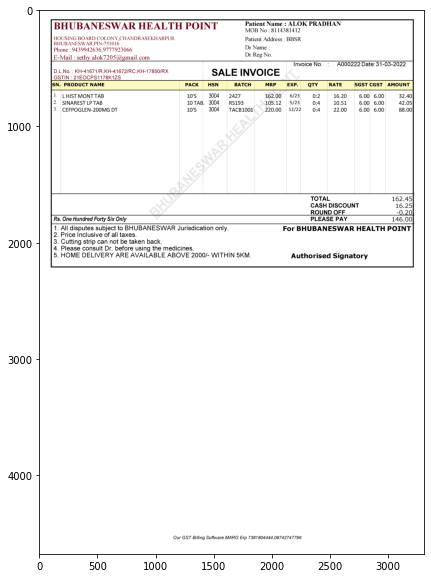


 {'Patient Name': 'ALOK PRADHAN', 'Patient Mobile Number': [8114381412, 9439942636, 9777923066], 'Patient Address': 'BBSR', 'Date': '31-03-2022', 'Invoice Number': 'A000222'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,MRP,EXP.,QTY,RATE,SGST,CGST,AMOUNT
0,1.,LHISTMONT TAB,10'S,3004,2427,162.00,6/23,0:2,16.20,6.00,6.00,32.40
1,2.,SINARESTLP TAB,10 TAB,3004,RS193,105.12,5/23,0:4,10.51,6.00,6.00,42.05
2,3.,CEEPOGLEN-200MG DT,10'S,3004,TACB1001,220.00,12/22,0:4,22.00,6.00,6.00,88.00



 {'TOTAL': 162.45, 'CASH DISCOUNT': 16.25, 'ROUND OFF': -0.2, 'PLEASE PAY': 146.0} 


-----------------------------------------------------------------------------------------------------------------------

231-1-1648659031703.png


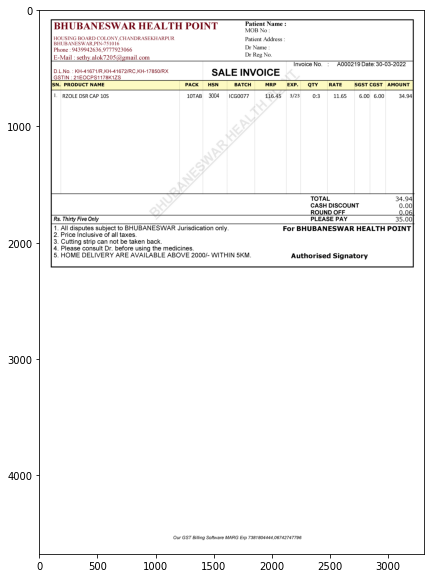


 {'Patient Name': '', 'Patient Mobile Number': [9439942636, 9777923066], 'Patient Address': '', 'Date': '30-03-2022', 'Invoice Number': 'A000219'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,MRP,EXP.,QTY,RATE,SGST,CGST,AMOUNT
0,1.,RZOLE DSR CAP 10S,10TAB,3004,ICG0077,116.45,3/23,0:3,11.65,6.00,6.00,34.94



 {'TOTAL': 34.94, 'CASH DISCOUNT': 0.0, 'ROUND OFF': 0.06, 'PLEASE PAY': 35.0} 


-----------------------------------------------------------------------------------------------------------------------

232-1-1651812627263.png


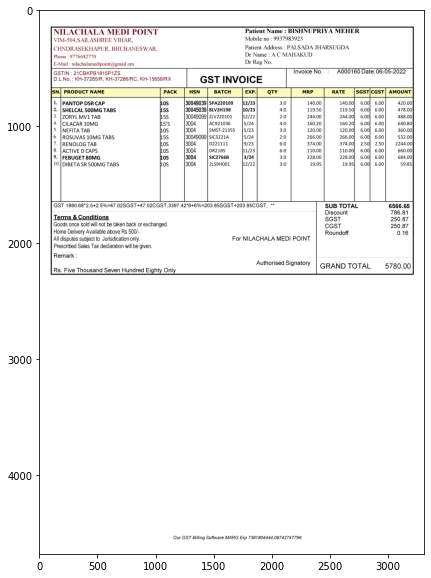


 {'Patient Name': 'BISHNUPRIYA MEHER', 'Patient Mobile Number': [9937983923, 9776682770], 'Patient Address': 'PALSADA JHARSUGDA', 'Date': '06-05-2022', 'Invoice Number': 'A000160'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,PANTOP DSR CAP,10S,30049039,SPA220109,12/23,3:0,140.00,140.00,6.00,6.00,420.00
1,2.,SHELCAL 500MG TABS,15S,30045039,8LV2H198,10/23,4:0,119.50,119.50,6.00,6.00,478.00
2,3.,ZORYL MV1 TAB,15S,30049099,ZLV220101,12/22,2:0,244.00,244.00,6.00,6.00,488.00
3,4.,CILACAR 10MG,15'S,3004,AC921036,5/24,4:0,160.20,160.20,6.00,6.00,640.80
4,5.,NEEITATAB,10S,3004,SMST-21355,5/23,3:0,120.00,120.00,6.00,6.00,360.00
5,6.,ROSUVAS 10MG TABS,15S,30049099,SIC3221A,5/24,2:0,266.00,266.00,6.00,6.00,532.00
6,7.,RENOLOG TAB,10S,3004,D221111,9/23,6:0,374.00,374.00,2.50,2.50,2244.00
7,8.,ACTIVE D CAPS,10S,3004,DR2185,11/23,6:0,110.00,110.00,6.00,6.00,660.00
8,9.,FEBUGET 80MG,10S,3004,SIC2766B,3/24,3:0,228.00,228.00,6.00,6.00,684.00
9,10.,DIBETA SR 5OOMG TABS,10S,3004,2LS9H001,12/22,3:0,19.95,19.95,6.00,6.00,59.85



 {'SUB TOTAL': 6566.65, 'Discount': 786.81, 'SGST': 250.87, 'CGST': 250.87, 'Roundoff': 0.16, 'GRAND TOTAL': 5780.0} 


-----------------------------------------------------------------------------------------------------------------------

232-5-1648306322137.png


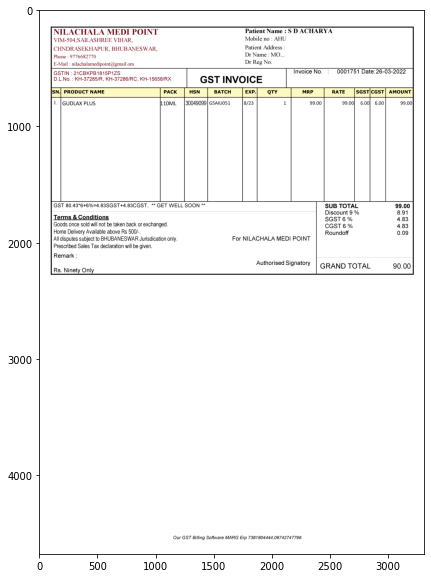


 {'Patient Name': 'S D ACHARYA', 'Patient Mobile Number': [9776682770], 'Patient Address': '', 'Date': '26-03-2022', 'Invoice Number': '0001751'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,GUDLAX PLUS,110ML,30049099,G5AIU051,8/23,1,99.00,99.00,6.00,6.00,99.00



 {'SUB TOtAL': 99.0, 'Discount 9 %': 8.91, 'SGST 6 %': 4.83, 'CGST 6 %': 4.83, 'Roundoff': 0.09, 'GRAND TOTAL': 90.0} 


-----------------------------------------------------------------------------------------------------------------------

232-2-1648010888260.png


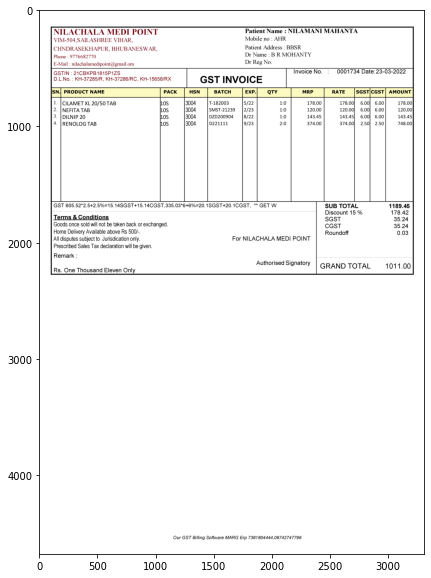


 {'Patient Name': 'NLAMAN MAHANTA', 'Patient Mobile Number': [9776682770], 'Patient Address': 'BBSR', 'Date': '23-03-2022', 'Invoice Number': '0001734'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,CILAMET XL 20/50 TAB,10S,3004,T-182003,5/22,1:0,178.00,178.00,6.00,6.00,178.00
1,2.,NEEITATAB,10S,3004,SMST-21239,2/23,1:0,120.00,120.00,6.00,6.00,120.00
2,3.,DILNIP 20,10S,3004,DZD200904,8/22,1:0,143.45,143.45,6.00,6.00,143.45
3,4.,RENOLOGTAB,10S,3004,D221111,9/23,2:0,374.00,374.00,2.50,2.50,748.00



 {'SUB TOTAL': 1189.45, 'Discount 15 %': 178.42, 'SGST': 35.24, 'CGST': 35.24, 'Roundoff': 0.03, 'GRAND TOTAL': 1011.0} 


-----------------------------------------------------------------------------------------------------------------------

232-1-1647431608302.png


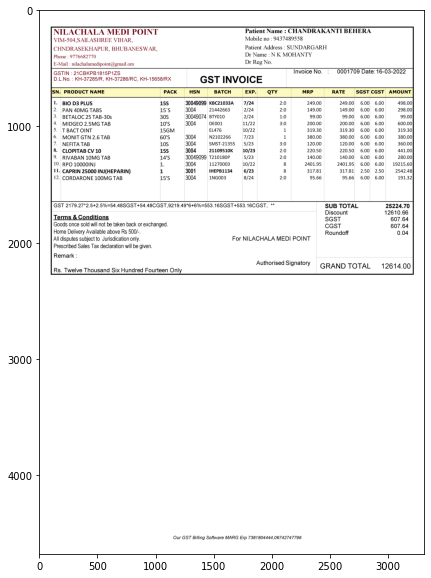


 {'Patient Name': 'CHANDRAKANTI BEHERA', 'Patient Mobile Number': [9437489558, 9776682770], 'Patient Address': 'SUNDARGARH', 'Date': '16-03-2022', 'Invoice Number': '0001709'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,BIO D3 PLUS,15S,30049099,KBC21033A,7/24,2:0,249.00,249.00,6.00,6.00,498.00
1,2.,PAN 4OMG TABS,15`S,3004,21442663,2/24,2:0,149.00,149.00,6.00,6.00,298.00
2,3.,BETALOC 25 TAB-30s,30S,30049074,BTY010,2/24,1:0,99.00,99.00,6.00,6.00,99.00
3,4.,MIDGEO 2.5MG TAB,10'S,3004,DE001,11/22,3:0,200.00,200.00,6.00,6.00,600.00
4,5.,T BACT OINT,15GM,BLANK,EL476,10/22,1,319.30,319.30,6.00,6.00,319.30
5,6.,MONITGTN 2.6 TAB,60'S,3004,N2102266,7/23,1,380.00,380.00,6.00,6.00,380.00
6,7.,NEFITATAB,10S,3004,SMST-21355,5/23,3:0,120.00,120.00,6.00,6.00,360.00
7,8.,CLOPITAB CV 10,15S,3004,21109510K,10/23,2:0,220.50,220.50,6.00,6.00,441.00
8,9.,RIVABAN 1OMG TAB,14'S,30049099,T210180P,5/23,2:0,140.00,140.00,6.00,6.00,280.00
9,10.,RPO 10000INJ,1.,3004,11270003,10/22,8,2401.95,2401.95,6.00,6.00,19215.60



 {'SUB TOTAL': 25224.7, 'Discount': 12610.66, 'SGST': 607.64, 'CGST': 607.64, 'Roundoff': 0.04, 'GRAND TOTAL': 12614.0} 


-----------------------------------------------------------------------------------------------------------------------

232-4-1649950298233.png


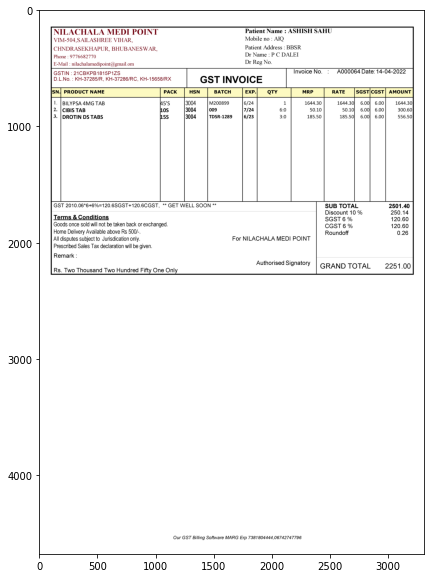


 {'Patient Name': 'ASHISH SAHU', 'Patient Mobile Number': [9776682770], 'Patient Address': 'BBSR', 'Date': '14-04-2022', 'Invoice Number': 'A000064'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,BILYPSA 4MG TAB,45'S,3004,M200899,6/24,1,1644.30,1644.30,6.00,6.00,1644.30
1,2.,CIBIS TAB,10S,3004,009,7/24,6:0,50.10,50.10,6.00,6.00,300.60
2,3.,DROTIN DS TABS,15S,3004,TDSR-1289,6/23,3:0,185.50,185.50,6.00,6.00,556.50



 {'SUB TOTAL': 2501.4, 'Discount 10 %': 250.14, 'SGST 6 %': 120.6, 'CGST 6 %': 120.6, 'Roundoff': 0.26, 'GRAND TOTAL': 2251.0} 


-----------------------------------------------------------------------------------------------------------------------

234-1-1649821892096.png


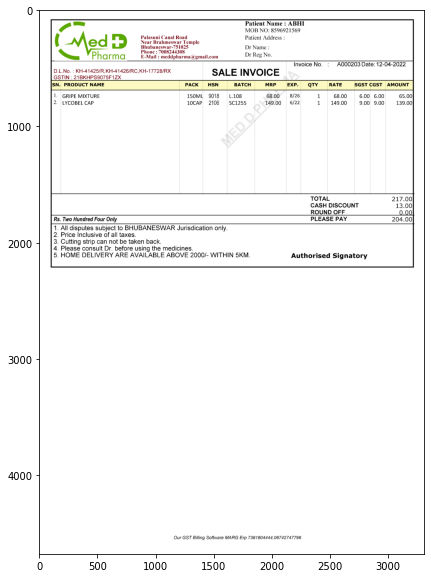


 {'Patient Name': 'ABH', 'Patient Mobile Number': [8596921569, 7008244308], 'Patient Address': '', 'Date': '12-04-2022', 'Invoice Number': 'A000203'} 



,SN.,PRODUCt NAME,PACK,HSN,BATCH,MRP,EXP.,QTY,RATE,SGST,CGST,AMoUnt
0,1.,GRIPE MIXTURE,150ML,9018,L.108,68.00,8/26,1,68.00,6.00,6.00,65.00
1,2.,LYCOBEL CAP,10CAP,2106,SC1255,149.00,6/22,1,149.00,9.00,9.00,139.00



 {'TOTAL': 217.0, 'CASH DISCOUNT': 13.0, 'ROUND OFF': 0.0, 'PLEASE PAY': 204.0} 


-----------------------------------------------------------------------------------------------------------------------

234-16-1651676778984.png


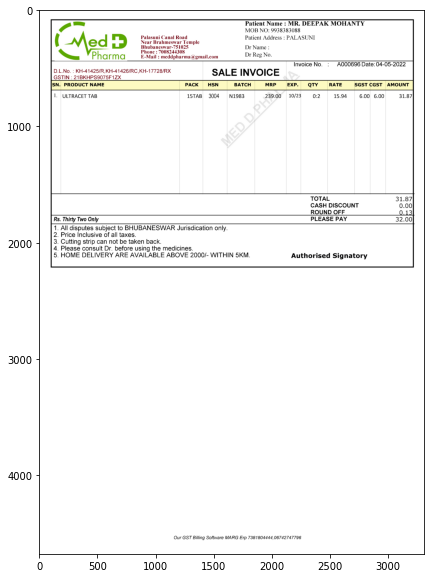


 {'Patient Name': 'MR.DEEPAK MOHANTY', 'Patient Mobile Number': [9938383088, 7008244308], 'Patient Address': 'PALASUNI', 'Date': '04-05-2022', 'Invoice Number': 'A000696'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,MRP,EXP.,QTY,RATE,SGST,CGST,AMoUnt
0,1.,ULTRACET TAB,15TAB,3004,N1983,239.00,10/23,0:2,15.94,6.00,6.00,31.87



 {'TOTAL': 31.87, 'CASH DISCOUNT': 0.0, 'ROUND OFF': 0.13, 'PLEASE PAY': 32.0} 


-----------------------------------------------------------------------------------------------------------------------

234-1-1651500265426.png


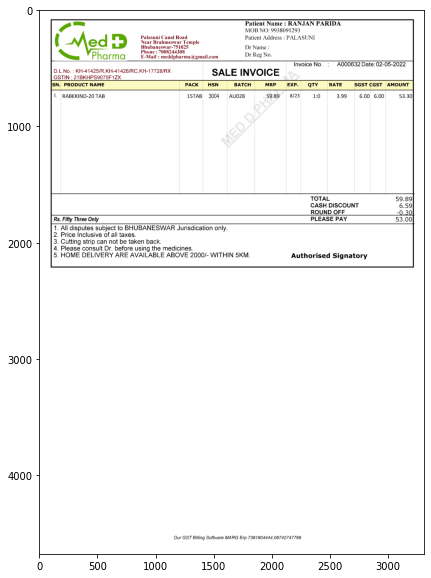


 {'Patient Name': 'RANJAN PARIDA', 'Patient Mobile Number': [9938091293, 7008244308], 'Patient Address': 'PALASUNI', 'Date': '02-05-2022', 'Invoice Number': 'A000632'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,MRP,EXP.,QTY,RATE,SGST,CGST,AMoUnt
0,1.,RABEKIND-20TAB,15TAB,3004,AU028,59.89,8/23,1:0,3.99,6.00,6.00,53.30



 {'TOTAL': 59.89, 'CASH DISCOUNT': 6.59, 'ROUND OFF': -0.3, 'PLEASE PAY': 53.0} 


-----------------------------------------------------------------------------------------------------------------------

235-3-1647333045821.png


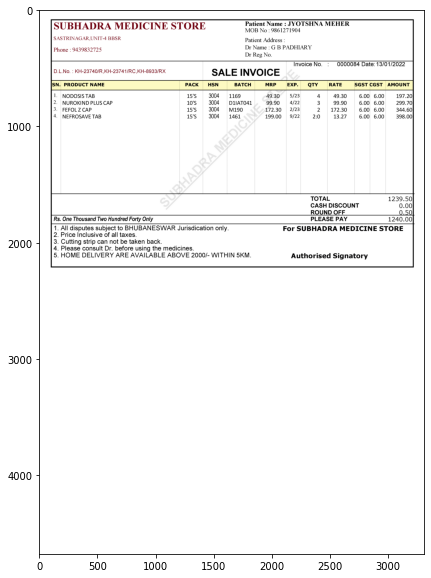


 {'Patient Name': 'JYOTSHNA MEHER', 'Patient Mobile Number': [9861271904, 9439832725], 'Patient Address': '', 'Date': '13/01/2022', 'Invoice Number': '0000084'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,MRP,EXP.,QTY,RATE,SGST,CGST,AMOUNT
0,1.,NODOSISTAB,15'S,3004,1169,49.30,5/23,4,49.30,6.00,6.00,197.20
1,2.,NUROKIND PLUS CAP,10'S,3004,D1IAT041,99.90,4/22,3,99.90,6.00,6.00,299.70
2,3.,FEFOL Z CAP,15'S,3004,M190,172.30,2/23,2,172.30,6.00,6.00,344.60
3,4.,NEFROSAVE TAB,15'S,3004,1461,199.00,9/22,2:0,13.27,6.00,6.00,398.00



 {'TOTAL': 1239.5, 'CASH DISCOUNT': 0.0, 'ROUND OFF': 0.5, 'PLEASE PAY': 1240.0} 


-----------------------------------------------------------------------------------------------------------------------



In [ ]:
for i in Data_Third:
    print(i)
    image = cv2.imread(f'third/{i}')
    plt.figure(figsize=(20,10))
    plt.imshow(image)
    plt.show()
    print("\n", Data_Third[i]['header'], "\n")
    display(Data_Third[i]['table'])
    print("\n", Data_Third[i]['footer'], "\n")
    print('\n-----------------------------------------------------------------------------------------------------------------------\n')

## Fourth

In [ ]:
fourth = os.listdir('fourth')

Data_Fourth = {}

for i in fourth:
    header = extract_header(f'fourth/{i}')
    table = extract_table(f'fourth/{i}')
    footer = extract_footer(f'fourth/{i}')
    Data_Fourth[i] = {'header': header, 'table': table, 'footer': footer}

[2022/07/05 04:48:24] ppocr WARNING: Since the angle classifier is not initialized, the angle classifier will not be uesd during the forward process
[2022/07/05 04:48:25] ppocr DEBUG: dt_boxes num : 23, elapse : 0.04185175895690918
[2022/07/05 04:48:25] ppocr DEBUG: rec_res num  : 23, elapse : 0.05956912040710449
[2022/07/05 04:48:25] ppocr WARNING: Since the angle classifier is not initialized, the angle classifier will not be uesd during the forward process
[2022/07/05 04:48:25] ppocr DEBUG: dt_boxes num : 12, elapse : 0.015967607498168945
[2022/07/05 04:48:25] ppocr DEBUG: rec_res num  : 12, elapse : 0.053673744201660156
[2022/07/05 04:48:27] ppocr WARNING: Since the angle classifier is not initialized, the angle classifier will not be uesd during the forward process
[2022/07/05 04:48:27] ppocr DEBUG: dt_boxes num : 2, elapse : 0.011030435562133789
[2022/07/05 04:48:27] ppocr DEBUG: rec_res num  : 2, elapse : 0.00928497314453125
[2022/07/05 04:48:27] ppocr WARNING: Since the angle c

235-4-1647331049037.png


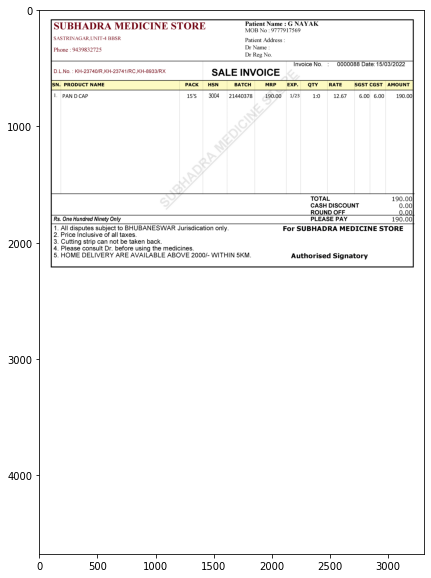


 {'Patient Name': 'G NAYAK', 'Patient Mobile Number': [9777917569, 9439832725], 'Patient Address': '', 'Date': '15/03/2022', 'Invoice Number': '0000088'} 



,SN.,PRODUCt NAME,PACK,HSN,BATCH,MRP,EXP.,QTY,RATE,SGST,CGST,AMOUNT
0,1.,PAN D CAP,15'S,3004,21440378,190.00,1/23,1:0,12.67,6.00,6.00,190.00



 {'TOTAL': 190.0, 'CASH DISCOUNT': 0.0, 'ROUND OFF': 0.0, 'PLEASE PAY': 190.0} 


-----------------------------------------------------------------------------------------------------------------------

235-4-1647334464904.png


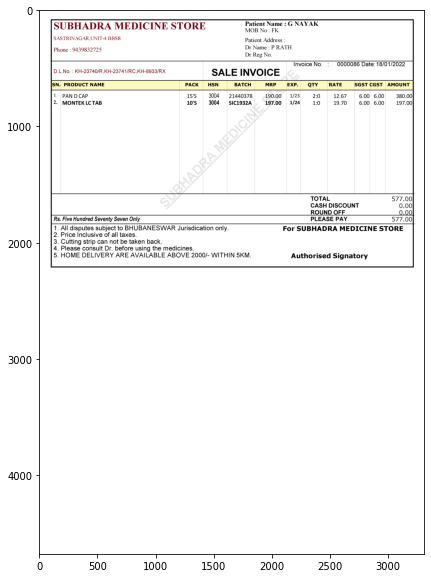


 {'Patient Name': 'G NAYAK', 'Patient Mobile Number': [9439832725], 'Patient Address': '', 'Date': '18/01/2022', 'Invoice Number': '0000086'} 



,SN.,PRODUCt NAME,PACK,HSN,BATCH,MRP,EXP.,QTY,RATE,SGST,CGST,AMOUNT
0,1.,PAN D CAP,15'S,3004,21440378,190.00,1/23,2:0,12.67,6.00,6.00,380.00
1,2.,MONTEKLC TAB,10'S,3004,SIC1932A,197.00,1/24,1:0,19.70,6.00,6.00,197.00



 {'TOTAL': 577.0, 'CASH DISCOUNT': 0.0, 'ROUND OFF': 0.0, 'PLEASE PAY': 577.0} 


-----------------------------------------------------------------------------------------------------------------------

235-2-1647350568321.png


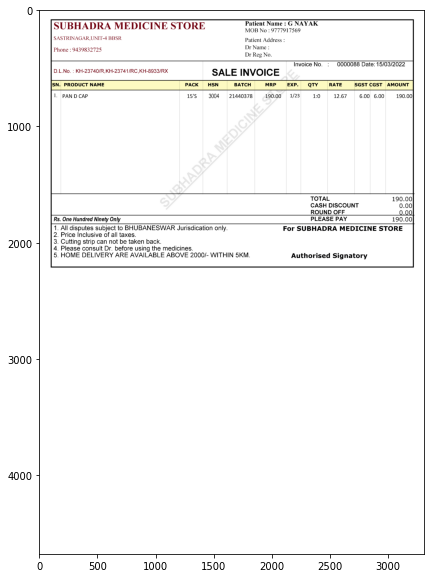


 {'Patient Name': 'G NAYAK', 'Patient Mobile Number': [9777917569, 9439832725], 'Patient Address': '', 'Date': '15/03/2022', 'Invoice Number': '0000088'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,MRP,EXP.,QTY,RATE,SGST,CGST,AMoUnt
0,1.,PAN D CAP,15'S,3004,21440378,190.00,1/23,1:0,12.67,6.00,6.00,190.00



 {'TOTAL': 190.0, 'CASH DISCOUNT': 0.0, 'ROUND OFE': 0.0, 'PLEASE PAY': 190.0} 


-----------------------------------------------------------------------------------------------------------------------

235-1-1647346247352.png


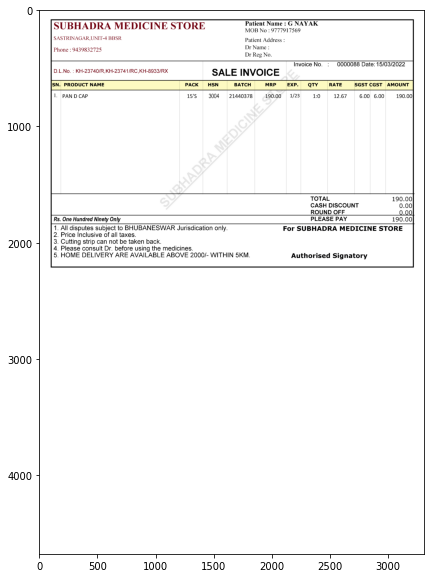


 {'Patient Name': 'G NAYAK', 'Patient Mobile Number': [9777917569, 9439832725], 'Patient Address': '', 'Date': '15/03/2022', 'Invoice Number': '0000088'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,MRP,EXP.,QTY,RATE,SGST,CGST,AMoUnt
0,1.,PAN D CAP,15'S,3004,21440378,190.00,1/23,1:0,12.67,6.00,6.00,190.00



 {'TOTAL': 190.0, 'CASH DISCOUNT': 0.0, 'ROUND OFE': 0.0, 'PLEASE PAY': 190.0} 


-----------------------------------------------------------------------------------------------------------------------

240-3-1646496344744.png


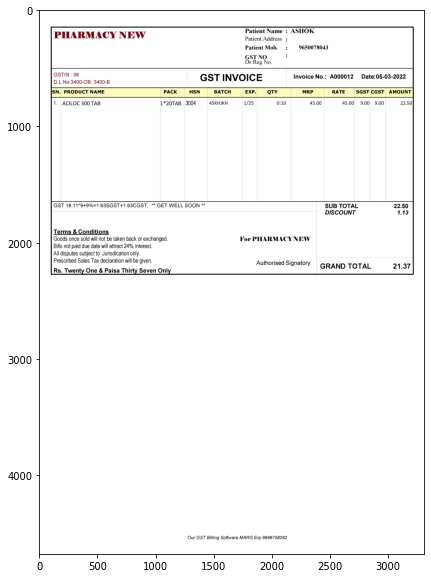


 {'Patient Name': 'ASHOK', 'Patient Mobile Number': [9650078043], 'Patient Address': '', 'Date': '05-03-2022', 'Invoice Number': 'A000012'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,ACILOC 300 TAB,1*20TAB,3004,45KHJKH,1/25,0:10,45.00,45.00,9.00,9.00,22.50



 {'SUB TOTAL': 22.5, 'DISCOUNT': 1.13, 'GRAND TOTAL': 21.37} 


-----------------------------------------------------------------------------------------------------------------------

241-6-1646839624507.png


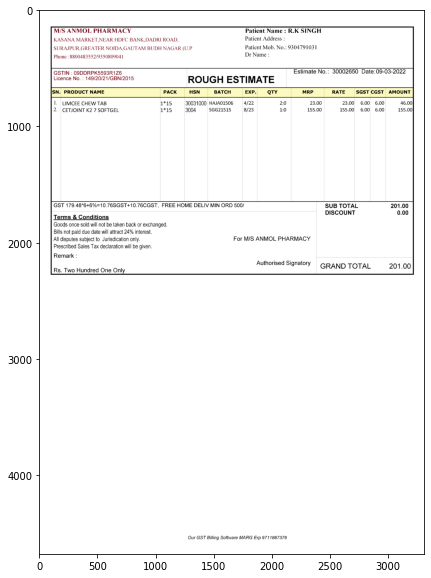


 {'Patient Name': 'R.K SINGH', 'Patient Mobile Number': [9304791031], 'Patient Address': '', 'Date': '09-03-2022', 'Invoice Number': '30002650'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,LIMCEE CHEW TAB,1*15,30031000,HAJA01506,4/22,2:0,23.00,23.00,6.00,6.00,46.00
1,2.,CETJOINT K2 7 SOETGEL,1*15,3004,SGG21515,8/23,1:0,155.00,155.00,6.00,6.00,155.00



 {'SuB totAL': 201.0, 'DISCOUNT': 0.0, 'GRAND TOTAL': 201.0} 


-----------------------------------------------------------------------------------------------------------------------

241-7-1646844088628.png


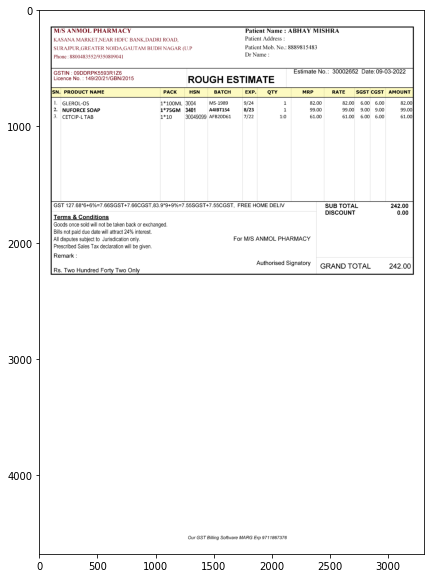


 {'Patient Name': 'ABHAY MISHRA', 'Patient Mobile Number': [8889815483], 'Patient Address': '', 'Date': '09-03-2022', 'Invoice Number': '30002652'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,GLEROL-OS,1*100ML,3004,MS-1989,9/24,1,82.00,82.00,6.00,6.00,82.00
1,2.,NUFORCE SOAP,1*75GM,3401,A4IBT154,8/23,1,99.00,99.00,9.00,9.00,99.00
2,3.,CETCIP-L TAB,1*10,30049099,AFB20D61,7/22,1:0,61.00,61.00,6.00,6.00,61.00



 {'SuB totAL': 242.0, 'DISCOUNT': 0.0, 'GRAND TOTAL': 242.0} 


-----------------------------------------------------------------------------------------------------------------------

241-3-1646826761003.png


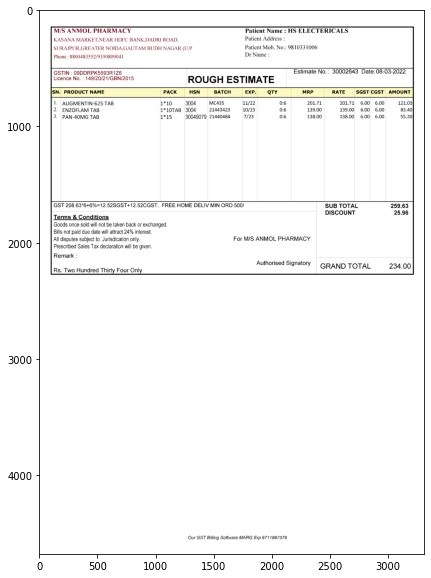


 {'Patient Name': 'HS ELECTERICALS', 'Patient Mobile Number': [9810331006], 'Patient Address': '', 'Date': '08-03-2022', 'Invoice Number': '30002643'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,AUGMENTIN-625 TAB,1*10,3004,MC435,11/22,0:6,201.71,201.71,6.00,6.00,121.03
1,2.,ENZOFLAMTAB,1*10TAB,3004,21443423,10/23,0:6,139.00,139.00,6.00,6.00,83.40
2,3.,PAN-4OMG TAB,1*15,30049079,21440484,7/23,0:6,138.00,138.00,6.00,6.00,55.20



 {'SuB totAL': 259.63, 'DISCOUNT': 25.96, 'GRAND TOTAL': 234.0} 


-----------------------------------------------------------------------------------------------------------------------

241-1-1652093693549.png


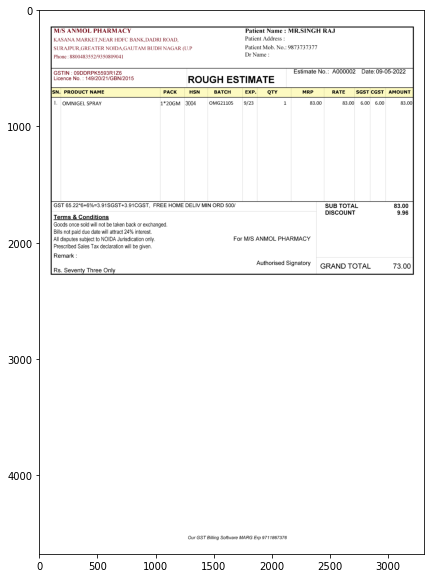


 {'Patient Name': 'MR.SINGH RAJ', 'Patient Mobile Number': [9873737377], 'Patient Address': '', 'Date': '09-05-2022', 'Invoice Number': 'A000002'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,OMNIGEL SPRAY,1*20GM,3004,0MG21105,9/23,1,83.00,83.00,6.00,6.00,83.00



 {'SuB totAL': 83.0, 'DISCOUNT': 9.96, 'GRAND TOTAL': 73.0} 


-----------------------------------------------------------------------------------------------------------------------

241-2-1646826445678.png


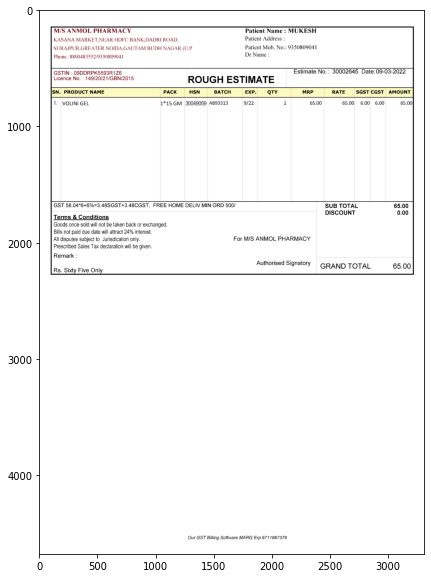


 {'Patient Name': 'MUKESH', 'Patient Mobile Number': [9350809041], 'Patient Address': '', 'Date': '09-03-2022', 'Invoice Number': '30002645'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,VOLINI GEL,1*15 GM,30049069,AB93313,9/22,1,65.00,65.00,6.00,6.00,65.00



 {'SuB totAL': 65.0, 'DISCOUNT': 0.0, 'GRAND TOTAL': 65.0} 


-----------------------------------------------------------------------------------------------------------------------

242-8-1648823825639.png


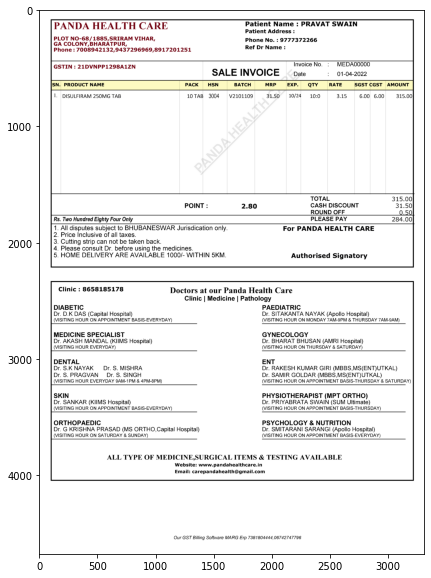


 {'Patient Name': 'PRAVAT SWAIN', 'Patient Mobile Number': [9777372266, 7008942132, 9437296969, 8917201251], 'Patient Address': '', 'Date': '01-04-2022', 'Invoice Number': 'MEDA0OOOO'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,MRP,EXP.,QTY,RATE,SGST,CGST,AMoUnt
0,1.,DISULEIRAM 25OMG TAB,10 TAB,3004,V2101109,31.50,10/24,10:0,3.15,6.00,6.00,315.00



 {'TOTAL': 315.0, 'CASH DISCOUNT': 31.5, 'ROUND OFE': 0.5, 'PLEASE PAY': 284.0} 


-----------------------------------------------------------------------------------------------------------------------

242-4-1648967527438.png


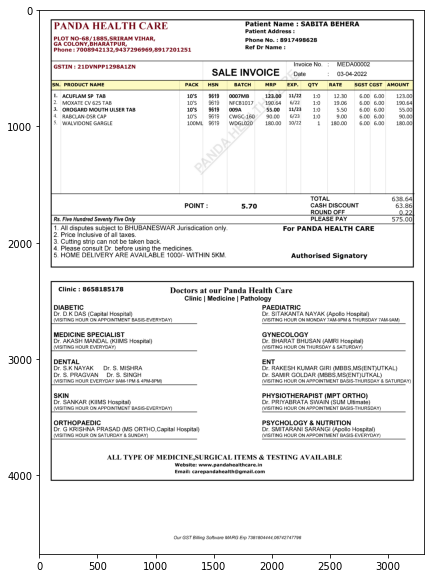


 {'Patient Name': 'SABITA BEHERA', 'Patient Mobile Number': [8917498628, 7008942132, 9437296969, 8917201251], 'Patient Address': '', 'Date': '03-04-2022', 'Invoice Number': 'MEDA00002'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,MRP,EXP.,QTY,RATE,SGST,CGST,AMOUNT
0,1.,ACUFLAM SP TAB,10'S,9619,0007MB,123.00,11/22,1:0,12.30,6.00,6.00,123.00
1,2.,MOXATE CV 625 TAB,10'S,9619,NFCB1017,190.64,6/22,1:0,19.06,6.00,6.00,190.64
2,3.,OROGARD MOUTH ULSER TAB,10'S,9619,009A,55.00,11/23,1:0,5.50,6.00,6.00,55.00
3,4.,RABCLAN-DSR CAP,10'S,9619,CWGC-160,90.00,6/23,1:0,9.00,6.00,6.00,90.00
4,5.,WALVIDONE GARGLE,100ML,9619,WDGL020,180.00,10/22,1,180.00,6.00,6.00,180.00



 {'TOTAL': 638.64, 'CASH DISCOUNT': 63.86, 'ROUND OFE': 0.22, 'PLEASE PAY': 575.0} 


-----------------------------------------------------------------------------------------------------------------------

242-5-1648739540857.png


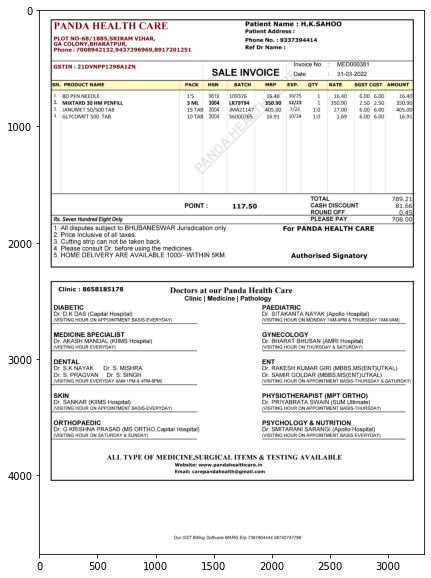


 {'Patient Name': 'H.K.SAHOO', 'Patient Mobile Number': [9337394414, 7008942132, 9437296969, 8917201251], 'Patient Address': '', 'Date': '31-03-2022', 'Invoice Number': 'MED000381'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,MRP,EXP.,QTY,RATE,SGST,CGST,AMOUNT
0,1.,BD PEN NEEDLE,1'S,9619,BLANK,16.40,10/25,1,16.40,6.00,6.00,16.40
1,2.,MIXTARD 3O HM PENEILL,3 ML,3004,LR79T94,350.90,12/23,1,350.90,2.50,2.50,350.90
2,3.,JANUMET 50/500 TAB,15 TAB,3004,JMA21147,405.00,7/23,1:0,27.00,6.00,6.00,405.00
3,4.,GLYCOMET 500 TAB,10 TAB,3004,56000765,16.91,10/24,1:0,1.69,6.00,6.00,16.91



 {'TOTAL': 789.21, 'CASH DISCOUNT': 81.66, 'ROUND OFE': 0.45, 'PLEASE PAY': 708.0} 


-----------------------------------------------------------------------------------------------------------------------

243-5-1651635187943.png


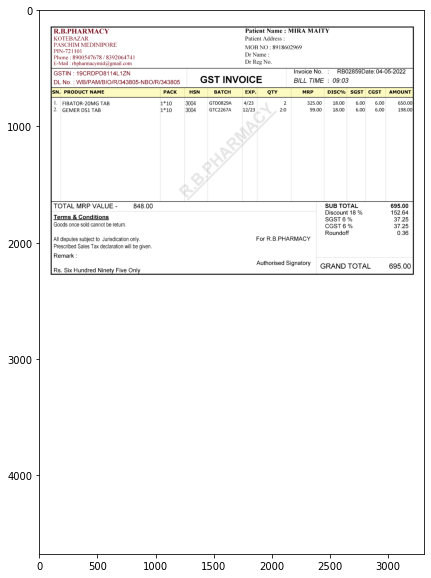


 {'Patient Name': 'MIRA MAITY', 'Patient Mobile Number': [8918602969, 8900547678, 8392064741], 'Patient Address': '', 'Date': '04-05-2022', 'Invoice Number': 'RB02859'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DISC%,SGST,CGST,AMount
0,1.,EIBATOR-2OMG TAB,1*10,3004,GTD0829A,4/23,2,325.00,18.00,6.00,6.00,650.00
1,2.,GEMER DS1 TAB,1*10,3004,GTC2267A,12/23,2:0,99.00,18.00,6.00,6.00,198.00



 {'SuB tOtAL': 695.0, 'Discount 18 %': 152.64, 'SGST 6 %': 37.25, 'CGST 6 %': 37.25, 'Roundoff': 0.36, 'GRAND TOTAL': 695.0} 


-----------------------------------------------------------------------------------------------------------------------

243-2-1651898377487.png


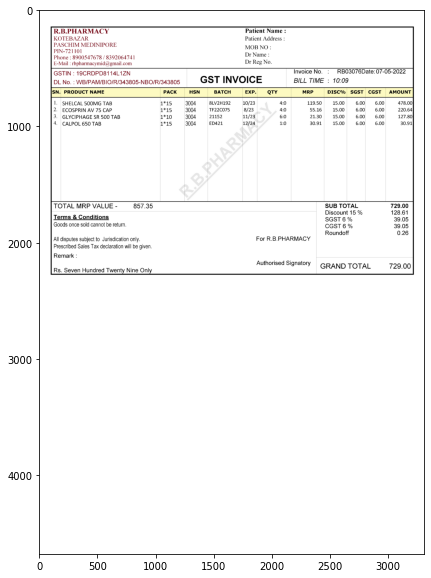


 {'Patient Name': '', 'Patient Mobile Number': [8900547678, 8392064741], 'Patient Address': '', 'Date': '07-05-2022', 'Invoice Number': 'RB03076'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DISC%,SGST,CGST,AMount
0,1.,SHELCAL 5OOMG TAB,1*15,3004,8LV2H192,10/23,4:0,119.50,15.00,6.00,6.00,478.00
1,2.,ECOSPRIN AV 75 CAP,1*15,3004,TE22C075,8/23,4:0,55.16,15.00,6.00,6.00,220.64
2,3.,GLYCIPHAGE SR 500 TAB,1*10,3004,21152,11/23,6:0,21.30,15.00,6.00,6.00,127.80
3,4.,CALPOL 650 TAB,1*15,3004,ED421,12/24,1:0,30.91,15.00,6.00,6.00,30.91



 {'SuB tOtAL': 729.0, 'Discount 15 %': 128.61, 'SGST 6 %': 39.05, 'CGST 6 %': 39.05, 'Roundoff': 0.26, 'GRAND TOTAL': 729.0} 


-----------------------------------------------------------------------------------------------------------------------

243-14-1648898821685.png


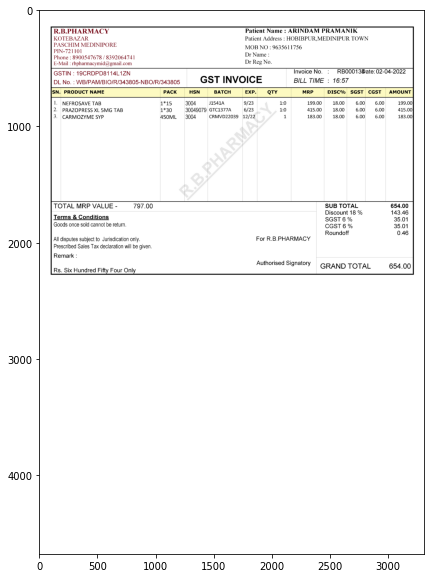


 {'Patient Name': 'ARINDAM PRAMANIK', 'Patient Mobile Number': [9635611756, 8900547678, 8392064741], 'Patient Address': 'HOBIBPUR.MEDINIPUR TOWN', 'Date': '', 'Invoice Number': 'RB000130ate'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DISC%,SGST,CGST,AMount
0,1.,NEFROSAVE TAB,1*15,3004,J1541A,9/23,1:0,199.00,18.00,6.00,6.00,199.00
1,2.,PRAZOPRESS XL 5MG TAB,1*30,30049079,GTC1377A,6/23,1:0,415.00,18.00,6.00,6.00,415.00
2,3.,CARMOZYME SYP,450ML,3004,CRMVD22039,12/22,1,183.00,18.00,6.00,6.00,183.00



 {'SuB tOtAL': 654.0, 'Discount 18 %': 143.46, 'SGST 6 %': 35.01, 'CGST 6 %': 35.01, 'Roundoff': 0.46, 'GRAND TOTAL': 654.0} 


-----------------------------------------------------------------------------------------------------------------------

243-3-1648363011256.png


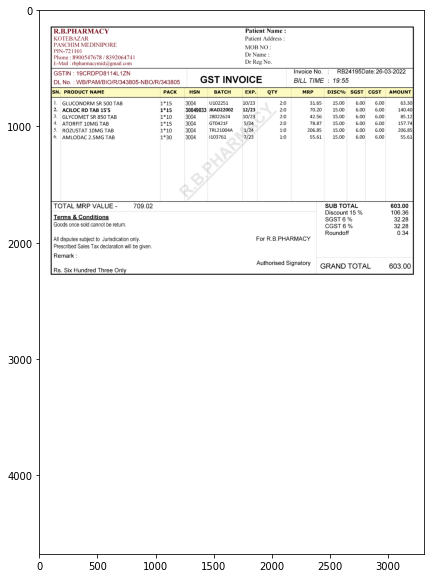


 {'Patient Name': '', 'Patient Mobile Number': [8900547678, 8392064741], 'Patient Address': '', 'Date': '26-03-2022', 'Invoice Number': 'RB24195'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DISC%,SGST,CGST,AMount
0,1.,GLUCONORM SR 5O0 TAE,1*15,3004,U102251,10/23,2:0,31.65,15.00,6.00,6.00,63.30
1,2.,ACILOC RD TAB 15'S,1*15,30049033,JKAD22002,12/23,2:0,70.20,15.00,6.00,6.00,140.40
2,3.,GLYCOMET SR 850 TAB,1*10,3004,28022624,10/23,2:0,42.56,15.00,6.00,6.00,85.12
3,4.,ATORFIT 10MG TAB,1*15,3004,GT0421F,5/24,2:0,78.87,15.00,6.00,6.00,157.74
4,5.,ROZUSTAT 1OMG TAB,1*10,3004,TRL21004A,1/24,1:0,206.85,15.00,6.00,6.00,206.85
5,6.,AMLODAC 2.5MG TAB,1*30,3004,1103761,7/23,1:0,55.61,15.00,6.00,6.00,55.61



 {'SuB tOtAL': 603.0, 'Discount 15 %': 106.36, 'SGST 6 %': 32.28, 'CGST 6 %': 32.28, 'Roundoff': 0.34, 'GRAND TOTAL': 603.0} 


-----------------------------------------------------------------------------------------------------------------------

246-7-1648738841906.png


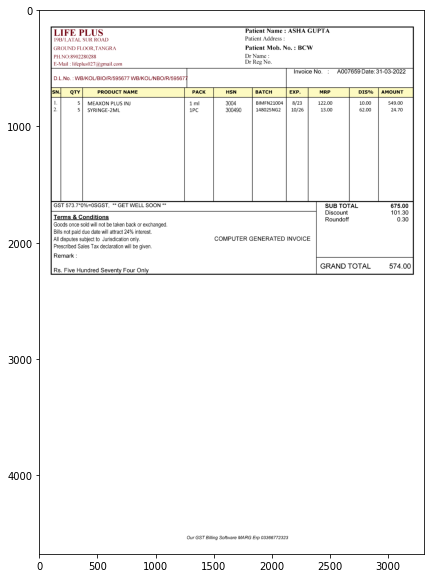


 {'Patient Name': 'ASHA GUPTA', 'Patient Mobile Number': [], 'Patient Address': '', 'Date': '31-03-2022', 'Invoice Number': 'A007659'} 



,SN.,QTY,PRODUCt nAME,PACK,HSN,BATCH,EXP.,MRP,DIS%,AMoUnt
0,1.,5,MEAXON PLUS INJ,1 ml,3004,BIMEN21004,8/23,122.00,10.00,549.00
1,2.,5,SYRINGE-2ML,1PC,300490,148025NG2,10/26,13.00,62.00,24.70



 {'SUB TOTAL': 675.0, 'Discount': 101.3, 'Roundoff': 0.3, 'GRAND TOTAL': 574.0} 


-----------------------------------------------------------------------------------------------------------------------

246-6-1649330894711.png


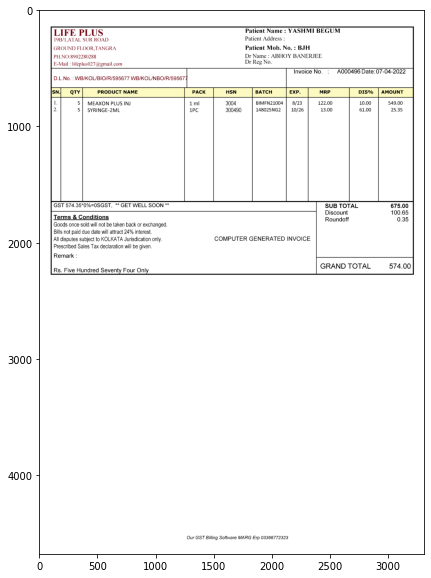


 {'Patient Name': 'YASHMI BEGUM', 'Patient Mobile Number': [], 'Patient Address': '', 'Date': '07-04-2022', 'Invoice Number': 'A000496'} 



,SN.,QTY,PRODUCt nAME,PACK,HSN,BATCH,EXP.,MRP,DIS%,AMOUnt
0,1.,5,MEAXON PLUS INJ,1 ml,3004,BIMEN21004,8/23,122.00,10.00,549.00
1,2.,5,SYRINGE-2ML,1PC,300490,148025NG2,10/26,13.00,61.00,25.35



 {'SUB TOTAL': 675.0, 'Discount': 100.65, 'Roundoff': 0.35, 'GRAND TOTAL': 574.0} 


-----------------------------------------------------------------------------------------------------------------------

246-5-1651558445286.png


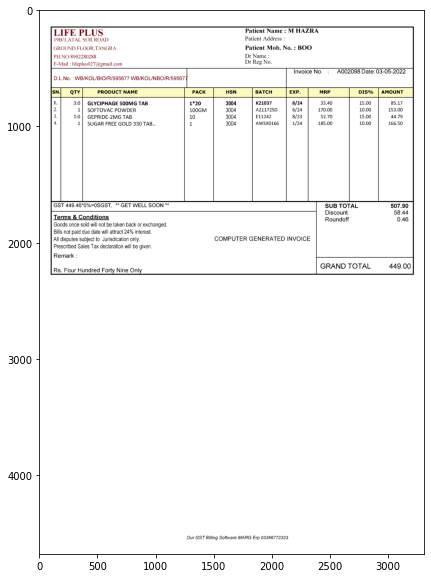


 {'Patient Name': 'M HAZRA', 'Patient Mobile Number': [], 'Patient Address': '', 'Date': '03-05-2022', 'Invoice Number': 'A002098'} 



,SN.,QTY,PRODUCT NAME,PACK,HSN,BATCH,EXP.,MRP,DIS%,AMOUnt
0,1.,3:0,GLYCIPHAGE 50OMG TAB,1*20,3004,K21037,8/24,33.40,15.00,85.17
1,2.,1,SOETOVAC POWDER,100GM,3004,A21172SD,6/24,170.00,10.00,153.00
2,3.,1:0,GEPRIDE-2MG TAB,10,3004,E11242,8/23,52.70,15.00,44.79
3,4.,1,SUGAR FREE GOLD 330 TAB.,1,3004,AWSX0166,1/24,185.00,10.00,166.50



 {'SUB TOTAL': 507.9, 'Discount': 58.44, 'Roundoff': 0.46, 'GRAND TOTAL': 449.0} 


-----------------------------------------------------------------------------------------------------------------------

246-12-1648124213484.png


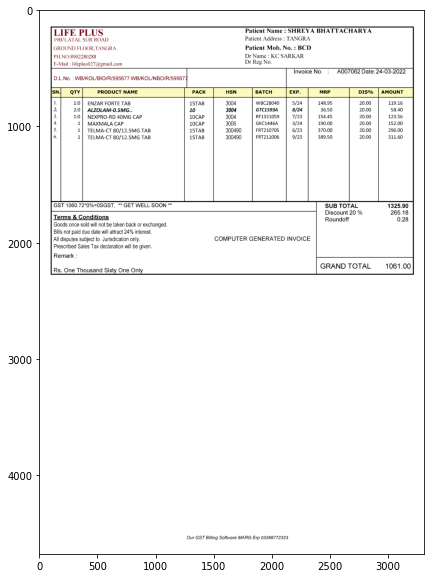


 {'Patient Name': 'SHREYA BHATTACHARYA', 'Patient Mobile Number': [], 'Patient Address': 'TANGRA', 'Date': '24-03-2022', 'Invoice Number': 'A007062'} 



,SN.,QTY,PRODUCT NAME,PACK,HSN,BATCH,EXP.,MRP,DIS%,AMOUnt
0,1.,1:0,FNZAR EORTE TAB,15TAB,3004,WBC2B040,5/24,148.95,20.00,119.16
1,2.,2:0,ALZ0LAM-0.5MG..,10,3004,GTC1593A,8/24,36.50,20.00,58.40
2,3.,1:0,NEXPRO-RD 4OMG CAP,10CAP,3004,RF1321059,7/23,154.45,20.00,123.56
3,4.,1,MAXMALA CAP,10CAP,3006,GKC1446A,3/24,190.00,20.00,152.00
4,5.,1,TELMA-CT 80/12.5MG TAB,15TAB,300490,FRT210705,6/23,370.00,20.00,296.00
5,6.,1,TELMA-CT 80/12.5MG TAB,15TAB,300490,FRT211006,9/23,389.50,20.00,311.60



 {'SuB tOtAL': 1325.9, 'Discount 20 %': 265.18, 'Roundoff': 0.28, 'GRAND TOTAL': 1061.0} 


-----------------------------------------------------------------------------------------------------------------------

246-22-1648567966959.png


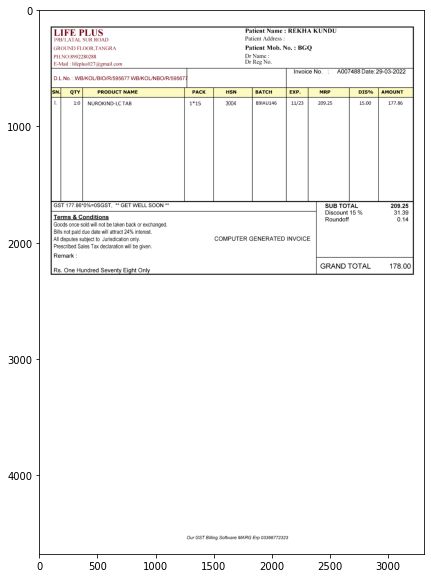


 {'Patient Name': 'REKHA KUNDU', 'Patient Mobile Number': [], 'Patient Address': '', 'Date': '29-03-2022', 'Invoice Number': 'A007488'} 



,SN.,QTY,PRODUCt nAME,PACK,HSN,BATCH,EXP.,MRP,DIS%,AMoUnt
0,1.,1:0,NUROKIND-LC TAB,1*15,3004,B9|AU146,11/23,209.25,15.00,177.86



 {'SUB TOTAL': 209.25, 'Discount 15 %': 31.39, 'Roundoff': 0.14, 'GRAND TOTAL': 178.0} 


-----------------------------------------------------------------------------------------------------------------------

248-2-1651926117933.png


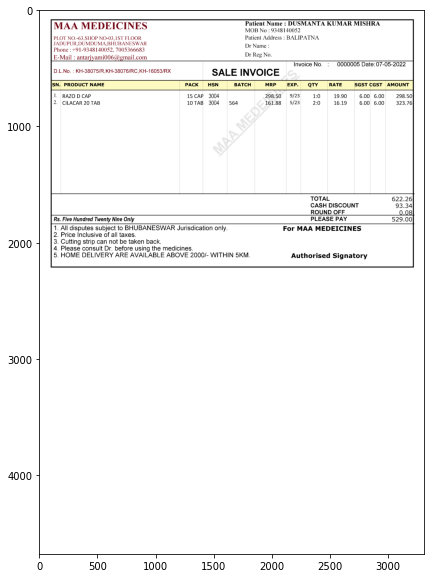


 {'Patient Name': 'DUSMANTA KUMAR MSHRA', 'Patient Mobile Number': [9348140052, 7005366683], 'Patient Address': 'BALIPATNA', 'Date': '07-05-2022', 'Invoice Number': '0000005'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,MRP,EXP.,QTY,RATE,SGST,CGST,AMoUnt
0,1.,RAZO D CAP,15 CAF,3004,BLANK,298.50,9/23,1:0,19.90,6.00,6.00,298.50
1,2.,CILACAR 20 TAB,10 TAB,3004,564,161.88,5/23,2:0,16.19,6.00,6.00,323.76



 {'TOTAL': 622.26, 'CASH DISCOUNT': 93.34, 'ROUND OFE': 0.08, 'PLEASE PAY': 529.0} 


-----------------------------------------------------------------------------------------------------------------------

249-15-1647359447970.png


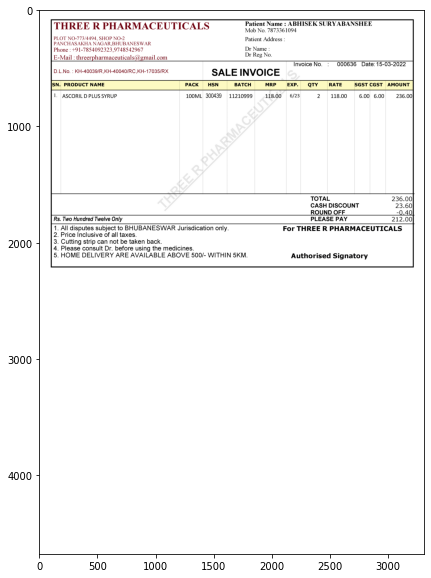


 {'Patient Name': 'ABHISEK SURYABANSHEE', 'Patient Mobile Number': [7873361094, 9748542967], 'Patient Address': '', 'Date': '15-03-2022', 'Invoice Number': '000636'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,MRP,EXP.,QTY,RATE,SGST,CGST,AMOUNT
0,1.,ASCORIL D PLUS SYRUP,100ML,300439,11210999,118.00,6/23,2,118.00,6.00,6.00,236.00



 {'TOTAL': 236.0, 'CASH DISCOUNT': 23.6, 'ROUND OFF': -0.4, 'PLEASE PAY': 212.0} 


-----------------------------------------------------------------------------------------------------------------------

249-14-1647359394422.png


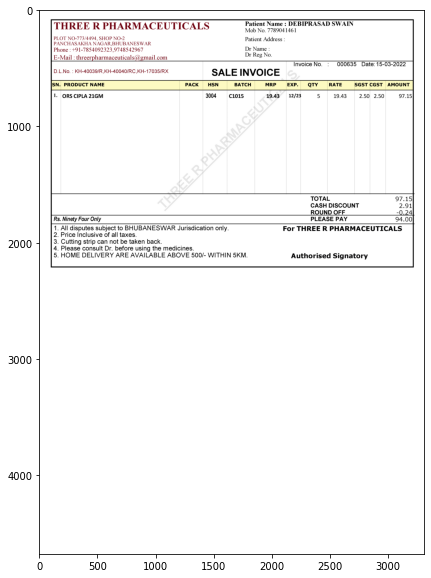


 {'Patient Name': 'DEBIPRASAD SWAIN', 'Patient Mobile Number': [7789041461, 9748542967], 'Patient Address': '', 'Date': '15-03-2022', 'Invoice Number': '000635'} 



,SN.,PRODUCt NAME,PACK,HSN,BATCH,MRP,EXP.,QTY,RATE,SGST,CGST,AMOUNT
0,1.,ORS CIPLA 21GM,BLANK,3004,C1015,19.43,12/23,5,19.43,2.50,2.50,97.15



 {'TOTAL': 97.15, 'CASH DISCOUNT': 2.91, 'ROUND OFF': -0.24, 'PLEASE PAY': 94.0} 


-----------------------------------------------------------------------------------------------------------------------

249-3-1648191654830.png


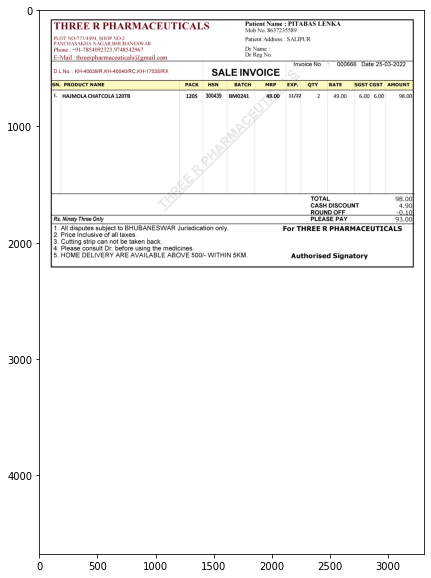


 {'Patient Name': 'PITABAS LENKA', 'Patient Mobile Number': [8637235589, 9748542967], 'Patient Address': 'SALIPUR', 'Date': '25-03-2022', 'Invoice Number': '000666'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,MRP,EXP.,QTY,RATE,SGST,CGST,AMOUNT
0,1.,HAJMOLA CHATCOLA 120TB,120S,300439,BM0241,49.00,11/22,2,49.00,6.00,6.00,98.00



 {'TOTAL': 98.0, 'CASH DISCOUNT': 4.9, 'ROUND OFF': -0.1, 'PLEASE PAY': 93.0} 


-----------------------------------------------------------------------------------------------------------------------

249-2-1650205360679.png


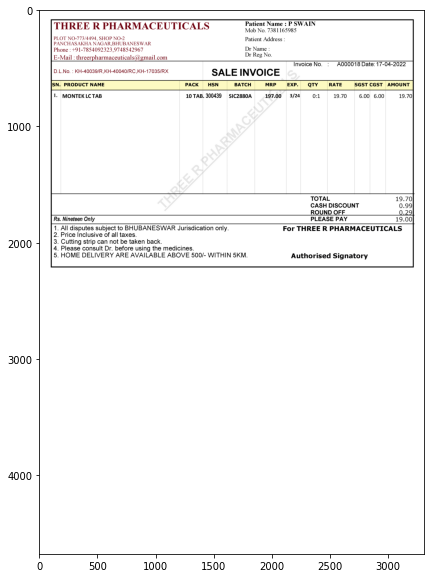


 {'Patient Name': 'P SWAIN', 'Patient Mobile Number': [7381165985, 9748542967], 'Patient Address': '', 'Date': '17-04-2022', 'Invoice Number': 'A000018'} 



,SN.,PRODUCt NAME,PACK,HSN,BATCH,MRP,EXP.,QTY,RATE,SGST,CGST,AMOUNT
0,1.,MONTEKLCTAB,10 TAB,300439,SIC2880A,197.00,3/24,0:1,19.70,6.00,6.00,19.70



 {'TOTAL': 19.7, 'CASH DISCOUNT': 0.99, 'ROUND OFF': 0.29, 'PLEASE PAY': 19.0} 


-----------------------------------------------------------------------------------------------------------------------

249-9-1647446044879.png


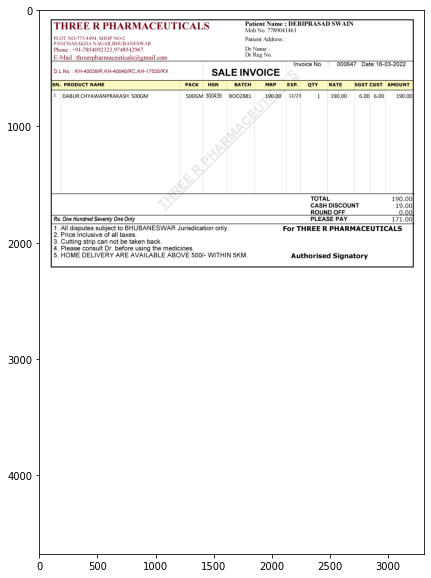


 {'Patient Name': 'DEBIPRASAD SWAIN', 'Patient Mobile Number': [7789041461, 9748542967], 'Patient Address': '', 'Date': '16-03-2022', 'Invoice Number': '000647'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,MRP,EXP.,QTY,RATE,SGST,CGST,AMOUNT
0,1.,DABUR CHYAWANPRAKASH 5OOGM,500GM,300439,BDO2881,190.00,12/23,1,190.00,6.00,6.00,190.00



 {'TOTAL': 190.0, 'CASH DISCOUNT': 19.0, 'ROUND OFF': 0.0, 'PLEASE PAY': 171.0} 


-----------------------------------------------------------------------------------------------------------------------

250-15-1648115110226.png


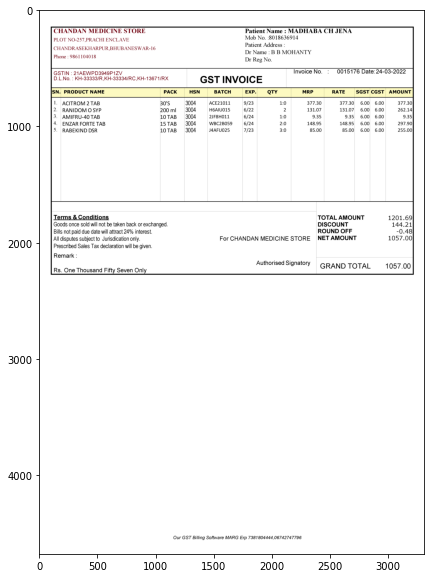


 {'Patient Name': 'MADHABA CH JENA', 'Patient Mobile Number': [9861104018], 'Patient Address': '', 'Date': '24-03-2022', 'Invoice Number': '0015176'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,ACITROM 2 TAB,30'S,3004,ACE21011,9/23,1:0,377.30,377.30,6.00,6.00,377.30
1,2.,RANIDOM O SYP,200 ml,3004,H6AIU015,6/22,2,131.07,131.07,6.00,6.00,262.14
2,3.,AMIFRU-40 TAB,10 TAB,3004,2JF8H011,6/24,1:0,9.35,9.35,6.00,6.00,9.35
3,4.,ENZAR EORTE TAB,15 TAB,3004,WBC2B059,6/24,2:0,148.95,148.95,6.00,6.00,297.90
4,5.,RABEKIND DSR,10 TAB,3004,J4AFU025,7/23,3:0,85.00,85.00,6.00,6.00,255.00



 {'TOTAL AMOUNT': 1201.69, 'DISCOUNT': 144.21, 'ROUND OFF': -0.48, 'NET AMOUNT E STORE': 1057.0, 'GRAND TOTAL': 1057.0} 


-----------------------------------------------------------------------------------------------------------------------

250-14-1649486642984.png


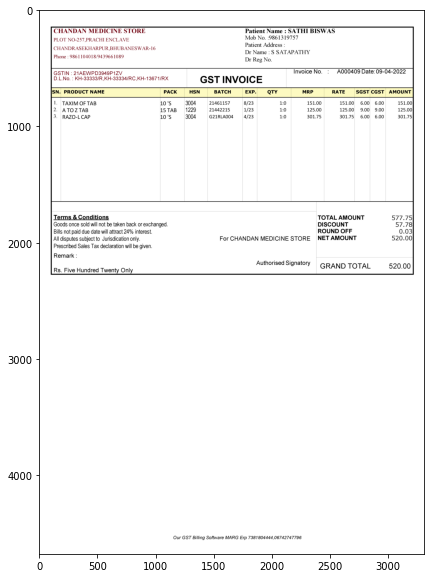


 {'Patient Name': 'SATH BISWAS', 'Patient Mobile Number': [], 'Patient Address': '', 'Date': '09-04-2022', 'Invoice Number': 'A000409'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,TAXIM OF TAB,10 'S,3004,21461157,8/23,1:0,151.00,151.00,6.00,6.00,151.00
1,2.,A TO Z TAB,15 TAB,1229,21442215,1/23,1:0,125.00,125.00,9.00,9.00,125.00
2,3.,RAZO-L CAP,10 'S,3004,G21RLA004,4/23,1:0,301.75,301.75,6.00,6.00,301.75



 {'TOTAL AMOUNT': 577.75, 'DISCOUNT': 57.78, 'ROUND OFF': 0.03, 'NET AMOUNT E STORE': 520.0, 'GRAND TOTAL': 520.0} 


-----------------------------------------------------------------------------------------------------------------------

250-16-1648891102111.png


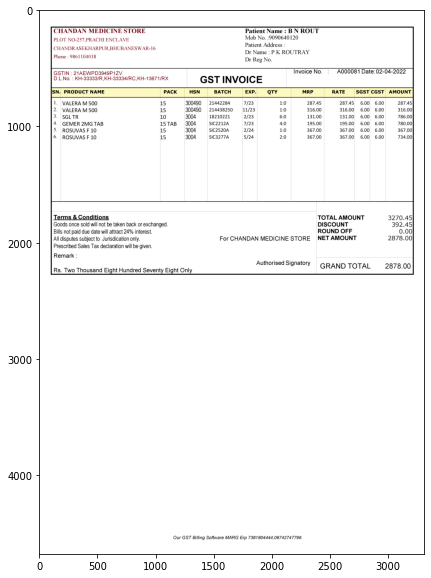


 {'Patient Name': 'B N ROUT', 'Patient Mobile Number': [9861104018], 'Patient Address': '', 'Date': '02-04-2022', 'Invoice Number': 'A000081'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,VALERA M 500,15,300490,21442284,7/23,1:0,287.45,287.45,6.00,6.00,287.45
1,2.,VALERA M 500,15,300490,214438250,11/23,1:0,316.00,316.00,6.00,6.00,316.00
2,3.,SGL TR,10,3004,18210221,2/23,6:0,131.00,131.00,6.00,6.00,786.00
3,4.,GEMER 2MG TAB,15 TAB,3004,SIC2212A,7/23,4:0,195.00,195.00,6.00,6.00,780.00
4,5.,ROSUVAS F 10,15,3004,SIC2520A,2/24,1:0,367.00,367.00,6.00,6.00,367.00
5,6.,ROSUVAS F 10,15,3004,SIC3277A,5/24,2:0,367.00,367.00,6.00,6.00,734.00



 {'TOTAL AMOUNT': 3270.45, 'DISCOUNT': 392.45, 'ROUND OFF': 0.0, 'NET AMOUNT E STORE': 2878.0, 'GRAND TOTAL': 2878.0} 


-----------------------------------------------------------------------------------------------------------------------

250-17-1648547065651.png


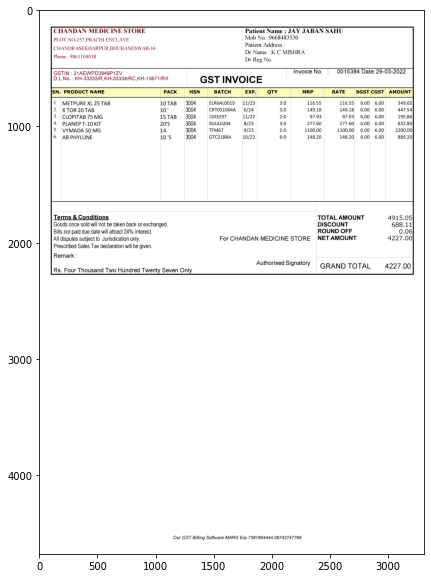


 {'Patient Name': 'JAY JABAN SAHU', 'Patient Mobile Number': [9861104018], 'Patient Address': '', 'Date': '29-03-2022', 'Invoice Number': '0015384'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,METPURE XL 25 TAB,10 TAB,3004,ELR6AL0019,11/23,3:0,116.55,116.55,6.00,6.00,349.65
1,2.,X TOR 20 TAB,10 .,3004,CRT051004A,6/24,3:0,149.18,149.18,6.00,6.00,447.54
2,3.,CLOPITAB 75 MG,15 TAB,3004,J103297,11/22,2:0,97.93,97.93,6.00,6.00,195.86
3,4.,PLANEP T-1O KIT,20'S,3004,SGUL0204,8/23,3:0,277.60,277.60,6.00,6.00,832.80
4,5.,VYMADA 50 MG,14,3004,TFM67,9/23,2:0,1100.00,1100.00,6.00,6.00,2200.00
5,6.,AB PHYLLINE,10 'S,3004,GTC2188A,10/23,6:0,148.20,148.20,6.00,6.00,889.20



 {'TOTAL AMOUNT': 4915.05, 'DISCOUNT': 688.11, 'ROUND OFF': 0.06, 'NET AMOUNT E STORE': 4227.0, 'GRAND TOTAL': 4227.0} 


-----------------------------------------------------------------------------------------------------------------------

250-43-1649686220179.png


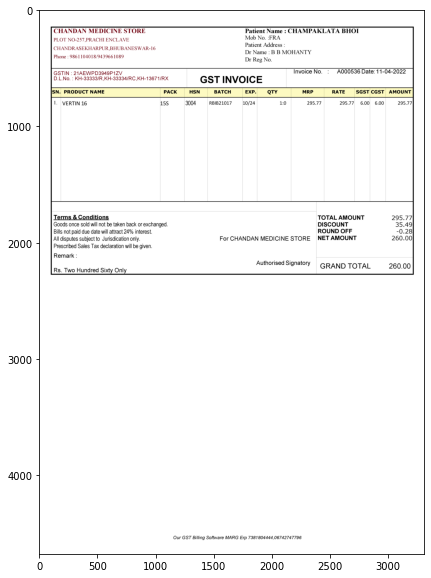


 {'Patient Name': 'CHAMPAKLATA BHOJ', 'Patient Mobile Number': [], 'Patient Address': '', 'Date': '11-04-2022', 'Invoice Number': 'A000536'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,VERTIN 16,15S,3004,RB|B21017,10/24,1:0,295.77,295.77,6.00,6.00,295.77



 {'TOTAL AMOUNT': 295.77, 'DISCOUNT': 35.49, 'ROUND OFF': -0.28, 'NET AMOUNT E STORE': 260.0, 'GRAND TOTAL': 260.0} 


-----------------------------------------------------------------------------------------------------------------------

253-1-1649743296696.png


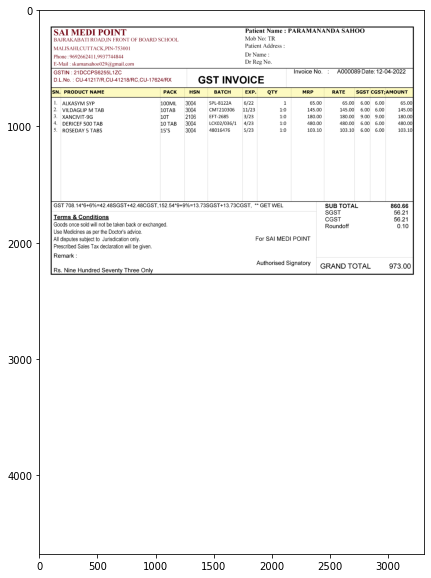


 {'Patient Name': 'PARAMANANDA SAHOO', 'Patient Mobile Number': [9692662411, 9937744844], 'Patient Address': '', 'Date': '12-04-2022', 'Invoice Number': 'A000089'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST;,AMOUnt
0,1.,ALKASYM SYF,100ML,3004,SPL-8122A,6/22,1,65.00,65.00,6.00,6.00,65.00
1,2.,VILDAGLIP M TAB,10TAB,3004,CMT210306,11/23,1:0,145.00,145.00,6.00,6.00,145.00
2,3.,XANCIVIT-9G,10T,2106,EFT-2685,3/23,1:0,180.00,180.00,9.00,9.00,180.00
3,4.,DERICEE 500 TAB,10 TAB,3004,LCK02/036/1,4/23,1:0,480.00,480.00,6.00,6.00,480.00
4,5.,ROSEDAY 5 TABS,15'S,3004,48016476,5/23,1:0,103.10,103.10,6.00,6.00,103.10



 {'SUB TOTAL': 860.66, 'SGST': 56.21, 'CGST': 56.21, 'Roundoff': 0.1, 'GRAND TOTAL': 973.0} 


-----------------------------------------------------------------------------------------------------------------------

253-2-1649329731802.png


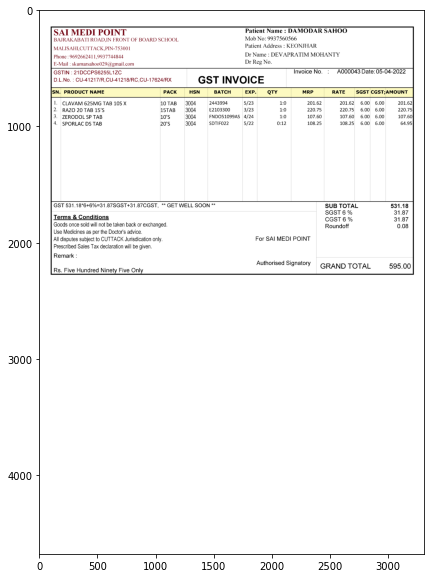


 {'Patient Name': 'DAMODAR SAHOO', 'Patient Mobile Number': [9937560566, 9692662411, 9937744844], 'Patient Address': 'KEONJHAR', 'Date': '05-04-2022', 'Invoice Number': 'A000043'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST;,AMoUnt
0,1.,CLAVAM 625MG TAB 10S X,10 TAB,3004,2443994,5/23,1:0,201.62,201.62,6.00,6.00,201.62
1,2.,RAZO 20 TAB 15'S,15TAB,3004,E2103300,3/23,1:0,220.75,220.75,6.00,6.00,220.75
2,3.,ZERODOL SP TAB,10'S,3004,FND051099AS,4/24,1:0,107.60,107.60,6.00,6.00,107.60
3,4.,SPORLAC DS TAB,20'S,3004,SDTIF022,5/22,0:12,108.25,108.25,6.00,6.00,64.95



 {'SUB TOTAL': 531.18, 'SGST 6 %': 31.87, 'CGST 6 %': 31.87, 'Roundoff': 0.08, 'GRAND TOTAL': 595.0} 


-----------------------------------------------------------------------------------------------------------------------

253-1-1649664140416.png


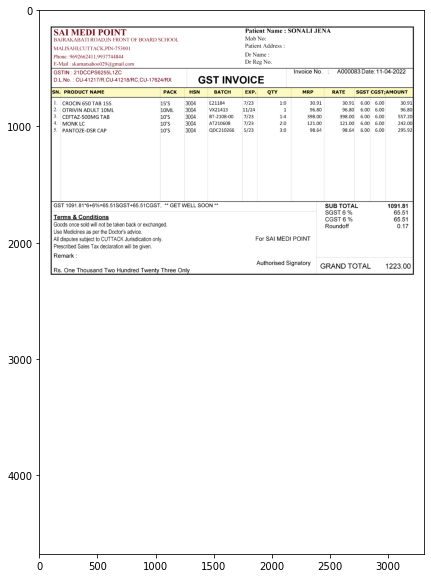


 {'Patient Name': 'SONALI JENA', 'Patient Mobile Number': [9692662411, 9937744844], 'Patient Address': '', 'Date': '11-04-2022', 'Invoice Number': 'A000083'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST;,AMoUnt
0,1.,CROCIN 650 TAB 15S,15'S,3004,E21184,7/23,1:0,30.91,30.91,6.00,6.00,30.91
1,2.,OTRIVIN ADULT 1OML,10ML,3004,VX21413,11/24,1,96.80,96.80,6.00,6.00,96.80
2,3.,CEFTAZ-5O0MG TAB,10'S,3004,BT-2108-00,7/23,1:4,398.00,398.00,6.00,6.00,557.20
3,4.,MONK LC,10'S,3004,AT210608,7/23,2:0,121.00,121.00,6.00,6.00,242.00
4,5.,PANTOZE-DSR CAP,10'S,3004,QDC210266,5/23,3:0,98.64,98.64,6.00,6.00,295.92



 {'SUB TOTAL': 1091.81, 'SGST 6 %': 65.51, 'CGST 6 %': 65.51, 'Roundoff': 0.17, 'GRAND TOTAL': 1223.0} 


-----------------------------------------------------------------------------------------------------------------------

254-1-1649059393928.png


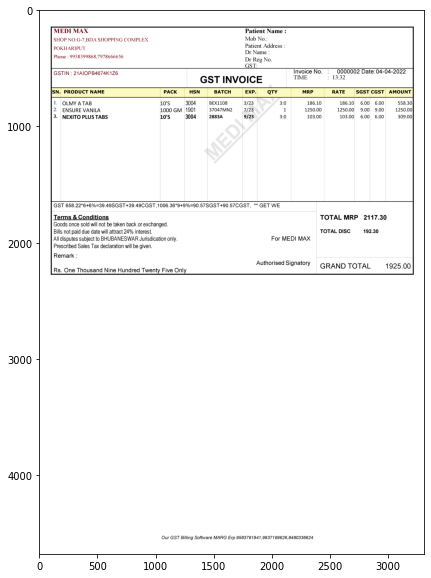


 {'Patient Name': '', 'Patient Mobile Number': [9938399868, 7978666656], 'Patient Address': '', 'Date': '04-04-2022', 'Invoice Number': '0000002'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,OLMY A TAB,10'S,3004,BEX1108,3/23,3:0,186.10,186.10,6.00,6.00,558.30
1,2.,ENSURE VANILA,1000 GM,1901,37047MN2,7/23,1,1250.00,1250.00,9.00,9.00,1250.00
2,3.,NEXITO PLUS TABS,10'S,3004,2883A,9/23,3:0,103.00,103.00,6.00,6.00,309.00



 {'TOTAL MRP': 2117.3, 'TOTAL DISC': 192.3, 'GRAND TOTAL': 1925.0} 


-----------------------------------------------------------------------------------------------------------------------

254-1-1647486353740.png


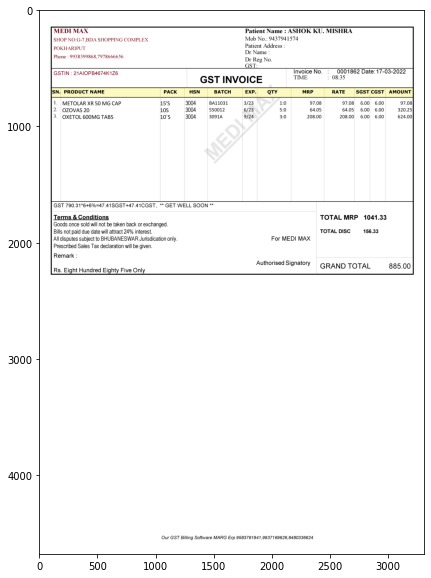


 {'Patient Name': 'ASHOK KU. MISHRA', 'Patient Mobile Number': [9437941574, 9938399868, 7978666656], 'Patient Address': '', 'Date': '17-03-2022', 'Invoice Number': '0001862'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,METOLAR XR 50 MG CAP,15'S,3004,BA11031,3/23,1:0,97.08,97.08,6.00,6.00,97.08
1,2.,OZOVAS 20,10S,3004,550012,6/23,5:0,64.05,64.05,6.00,6.00,320.25
2,3.,OXETOL 600MG TABS,10`S,3004,3091A,9/24,3:0,208.00,208.00,6.00,6.00,624.00



 {'TOTAL MRP': 1041.33, 'TOTAL DISC': 156.33, 'GRAND TOTAL': 885.0} 


-----------------------------------------------------------------------------------------------------------------------

254-4-1651993680098.png


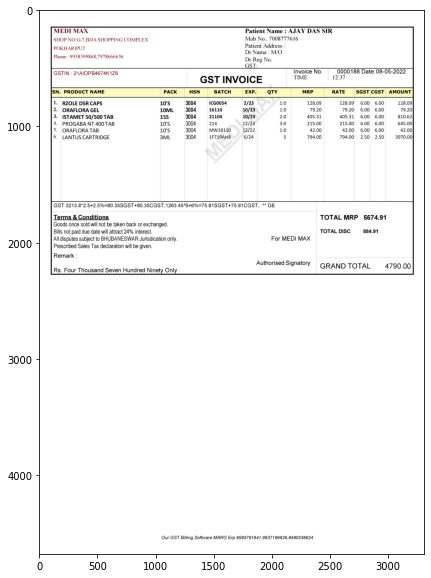


 {'Patient Name': 'AJAY DAS SIR', 'Patient Mobile Number': [7008777616, 9938399868, 7978666656], 'Patient Address': '', 'Date': '08-05-2022', 'Invoice Number': '0000188'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,RZOLE DSR CAPS,10'S,3004,ICG0054,2/23,1:0,128.09,128.09,6.00,6.00,128.09
1,2.,ORAFLORA GEL,10ML,3004,16110,10/23,1:0,79.20,79.20,6.00,6.00,79.20
2,3.,ISTAMET 50/500 TAB,15S,3004,21104,10/23,2:0,405.31,405.31,6.00,6.00,810.62
3,4.,PROGABA NT 4O0 TAB,10'S,3004,214,12/23,3:0,215.00,215.00,6.00,6.00,645.00
4,5.,ORAFLORATAB,10'S,3004,MW18110,12/22,1:0,42.00,42.00,6.00,6.00,42.00
5,6.,LANTUS CARTRIDGE,3ML,3004,1F719AHB,6/24,5,794.00,794.00,2.50,2.50,3970.00



 {'TOTAL MRP': 5674.91, 'TOTAL DISC': 884.91, 'GRAND TOTAL': 4790.0} 


-----------------------------------------------------------------------------------------------------------------------

254-4-1650291635181.png


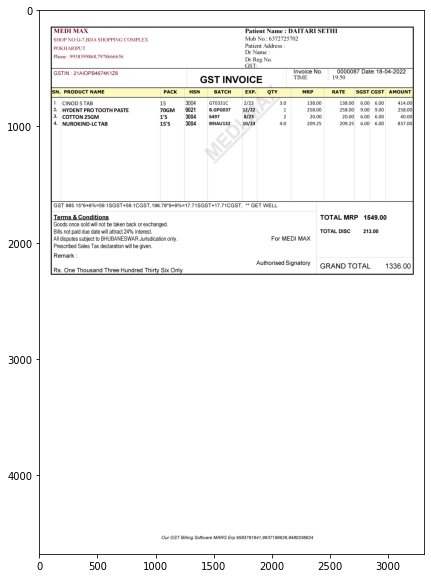


 {'Patient Name': 'DAITARI SETH', 'Patient Mobile Number': [6372725702, 9938399868, 7978666656], 'Patient Address': '', 'Date': '18-04-2022', 'Invoice Number': '0000087'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,CINOD 5 TAB,15,3004,GT0331C,2/23,3:0,138.00,138.00,6.00,6.00,414.00
1,2.,HYDENT PRO TOOTH PASTE,70GM,9021,B.GPG037,12/22,1,258.00,258.00,9.00,9.00,258.00
2,3.,COTTON 25GM,1'S,3004,6497,8/23,2,20.00,20.00,6.00,6.00,40.00
3,4.,NUROKIND-LC TAB,15'S,3004,B9IAU132,10/23,4:0,209.25,209.25,6.00,6.00,837.00



 {'TOTAL MRP': 1549.0, 'TOTAL DISC': 213.0, 'GRAND TOTAL': 1336.0} 


-----------------------------------------------------------------------------------------------------------------------

254-5-1651993805492.png


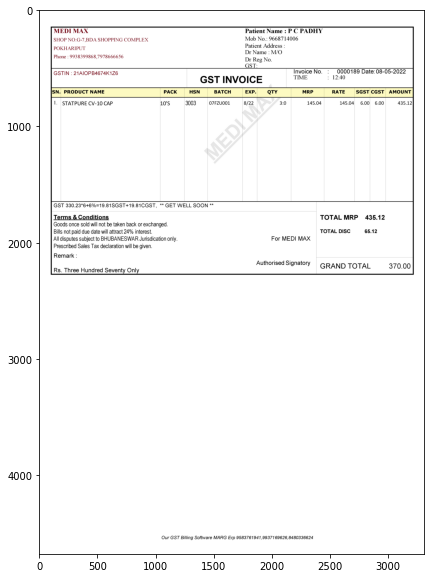


 {'Patient Name': 'P C PADHY', 'Patient Mobile Number': [9668714006, 9938399868, 7978666656], 'Patient Address': '', 'Date': '08-05-2022', 'Invoice Number': '0000189'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,STATPURE CV-10 CAP,10'S,3003,07FZU001,8/22,3:0,145.04,145.04,6.00,6.00,435.12



 {'TOTAL MRP': 435.12, 'TOTAL DISC': 65.12, 'GRAND TOTAL': 370.0} 


-----------------------------------------------------------------------------------------------------------------------

259-1-1649074653866.png


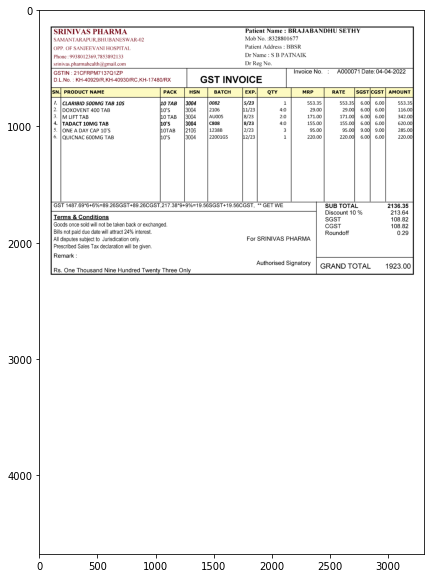


 {'Patient Name': 'BRAJABANDHU SETHY', 'Patient Mobile Number': [9938012369, 7853892133], 'Patient Address': 'BBSR', 'Date': '04-04-2022', 'Invoice Number': 'A000071'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnt
0,1.,CLARBD 500MG TAB 10S,10 TAB,3004,0082,5/23,1,553.35,553.35,6.00,6.00,553.35
1,2.,DOXOVENT 400 TAB,10'S,3004,2106,11/23,4:0,29.00,29.00,6.00,6.00,116.00
2,3.,M LIFT TAB,10 TAB,3004,AU005,8/23,2:0,171.00,171.00,6.00,6.00,342.00
3,4.,TADACT 1OMG TAB,10'S,3004,C808,8/23,4:0,155.00,155.00,6.00,6.00,620.00
4,5.,ONE A DAY CAP 10'S,10TAB,2106,1238B,2/23,3,95.00,95.00,9.00,9.00,285.00
5,6.,QUICNAC 60OMG TAB,10'S,3004,22001GS,12/23,1,220.00,220.00,6.00,6.00,220.00



 {'suB totAL': 2136.35, 'Discount 10 %': 213.64, 'SGST': 108.82, 'CGST': 108.82, 'Roundoff': 0.29, 'GRAND TOTAL': 1923.0} 


-----------------------------------------------------------------------------------------------------------------------

259-2-1649088665185.png


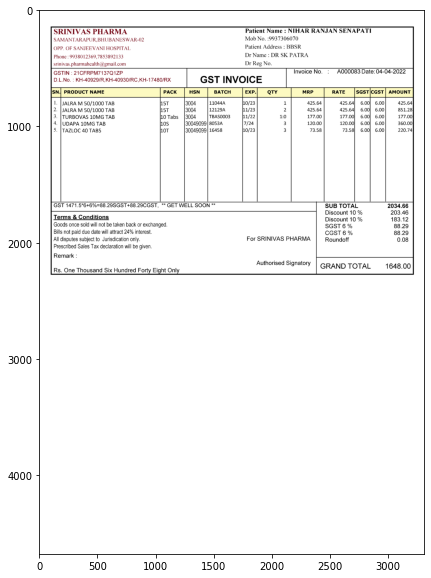


 {'Patient Name': 'NIHAR RANJAN SENAPAT', 'Patient Mobile Number': [9938012369, 7853892133], 'Patient Address': 'BBSR', 'Date': '04-04-2022', 'Invoice Number': 'A000083'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnt
0,1.,JALRA M 50/1000 TAB,15T,3004,11044A,10/23,1,425.64,425.64,6.00,6.00,425.64
1,2.,JALRA M 50/1000 TAB,15T,3004,12129A,11/23,2,425.64,425.64,6.00,6.00,851.28
2,3.,TURBOVAS 1OMG TAB,10 Tabs,3004,TBAS0003,11/22,1:0,177.00,177.00,6.00,6.00,177.00
3,4.,UDAPA 1OMG TAB,10S,30049099,8053A,7/24,3,120.00,120.00,6.00,6.00,360.00
4,5.,TAZLOC 40 TABS,10T,30049099,16458,10/23,3,73.58,73.58,6.00,6.00,220.74



 {'SUB tOTAL': 2034.66, 'Discount 1o %': 203.46, 'Discount 10 %': 183.12, 'SGST 6 %': 88.29, 'CGST 6 %': 88.29, 'PHARMA Roundoff': 0.08, 'GRAND TOTAL': 1648.0} 


-----------------------------------------------------------------------------------------------------------------------

259-2-1651993412060.png


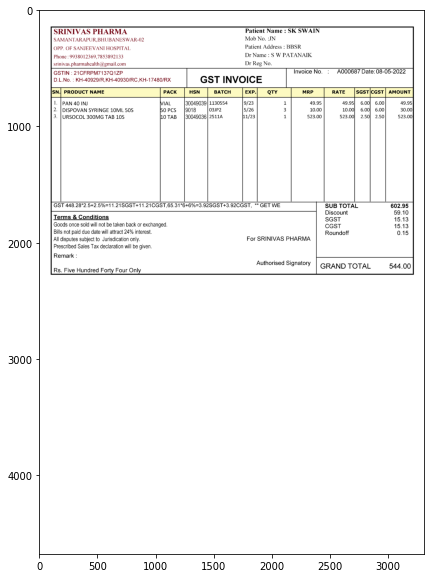


 {'Patient Name': 'SK SWAIN', 'Patient Mobile Number': [9938012369, 7853892133], 'Patient Address': 'BBSR', 'Date': '08-05-2022', 'Invoice Number': 'A000687'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnt
0,1.,PAN 4O INJ,VIAL,30049039,1130554,9/23,1,49.95,49.95,6.00,6.00,49.95
1,2.,DISPOVAN SYRINGE 10ML 50S,50 PCS,9018,03JP2,5/26,3,10.00,10.00,6.00,6.00,30.00
2,3.,URSOCOL 300MG TAB 10S,10 TAB,30049036,2511A,11/23,1,523.00,523.00,2.50,2.50,523.00



 {'SUB TOTAL': 602.95, 'Discount': 59.1, 'SGST': 15.13, 'CGST': 15.13, 'Roundoff': 0.15, 'GRAND TOTAL': 544.0} 


-----------------------------------------------------------------------------------------------------------------------

259-1-1649997129057.png


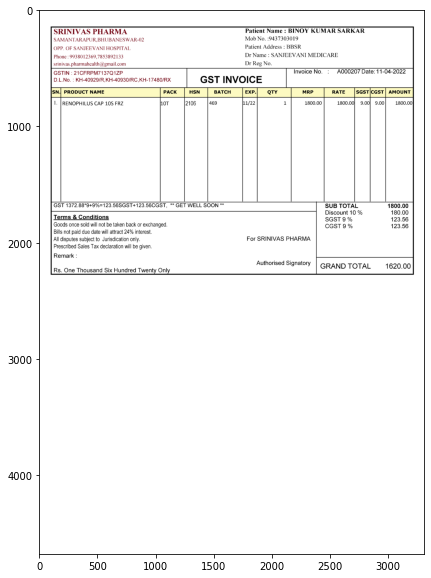


 {'Patient Name': 'BINOY KUMAR SARKAR', 'Patient Mobile Number': [9938012369, 7853892133], 'Patient Address': 'BBSR', 'Date': '11-04-2022', 'Invoice Number': 'A000207'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnt
0,1.,RENOPHILUS CAP 10S ERZ,10T,2106,469,11/22,1,1800.00,1800.00,9.00,9.00,1800.00



 {'SUB tOTAL': 1800.0, 'Discount 10 %': 180.0, 'SGST 9 %': 123.56, 'CGST 9 %': 123.56, 'GRAND TOTAL': 1620.0} 


-----------------------------------------------------------------------------------------------------------------------

259-1-1651650429362.png


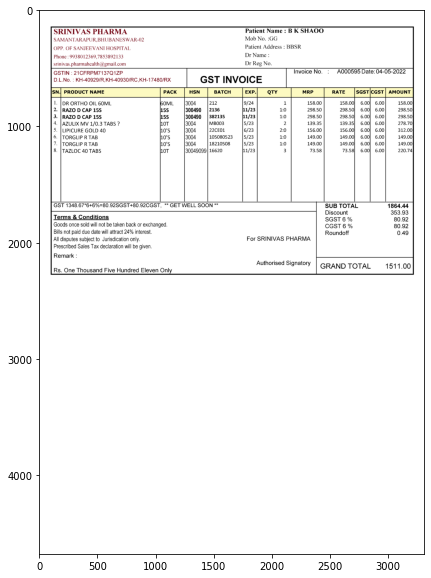


 {'Patient Name': 'B K SHAOO', 'Patient Mobile Number': [9938012369, 7853892133], 'Patient Address': 'BBSR', 'Date': '04-05-2022', 'Invoice Number': 'A000595'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnt
0,1.,DR ORTHO OIL6OML,60ML,3004,212,9/24,1,158.00,158.00,6.00,6.00,158.00
1,2.,RAZO D CAP 15S,15S,300490,2136,11/23,1:0,298.50,298.50,6.00,6.00,298.50
2,3.,RAZO D CAP 15S,15S,300490,382135,11/23,1:0,298.50,298.50,6.00,6.00,298.50
3,4.,AzULIX MV 1/0.3 TABS ?,10T,3004,MB003,5/23,2,139.35,139.35,6.00,6.00,278.70
4,5.,LIPICURE GOLD 40,10'S,3004,22CE01,6/23,2:0,156.00,156.00,6.00,6.00,312.00
5,6.,TORGLIP R TAB,10'S,3004,105080523,5/23,1:0,149.00,149.00,6.00,6.00,149.00
6,7.,TORGLIP R TAB,10'S,3004,18210508,5/23,1:0,149.00,149.00,6.00,6.00,149.00
7,8.,TAZLOG 40 TABS,10T,30049099,16620,11/23,3,73.58,73.58,6.00,6.00,220.74



 {'SUB tOTAL': 1864.44, 'Discount': 353.93, 'SGST 6 %': 80.92, 'CGST 6 %': 80.92, 'Roundoff': 0.49, 'GRAND TOTAL': 1511.0} 


-----------------------------------------------------------------------------------------------------------------------

261-5-1648220973969.png


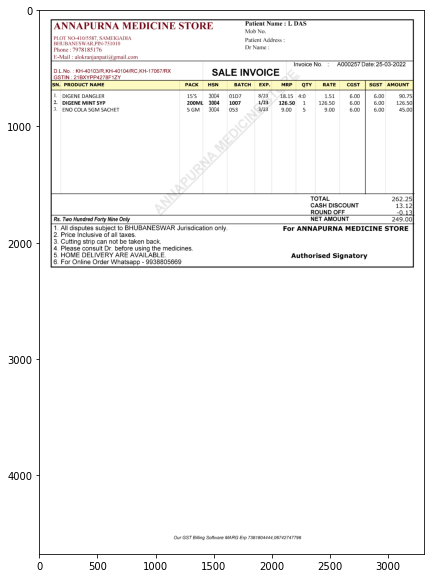


 {'Patient Name': 'L DAS', 'Patient Mobile Number': [7978185176], 'Patient Address': '', 'Date': '25-03-2022', 'Invoice Number': 'A000257'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,MRP,QTY,RATE,CGST,SGST,AMoUnt
0,1.,DIGENE DANGLER,15'S,3004,01D7,8/23,18.15,4:0,1.51,6.00,6.00,90.75
1,2.,DIGENE MINT SYP,200ML,3004,1007,1/23,126.50,1,126.50,6.00,6.00,126.50
2,3.,ENO COLA 5GM SACHET,5 GM,3004,053,3/23,9.00,5,9.00,6.00,6.00,45.00



 {'TOTAL': 262.25, 'CASH DISCOUNT': 13.12, 'ROUND OFE': -0.13, 'NET AMOUNT': 249.0} 


-----------------------------------------------------------------------------------------------------------------------

267-62-1650023187503.png


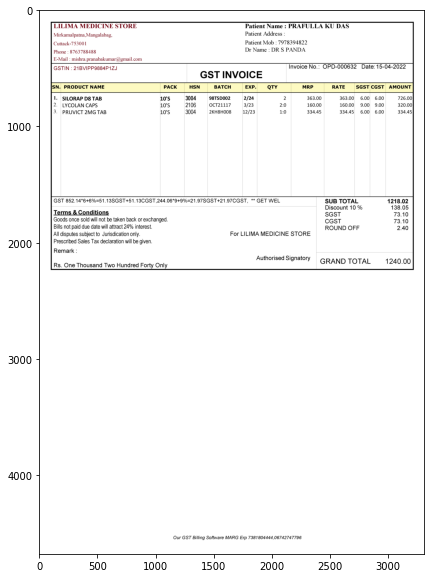


 {'Patient Name': 'PRAFULLA KU DAS', 'Patient Mobile Number': [7978394822, 8763788488], 'Patient Address': '', 'Date': '15-04-2022', 'Invoice Number': 'OPD-000632'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,SILORAP D8 TAB,10'S,3004,98TSD002,2/24,2,363.00,363.00,6.00,6.00,726.00
1,2.,LYCOLAN CAPS,10'S,2106,0CT21117,3/23,2:0,160.00,160.00,9.00,9.00,320.00
2,3.,PRUVICT 2MG TAB,10'S,3004,2KH8H008,12/23,1:0,334.45,334.45,6.00,6.00,334.45



 {'SUB TOTAL': 1218.02, 'Discount 10 %': 138.05, 'SGST': 73.1, 'CGST': 73.1, 'ROUND OFE': 2.4, 'GRAND TOTAL': 1240.0} 


-----------------------------------------------------------------------------------------------------------------------

267-9-1649238181357.png


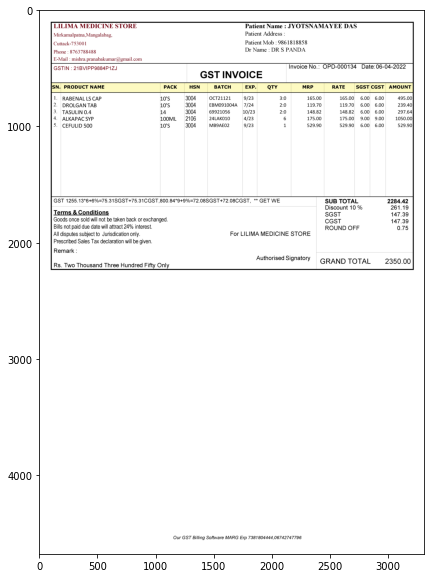


 {'Patient Name': 'JYOTSNAMAYEE DAS', 'Patient Mobile Number': [9861818858, 8763788488], 'Patient Address': '', 'Date': '06-04-2022', 'Invoice Number': 'OPD-000134'} 



,SN.,PRODUCt NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,RABENALLS CAP,10'S,3004,0CT21121,9/23,3:0,165.00,165.00,6.00,6.00,495.00
1,2.,DROLGANTAB,10'S,3004,EBM091004A,7/24,2:0,119.70,119.70,6.00,6.00,239.40
2,3.,TASULIN 0.4,14,3004,69921056,10/23,2:0,148.82,148.82,6.00,6.00,297.64
3,4.,ALKAPAC SYP,100ML,2106,24LAK010,4/23,6,175.00,175.00,9.00,9.00,1050.00
4,5.,CEFULID 500,10'S,3004,MB9AE02,9/23,1,529.90,529.90,6.00,6.00,529.90



 {'SUB TOTAL': 2284.42, 'Discount 10 %': 261.19, 'SGST': 147.39, 'CGST': 147.39, 'ROUND OFE': 0.75, 'GRAND TOTAL': 2350.0} 


-----------------------------------------------------------------------------------------------------------------------

267-4-1650001878522.png


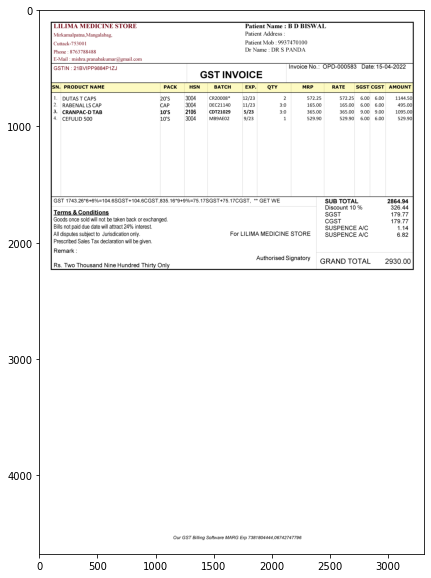


 {'Patient Name': 'B D BISWAL', 'Patient Mobile Number': [9937470100, 8763788488], 'Patient Address': '', 'Date': '15-04-2022', 'Invoice Number': 'OPD-000583'} 



,SN.,PRODUCt NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,DUTAS T CAPS,20'S,3004,CR20008*,12/23,2,572.25,572.25,6.00,6.00,1144.50
1,2.,RABENALLS CAP,CAP,3004,DEC21140,11/23,3:0,165.00,165.00,6.00,6.00,495.00
2,3.,CRANPAC-D TAB,10'S,2106,CDT21029,5/23,3:0,365.00,365.00,9.00,9.00,1095.00
3,4.,CEFULID 500,10'S,3004,MB9AE02,9/23,1,529.90,529.90,6.00,6.00,529.90



 {'SUB tOtAL': 2864.94, 'Discount 10 %': 326.44, 'SGST': 179.77, 'CGST': 179.77, 'SUSPENCE AVC': 1.14, 'E STORE SUSPENCE AC': 6.82, 'GRAND TOTAL': 2930.0} 


-----------------------------------------------------------------------------------------------------------------------

267-4-1650780718547.png


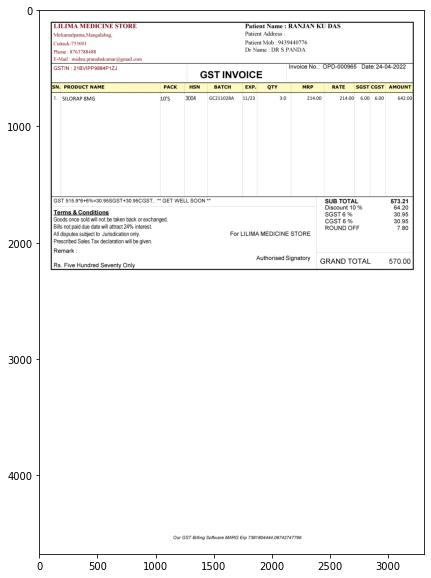


 {'Patient Name': 'RANJAN KU DAS', 'Patient Mobile Number': [9439440776, 8763788488], 'Patient Address': '', 'Date': '24-04-2022', 'Invoice Number': 'OPD-000965'} 



,SN.,PRODUCt NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,SILORAP 8MG,10'S,3004,GC211028A,11/23,3:0,214.00,214.00,6.00,6.00,642.00



 {'SUB TOTAL': 573.21, 'Discount 10 %': 64.2, 'SGST 6 %': 30.95, 'CGST 6 %': 30.95, 'ROUND OFE': 7.8, 'GRAND TOTAL': 570.0} 


-----------------------------------------------------------------------------------------------------------------------

267-22-1650364599839.png


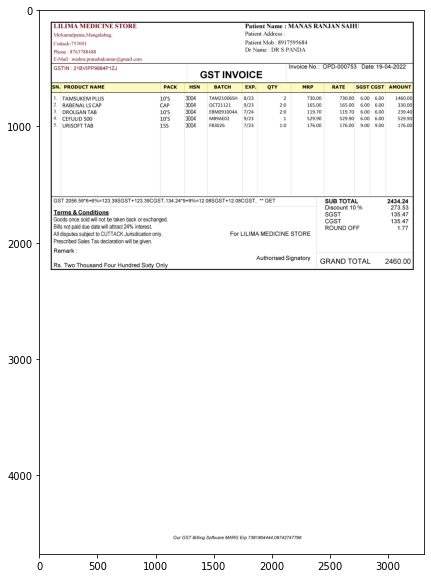


 {'Patient Name': 'MANAS RANJAN SAHU', 'Patient Mobile Number': [8917595684, 8763788488], 'Patient Address': '', 'Date': '19-04-2022', 'Invoice Number': 'OPD-000753'} 



,SN.,PRODUCt NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUNT
0,1.,TAMSUKEM PLUS,10'S,3004,TAM21006SH,8/23,2,730.00,730.00,6.00,6.00,1460.00
1,2.,RABENALLS CAP,CAP,3004,0CT21121,9/23,2:0,165.00,165.00,6.00,6.00,330.00
2,3.,DROLGANTAB,10'S,3004,EBM091004A,7/24,2:0,119.70,119.70,6.00,6.00,239.40
3,4.,CEFULID 500,10'S,3004,MB9AE02,9/23,1,529.90,529.90,6.00,6.00,529.90
4,5.,URISOFT TAB,15S,3004,FB3026,7/23,1:0,176.00,176.00,9.00,9.00,176.00



 {'SUB TOTAL': 2434.24, 'Discount 10 %': 273.53, 'SGST': 135.47, 'CGST': 135.47, 'ROUND OFE': 1.77, 'GRAND TOTAL': 2460.0} 


-----------------------------------------------------------------------------------------------------------------------

268-1-1649851550469.png


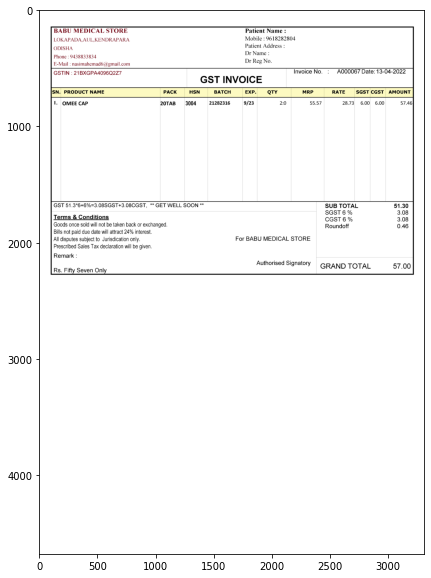


 {'Patient Name': '', 'Patient Mobile Number': [9618282804, 9438833834], 'Patient Address': '', 'Date': '13-04-2022', 'Invoice Number': 'A000067'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,OMEE CAP,20TAB,3004,21282316,9/23,2:0,55.57,28.73,6.00,6.00,57.46



 {'SUB TOTAL': 51.3, 'SGST 6 %': 3.08, 'CGST 6 %': 3.08, 'Roundoff': 0.46, 'GRAND TOTAL': 57.0} 


-----------------------------------------------------------------------------------------------------------------------

268-2-1649912625973.png


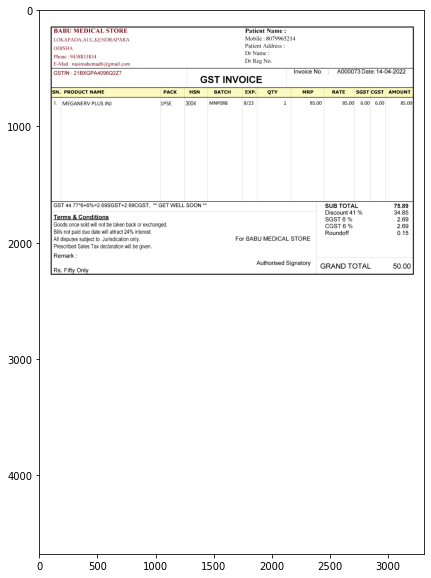


 {'Patient Name': '', 'Patient Mobile Number': [8079965214, 9438833834], 'Patient Address': '', 'Date': '14-04-2022', 'Invoice Number': 'A000073'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,SGST,CGST,AMOUnT
0,1.,MEGANERV PLUS INJ,1PSE,3004,MNP08B,8/23,1,85.00,85.00,6.00,6.00,85.00



 {'SuB tOtAL': 75.89, 'Discount 41 %': 34.85, 'SGST 6 %': 2.69, 'CGST 6 %': 2.69, 'Roundoff': 0.15, 'GRAND TOTAL': 50.0} 


-----------------------------------------------------------------------------------------------------------------------

269-27-1648642580807.png


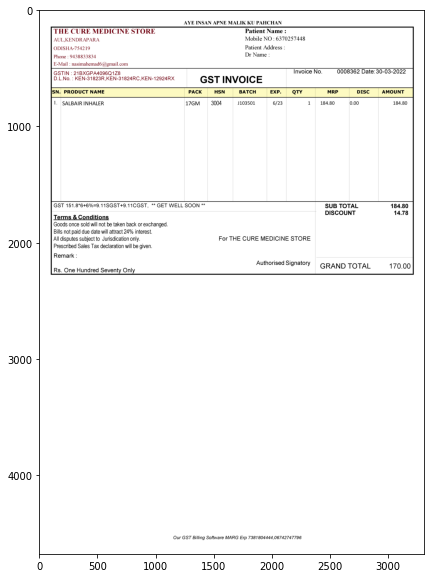


 {'Patient Name': '', 'Patient Mobile Number': [6370257448, 9438833834], 'Patient Address': '', 'Date': '30-03-2022', 'Invoice Number': '0008362'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DISC,AMOUNT
0,1.,SALBAIRINHALER,17GM,3004,J103501,6/23,1,184.80,0.00,184.80



 {'SUB TOTAL': 184.8, 'DISCOUNT': 14.78, 'GRAND TOTAL': 170.0} 


-----------------------------------------------------------------------------------------------------------------------

269-1-1648776098605.png


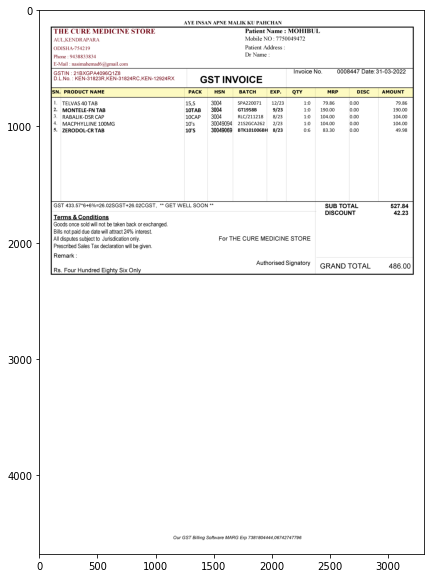


 {'Patient Name': 'MOHIBU', 'Patient Mobile Number': [7750049472, 9438833834], 'Patient Address': '', 'Date': '31-03-2022', 'Invoice Number': '0008447'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DISC,AMOUNT
0,1.,TELVAS 40 TAB,"15,S",3004,SPA220071,12/23,1:0,79.86,0.00,79.86
1,2.,MONTELE-FN TAB,10TAB,3004,GT1958B,9/23,1:0,190.00,0.00,190.00
2,3.,RABALIK-DSR CAP,10CAP,3004,RLC/211218,8/23,1:0,104.00,0.00,104.00
3,4.,MACPHYLLINE 1OOMG,10's,30049094,21S2GCA262,2/23,1:0,104.00,0.00,104.00
4,5.,ZERODOL-CR TAB,10'S,30049069,BTK101006B1,8/23,0:6,83.30,0.00,49.98



 {'SUB TOTAL': 527.84, 'DISCOUNT': 42.23, 'GRAND TOTAL': 486.0} 


-----------------------------------------------------------------------------------------------------------------------

269-32-1648649338169.png


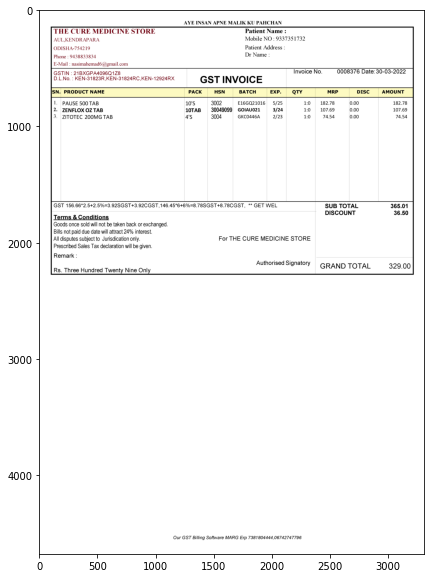


 {'Patient Name': '', 'Patient Mobile Number': [9337351732, 9438833834], 'Patient Address': '', 'Date': '30-03-2022', 'Invoice Number': '0008376'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DISC,AMOUNT
0,1.,PAUSE 500 TAB,10'S,3002,E16GQ21016,5/25,1:0,182.78,0.00,182.78
1,2.,ZENFLOX OZ TAB,10TAB,30049099,G0IAU021,3/24,1:0,107.69,0.00,107.69
2,3.,ZITOTEC 200MG TAB,4'S,3004,GKC0446A,2/23,1:0,74.54,0.00,74.54



 {'SUB TOTAL': 365.01, 'DISCOUNT': 36.5, 'GRAND TOTAL': 329.0} 


-----------------------------------------------------------------------------------------------------------------------

269-1-1650767553050.png


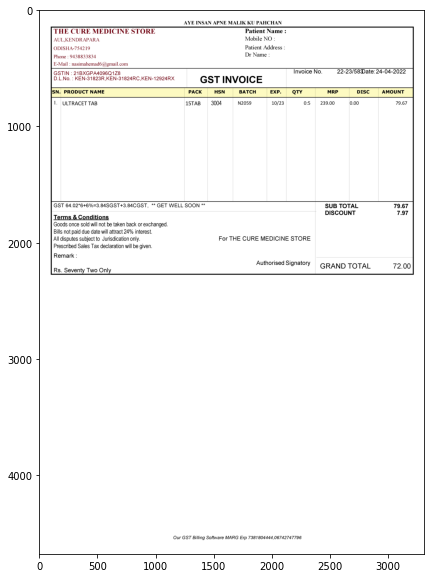


 {'Patient Name': '', 'Patient Mobile Number': [9438833834], 'Patient Address': '', 'Date': '24-04-2022', 'Invoice Number': '22-23/583'} 



,SN.,PRODUCt NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DISC,AMOUNT
0,1.,ULTRACET TAB,15TAB,3004,N2059,10/23,0:5,239.00,0.00,79.67



 {'SUB TOTAL': 79.67, 'DISCOUNT': 7.97, 'GRAND TOTAL': 72.0} 


-----------------------------------------------------------------------------------------------------------------------

270-2-1651937960570.png


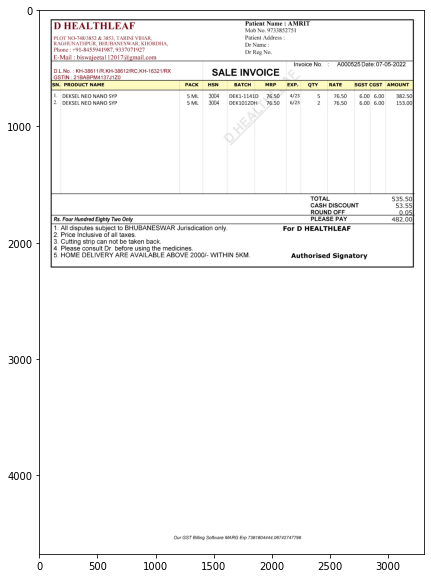


 {'Patient Name': '', 'Patient Mobile Number': [9733852751, 9337071927], 'Patient Address': '', 'Date': '07-05-2022', 'Invoice Number': 'A000525'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,MRP,EXP.,QTY,RATE,SGST,CGST,AMOUNT
0,1.,DEKSEL NEO NANO SYP,5 ML,3004,DEK1-1141,76.50,4/23,5,76.50,6.00,6.00,382.50
1,2.,DEKSEL NEO NANO SYP,5 ML,3004,DEK1012D,H,6/23,2,76.50,6.00,6.00,153.00



 {'TOTAL': 535.5, 'CASH DISCOUNT': 53.55, 'ROUND OFE': 0.05, 'PLEASE PAY': 482.0} 


-----------------------------------------------------------------------------------------------------------------------

270-3-1648800816594.png


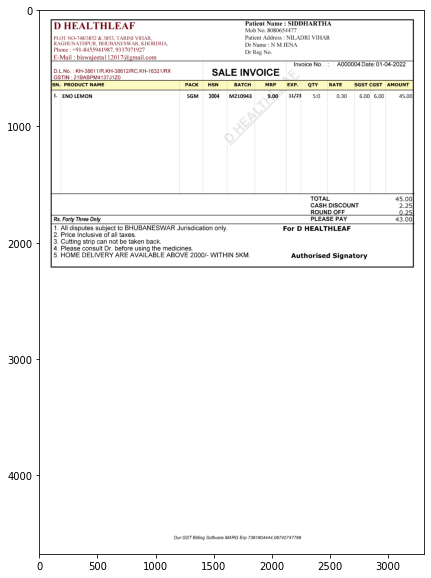


 {'Patient Name': 'SIDDHARTHA', 'Patient Mobile Number': [8080654477, 9337071927], 'Patient Address': 'NILADRI VIHAR', 'Date': '01-04-2022', 'Invoice Number': 'A000004'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,MRP,EXP.,QTY,RATE,SGST,CGST,AMOUNT
0,1.,ENO LEMON,5GM,3004,M210943,9.00,11/23,5:0,0.30,6.00,6.00,45.00



 {'TOTAL': 45.0, 'CASH DISCOUNT': 2.25, 'ROUND OFE': 0.25, 'PLEASE PAY': 43.0} 


-----------------------------------------------------------------------------------------------------------------------

270-1-1651387844239.png


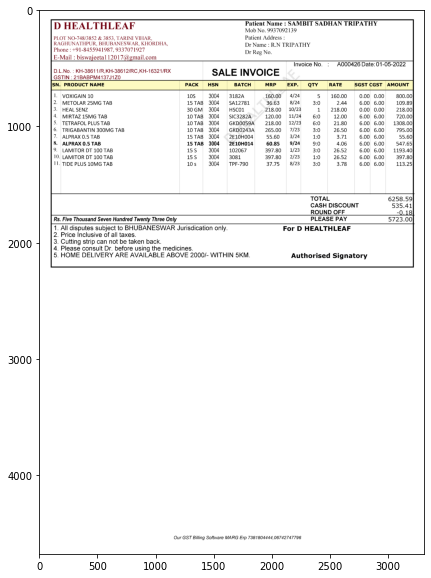


 {'Patient Name': 'SAMBIT SADHAN TRIPATHY', 'Patient Mobile Number': [9937092139, 9337071927], 'Patient Address': '', 'Date': '01-05-2022', 'Invoice Number': 'A000426'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,MRP,EXP.,QTY,RATE,SGST,CGST,AMOUNT
0,1.,VOXIGAIN 10,10S,3004,3182A,160.00,4/24,5,160.00,0.00,0.00,800.00
1,2.,METOLAR 25MG TAB,15 TAB,3004,SA12781,36.63,8/24,3:0,2.44,6.00,6.00,109.89
2,3.,HEAL SENZ,30 GM,3004,HSC01,218.00,10/23,1,218.00,0.00,0.00,218.00
3,4.,MIRTAZ 15MG TAB,10 TAB,3004,SIC3282A,120.00,11/24,6:0,12.00,6.00,6.00,720.00
4,5.,TETRAFOL PLUS TAB,10 TAB,3004,GKD0059A,218.00,12/23,6:0,21.80,6.00,6.00,1308.00
5,6.,TRIGABANTIN 3OOMG TAB,10 TAB,3004,GKD0243A,265.00,7/23,3:0,26.50,6.00,6.00,795.00
6,7.,ALPRAX 0.5 TAB,15 TAB,3004,2E10H004,55.60,3/24,1:0,3.71,6.00,6.00,55.60
7,8.,ALPRAX 0.5 TAB,15 TAB,3004,2E10H014,60.85,9/24,9:0,4.06,6.00,6.00,547.65
8,9.,LAMITOR DT 100 TAB,15 S,3004,102067,397.80,1/23,3:0,26.52,6.00,6.00,1193.40
9,10.,LAMITOR DT 100 TAB,15 S,3004,3081,397.80,2/23,1:0,26.52,6.00,6.00,397.80



 {'TOTAL': 6258.59, 'CASH DISCOUNT': 535.41, 'ROUND OFE': -0.18, 'PLEASE PAY': 5723.0} 


-----------------------------------------------------------------------------------------------------------------------

274-329-1650349333676.png


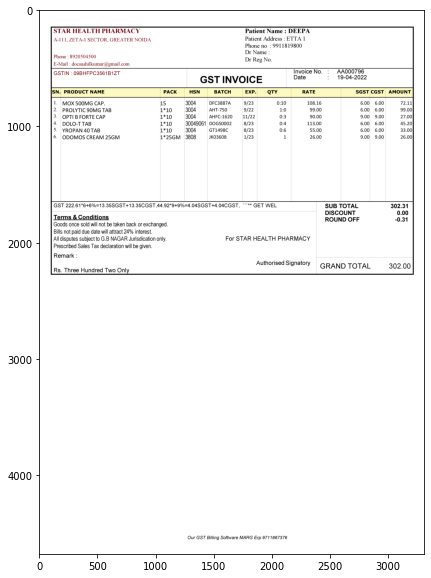


 {'Patient Name': 'DEEPA', 'Patient Mobile Number': [9911819800, 8920504500], 'Patient Address': 'ETTA 1', 'Date': 'VOICE 19-04-2022', 'Invoice Number': 'AA000796'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,RATE,SGST,CGST,AMOUNT
0,1.,MOX 500MG CAP.,15,3004,DFC3887A,9/23,0:10,108.16,6.00,6.00,72.11
1,2.,PROLYTIC 9OMG TAB,1*10,3004,AHT-750,9/22,1:0,99.00,6.00,6.00,99.00
2,3.,OPTIB FORTE CAP,1*10,3004,AHFC-1620,11/22,0:3,90.00,9.00,9.00,27.00
3,4.,DOLO-T TAB,1*10,30049061,DOGS0002,8/23,0:4,113.00,6.00,6.00,45.20
4,5.,YROPAN 40 TAB,1*10,3004,GT1498C,8/23,0:6,55.00,6.00,6.00,33.00
5,6.,ODOMOS CREAM 25GM,1*25GM,3808,JK03608,1/23,1,26.00,9.00,9.00,26.00



 {'SUB TOTAL': 302.31, 'DISCOUNT': 0.0, 'ROUND OFF': -0.31, 'GRAND TOTAL': 302.0} 


-----------------------------------------------------------------------------------------------------------------------

274-498-1650478978038.png


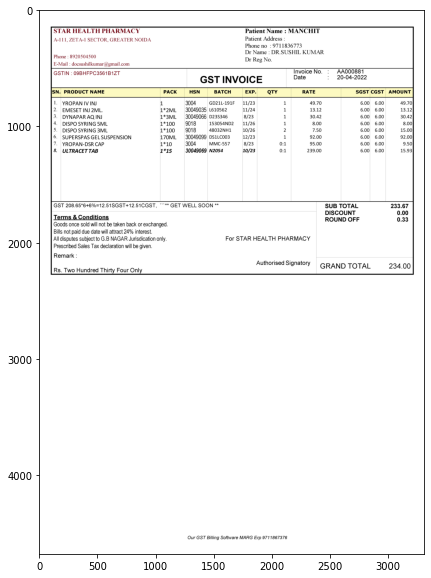


 {'Patient Name': 'MANCHIT', 'Patient Mobile Number': [9711836773, 8920504500], 'Patient Address': '', 'Date': 'VOICE 20-04-2022', 'Invoice Number': 'AA000881'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,RATE,SGST,CGST,AMOUNT
0,1.,YROPANIVINJ,1,3004,GD21L-191F,11/23,1,49.70,6.00,6.00,49.70
1,2.,EMESET INJ 2ML,1*2ML,30049035,L610562,11/24,1,13.12,6.00,6.00,13.12
2,3.,DYNAPAR AQINJ,1*3ML,30049066,D23S346,8/23,1,30.42,6.00,6.00,30.42
3,4.,DISPO SYRING 5ML,1*100,9018,153054ND2,11/26,1,8.00,6.00,6.00,8.00
4,5.,DISPO SYRING 3ML,1*100,9018,48032NH1,10/26,2,7.50,6.00,6.00,15.00
5,6.,SUPERSPAS GELSUSPENSION,170ML,30049099,DS1LC003,12/23,1,92.00,6.00,6.00,92.00
6,7.,YROPAN-DSR CAP,1*10,3004,MMC-557,8/23,0:1,95.00,6.00,6.00,9.50
7,8.,ULTRACET TAB,1*15,30049069,N2054,10/23,0:1,239.00,6.00,6.00,15.93



 {'SUB TOTAL': 233.67, 'DISCOUNT': 0.0, 'ROUND OFF': 0.33, 'GRAND TOTAL': 234.0} 


-----------------------------------------------------------------------------------------------------------------------

274-573-1650552910850.png


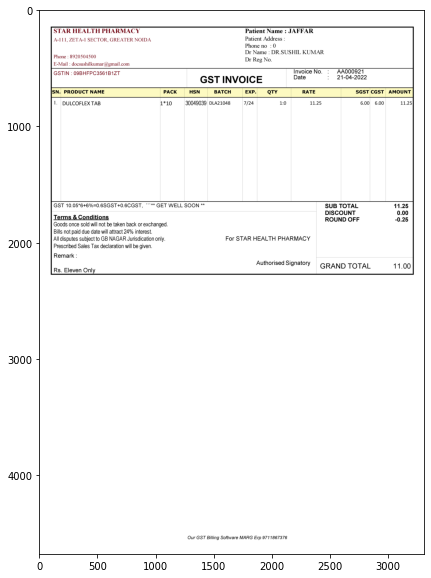


 {'Patient Name': 'JAFFAR', 'Patient Mobile Number': [8920504500], 'Patient Address': '', 'Date': 'VOICE 21-04-2022', 'Invoice Number': 'AA000921'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,RATE,SGST,CGST,AMOUNT
0,1.,DULCOFLEX TAB,1*10,30049039,DLA21048,7/24,1:0,11.25,6.00,6.00,11.25



 {'SUB TOTAL': 11.25, 'DISCOUNT': 0.0, 'ROUND OFF': -0.25, 'GRAND TOTAL': 11.0} 


-----------------------------------------------------------------------------------------------------------------------

274-84-1651148871573.png


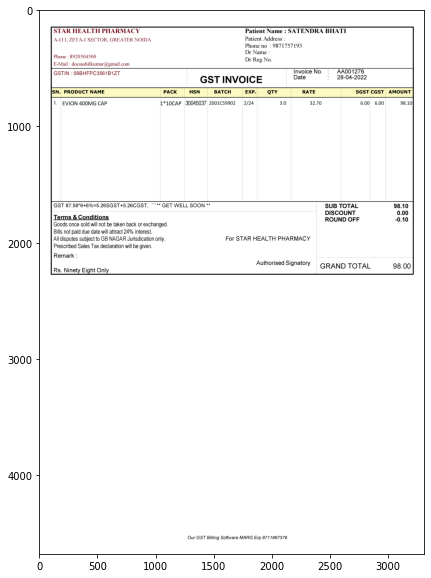


 {'Patient Name': 'SATENDRA BHATI', 'Patient Mobile Number': [9871757193, 8920504500], 'Patient Address': '', 'Date': 'VOICE 28-04-2022', 'Invoice Number': 'AA001276'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,RATE,SGST,CGST,AMOUNT
0,1.,EVION 400MG CAP,1*10CAP,30045037,2001C59902,2/24,3:0,32.70,6.00,6.00,98.10



 {'SUB TOTAL': 98.1, 'DISCOUNT': 0.0, 'ROUND OFF': -0.1, 'GRAND TOTAL': 98.0} 


-----------------------------------------------------------------------------------------------------------------------

275-28-1651157214316.png


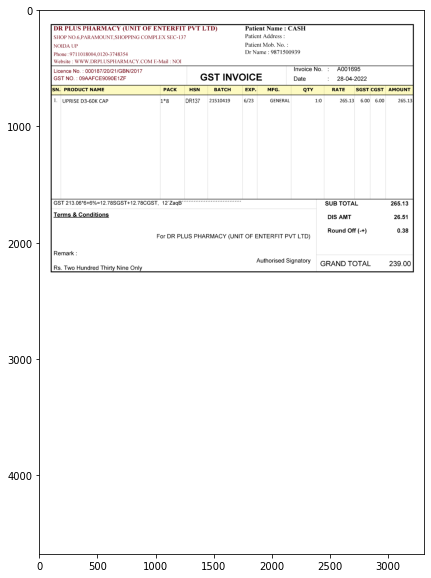


 {'Patient Name': 'CASH', 'Patient Mobile Number': [9871500939, 9711018004], 'Patient Address': '', 'Date': '28-04-2022', 'Invoice Number': 'A001695'} 



,SN.,PRODUCt nAMe,PACK,HSN,BATCH,EXP.,MFG.,QTY,RATE,SGST,CGST,AMOUNT
0,1.,UPRISE D3-6OK CAP,1*8,DR137,21510419,6/23,GENERAL,1:0,265.13,6.00,6.00,265.13



 {'SUBIULAL': 265.13, 'DIS AMT': 26.51, 'Round Off (-+)': 0.38, 'GRAND TOTAL': 239.0} 


-----------------------------------------------------------------------------------------------------------------------

275-12-1651133629196.png


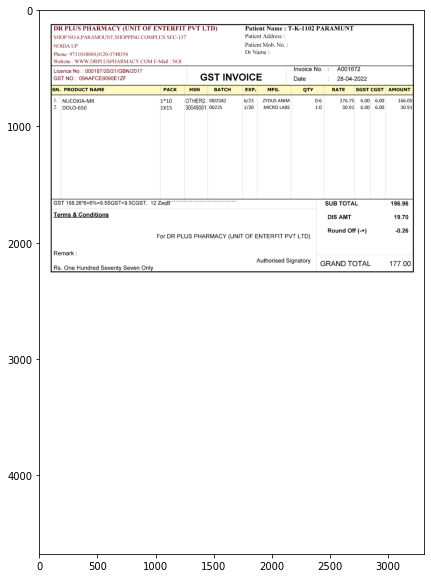


 {'Patient Name': 'TK11o2 PARAMUNT', 'Patient Mobile Number': [9711018004], 'Patient Address': '', 'Date': '28-04-2022', 'Invoice Number': 'A001672'} 



,SN.,PRODUCt nAMe,PACK,HSN,BATCH,EXP.,MFG.,QTY,RATE,SGST,CGST,AMOUNT
0,1.,NUCOXIA-MR,1*10,OTHERS,1002582,6/23,ZYDUS ANIM,0:6,276.75,6.00,6.00,166.05
1,2.,DOLO-650,1X15,30049061,00225,1/30,MICRO LABS,1:0,30.91,6.00,6.00,30.91



 {'SUBIULAL': 196.96, 'DIS AMT': 19.7, 'Round Off (-+)': -0.26, 'GRAND TOTAL': 177.0} 


-----------------------------------------------------------------------------------------------------------------------

275-16-1651146529065.png


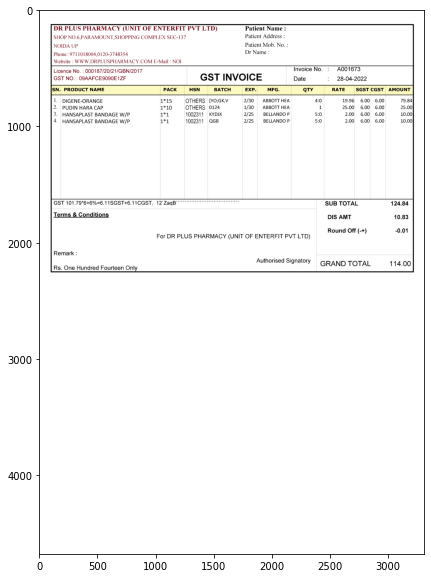


 {'Patient Name': '', 'Patient Mobile Number': [9711018004], 'Patient Address': '', 'Date': '28-04-2022', 'Invoice Number': 'A001673'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,MFG.,QTY,RATE,SGST,CGST,AMOUNT
0,1.,DIGENE-ORANGE,1*15,OTHERS,"[YO;GK,V",2/30,ABBOTT HEA,4:0,19.96,6.00,6.00,79.84
1,2.,PUDIN HARA CAP,1*10,OTHERS,0124,1/30,ABBOTT HEA,1,25.00,6.00,6.00,25.00
2,3.,HANSAPLAST BANDAGE W/P,1*1,1002311,KYDJX,2/25,BELLANDO P,5:0,2.00,6.00,6.00,10.00
3,4.,HANSAPLAST BANDAGE W/P,1*1,1002311,QGB,2/25,BELLANDO P,5:0,2.00,6.00,6.00,10.00



 {'SUBIULAL': 124.84, 'DIS AMT': 10.83, 'Round Off (-+)': -0.01, 'GRAND TOTAL': 114.0} 


-----------------------------------------------------------------------------------------------------------------------

275-8-1651131344798.png


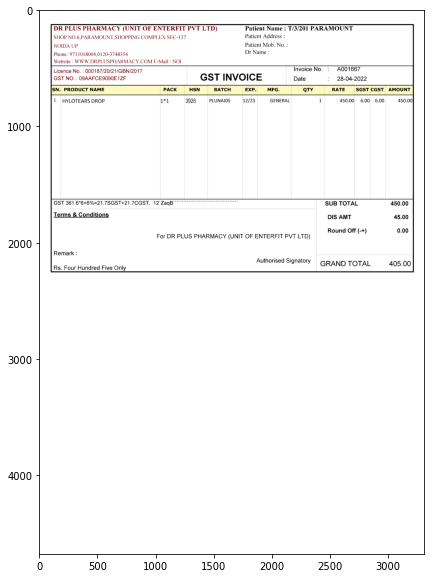


 {'Patient Name': 'T/3/201 PARAMOUNT', 'Patient Mobile Number': [9711018004], 'Patient Address': '', 'Date': '28-04-2022', 'Invoice Number': 'A001667'} 



,SN.,PRODUCt nAMe,PACK,HSN,BATCH,EXP.,MFG.,QTY,RATE,SGST,CGST,AMOUNT
0,1.,HYLOTEARS DROP,1*1,3926,PLUNAJO5,12/23,GENERAL,1,450.00,6.00,6.00,450.00



 {'SUBIULAL': 450.0, 'DIS AMT': 45.0, 'Round Off (-+)': 0.0, 'GRAND TOTAL': 405.0} 


-----------------------------------------------------------------------------------------------------------------------

276-3-1651559386985.png


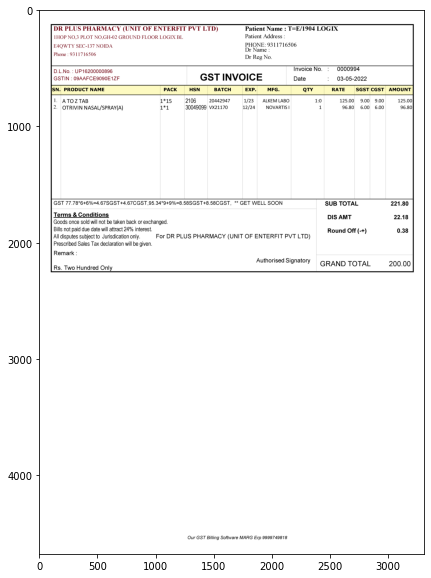


 {'Patient Name': 'T=E/1904 LOGIX', 'Patient Mobile Number': [9311716506, 9311716506], 'Patient Address': '', 'Date': '03-05-2022', 'Invoice Number': '0000994'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,MFG.,QTY,RATE,SGST,CGST,AMOUNT
0,1.,A TO Z TAB,1*15,2106,20442947,1/23,ALKEM LABO,1:0,125.00,9.00,9.00,125.00
1,2.,OTRIVIN NASAL/SPRAY(A),1*1,30049099,VX21170,12/24,NOVARTIS T,1,96.80,6.00,6.00,96.80



 {'SUB TOTAL': 221.8, 'DIS AMT': 22.18, 'Round Off (-+)': 0.38, 'GRAND TOTAL': 200.0} 


-----------------------------------------------------------------------------------------------------------------------

276-9-1651072175533.png


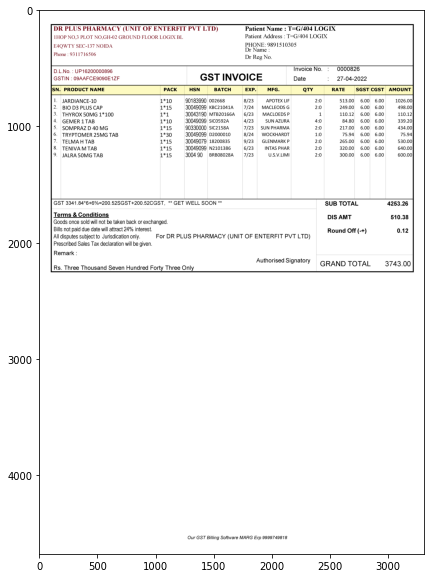


 {'Patient Name': 'T=G/404 LOGIX', 'Patient Mobile Number': [9891510305, 9311716506], 'Patient Address': 'T=G/404 LOGIX', 'Date': '27-04-2022', 'Invoice Number': '0000826'} 



,SN.,PRODUCt NAME,PACK,HSN,BATCH,EXP.,MFG.,QTY,RATE,SGST,CGST,AMOUNT
0,1.,JARDIANCE-10,1*10,90183990,002668,8/23,APOTEX LIF,2:0,513.00,6.00,6.00,1026.00
1,2.,BIO D3 PLUS CAP,1*15,30049099,KBC21041A,7/24,MACLEODS G,2:0,249.00,6.00,6.00,498.00
2,3.,THYROX 50MG 1*100,1*1,30043190,MTB20166A,6/23,MACLOEDS P,1,110.12,6.00,6.00,110.12
3,4.,GEMER 1TAB,1*10,30049099,SIC0592A,4/23,SUN AZURA,4:0,84.80,6.00,6.00,339.20
4,5.,SOMPRAZ D 40 MG,1*15,90330000,SIC2158A,7/23,SUN PHARMA,2:0,217.00,6.00,6.00,434.00
5,6.,TRYPTOMER 25MG TAB,1*30,30049099,D2000010,8/24,WOCKHARDT,1:0,75.94,6.00,6.00,75.94
6,7.,TELMA H TAB,1*15,30049079,18200835,9/23,GLENMARK P,2:0,265.00,6.00,6.00,530.00
7,8.,TENIVA MTAB,1*15,30049099,N2101386,6/23,INTAS PHAR,2:0,320.00,6.00,6.00,640.00
8,9.,JALRA 50MG TAB,1*15,3004 90,BRB08028A,7/23,U.S.V.LIMI,2:0,300.00,6.00,6.00,600.00



 {'SUB TOTAL': 4253.26, 'DIS AMT': 510.38, 'Round Off (-+)': 0.12, 'GRAND TOTAL': 3743.0} 


-----------------------------------------------------------------------------------------------------------------------

276-1-1650540744753.png


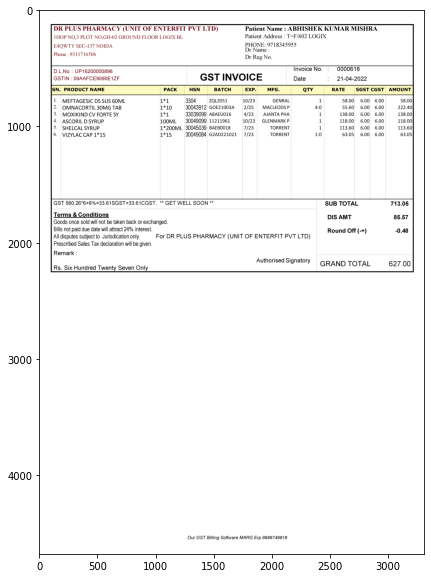


 {'Patient Name': 'ABHISHEK KUMAR MSHRA', 'Patient Mobile Number': [9718345955, 9311716506], 'Patient Address': 'T=F/602 LOGIX', 'Date': '21-04-2022', 'Invoice Number': '0000618'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,MFG.,QTY,RATE,SGST,CGST,AMOUNT
0,1.,MEFTAGESIC DS SUS 6OML,1*1,3304,ZQL2051,10/23,GENRAL,1,58.00,6.00,6.00,58.00
1,2.,OMNACORTIL 3OMG TAB,1*10,30043912,G0E21003A,2/25,MACLEODS P,4:0,55.60,6.00,6.00,222.40
2,3.,MOXIKIND CV EORTE SY,1*1,33039099,A8AEU016,4/23,AJANTA PHA,1,138.00,6.00,6.00,138.00
3,4.,ASCORIL D SYRUP,100ML,30049099,11211961,10/23,GLENMARK P,1,118.00,6.00,6.00,118.00
4,5.,SHELCAL SYRUP,1*200ML,30045039,BAEB0018,7/23,TORRENT,1,113.60,6.00,6.00,113.60
5,6.,VIZYLAC CAP 1*15,1*15,30049084,G2AD221021,7/23,TORRENT,1:0,63.05,6.00,6.00,63.05



 {'SUB TOTAL': 713.05, 'DIS AMT': 85.57, 'Round Off (-+)': -0.48, 'GRAND TOTAL': 627.0} 


-----------------------------------------------------------------------------------------------------------------------

276-14-1652004100205.png


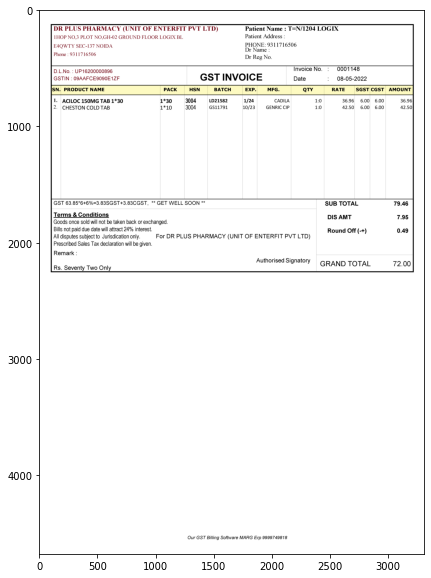


 {'Patient Name': 'T=N/1204 LOGIX', 'Patient Mobile Number': [9311716506, 9311716506], 'Patient Address': '', 'Date': '08-05-2022', 'Invoice Number': '0001148'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,MFG.,QTY,RATE,SGST,CGST,AMOUNT
0,1.,ACILOC 150MG TAB 1*30,1*30,3004,LD21582,1/24,CADILA,1:0,36.96,6.00,6.00,36.96
1,2.,CHESTON COLD TAB,1*10,3004,GS11791,10/23,GENRIC CIP,1:0,42.50,6.00,6.00,42.50



 {'SUB TOTAL': 79.46, 'DIS AMT': 7.95, 'Round Off (-+)': 0.49, 'GRAND TOTAL': 72.0} 


-----------------------------------------------------------------------------------------------------------------------

276-9-1651497179136.png


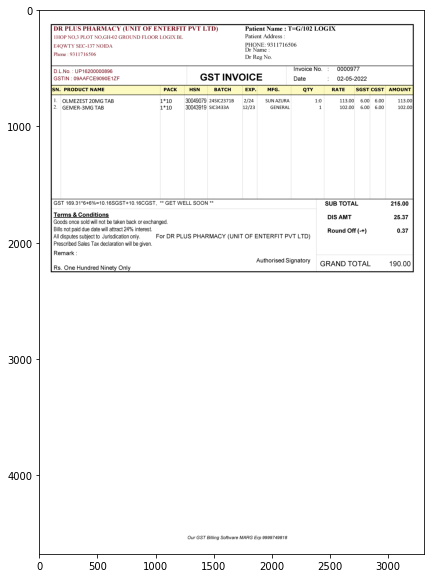


 {'Patient Name': 'T=G/102 LOGIX', 'Patient Mobile Number': [9311716506, 9311716506], 'Patient Address': '', 'Date': '02-05-2022', 'Invoice Number': '0000977'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,MFG.,QTY,RATE,SGST,CGST,AMOUNT
0,1.,OLMEZEST 20MG TAB,1*10,30049079,24SIC2371B,2/24,SUN AZURA,1:0,113.00,6.00,6.00,113.00
1,2.,GEMER-3MG TAB,1*10,30043919,SIC3433A,12/23,GENERAL,1,102.00,6.00,6.00,102.00



 {'SUB TOTAL': 215.0, 'DIS AMT': 25.37, 'Round Off (-+)': 0.37, 'GRAND TOTAL': 190.0} 


-----------------------------------------------------------------------------------------------------------------------

277-69-1650643288502.png


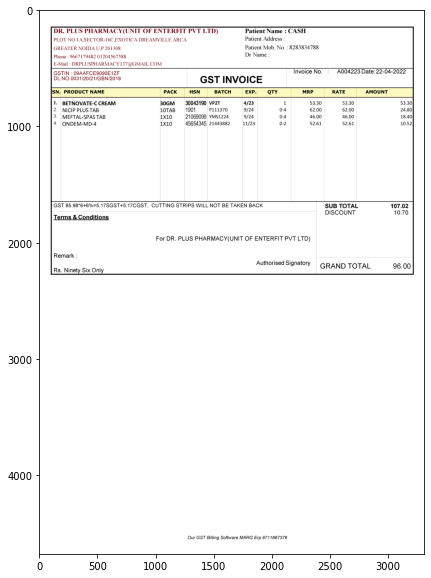


 {'Patient Name': 'CASH', 'Patient Mobile Number': [8283834788, 9667179482, 1204567588], 'Patient Address': '', 'Date': '22-04-2022', 'Invoice Number': 'A004223'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,AMOUNT
0,1.,BETNOVATE-C CREAM,30GM,30043190,VP2T,4/23,1,53.30,53.30,53.30
1,2.,NICIP PLUS TAB,10TAB,1901,P111370,9/24,0:4,62.00,62.00,24.80
2,3.,MEETAL-SPASTAB,1X10,21069099,YMS1224,9/24,0:4,46.00,46.00,18.40
3,4.,ONDEM-MD-4,1X10,45654345,21443882,11/23,0:2,52.61,52.61,10.52



 {'SUB TOTAL': 107.02, 'DISCOUNT': 10.7, 'GRAND TOTAL': 96.0} 


-----------------------------------------------------------------------------------------------------------------------

277-34-1650634981366.png


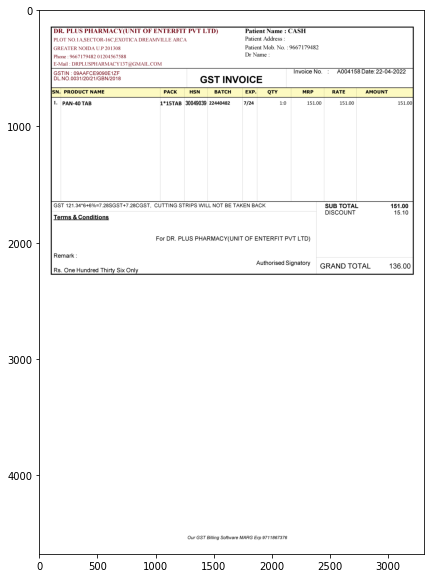


 {'Patient Name': 'CASH', 'Patient Mobile Number': [9667179482, 9667179482, 1204567588], 'Patient Address': '', 'Date': '22-04-2022', 'Invoice Number': 'A004158'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,AMOUNT
0,1.,PAN-40 TAB,1*15TAB,30049039,22440482,7/24,1:0,151.00,151.00,151.00



 {'SUB TOTAL': 151.0, 'DISCOUNT': 15.1, 'GRAND TOTAL': 136.0} 


-----------------------------------------------------------------------------------------------------------------------

277-27-1651039626649.png


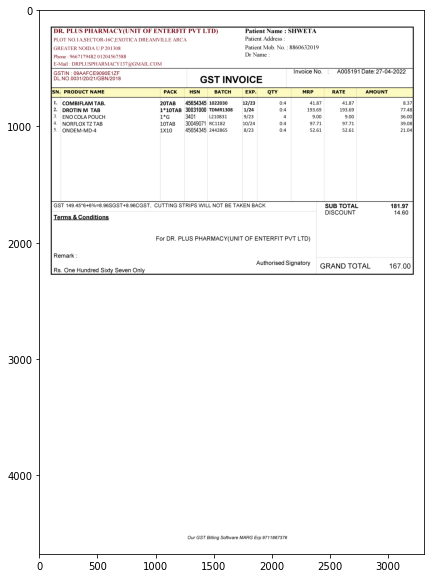


 {'Patient Name': 'SHWETA', 'Patient Mobile Number': [8860632019, 9667179482, 1204567588], 'Patient Address': '', 'Date': '27-04-2022', 'Invoice Number': 'A005191'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,AMOUNT
0,1.,COMBIFLAM TAB.,20TAB,45654345,1022030,12/23,0:4,41.87,41.87,8.37
1,2.,DROTIN M TAB,1*10TAB,30031000,TDMR1308,1/24,0:4,193.69,193.69,77.48
2,3.,ENO COLA POUCH,1*G,3401,L210831,9/23,4,9.00,9.00,36.00
3,4.,NORELOX TZ TAB,10TAB,30049071,RC1182,10/24,0:4,97.71,97.71,39.08
4,5.,ONDEM-MD-4,1X10,45654345,2442865,8/23,0:4,52.61,52.61,21.04



 {'SUB TOTAL': 181.97, 'DISCOUNT': 14.6, 'GRAND TOTAL': 167.0} 


-----------------------------------------------------------------------------------------------------------------------

281-27-1650979005007.png


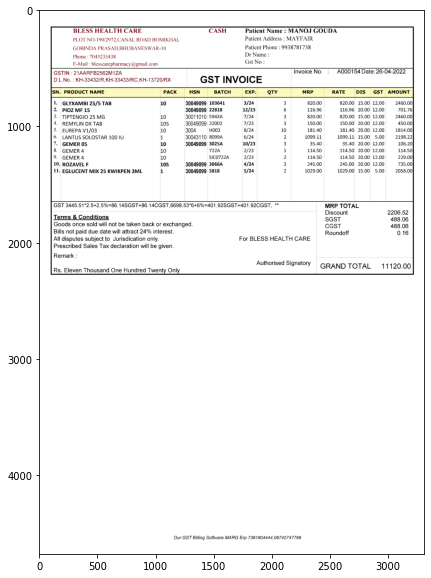


 {'Patient Name': 'MANOJ GOUDA', 'Patient Mobile Number': [9938781738, 7045233438], 'Patient Address': 'MAYFAIR', 'Date': '26-04-2022', 'Invoice Number': 'A000154'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,DIS,GST,AMOUnt
0,1.,GLYXAMBI 25/5 TAB,10,30049099,103641,3/24,3,820.00,820.00,15.00,12.00,2460.00
1,2.,PIOZ MF 15,BLANK,30049099,22818,12/23,6,116.96,116.96,20.00,12.00,701.76
2,3.,TIPTENGIO 25 MG,10,30011010,5943A,7/24,3,820.00,820.00,15.00,12.00,2460.00
3,4.,REVYLIN DX TAB,10S,30049099,22002,7/23,3,150.00,150.00,20.00,12.00,450.00
4,5.,EUREPA V1/03,10,3004,H003,8/24,10,181.40,181.40,20.00,12.00,1814.00
5,6.,LANTUS SOLOSTAR 1O0IU,1,30043110,8099A,6/24,2,1099.11,1099.11,15.00,5.00,2198.22
6,7.,GEMER 05,10,30049099,3025A,10/23,3,35.40,35.40,20.00,12.00,106.20
7,8.,GEMER 4,10,BLANK,722A,2/23,1,114.50,114.50,20.00,12.00,114.50
8,9.,GEMER 4,10,BLANK,SIC0722A,2/23,2,114.50,114.50,20.00,12.00,229.00
9,10.,ROZAVEL F,10S,30049099,3066A,4/24,3,245.00,245.00,20.00,12.00,735.00



 {'Discount': 2206.52, 'SGST': 488.06, 'CGST': 488.06, 'Roundoff': 0.16, 'GRAND TOTAL': 11120.0} 


-----------------------------------------------------------------------------------------------------------------------

281-6-1651242509484.png


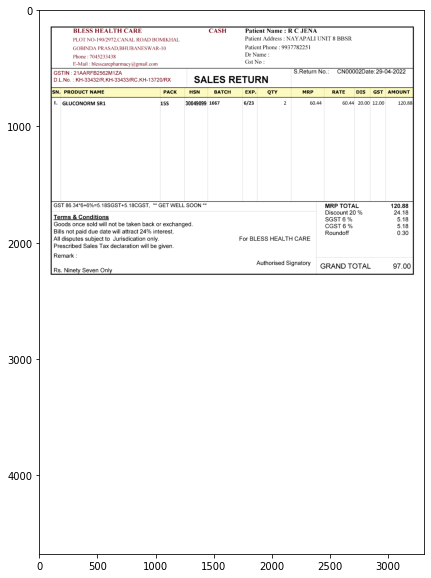


 {'Patient Name': 'R C JENA', 'Patient Mobile Number': [9937782251, 7045233438], 'Patient Address': 'NAYAPALI UNIT 8 BBSR', 'Date': '29-04-2022', 'Invoice Number': 'CN00002'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,DIS,GST,AMOUnT
0,1.,GLUCONORM SR1,15S,30049099,1667,6/23,2,60.44,60.44,20.00,12.00,120.88



 {'MRP tOtAL': 120.88, 'Discount 20 %': 24.18, 'SGST 6 %': 5.18, 'CGST 6 %': 5.18, 'Roundoff': 0.3, 'GRAND TOTAL': 97.0} 


-----------------------------------------------------------------------------------------------------------------------

281-3-1651327623565.png


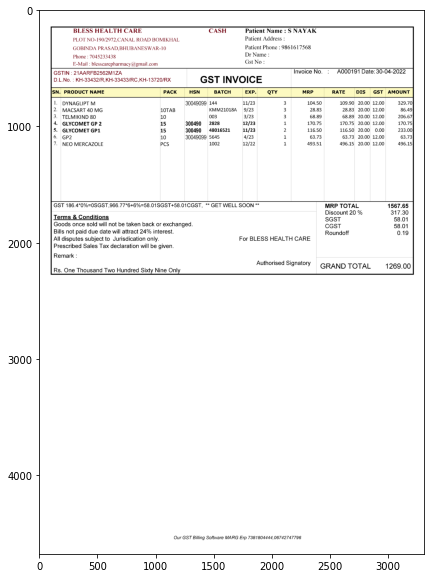


 {'Patient Name': 'S NAYAK', 'Patient Mobile Number': [9861617568, 7045233438], 'Patient Address': '', 'Date': '30-04-2022', 'Invoice Number': 'A000191'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,DIS,GST,AMOUnT
0,1.,DYNAGLIPT M,BLANK,30049099,144,11/23,3,104.50,109.90,20.00,12.00,329.70
1,2.,MACSART 40 MG,10TAB,BLANK,KMM21018A,9/23,3,28.83,28.83,20.00,12.00,86.49
2,3.,TELMIKIND 80,10,BLANK,003,3/23,3,68.89,68.89,20.00,12.00,206.67
3,4.,GLYCOMET GP 2,15,300490,2828,12/23,1,170.75,170.75,20.00,12.00,170.75
4,5.,GLYCOMET GP1,15,300490,48016521,11/23,2,116.50,116.50,20.00,0.00,233.00
5,6.,GP2,10,30049099,5645,4/23,1,63.73,63.73,20.00,12.00,63.73
6,7.,NEO MERCAZOLE,PCS,BLANK,1002,12/22,1,493.51,496.15,20.00,12.00,496.15



 {'MRP tOtAL': 1567.65, 'Discount 20 %': 317.3, 'SGST': 58.01, 'CGST': 58.01, 'Roundoff': 0.19, 'GRAND TOTAL': 1269.0} 


-----------------------------------------------------------------------------------------------------------------------

281-13-1651849902321.png


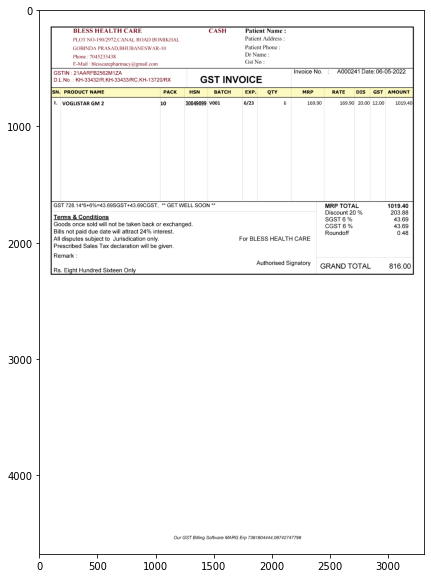


 {'Patient Name': '', 'Patient Mobile Number': [7045233438], 'Patient Address': '', 'Date': '06-05-2022', 'Invoice Number': 'A000241'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,DIS,GST,AMOUnT
0,1.,VOGLISTAR GM 2,10,30049099,V001,6/23,6,169.90,169.90,20.00,12.00,1019.40



 {'MRP tOtAL': 1019.4, 'Discount 20 %': 203.88, 'SGST 6 %': 43.69, 'CGST 6 %': 43.69, 'Roundoff': 0.48, 'GRAND TOTAL': 816.0} 


-----------------------------------------------------------------------------------------------------------------------

281-5-1651930886959.png


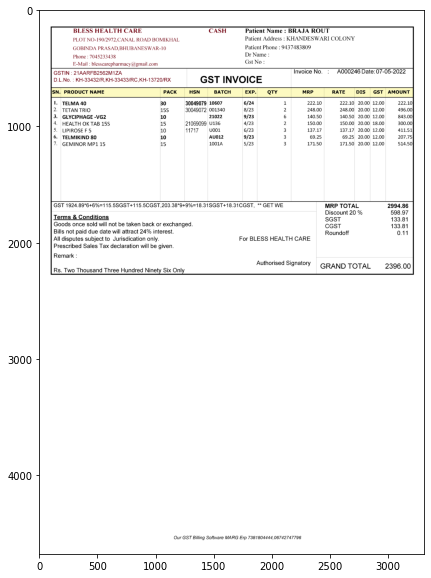


 {'Patient Name': 'BRAJA ROUT', 'Patient Mobile Number': [9437483809, 7045233438], 'Patient Address': 'KHANDESWARI COLONY', 'Date': '07-05-2022', 'Invoice Number': 'A000246'} 



,SN.,PRODUCt nAME,PACK,HSN,BATCH,EXP.,QTY,MRP,RATE,DIS,GST,AMOUnT
0,1.,TELMA 40,30,30049079,10607,6/24,1,222.10,222.10,20.00,12.00,222.10
1,2.,TETAN TRIO,15S,30049072,001340,8/23,2,248.00,248.00,20.00,12.00,496.00
2,3.,GLYCIPHAGE -VG2,10,BLANK,21022,9/23,6,140.50,140.50,20.00,12.00,843.00
3,4.,HEALTH OK TAB 15S,15,21069099,U136,4/23,2,150.00,150.00,20.00,18.00,300.00
4,5.,LIPIROSE F 5,10,11717,U001,6/23,3,137.17,137.17,20.00,12.00,411.51
5,6.,TELMIKIND 80,10,BLANK,AU012,9/23,3,69.25,69.25,20.00,12.00,207.75
6,7.,GEMINOR MP1 15,15,BLANK,1001A,5/23,3,171.50,171.50,20.00,12.00,514.50



 {'MRP tOtAL': 2994.86, 'Discount 20 %': 598.97, 'SGST': 133.81, 'CGST': 133.81, 'Roundoff': 0.11, 'GRAND TOTAL': 2396.0} 


-----------------------------------------------------------------------------------------------------------------------

282-11-1651512672624.png


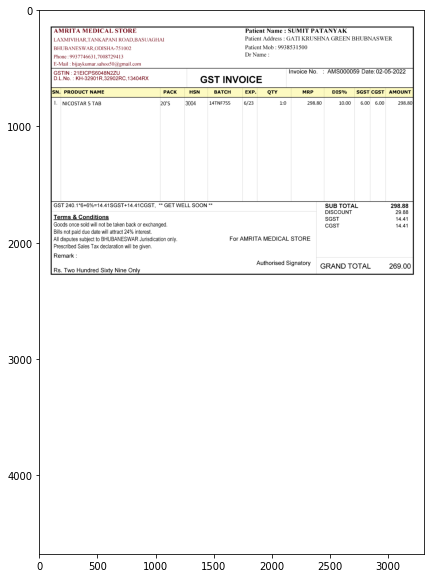


 {'Patient Name': 'SUMT PATANYAK', 'Patient Mobile Number': [9938531500, 9937746631, 7008729413], 'Patient Address': 'GATI KRUSHNA GREEN BHUBNASWER', 'Date': '02-05-2022', 'Invoice Number': 'AMS000059'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DIS%,SGST,CGST,AMOUNT
0,1.,NICOSTAR 5 TAB,20'S,3004,14TNF755,6/23,1:0,298.80,10.00,6.00,6.00,298.80



 {'SUB TOTAL': 298.88, 'DISCOUNT': 29.88, 'SGST': 14.41, 'CGST': 14.41, 'GRAND TOTAL': 269.0} 


-----------------------------------------------------------------------------------------------------------------------

282-2-1651567562448.png


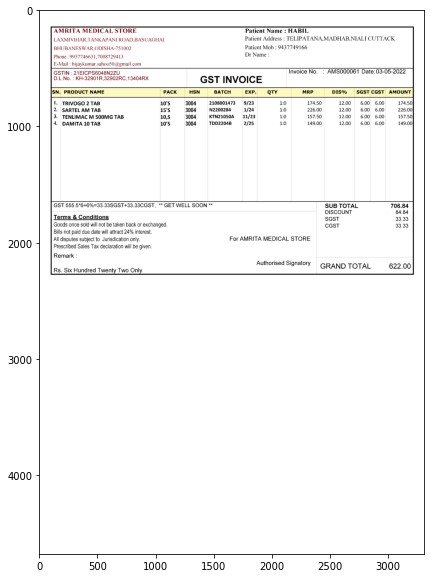


 {'Patient Name': 'HABIL', 'Patient Mobile Number': [9437749166, 9937746631, 7008729413], 'Patient Address': 'TELIPATANA,MADHAB.NIALI CUTTACK', 'Date': '03-05-2022', 'Invoice Number': 'AMS000061'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DIS%,SGST,CGST,AMOUNT
0,1.,TRIVOGO 2 TAB,10'S,3004,2108001473,9/23,1:0,174.50,12.00,6.00,6.00,174.50
1,2.,SARTEL AM TAB,15'S,3004,N2200284,1/24,1:0,226.00,12.00,6.00,6.00,226.00
2,3.,TENLIMAC M 5OOMG TAB,"10,S",3004,KTN21050A,11/23,1:0,157.50,12.00,6.00,6.00,157.50
3,4.,DAMITA 10 TAB,10'S,3004,TDD2204B,2/25,1:0,149.00,12.00,6.00,6.00,149.00



 {'SUB tOTAL': 706.84, 'DISCOUNT': 84.84, 'SGST': 33.33, 'CGST': 33.33, 'GRAND TOTAL': 622.0} 


-----------------------------------------------------------------------------------------------------------------------

282-8-1651220022338.png


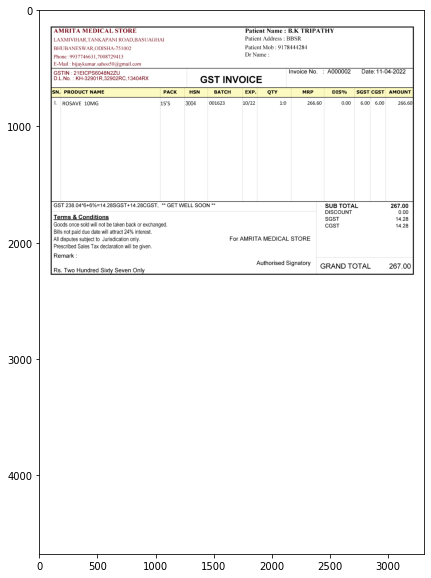


 {'Patient Name': 'B.K TRIPATHY', 'Patient Mobile Number': [9178444284, 9937746631, 7008729413], 'Patient Address': 'BBSR', 'Date': '11-04-2022', 'Invoice Number': 'A000002'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DIS%,SGST,CGST,AMOUNT
0,1.,ROSAVE 1OMG,15'S,3004,001623,10/22,1:0,266.60,0.00,6.00,6.00,266.60



 {'SUB TOTAL': 267.0, 'DISCOUNT': 0.0, 'SGST': 14.28, 'CGST': 14.28, 'GRAND TOTAL': 267.0} 


-----------------------------------------------------------------------------------------------------------------------

282-4-1651483358691.png


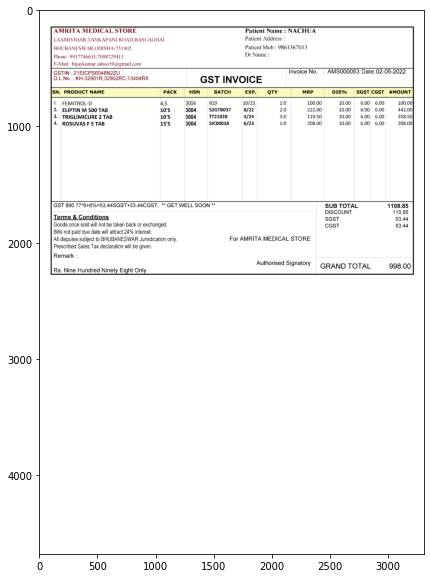


 {'Patient Name': 'NACHUA', 'Patient Mobile Number': [9861367013, 9937746631, 7008729413], 'Patient Address': '', 'Date': '02-05-2022', 'Invoice Number': 'AMS000053'} 



,SN.,PRODUCT NAME,PACK,HSN,BATCH,EXP.,QTY,MRP,DIS%,SGST,CGST,AMOUNT
0,1.,EEMITROL-D,"4,S",3004,819,10/23,1:0,100.00,10.00,6.00,6.00,100.00
1,2.,ELIPTIN M 500 TAB,10'S,3004,S2GTB037,8/22,2:0,221.00,10.00,6.00,6.00,442.00
2,3.,TRIGLIMICURE 2 TAB,10'S,3004,TT21028,4/24,3:0,119.50,10.00,6.00,6.00,358.50
3,4.,ROSUVAS F 5 TAB,15'S,3004,SIC0003A,6/23,1:0,208.00,10.00,6.00,6.00,208.00



 {'SUB tOTAL': 1108.85, 'DISCOUNT': 110.85, 'SGST': 53.44, 'CGST': 53.44, 'GRAND TOTAL': 998.0} 


-----------------------------------------------------------------------------------------------------------------------

285-6-1652078536596.png


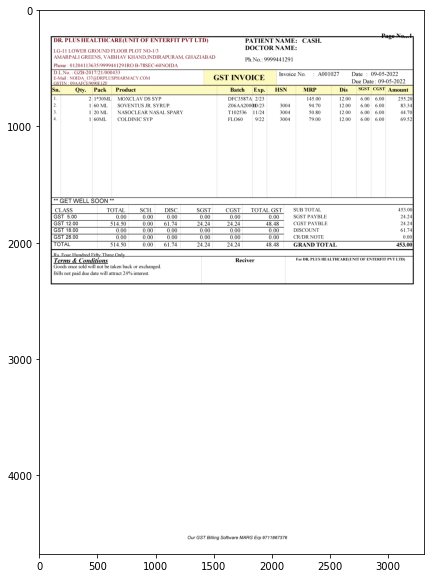


 {'Patient Name': 'CASH.', 'Patient Mobile Number': [9999441291], 'Patient Address': '', 'Date': '09-05-2022', 'Invoice Number': ''} 



,Sn.,Qty.,Pack,Product,Batch,Exp.,HSN,MRP,Dis,SGST,CGST,Amount
0,1.,2,1*30MI,MOXCLAV DS SYP,DFC3587A,2/23,BLANK,145.00,12.00,6.00,6.00,255.20
1,2.,1,60 ML,SOVENTUS JR. SYRUP.,Z06AA200,0110/23,3004,94.70,12.00,6.00,6.00,83.34
2,3.,1,20 ML,NASOCLEAR NASAL SPARY,T102536,11/24,3004,50.80,12.00,6.00,6.00,44.70
3,4.,1,60ML,COLDINIC SYP,FLO60,9/22,3004,79.00,12.00,6.00,6.00,69.52



 {'SUB TOTAL': 453.0, 'SGST PAYBLE': 24.24, 'CGST PAYBLE': 24.24, 'DISCOUNT': 61.74, 'CR/DR NOTE': 0.0, 'GRAND TOTAL': 453.0} 


-----------------------------------------------------------------------------------------------------------------------

285-7-1652078700817.png


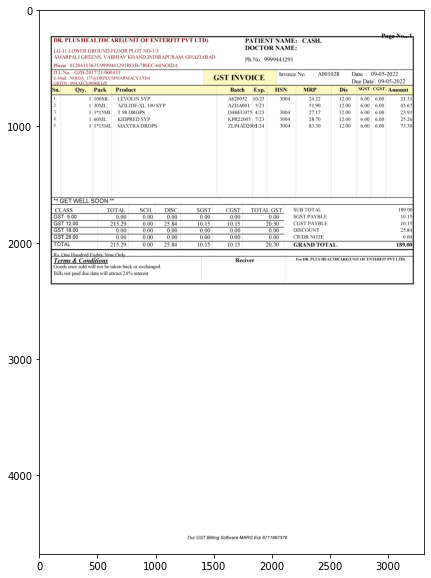


 {'Patient Name': 'CASH.', 'Patient Mobile Number': [9999441291], 'Patient Address': '', 'Date': '09-05-2022', 'Invoice Number': ''} 



,Sn.,Qty.,Pack,Product,Batch,Exp.,HSN,MRP,Dis,SGST,CGST,Amount
0,1.,1,100ML,LEVOLIN SYP,A620052,10/23,3004,24.22,12.00,6.00,6.00,21.31
1,2.,1,30ML,AZILIDE-XL 100 SYP,AZDA001,5/23,BLANK,51.90,12.00,6.00,6.00,45.67
2,3.,1,1*15MI,T 98 DROPS,D4BEU075,4/23,3004,27.17,12.00,6.00,6.00,23.91
3,4.,1,60ML,KIDPRED SYP,KPR22005,7/23,3004,28.70,12.00,6.00,6.00,25.26
4,5.,1,1*15ML,MAXTRADROPS,ZLP4AD20,05/24,3004,83.30,12.00,6.00,6.00,73.30



 {'SUB TOTAL': 189.0, 'SGST PAYBLE': 10.15, 'CGST PAYBLE': 10.15, 'DISCOUNT': 25.84, 'CR/DR NOTE': 0.0, 'GRAND TOTAL': 189.0} 


-----------------------------------------------------------------------------------------------------------------------

285-12-1651934905791.png


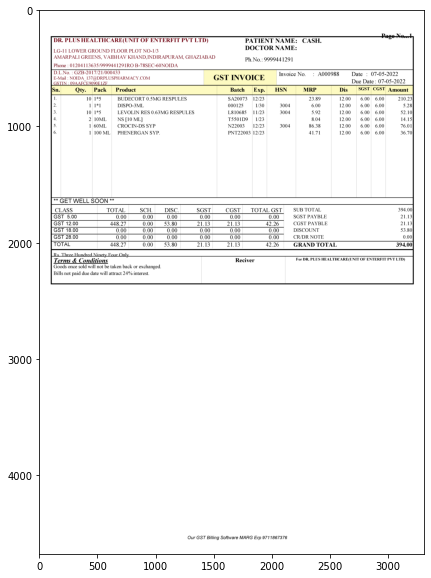


 {'Patient Name': 'CASH.', 'Patient Mobile Number': [9999441291], 'Patient Address': '', 'Date': '07-05-2022', 'Invoice Number': ''} 



,Sn.,Qty.,Pack,Product,Batch,Exp.,HSN,MRP,Dis,SGST,CGST,Amount
0,1.,10,1*5,BUDECORT 0.5MG RESPULES,SA20073,12/23,BLANK,23.89,12.00,6.00,6.00,210.23
1,2.,1,1*1,DISPO-3ML,000125,1/30,3004,6.00,12.00,6.00,6.00,5.28
2,3.,10,1*5,LEVOLINRES 0.63MG RESPULES,L810685,11/23,3004,5.92,12.00,6.00,6.00,52.10
3,4.,2,10ML,NS [10 ML],T5501D9,1/23,BLANK,8.04,12.00,6.00,6.00,14.15
4,5.,1,60ML,CROCIN-DS SYP,N22003,12/23,3004,86.38,12.00,6.00,6.00,76.01
5,6.,1,100 ML,PHENERGAN SYP,PNT22003,12/23,BLANK,41.71,12.00,6.00,6.00,36.70



 {'SUB TOTAL': 394.0, 'SGST PAYBLE': 21.13, 'CGST PAYBLE': 21.13, 'DISCOUNT': 53.8, 'CR/DR NOTE': 0.0, 'GRAND TOTAL': 394.0} 


-----------------------------------------------------------------------------------------------------------------------

285-4-1651988719399.png


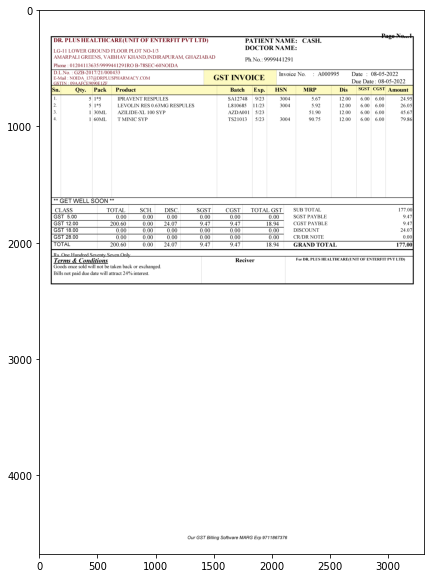


 {'Patient Name': 'CASH.', 'Patient Mobile Number': [9999441291], 'Patient Address': '', 'Date': '08-05-2022', 'Invoice Number': 'A000995'} 



,Sn.,Qty.,Pack,Product,Batch,Exp.,HSN,MRP,Dis,SGST,CGST,Amount
0,1.,5,1*5,IPRAVENT RESPULES,SA12748,9/23,3004,5.67,12.00,6.00,6.00,24.95
1,2.,5,1*5,LEVOLINRES 0.63MG RESPULES,L810685,11/23,3004,5.92,12.00,6.00,6.00,26.05
2,3.,1,30ML,AZILIDE-XI 100 SYP,AZDA001,5/23,BLANK,51.90,12.00,6.00,6.00,45.67
3,4.,1,60ML,T MINIC SYP,TS21013,5/23,3004,90.75,12.00,6.00,6.00,79.86



 {'SUB TOTAL': 177.0, 'SGST PAYBLE': 9.47, 'CGST PAYBLE': 9.47, 'DISCOUNT': 24.07, 'CR/DR NOTE': 0.0, 'GRAND TOTAL': 177.0} 


-----------------------------------------------------------------------------------------------------------------------

285-9-1652088750308.png


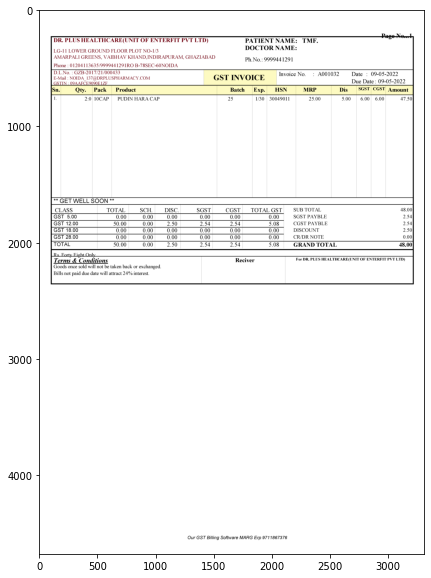


 {'Patient Name': 'TMF.', 'Patient Mobile Number': [9999441291], 'Patient Address': '', 'Date': '09-05-2022', 'Invoice Number': ''} 



,Sn.,Qty.,Pack,Product,Batch,Exp.,HSN,MRP,Dis,SGST,CGST,Amount
0,1.,2:0,10CAP,PUDIN HARA CAP,25,1/30,30049011,25.00,5.00,6.00,6.00,47.50



 {'SUB TOTAL': 48.0, 'SGST PAYBLE': 2.54, 'CGST PAYBLE': 2.54, 'DISCOUNT': 2.5, 'CR/DR NOTE': 0.0, 'GRAND TOTAL': 48.0} 


-----------------------------------------------------------------------------------------------------------------------



In [ ]:
for i in Data_Fourth:
    print(i)
    image = cv2.imread(f'fourth/{i}')
    plt.figure(figsize=(20,10))
    plt.imshow(image)
    plt.show()
    print("\n", Data_Fourth[i]['header'], "\n")
    display(Data_Fourth[i]['table'])
    print("\n", Data_Fourth[i]['footer'], "\n")
    print('\n-----------------------------------------------------------------------------------------------------------------------\n')